# PULSE Evaluation

This notebook now loads pre-processed metadata and metrics CSVs generated by the metadata harmonization notebook.

In [1]:
import os
import pandas as pd
import numpy as np
import math
import matplotlib.pyplot as plt
import matplotlib.lines as mlines
import matplotlib.patches as mpatches
import seaborn as sns
from sklearn.metrics import roc_curve, auc, precision_recall_curve

## Setup and Configuration

In [2]:
# Set paths to pre-processed CSVs
metadata_path = os.path.join("./notebook_output/postprocessed_data", "pulse_metadata.csv")
metrics_path = os.path.join("./notebook_output/postprocessed_data", "pulse_metrics.csv")
metrics_op_path = os.path.join("./notebook_output/postprocessed_data", "pulse_metrics_operational.csv")

# Load metadata and metrics
df_metadata = pd.read_csv(metadata_path)
print(f"Loaded metadata: {df_metadata.shape}")

# Load performance metrics with and without subgroups
df_metrics_subgroup = pd.read_csv(metrics_path)
print(f"Loaded metrics with subgroups: {df_metrics_subgroup.shape}")

df_metrics = df_metrics_subgroup[
    df_metrics_subgroup["subgroup_type"] == "Overall"
].copy()
df_metrics = df_metrics.drop(columns=["subgroup_type", "subgroup_value"])
print(f"Loaded metrics without subgroups: {df_metrics.shape}")

# Load operational metrics
df_metrics_op = pd.read_csv(metrics_op_path)
print(f"Loaded operational metrics: {df_metrics_op.shape}")

# Split all loaded dataframes into _agents and _benchmark
def split_agents_benchmark(df):
    # Always include convML and convDL
    base = df[(df["model_type"] == "convML") | (df["model_type"] == "convDL")]
    # _agents: add is_agent == True
    agents = pd.concat(
        [base, df[df["is_agent"] == True]], ignore_index=True
    ).drop_duplicates()
    # _benchmark: add is_agent == False
    benchmark = pd.concat(
        [base, df[df["is_agent"] == False]], ignore_index=True
    ).drop_duplicates()
    return agents, benchmark

# Split all loaded dataframes into _agents and _benchmark
def split_agents_benchmark_op(df):
    # Always include convML and convDL
    base = df[(df["model_type"] == "convML") | (df["model_type"] == "convDL")]
    # _agents: include convML/convDL plus all rows where is_agent is True or 'all' (as string)
    agents = pd.concat(
        [base, df[df["is_agent"].isin(["True", "all"])]], ignore_index=True
    ).drop_duplicates()
    # _benchmark: include convML/convDL plus all rows where is_agent is False or 'all' (as string)
    benchmark = pd.concat(
        [base, df[df["is_agent"].isin(["False", "all"])]], ignore_index=True
    ).drop_duplicates()
    return agents, benchmark


df_metadata_agents, df_metadata_benchmark = split_agents_benchmark(df_metadata)
df_metrics_subgroup_agents, df_metrics_subgroup_benchmark = split_agents_benchmark(
    df_metrics_subgroup
)
df_metrics_agents, df_metrics_benchmark = split_agents_benchmark(df_metrics)
df_metrics_op_agents, df_metrics_op_benchmark = split_agents_benchmark_op(df_metrics_op)
# Drop specified columns from df_metrics_op_benchmark
df_metrics_op_benchmark = df_metrics_op_benchmark.drop(
    columns=[
        "avg_step_tokenization_time",
        "avg_step_inference_time",
        "avg_step_input_tokens",
        "avg_step_output_tokens",
    ],
    errors="ignore",
)

print(
    f"df_metadata_agents: {df_metadata_agents.shape}, df_metadata_benchmark: {df_metadata_benchmark.shape}"
)
print(
    f"df_metrics_subgroup_agents: {df_metrics_subgroup_agents.shape}, df_metrics_subgroup_benchmark: {df_metrics_subgroup_benchmark.shape}"
)
print(
    f"df_metrics_agents: {df_metrics_agents.shape}, df_metrics_benchmark: {df_metrics_benchmark.shape}"
)
print(
    f"df_metrics_op_agents: {df_metrics_op_agents.shape}, df_metrics_op_benchmark: {df_metrics_op_benchmark.shape}"
)

/var/folders/r1/8n2p36gx2ydfw7wf826zxyh00000gn/T/ipykernel_1750/2637571748.py:7: DtypeWarning: Columns (3,16,20,27,28,29,30,31,33,34,35,36,43,44,47,48,49,50,51,52,53,54,55,56,61,67,70,76,77,78,80,81,83,84,91,92,93) have mixed types. Specify dtype option on import or set low_memory=False.
  df_metadata = pd.read_csv(metadata_path)


Loaded metadata: (1062044, 96)
Loaded metrics with subgroups: (5704, 25)
Loaded metrics without subgroups: (612, 23)
Loaded operational metrics: (837, 22)
df_metadata_agents: (851698, 96), df_metadata_benchmark: (247480, 96)
df_metrics_subgroup_agents: (2856, 25), df_metrics_subgroup_benchmark: (3352, 25)
df_metrics_agents: (306, 23), df_metrics_benchmark: (360, 23)
df_metrics_op_agents: (385, 22), df_metrics_op_benchmark: (463, 18)


In [32]:
# Global output directory for all visualizations
OUTPUT_BASE_DIR = os.path.join(".", "notebook_output", "pulse_agents_overall")

TASK_MAPPING = {
    "mortality": ("Mortality", {"case": "#D14E70", "control": "#F0B0C0"}),  # Raspberry
    "aki": ("AKI", {"case": "#3A78B5", "control": "#A0D0F0"}),  # Blue
    "sepsis": ("Sepsis", {"case": "#F9C27B", "control": "#FFE6A7"}),  # Amber/Gold
}

DATASET_MAPPING = {
    "hirid": ("HiRID", "#793FBB"),  # Purple
    "miiv": ("MIMIC-IV", "#17AB6F"),  # Green
    "eicu": ("eICU", "#FC8D5F"),  # Orange
}
MODEL_MAPPING = {
    # convML: slightly darker, more prominent blues (light to dark)
    "RandomForest": "#c9daf6",  # light blue, slightly darker and bluer
    "XGBoost": "#4f8ad1",  # deeper blue, more saturated
    # convDL: slightly darker, more prominent greens (light to dark)
    "CNN": "#c6eedb",  # light mint green, slightly darker
    "InceptionTime": "#7fd6b1",  # medium mint green, slightly darker
    "LSTM": "#3ca97d",  # deeper green, more saturated
    "GRU": "#217a5a",  # even deeper green
    # LLMs: vivid, distinct, friendly (legend only)
    "OpenAI-o3": "#ff66c3",  # vivid magenta (first agent color in LLM_COLOR_FAMILIES)
    "Claude-Sonnet-4": "#1080e2",  # vivid blue (first agent color in LLM_COLOR_FAMILIES)
    "Grok-4": "#b44fd1",  # vivid purple (first agent color in LLM_COLOR_FAMILIES)
    "Gemini-2.5-Pro": "#8be600",  # vivid lime green (first agent color in LLM_COLOR_FAMILIES)
    "Gemini-2.5-Flash": "#ff7c1a",  # vivid gold (first agent color in LLM_COLOR_FAMILIES)
    "Llama-3.1-8B-Instruct": "#4cb0c3",  # vivid turquoise (first agent color in LLM_COLOR_FAMILIES)
    "Deepseek-R1-Distill-Llama-8B": "#ffa233",  # vivid orange (first agent color in LLM_COLOR_FAMILIES)
    "Mistral-7B-Instruct-v0.3": "#8f5ad8",  # vivid violet (first agent color in LLM_COLOR_FAMILIES)
    "Gemma-3-4B-it": "#00e699",  # vivid mint green (first agent color in LLM_COLOR_FAMILIES)
    "MedGemma-4B-it": "#c2338c",  # vivid magenta (first agent color in LLM_COLOR_FAMILIES)
}

PROMPTING_ID_MAPPING = {
    "Aggregation": "#1f77b4",  # Vivid Blue
    "Zero-Shot": "#ff7f0e",  # Vibrant Orange
    "One-Shot": "#9cf177",  # Modern Purple
    "Few-Shot (3)": "#fbe844",  # Bold Red
    "CoT": "#2ca02c",  # Fresh Green
    "SumAgent": "#ebb128",  # Playful Pink
    "ColAgent": "#b141e9",  # Lively Cyan
    "ClinFlowAgent": "#36eaab",  # Warm Brown
    "HybReAgent": "#f13636",  # Energetic Yellow-Green
}

CONVML_MODELS = ["RandomForest", "XGBoost"]
CONVDL_MODELS = ["CNN", "InceptionTime", "GRU", "LSTM"]
LLM_MODELS = [
    "OpenAI-o3",
    "Claude-Sonnet-4",
    "Grok-4",
    "Gemini-2.5-Pro",
    "Gemini-2.5-Flash",
    "Llama-3.1-8B-Instruct",
    "Deepseek-R1-Distill-Llama-8B",
    "Mistral-7B-Instruct-v0.3",
    "Gemma-3-4B-it", 
    "MedGemma-4B-it",
]

NON_COSTLY_MODELS = [
    "Gemini-2.5-Flash",
    "Llama-3.1-8B-Instruct",
    "Deepseek-R1-Distill-Llama-8B",
    "Mistral-7B-Instruct-v0.3",
    "Gemma-3-4B-it", 
    "MedGemma-4B-it",]

SUBGROUP_MAPPING = {
    "Sex": {"Male": "#1f4e79", "Female": "#c5282f"},  # Dark blue, Dark red
    "Age": {
        "18-65 Years": "#ddbf94",  # Light beige
        "65-75 Years": "#c19a6b",  # Medium beige
        "75-91 Years": "#8b7355",  # Dark beige
    },
    "BMI": {
        "BMI < 18.5 kg/m2": "#b8b8b8",  # Light silver
        "BMI 18.5-25 kg/m2": "#9d9d9d",  # Medium light silver
        "BMI 25-30 kg/m2": "#808080",  # Medium dark silver
        "BMI > 30 kg/m2": "#2c3539",  # Dark gunmetal
    },
}

METRICS_LIST = [
    "AUROC",
    "AUPRC",
    "Normalized AUPRC",
    "Min(+P, Se)",
    "Sensitivity (Recall)",
    "Specificity",
    "Precision",
    "F1 Score",
    "Accuracy",
    "Balanced Accuracy",
    "MCC",
    "Cohen's Kappa",
]

LLM_ALL_PROMPTING_IDS = sorted(
    x
    for x in df_metadata.loc[
        ~df_metadata["model_prompting_id"].isin(CONVML_MODELS + CONVDL_MODELS),
        "model_prompting_id",
    ].unique()
    if isinstance(x, str)
)

# Define agentic prompting methods
AGENTIC_PROMPTING_IDS = [
    "SumAgent",
    "ColAgent",
    "ClinFlowAgent",
    "HybReAgent",
]

# Define standard prompting methods
STANDARD_PROMPTING_IDS = [
    "Aggregation",
    "Zero-Shot",
    "One-Shot",
    "Few-Shot (3)",
    "CoT",
]

LLM_COLOR_FAMILIES = {
    "OpenAI-o3": {
        "standard_prompting": [
            "#fff0fa",  # 1 - very pale pink
            "#ffd6f2",  # 2 - light bubblegum
            "#ffb3e6",  # 3 - pastel bubblegum
            "#ff99db",  # 4 - soft bubblegum
            "#ff7fcf",  # 5 - bubblegum
        ],  # Pastel magenta to vivid pink
        "agents": [
            "#ff66c3",  # 6 - vivid bubblegum
            "#ff4db8",  # 7 - strong bubblegum
            "#ff33ac",  # 8 - deep bubblegum
            "#ff199f",  # 9 - deepest bubblegum
        ],  # Deeper magenta to lighter berry
    },
    "Claude-Sonnet-4": {
        "standard_prompting": [
            "#eaf6ff",
            "#b6dcff",
            "#7fc0ff",
            "#4da3ff",
            "#1987ff",
        ],  # Pastel blue to vivid azure
        "agents": [
            "#1080e2",
            "#0c6cc5",
            "#1152ad",
            "#114d83",
        ],  # Deeper blue to lighter navy
    },
    "Grok-4": {
        "standard_prompting": [
            "#fbe6ff",  # 1 - very light pink-lilac
            "#f3c2fa",  # 2 - pastel pink-lilac
            "#e6a8f7",  # 3 - soft lilac
            "#d98cf0",  # 4 - light magenta-lilac
            "#c96ae6",  # 5 - medium lilac
        ],  # Pastel lilac to vivid purple
        "agents": [
            "#b44fd1",  # 6 - vivid lilac
            "#9443c3",  # 7 - strong blue-violet
            "#7d2ca2",  # 8 - deep blue-violet
            "#61247C",  # 9 - darkest, but lighter than pure indigo
        ],  # Deeper purple to lighter violet
    },
    "Gemini-2.5-Pro": {
        "standard_prompting": [
            "#f7ffe0",  # 1 - very pale lime
            "#eaffb3",  # 2 - light lime
            "#d4ff66",  # 3 - pastel lime
            "#baff33",  # 4 - soft lime
            "#a0ff00",  # 5 - vivid lime
        ],  # Pastel green to vivid lime
        "agents": [
            "#8be600",  # 6 - lime green
            "#7acc1a",  # 7 - yellow-green
            "#6ab300",  # 8 - olive-lime
            "#5a9900",  # 9 - darkest, yellowish green
        ],  # Deeper lime/green to lighter green
    },
    "Gemini-2.5-Flash": {
        "standard_prompting": [
            "#fff4e6",  # 1 - very light orange
            "#ffd9b3",  # 2 - light peach
            "#ffc285",  # 3 - soft orange
            "#ffad5c",  # 4 - rich orange
            "#ff9800",  # 5 - vivid orange
        ],  # Pastel yellow to vivid gold
        "agents": [
            "#ff7c1a",  # 6 - deep orange
            "#ff5a36",  # 7 - orange-red
            "#e64a19",  # 8 - strong reddish orange
            "#e65c00",
        ],  # Deeper gold to lighter orange-brown
    },
    "Llama-3.1-8B-Instruct": {
        "standard_prompting": [
            "#e0ffff",  # 1 - very light aqua
            "#b3eaf2",  # 2 - lighter aqua
            "#99dbe6",  # 3 - light pastel aqua
            "#7fcddb",  # 4 - pastel aqua
            "#66becf",  # 5 - soft aqua
        ],  # Pastel aqua to vivid turquoise
        "agents": [
            "#4cb0c3",  # 6 - medium aqua
            "#3391a7",  # 7 - deeper aqua
            "#2a7c8c",  # 8 - dark teal-blue
            "#2a6a7c",  # 9 - darkest, deep blue-teal
        ],  # Deeper turquoise to lighter teal
    },
    "Deepseek-R1-Distill-Llama-8B": {
        "standard_prompting": [
            "#fff3e0",  # 1 - very light peach
            "#ffe3c2",  # 2 - light cream
            "#ffd39f",  # 3 - pale yellow-orange
            "#ffc278",  # 4 - soft yellow-orange
            "#ffb34d",  # 5 - light amber
        ],  # Pastel peach to vivid orange
        "agents": [
            "#ffa233",  # 6 - amber
            "#e88c1a",  # 7 - brownish amber
            "#c97a1a",  # 8 - brown-orange
            "#be7835",  # 9 - brown
        ],  # Deeper orange to lighter brown
    },
    "Mistral-7B-Instruct-v0.3": {
        "standard_prompting": [
            "#f6efff",  # 1 - very light lavender
            "#e3d1fa",  # 2 - pale lavender
            "#d1b3f6",  # 3 - light pastel purple
            "#be95ea",  # 4 - soft purple
            "#a97fdc",  # 5 - medium purple
        ],  # Pastel lilac to vivid violet
        "agents": [
            "#8f5ad8",  # 6 - vivid purple
            "#7a3fc7",  # 7 - strong purple
            "#6a1bb1",  # 8 - deep purple
            "#502491",  # 9 - darkest, but not black
        ],  # Deeper violet to lighter purple
    },
    "Gemma-3-4B-it": {
        "standard_prompting": [
            "#e6fff7",  # 1 - very pale blue-green
            "#b3ffe6",  # 2 - light blue-green
            "#80ffd1",  # 3 - pastel blue-green
            "#4dffbe",  # 4 - soft blue-green
            "#1affaa",  # 5 - vivid blue-green
        ],  # Pastel mint to vivid green
        "agents": [
            "#00e699",  # 6 - cool green
            "#00cc88",  # 7 - blueish green
            "#00b377",  # 8 - deep blue-green
            "#009966",  # 9 - darkest, blueish green
        ],  # Deeper mint/green to lighter green
    },
    "MedGemma-4B-it": {
        "standard_prompting": [
            "#fbe6f6",  # 1 - very pale berry
            "#f5c2e3",  # 2 - light berry
            "#ee99cc",  # 3 - pastel berry
            "#e673b8",  # 4 - soft berry
            "#d94da3",  # 5 - berry
        ],  # Pastel pink to vivid magenta
        "agents": [
            "#c2338c",  # 6 - vivid berry
            "#a61a70",  # 7 - strong berry
            "#8c005a",  # 8 - deep berry
            "#66003f",  # 9 - darkest berry
        ],  # Deeper magenta to lighter pink/purple
    },
}

# Create unified model-prompting mapping
MODEL_PROMPTING_ID_MAPPING = {}

# Add convML and convDL models (unchanged)
for model in CONVML_MODELS + CONVDL_MODELS:
    MODEL_PROMPTING_ID_MAPPING[model] = MODEL_MAPPING[model]

# Add LLM models with integrated color schemes
for model, color_family in LLM_COLOR_FAMILIES.items():
    # Assign agent colors
    for i, agent_id in enumerate(AGENTIC_PROMPTING_IDS):
        key = f"{model}, {agent_id}"
        if i < len(color_family["agents"]):
            MODEL_PROMPTING_ID_MAPPING[key] = color_family["agents"][i]
        else:
            # Fallback to cycling through available agent colors
            MODEL_PROMPTING_ID_MAPPING[key] = color_family["agents"][
                i % len(color_family["agents"])
            ]

    # Assign standard prompting colors
    for i, standard_id in enumerate(STANDARD_PROMPTING_IDS):
        key = f"{model}, {standard_id}"
        if i < len(color_family["standard_prompting"]):
            MODEL_PROMPTING_ID_MAPPING[key] = color_family["standard_prompting"][i]
        else:
            # Fallback to cycling through available standard colors
            MODEL_PROMPTING_ID_MAPPING[key] = color_family["standard_prompting"][
                i % len(color_family["standard_prompting"])
            ]

def get_model_prompting_id_color(model_prompting_id):
    """
    Given a model_prompting_id (e.g., 'GPT-4o, Aggregation'), return the color for the model_prompting_id.
    Uses the unified MODEL_PROMPTING_ID_MAPPING.
    If no match is found, return a default color.
    """
    if model_prompting_id in MODEL_PROMPTING_ID_MAPPING:
        return MODEL_PROMPTING_ID_MAPPING[model_prompting_id]

    # Fallback for convML/convDL models using model name directly
    if model_prompting_id in MODEL_MAPPING:
        return MODEL_MAPPING[model_prompting_id]

    # Default fallback color
    return "#666666"

def get_first_agent_color(model_name):
    if model_name in LLM_COLOR_FAMILIES:
        return LLM_COLOR_FAMILIES[model_name]["agents"][0]
    return MODEL_MAPPING.get(model_name, "#666666")

MARKER_SHAPES = ["o", "s", "D", "^", "v", "P", "X", "*", "h", ">", "<"]

# Use the keys from PROMPTING_ID_MAPPING for a fixed order
ORDERED_PROMPTING_IDS = list(PROMPTING_ID_MAPPING.keys())


def get_prompting_id_to_marker(prompting_ids):
    # Always use the fixed order for mapping
    mapping = {
        pid: MARKER_SHAPES[i % len(MARKER_SHAPES)]
        for i, pid in enumerate(ORDERED_PROMPTING_IDS)
    }
    # For any extra prompting_ids not in the fixed list, assign markers in order
    extras = [pid for pid in prompting_ids if pid not in mapping]
    for i, pid in enumerate(extras):
        mapping[pid] = MARKER_SHAPES[
            (len(ORDERED_PROMPTING_IDS) + i) % len(MARKER_SHAPES)
        ]
    return {pid: mapping[pid] for pid in prompting_ids}

## Evaluation & Visualizations

### Performance Metrics Analysis

In [4]:
def create_performance_bar_chart(
    ax,
    task,
    dataset,
    df_metrics,
    metric="AUROC",
    models=None,
    with_legend=True,
    show_values=True,
    bar_width=0.8,
    show_ylabel=True,
    ylim=None,
    random_guessing_value=None,
    xticklabel_fontsize=8,
    label_rotation=45,
    highlight_agents=False,
    hide_xticklabels=False,
):
    """
    Create a performance bar chart for a specific task-dataset combination.
    Shows metric values for each model with random guessing baseline.

    Args:
        ax: Matplotlib axis
        task (str): Task name
        dataset (str): Dataset name
        df_metrics (DataFrame): Metrics DataFrame
        metric (str): Metric to plot (default: 'AUROC')
        models (list): List of models to include (if None, uses all available)
        with_legend (bool): Whether to include legend
        show_values (bool): Whether to show values on top of bars
        bar_width (float): Width of bars (default: 0.8)
        show_ylabel (bool): Whether to show y-axis label (default: True)
        ylim (tuple): y-axis limits for the plot (default: None, uses automatic limits)
        random_guessing_value (float): Value for random guessing line (default: None, uses metric-specific values)
        xticklabel_fontsize (int): Font size for x-axis tick labels (default: 8)
        label_rotation (int): Rotation angle for x-axis labels (default: 45)
        highlight_agents (bool): Whether to highlight agent methods (default: True)
    """
    # Filter data for this task-dataset combination
    task_dataset_data = df_metrics[
        (df_metrics["Task"] == task) & (df_metrics["Dataset"] == dataset)
    ]

    if task_dataset_data.empty:
        ax.text(
            0.5,
            0.5,
            f"No data for\n{task}-{dataset}",
            ha="center",
            va="center",
            transform=ax.transAxes,
            fontsize=12,
        )
        ax.set_title(f"{task} - {dataset}", fontsize=14, fontweight="bold")
        return

    # Get unique models if not specified
    if models is None:
        # Use the standard order: convML, convDL, then LLMs
        all_models = task_dataset_data["model_prompting_id"].unique()
        ordered_models = CONVML_MODELS + CONVDL_MODELS
        ordered_models += [m for m in all_models if m not in ordered_models]
        models = [m for m in ordered_models if m in all_models]
    else:
        # Filter to only models that exist in the data
        available_models = task_dataset_data["model_prompting_id"].unique()
        models = [m for m in models if m in available_models]

    if not models:
        ax.text(
            0.5,
            0.5,
            f"No models available\nfor {task}-{dataset}",
            ha="center",
            va="center",
            transform=ax.transAxes,
            fontsize=12,
        )
        ax.set_title(f"{task} - {dataset}", fontsize=14, fontweight="bold")
        return

    # Extract metric values for each model
    model_values = []
    model_colors = []
    model_labels = []
    is_agent_list = []  # Track which models are agents

    for model in models:
        model_data = task_dataset_data[task_dataset_data["model_prompting_id"] == model]
        if len(model_data) > 0 and metric in model_data.columns:
            value = model_data[metric].iloc[0]
            if not pd.isna(value):
                model_values.append(value)
                model_colors.append(get_model_prompting_id_color(model))
                model_labels.append(model)

                # Check if this is an agent method
                is_agent = any(agent_id in model for agent_id in AGENTIC_PROMPTING_IDS)
                is_agent_list.append(is_agent)

    if not model_values:
        ax.text(
            0.5,
            0.5,
            f"No {metric} data\nfor {task}-{dataset}",
            ha="center",
            va="center",
            transform=ax.transAxes,
            fontsize=12,
        )
        ax.set_title(f"{task} - {dataset}", fontsize=14, fontweight="bold")
        return

    # Determine y-axis limits for outlier detection
    if ylim is not None:
        y_min, y_max = ylim
    elif metric in ["MCC", "Cohen's Kappa"]:
        y_min, y_max = -0.1, max(max(model_values) * 1.1, 1.0)
    elif metric == "Normalized AUPRC":
        y_min, y_max = 0, max(model_values) * 1.15
    else:
        y_min, y_max = 0, min(max(model_values) * 1.15, 1.05)

    # Separate normal values and outliers
    normal_values = []
    normal_colors = []
    normal_labels = []
    outlier_info = []  # (index, value, label, color, is_high)

    for i, (value, color, label) in enumerate(
        zip(model_values, model_colors, model_labels)
    ):
        is_outlier_high = value > y_max
        is_outlier_low = value < y_min

        if is_outlier_high or is_outlier_low:
            outlier_info.append((i, value, label, color, is_outlier_high))
            # Use boundary value for bar height
            normal_values.append(
                y_max * 0.90 if is_outlier_high else y_min + (y_max - y_min) * 0.08
            )
            normal_colors.append(color)
            normal_labels.append(label)
        else:
            normal_values.append(value)
            normal_colors.append(color)
            normal_labels.append(label)

    # Create bar chart with adjusted values
    x_positions = np.arange(len(model_labels))
    bars = ax.bar(
        x_positions,
        normal_values,
        color=normal_colors,
        alpha=0.8,
        width=bar_width,
        edgecolor="black",
        linewidth=0.5,
    )

    # Remove empty space at the edges of the x-axis
    ax.set_xlim(-0.5, len(model_labels) - 0.5)

    # Highlight agent methods
    if highlight_agents:
        for i, (bar, is_agent, label) in enumerate(zip(bars, is_agent_list, model_labels)):
            if is_agent:
                agent_id = next((aid for aid in PROMPTING_ID_MAPPING if aid in label), None)
                star_color = PROMPTING_ID_MAPPING.get(agent_id, "red")
                bar_height = bar.get_height()
                ax.text(
                    bar.get_x() + bar.get_width() / 2.0,
                    bar_height + (y_max - y_min) * 0.02,
                    '★',
                    ha='center',
                    va='bottom',
                    fontsize=10,
                    color=star_color,
                    fontweight='bold'
                )

                # Add subtle background highlight
                ax.axvspan(
                    bar.get_x() - bar_width * 0.1,
                    bar.get_x() + bar.get_width() + bar_width * 0.1,
                    alpha=0.075,
                    color='red',
                    zorder=0
                )

    # Add random guessing baseline
    if random_guessing_value is not None:
        baseline_value = random_guessing_value
    else:
        class_prevalence = {
            "Mortality": {"HiRID": 0.110, "MIMIC-IV": 0.120, "eICU": 0.070},
            "AKI": {"HiRID": 0.162, "MIMIC-IV": 0.233, "eICU": 0.310},
            "Sepsis": {"HiRID": 0.075, "MIMIC-IV": 0.025, "eICU": 0.048},
        }

        prevalence = class_prevalence.get(task, {}).get(dataset, 0.5)
        baseline_value = {
            "AUROC": 0.5,
            "AUPRC": prevalence,
            "Normalized AUPRC": 1.0,
            "Min(+P, Se)": prevalence,
            "Sensitivity (Recall)": prevalence,
            "Specificity": 1 - prevalence,
            "Precision": prevalence,
            "F1 Score": prevalence,
            "Accuracy": max(prevalence, 1 - prevalence),
            "Balanced Accuracy": 0.5,
            "MCC": 0.0,
            "Cohen's Kappa": 0.0,
        }.get(metric, 0.0)

    ax.axhline(
        y=baseline_value,
        color="red",
        linestyle="--",
        alpha=0.7,
        linewidth=2,
        label="Random Guessing",
    )

    # Handle outliers with annotations and triangular markers
    for idx, orig_value, label, color, is_high in outlier_info:
        bar_top = bars[idx].get_height()

        # Add annotation box with actual value
        ax.annotate(
            f"{orig_value:.2f}",
            xy=(x_positions[idx], bar_top),
            xytext=(0, 10 if is_high else -20),
            textcoords="offset points",
            ha="center",
            va="center",
            fontsize=6,
            bbox=dict(
                boxstyle="round,pad=0.2",
                facecolor="white",
                edgecolor=color,
                alpha=0.9,
                linewidth=1,
            ),
        )

    # Add value labels on top of bars for non-outliers
    if show_values:
        for i, (bar, orig_value, label) in enumerate(
            zip(bars, model_values, model_labels)
        ):
            # Skip outliers as they have their own annotations
            is_outlier = any(idx == i for idx, _, _, _, _ in outlier_info)
            if not is_outlier:
                height = bar.get_height()
                # Adjust label position for agent bars with stars
                label_offset = 0.01
                if highlight_agents and is_agent_list[i]:
                    label_offset += (y_max - y_min) * 0.04  # Extra space for star

                ax.text(
                    bar.get_x() + bar.get_width() / 2.0,
                    height + label_offset,
                    f"{orig_value:.3f}",
                    ha="center",
                    va="bottom",
                    fontsize=8,
                    rotation=0 if len(model_labels) <= 6 else 45,
                )

    # Formatting
    if show_ylabel:
        ax.set_ylabel(metric, fontsize=10, fontweight="bold")
    ax.set_title(f"{task} - {dataset}", fontsize=14, fontweight="bold")
    ax.grid(axis="y", alpha=0.3)

    # Set x-axis
    ax.set_xticks(x_positions)
    # Only show xticklabels on the third row (last task in the grid)
    show_xticklabels = (
        hasattr(ax, "get_subplotspec")
        and ax.get_subplotspec().is_last_row()
        and not hide_xticklabels
    )
    if show_xticklabels:
        ax.set_xticklabels(
            model_labels, rotation=label_rotation, ha="right", fontsize=xticklabel_fontsize
        )
    else:
        ax.set_xticklabels([])

    # Set y-axis limits
    if ylim is not None:
        ax.set_ylim(ylim)
    else:
        ax.set_ylim(y_min, y_max)

    # # Add legend
    # if with_legend:
    #     # Create custom legend with model colors and agent indicators
    #     legend_elements = []
    #     for color, label, is_agent in zip(model_colors, model_labels, is_agent_list):
    #         if highlight_agents and is_agent:
    #             # Add star to agent labels in legend
    #             legend_label = f"★ {label}"
    #             legend_elements.append(
    #                 plt.Rectangle(
    #                     (0, 0), 1, 1,
    #                     facecolor=color,
    #                     edgecolor='red',
    #                     linewidth=0.4,
    #                     label=legend_label,
    #                 )
    #             )
    #         else:
    #             legend_elements.append(
    #                 plt.Rectangle(
    #                     (0, 0), 1, 1,
    #                     facecolor=color,
    #                     edgecolor="black",
    #                     linewidth=0.5,
    #                     label=label,
    #                 )
    #             )

    #     legend_elements.append(
    #         plt.Line2D(
    #             [0], [0],
    #             color="red",
    #             linestyle="--",
    #             alpha=0.7,
    #             linewidth=2,
    #             label="Random Guessing",
    #         )
    #     )
    #     ax.legend(handles=legend_elements, fontsize=7, loc="best")


def create_performance_bar_chart_grid(
    df_metrics,
    metric="AUROC",
    save_path=None,
    models=None,
    with_legend=False,
    show_values=True,
    bar_width=0.8,
    ylim=None,
    random_guessing_value=None,
    xticklabel_fontsize=8,
    label_rotation=45,
    highlight_agents=False,
    hide_xticklabels=False,
):
    """
    Create a 3x3 grid showing performance bar charts for all task-dataset combinations.
    Tasks on y-axis, datasets on x-axis, each subplot shows metric values for all models.

    Args:
        df_metrics (DataFrame): Metrics DataFrame
        metric (str): Metric to plot (default: 'AUROC')
        save_path (str): Optional path to save the figure
        models (list): List of models to include (if None, uses all available)
        with_legend (bool): Whether to include legend
        show_values (bool): Whether to show values on top of bars
        bar_width (float): Width of bars (default: 0.8)
        ylim (tuple): y-axis limits for the plot (default: None, uses automatic limits)
        random_guessing_value (float): Value for random guessing line (default: None, uses metric-specific values)
        xticklabel_fontsize (int): Font size for x-axis tick labels (default: 8)
        label_rotation (int): Rotation angle for x-axis labels (default: 45)
        highlight_agents (bool): Whether to highlight agent methods (default: False)
    """
    # Define order for consistent plotting
    tasks = ["Mortality", "AKI", "Sepsis"]
    datasets = ["HiRID", "MIMIC-IV", "eICU"]

    if models is None:
        # Use the standard order: convML, convDL, then LLMs
        all_models = df_metrics["model_prompting_id"].unique()
        ordered_models = CONVML_MODELS + CONVDL_MODELS
        ordered_models += [m for m in all_models if m not in ordered_models]
        models = [m for m in ordered_models if m in all_models]

    # Create figure with 3x3 grid
    fig, axes = plt.subplots(3, 3, figsize=(18, 12))
    fig.suptitle(
        f"{metric} Performance Comparison Across Tasks and Datasets",
        fontsize=20,
        y=0.98,
    )

    # Plot each task-dataset combination
    for i, task in enumerate(tasks):
        for j, dataset in enumerate(datasets):
            ax = axes[i, j]
            # Only show ylabel on leftmost column
            show_ylabel = j == 0
            create_performance_bar_chart(
                ax,
                task,
                dataset,
                df_metrics,
                metric=metric,
                models=models,
                with_legend=with_legend,
                show_values=show_values,
                bar_width=bar_width,
                show_ylabel=show_ylabel,
                ylim=ylim,
                random_guessing_value=random_guessing_value,
                xticklabel_fontsize=xticklabel_fontsize,
                label_rotation=label_rotation,
                highlight_agents=highlight_agents,  
                hide_xticklabels=hide_xticklabels,
            )

    # Add column titles and y-labels
    for i, task in enumerate(tasks):
        axes[i, 0].set_ylabel(metric, fontsize=14, fontweight="bold")

    # Create figure-level legend if requested
    if with_legend and models:
        # Get model information for legend
        legend_elements = []
        model_colors = []
        model_labels = []
        is_agent_list = []

        for model in models:
            color = get_model_prompting_id_color(model)
            is_agent = any(agent_id in model for agent_id in AGENTIC_PROMPTING_IDS)
            agent_id = next((aid for aid in AGENTIC_PROMPTING_IDS if aid in model), None)
            star_color = PROMPTING_ID_MAPPING.get(agent_id, "red") if is_agent else None

            model_colors.append(color)
            model_labels.append(model)
            is_agent_list.append(is_agent)

            if highlight_agents and is_agent:
                # Add star to agent labels in legend
                legend_label = f"★ {model}"
                legend_elements.append(
                    plt.Rectangle(
                        (0, 0),
                        1,
                        1,
                        facecolor=color,
                        edgecolor="black",
                        linewidth=0.3,
                        label=legend_label,
                    )
                )
            else:
                legend_elements.append(
                    plt.Rectangle(
                        (0, 0),
                        1,
                        1,
                        facecolor=color,
                        edgecolor="black",
                        linewidth=0.3,
                        label=model,
                    )
                )

        # Add random guessing line to legend
        legend_elements.append(
            plt.Line2D(
                [0],
                [0],
                color="red",
                linestyle="--",
                alpha=0.7,
                linewidth=2,
                label="Random Guessing",
            )
        )

        if highlight_agents:
            # Add star legend for each agent
            for agent_id in AGENTIC_PROMPTING_IDS:
                star_color = PROMPTING_ID_MAPPING.get(agent_id, "red")
                legend_elements.append(
                    mlines.Line2D(
                        [], [], marker='*', color=star_color, markersize=8, linestyle='None',
                        label=agent_id
                    )
                )
            # Add red fill legend for agentic methods
            legend_elements.append(
                mpatches.Patch(
                    color='red', alpha=0.075, label='Agentic Method Highlight'
                )
            )
        

        # Create figure-level legend at bottom
        fig.legend(
            handles=legend_elements,
            loc="lower center",
            bbox_to_anchor=(0.5, -0.05),
            ncol=min(6, len(legend_elements)),
            fontsize=9,
            frameon=False,
            handletextpad=0.5,
            columnspacing=1.0,
        )

    # Adjust layout
    plt.tight_layout()
    # Adjust bottom margin if legend is present
    bottom_margin = 0.18 if with_legend else 0.08
    plt.subplots_adjust(top=0.92, hspace=0.2, wspace=0.15, bottom=bottom_margin)

    # Save if path provided
    if save_path:
        os.makedirs(os.path.dirname(save_path), exist_ok=True)
        plt.savefig(save_path, dpi=400, bbox_inches="tight", format="png")
        print(f"{metric} performance bar chart grid saved to: {save_path}")

    plt.show()
    return fig


def create_individual_performance_bar_charts(
    df_metrics,
    metric="AUROC",
    output_dir=None,
    models=None,
    with_legend=True,
    show_values=True,
    bar_width=0.8,
    highlight_agents=False,
):
    """
    Create individual performance bar charts for each task-dataset combination.

    Args:
        df_metrics (DataFrame): Metrics DataFrame
        metric (str): Metric to plot (default: 'AUROC')
        output_dir (str): Output directory for saving plots
        models (list): List of models to include (if None, uses all available)
        with_legend (bool): Whether to include legend
        show_values (bool): Whether to show values on top of bars
        bar_width (float): Width of bars (default: 0.8)
        highlight_agents (bool): Whether to highlight agent methods (default: True)
    """
    tasks = ["Mortality", "AKI", "Sepsis"]
    datasets = ["HiRID", "MIMIC-IV", "eICU"]

    if models is None:
        # Use the standard order: convML, convDL, then LLMs
        all_models = df_metrics["model_prompting_id"].unique()
        ordered_models = CONVML_MODELS + CONVDL_MODELS
        ordered_models += [m for m in all_models if m not in ordered_models]
        models = [m for m in ordered_models if m in all_models]

    if output_dir:
        print(f"\n🎯 Generating individual {metric} performance bar charts...")

    for task in tasks:
        for dataset in datasets:
            # Check if this combination exists in the data
            task_dataset_data = df_metrics[
                (df_metrics["Task"] == task) & (df_metrics["Dataset"] == dataset)
            ]

            if not task_dataset_data.empty:
                fig, ax = plt.subplots(figsize=(12, 8))
                create_performance_bar_chart(
                    ax,
                    task,
                    dataset,
                    df_metrics,
                    metric=metric,
                    models=models,
                    with_legend=with_legend,
                    show_values=show_values,
                    bar_width=bar_width,
                    highlight_agents=highlight_agents,  # Pass through
                )

                # Enhanced title and formatting for individual plots
                ax.set_title(
                    f"{metric} Performance: {task} - {dataset}",
                    fontsize=16,
                    fontweight="bold",
                    pad=20,
                )

                if output_dir:
                    # Save individual plot
                    save_path = os.path.join(
                        output_dir,
                        f"{task}_{dataset}_{metric}_performance_bar_chart.png",
                    )
                    plt.savefig(save_path, dpi=400, bbox_inches="tight")
                    print(
                        f"   Saved {task}-{dataset} {metric} bar chart to: {save_path}"
                    )
                    plt.close(fig)
                else:
                    plt.show()
            else:
                if output_dir:
                    print(f"   ⚠️  No data found for {task}-{dataset}")


# Create output directory for performance bar charts
performance_bar_chart_output_dir = os.path.join(
    OUTPUT_BASE_DIR, "performance_metrics"
)
os.makedirs(performance_bar_chart_output_dir, exist_ok=True)

print(f"📊 Ready to create performance comparison bar charts...")
print(f"   Output directory: {performance_bar_chart_output_dir}")
print(f"   Available models: {sorted(df_metrics['model_prompting_id'].unique())}")
print(f"   Available tasks: {sorted(df_metrics['Task'].unique())}")
print(f"   Available datasets: {sorted(df_metrics['Dataset'].unique())}")

📊 Ready to create performance comparison bar charts...
   Output directory: ./notebook_output/pulse_agents_overall/performance_metrics
   Available models: ['CNN', 'Claude-Sonnet-4, HybReAgent', 'Claude-Sonnet-4, Zero-Shot', 'Deepseek-R1-Distill-Llama-8B, Aggregation', 'Deepseek-R1-Distill-Llama-8B, ClinFlowAgent', 'Deepseek-R1-Distill-Llama-8B, CoT', 'Deepseek-R1-Distill-Llama-8B, ColAgent', 'Deepseek-R1-Distill-Llama-8B, Few-Shot (3)', 'Deepseek-R1-Distill-Llama-8B, HybReAgent', 'Deepseek-R1-Distill-Llama-8B, One-Shot', 'Deepseek-R1-Distill-Llama-8B, SumAgent', 'Deepseek-R1-Distill-Llama-8B, Zero-Shot', 'GRU', 'Gemini-2.5-Flash, Aggregation', 'Gemini-2.5-Flash, ClinFlowAgent', 'Gemini-2.5-Flash, CoT', 'Gemini-2.5-Flash, ColAgent', 'Gemini-2.5-Flash, Few-Shot (3)', 'Gemini-2.5-Flash, HybReAgent', 'Gemini-2.5-Flash, One-Shot', 'Gemini-2.5-Flash, SumAgent', 'Gemini-2.5-Flash, Zero-Shot', 'Gemini-2.5-Pro, HybReAgent', 'Gemini-2.5-Pro, Zero-Shot', 'Gemma-3-4B-it, Aggregation', 'Gemma-3-4B


🎯 Generating AUROC performance comparison...


AUROC performance bar chart grid saved to: ./notebook_output/pulse_agents_overall/performance_metrics/auroc_performance_all.png


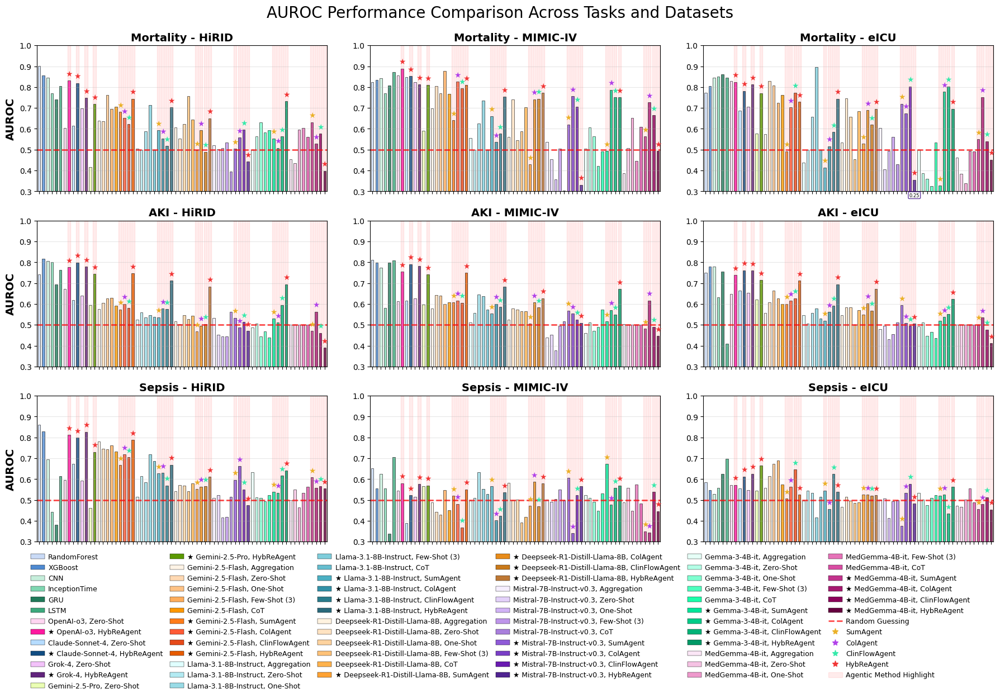


🎯 Generating AUPRC performance comparison...
AUPRC performance bar chart grid saved to: ./notebook_output/pulse_agents_overall/performance_metrics/auprc_performance_all.png


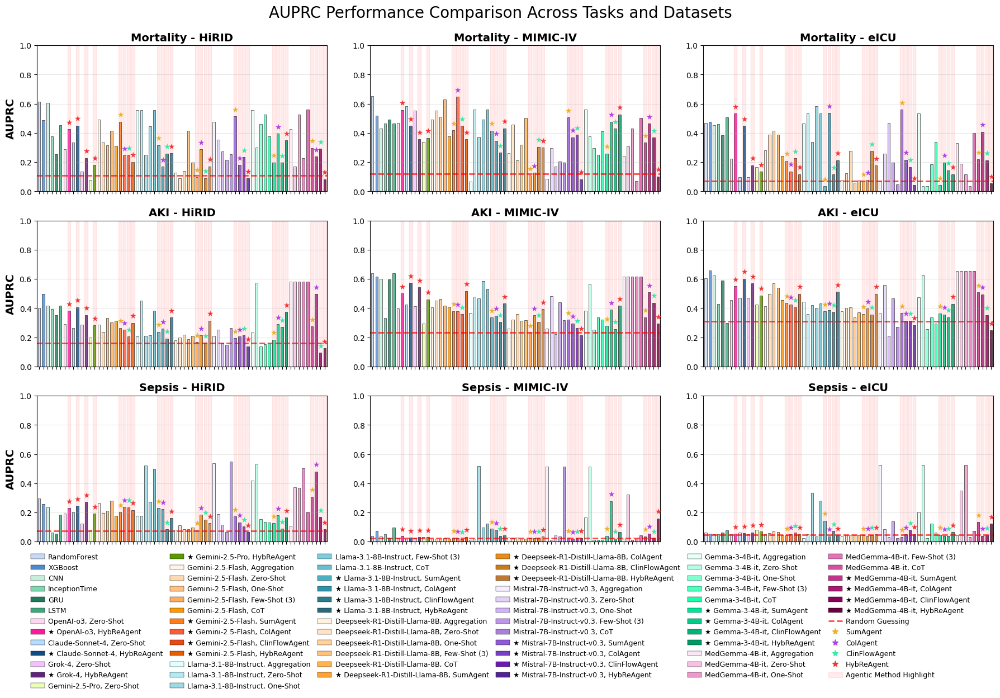


✅ Performance bar chart generation complete!
   Charts saved to: ./notebook_output/pulse_agents_overall/performance_metrics
   Generated charts for multiple metrics and model groups


In [5]:
# Generate performance bar charts for all models

# 1. AUROC performance comparison - All models
print(f"\n🎯 Generating AUROC performance comparison...")
auroc_all_path = os.path.join(
    performance_bar_chart_output_dir, "auroc_performance_all.png"
)
fig_auroc_all = create_performance_bar_chart_grid(
    df_metrics=df_metrics,
    metric="AUROC",
    save_path=auroc_all_path,
    models=None,  # Use all available models
    show_values=False,  # Too many models, disable value labels
    bar_width=0.6,
    ylim=(0.3, 1.0),
    random_guessing_value=None,
    xticklabel_fontsize=5,
    label_rotation=45,
    highlight_agents=True,
    with_legend=True,
    hide_xticklabels=True,  
)

# 2. AUPRC performance comparison - All models
print(f"\n🎯 Generating AUPRC performance comparison...")
auprc_all_path = os.path.join(
    performance_bar_chart_output_dir, "auprc_performance_all.png"
)
fig_auprc_all = create_performance_bar_chart_grid(
    df_metrics=df_metrics,
    metric="AUPRC",
    save_path=auprc_all_path,
    models=None,  # Use all available models
    show_values=False,  # Too many models, disable value labels
    bar_width=0.6,
    ylim=(0, 1),
    random_guessing_value=None,  # Will use task-specific class prevalence
    xticklabel_fontsize=5,
    label_rotation=45,
    highlight_agents=True,
    with_legend=True,
    hide_xticklabels=True,
)

print(f"\n✅ Performance bar chart generation complete!")
print(f"   Charts saved to: {performance_bar_chart_output_dir}")
print(f"   Generated charts for multiple metrics and model groups")


🎯 Generating additional performance metrics with all prompting IDs...

📊 Generating nAUPRC performance comparison...
Normalized AUPRC performance bar chart grid saved to: ./notebook_output/pulse_agents_overall/performance_metrics/nauprc_performance_all.png


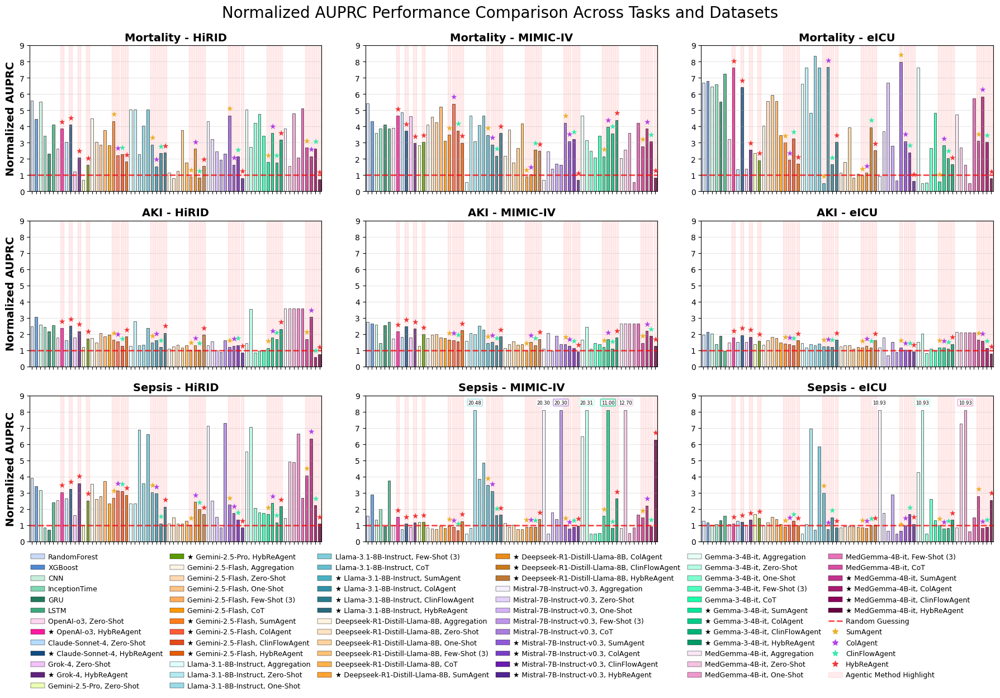


🎯 Generating MCC performance comparison...
MCC performance bar chart grid saved to: ./notebook_output/pulse_agents_overall/performance_metrics/mcc_performance_all.png


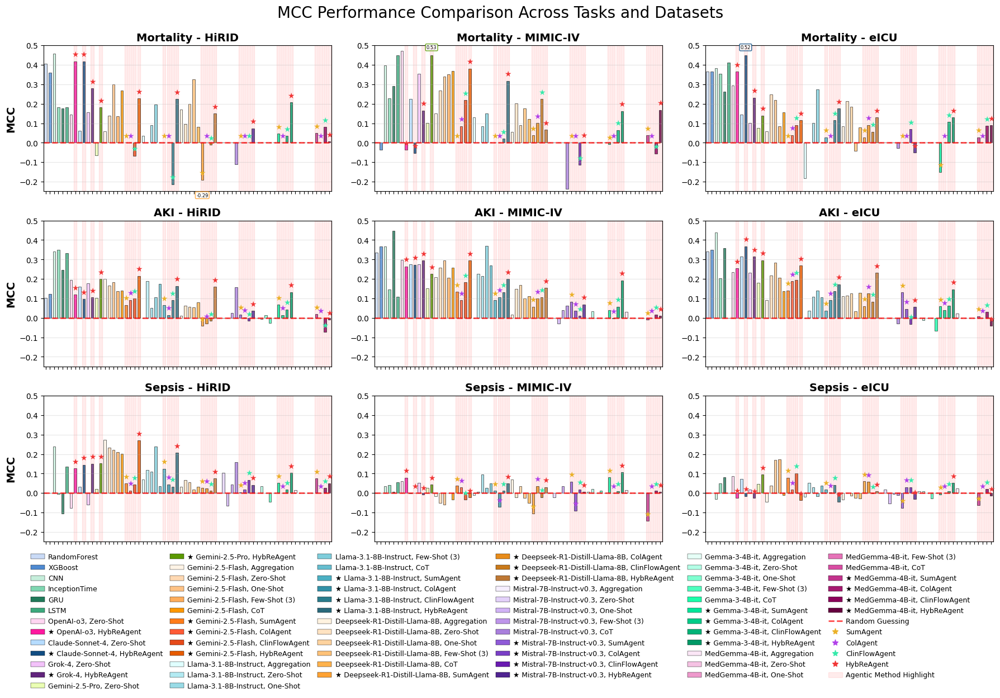


📊 Generating Min(+P, Se) performance comparison...
Min(+P, Se) performance bar chart grid saved to: ./notebook_output/pulse_agents_overall/performance_metrics/min_precision_sensitivity_performance_all.png


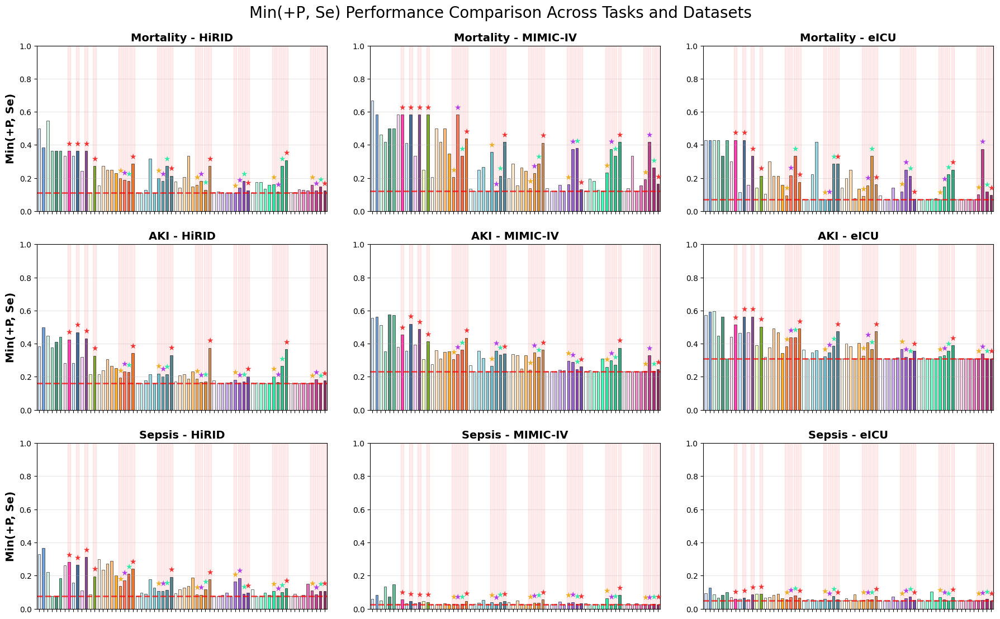


📊 Generating F1 Score performance comparison...
F1 Score performance bar chart grid saved to: ./notebook_output/pulse_agents_overall/performance_metrics/f1_score_performance_all.png


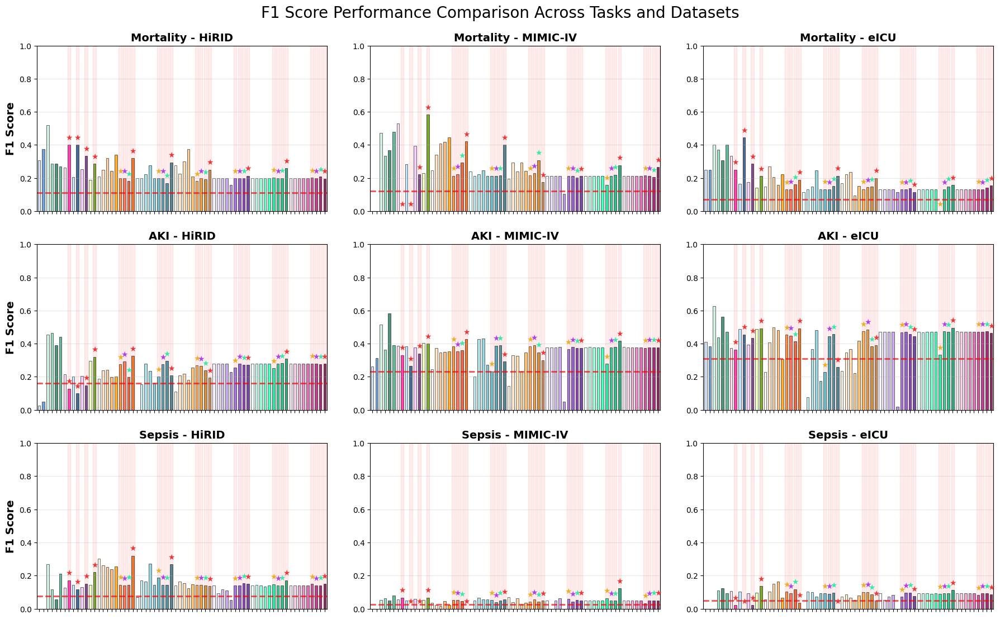


📊 Generating Balanced Accuracy performance comparison...
Balanced Accuracy performance bar chart grid saved to: ./notebook_output/pulse_agents_overall/performance_metrics/balanced_accuracy_performance_all.png


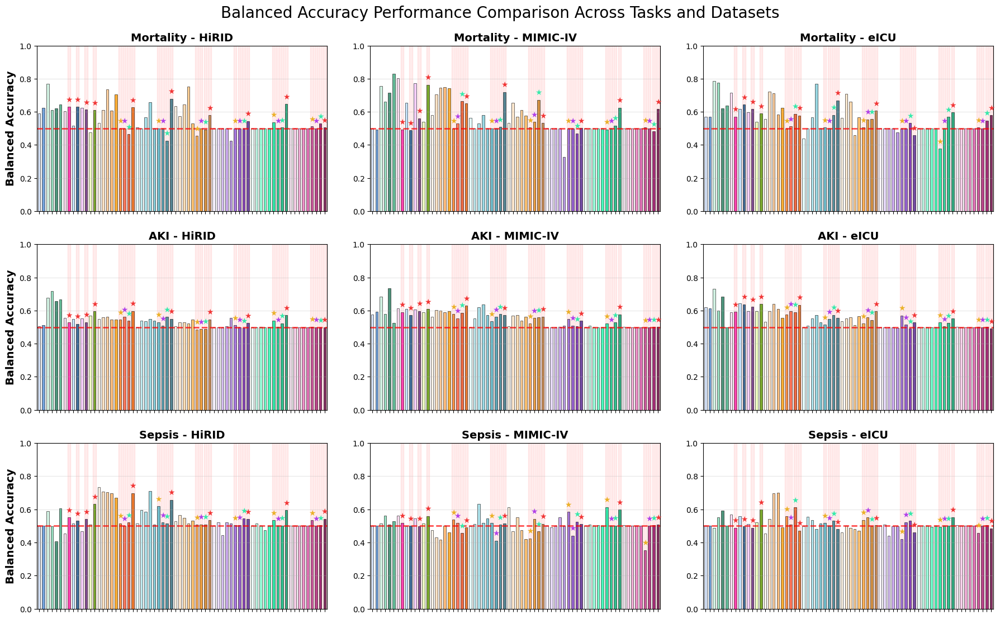


✅ Additional performance metrics generation complete!
   Generated charts for: AUPRC, Min(+P, Se), F1 Score, Balanced Accuracy
   All charts include agent highlighting and use all available prompting IDs
   Charts saved to: ./notebook_output/pulse_agents_overall/performance_metrics


In [6]:
# Generate additional performance metrics for all prompting IDs

print(f"\n🎯 Generating additional performance metrics with all prompting IDs...")

# nAUPRC performance comparison - All models
print(f"\n📊 Generating nAUPRC performance comparison...")
auprc_raw_all_path = os.path.join(
    performance_bar_chart_output_dir, "nauprc_performance_all.png"
)
fig_auprc_raw_all = create_performance_bar_chart_grid(
    df_metrics=df_metrics,
    metric="Normalized AUPRC",
    save_path=auprc_raw_all_path,
    models=None,  # Use all available models
    show_values=False,  # Too many models, disable value labels
    bar_width=0.6,
    ylim=(0, 9),
    random_guessing_value=None,  # Will use task-specific class prevalence
    xticklabel_fontsize=6,
    label_rotation=45,
    highlight_agents=True,
    with_legend=True,
    hide_xticklabels=True,
)

# MCC performance comparison - All models
print(f"\n🎯 Generating MCC performance comparison...")
mcc_all_path = os.path.join(performance_bar_chart_output_dir, "mcc_performance_all.png")
fig_mcc_all = create_performance_bar_chart_grid(
    df_metrics=df_metrics,
    metric="MCC",
    save_path=mcc_all_path,
    models=None,  # Use all available models
    show_values=False,  # Too many models, disable value labels
    bar_width=0.6,
    ylim=(-0.25, 0.5),
    random_guessing_value=None,
    xticklabel_fontsize=5,
    label_rotation=45,
    highlight_agents=True,
    with_legend=True,
    hide_xticklabels=True,
)

# Min(+P, Se) performance comparison - All models
print(f"\n📊 Generating Min(+P, Se) performance comparison...")
min_prec_sens_all_path = os.path.join(
    performance_bar_chart_output_dir, "min_precision_sensitivity_performance_all.png"
)
fig_min_prec_sens_all = create_performance_bar_chart_grid(
    df_metrics=df_metrics,
    metric="Min(+P, Se)",
    save_path=min_prec_sens_all_path,
    models=None,  # Use all available models
    show_values=False,  # Too many models, disable value labels
    bar_width=0.6,
    ylim=(0, 1.0),
    random_guessing_value=None,  # Will use task-specific class prevalence
    xticklabel_fontsize=6,
    label_rotation=45,
    highlight_agents=True,
    hide_xticklabels=True,
)

# F1 Score performance comparison - All models
print(f"\n📊 Generating F1 Score performance comparison...")
f1_score_all_path = os.path.join(
    performance_bar_chart_output_dir, "f1_score_performance_all.png"
)
fig_f1_score_all = create_performance_bar_chart_grid(
    df_metrics=df_metrics,
    metric="F1 Score",
    save_path=f1_score_all_path,
    models=None,  # Use all available models
    show_values=False,  # Too many models, disable value labels
    bar_width=0.6,
    ylim=(0, 1.0),
    random_guessing_value=None,  # Will use task-specific class prevalence
    xticklabel_fontsize=6,
    label_rotation=45,
    highlight_agents=True,
    hide_xticklabels=True,
)

# 4. Balanced Accuracy performance comparison - All models
print(f"\n📊 Generating Balanced Accuracy performance comparison...")
balanced_acc_all_path = os.path.join(
    performance_bar_chart_output_dir, "balanced_accuracy_performance_all.png"
)
fig_balanced_acc_all = create_performance_bar_chart_grid(
    df_metrics=df_metrics,
    metric="Balanced Accuracy",
    save_path=balanced_acc_all_path,
    models=None,  # Use all available models
    show_values=False,  # Too many models, disable value labels
    bar_width=0.6,
    ylim=(0, 1.0),
    random_guessing_value=0.5,  # Balanced accuracy random baseline is 0.5
    xticklabel_fontsize=6,
    label_rotation=45,
    highlight_agents=True,
    hide_xticklabels=True,
)

print(f"\n✅ Additional performance metrics generation complete!")
print(f"   Generated charts for: AUPRC, Min(+P, Se), F1 Score, Balanced Accuracy")
print(f"   All charts include agent highlighting and use all available prompting IDs")
print(f"   Charts saved to: {performance_bar_chart_output_dir}")

#### Subgroup Fairness Analysis

In [7]:
def create_subgroup_fairness_grid(df_metrics_subgroup, metric='auroc', ylim=(0, 1.0), random_guessing_value=0.5, save_path=None, models=None, xticklabel_fontsize=9, label_rotation=45, s=30):
    """
    Create a grid visualization showing subgroup fairness for any metric.
    Rows = Tasks, Columns = Datasets, each subplot shows model performance with subgroup deviations.
    
    Args:
        df_metrics_subgroup (DataFrame): Metrics DataFrame with overall and subgroup data
        metric (str): Metric to plot (column name)
        ylim (tuple): y-axis limits for the plot
        random_guessing_value (float): Value for random guessing line
        save_path (str): Optional path to save the figure
        models (str or list of str, optional): Model name or list of model names to include. If None, use all models in the data.
        xticklabel_fontsize (int): Font size for x-axis tick labels (default: 9)
        s (int): Marker size for scatter plot (default: 30)
    """

    # Get unique tasks and datasets from the data
    tasks = list(df_metrics_subgroup["Task"].unique())
    datasets = list(df_metrics_subgroup["Dataset"].unique())

    # Determine models to use
    if models is None:
        # List CONVML_MODELS and CONVDL_MODELS first, then the rest in order of appearance
        all_model_ids = list(df_metrics_subgroup['model_prompting_id'].unique())
        ordered_models = CONVML_MODELS + CONVDL_MODELS
        # Add any remaining models not in the above lists
        ordered_models += [m for m in all_model_ids if m not in ordered_models]
        models = ordered_models
    elif isinstance(models, str):
        models = [models]
    else:
        models = list(models)

    # Create figure with grid based on unique tasks and datasets
    fig, axes = plt.subplots(len(tasks), len(datasets), figsize=(18, 12))
    if len(tasks) == 1 and len(datasets) == 1:
        axes = np.array([[axes]])
    elif len(tasks) == 1 or len(datasets) == 1:
        axes = axes.reshape((len(tasks), len(datasets)))
    fig.suptitle(f'{metric} Subgroup Fairness Analysis: Performance Deviations by Demographics', fontsize=20, y=0.98)

    # Plot each task-dataset combination
    for i, task in enumerate(tasks):
        for j, dataset in enumerate(datasets):
            ax = axes[i, j]

            # Filter data for this task-dataset combination
            task_dataset_data = df_metrics_subgroup[
                (df_metrics_subgroup["Task"] == task)
                & (df_metrics_subgroup["Dataset"] == dataset)
            ]

            if task_dataset_data.empty:
                ax.text(0.5, 0.5, 'No data\navailable', ha='center', va='center', 
                       transform=ax.transAxes, fontsize=10)
                ax.set_title(f'{task} - {dataset}', fontsize=11, fontweight='bold')
                continue

            # Create the subgroup fairness plot for this combination
            create_single_fairness_plot(task_dataset_data, ax, models, metric, ylim, xticklabel_fontsize=xticklabel_fontsize, label_rotation=label_rotation, s=s)

            # Set title
            ax.set_title(f'{task} - {dataset}', fontsize=14, alpha=1.0, fontweight='bold')

            # Customize axes
            ax.set_ylim(ylim)
            ax.set_xlim(-0.5, len(models) - 0.5)
            ax.grid(True, alpha=0.3, axis='y')

            # Add random guessing line
            ax.axhline(y=random_guessing_value, color='red', linestyle='--', alpha=0.5, linewidth=1, zorder=1)

            # Add vertical grid lines between model ticks
            for grid_pos in np.arange(len(models) - 1) + 0.5:
                ax.axvline(
                    x=grid_pos,
                    color="black",
                    alpha=0.7,
                    linewidth=0.8,
                    zorder=0,
                    linestyle=(0, (1, 3)),
                )

            ax.tick_params(axis='x', labelsize=xticklabel_fontsize)
            ax.tick_params(axis='y', labelsize=9)

            # Only show y-label on leftmost column
            if j == 0:
                ax.set_ylabel(metric, fontsize=14, fontweight='bold')
            else:
                ax.set_ylabel('')

    # Create comprehensive legend
    create_fairness_grid_legend(fig, metric)

    # Adjust layout
    plt.tight_layout()
    plt.subplots_adjust(top=0.92, bottom=0.15, hspace=0.2, wspace=0.15)

    # Save if path provided
    if save_path:
        os.makedirs(os.path.dirname(save_path), exist_ok=True)
        plt.savefig(save_path, dpi=400, bbox_inches='tight', format='png')
        print(f"{metric} fairness grid saved to: {save_path}")

    plt.show()
    return fig


def create_single_fairness_plot(task_dataset_data, ax, models, metric, ylim_config, xticklabel_fontsize=9, label_rotation=45, s=30):
    """
    Create a single subplot showing model performance with subgroup deviations.
    Overall performance is shown as a line, subgroups deviate up/down from this baseline.
    Handles outliers for any metric that fall outside the configured y-axis range.
    """
    x_positions = np.arange(len(models))

    # Use the configured y-axis limits for outlier detection
    y_min, y_max = ylim_config

    for i, model in enumerate(models):
        model_data = task_dataset_data[task_dataset_data['model_prompting_id'] == model]

        if model_data.empty:
            continue

        # Get overall performance
        overall_data = model_data[model_data['subgroup_type'] == 'Overall']
        if overall_data.empty:
            continue

        overall_value = overall_data[metric].iloc[0]
        model_color = get_model_prompting_id_color(model)

        # Plot overall performance as a horizontal line segment
        ax.plot([i-0.4, i+0.4], [overall_value, overall_value], 
               color=model_color, linewidth=3, alpha=0.8, zorder=2)

        # Plot subgroup deviations
        subgroup_data = model_data[model_data['subgroup_type'] != 'Overall']
        ordered_subgroups = get_ordered_subgroups(subgroup_data, metric)

        # Calculate evenly spaced positions
        if len(ordered_subgroups) > 1:
            positions = np.linspace(-0.38, 0.38, len(ordered_subgroups))
        elif len(ordered_subgroups) == 1:
            positions = [0]
        else:
            positions = []

        # Plot each subgroup with evenly spaced positions
        for idx, (subgroup_type, subgroup_value, subgroup_metric_value) in enumerate(ordered_subgroups):
            subgroup_color = SUBGROUP_MAPPING[subgroup_type][subgroup_value]
            x_pos = i + positions[idx]

            # Check if value is outside configured y-axis range
            is_outlier_high = subgroup_metric_value > y_max
            is_outlier_low = subgroup_metric_value < y_min
            is_outlier = is_outlier_high or is_outlier_low

            if is_outlier:
                # Determine outlier position within plot bounds
                if is_outlier_high:
                    outlier_y = y_max * 0.94  # Position slightly below top
                else:
                    outlier_y = y_min + (y_max - y_min) * 0.08  # Position slightly above bottom

                # Plot annotation box with actual value
                ax.annotate(f'{subgroup_metric_value:.1f}', 
                           xy=(x_pos, outlier_y), 
                           xytext=(0, 0), textcoords='offset points',
                           ha='center', va='center', fontsize=6,
                           bbox=dict(boxstyle='round,pad=0.15', facecolor='white', edgecolor=subgroup_color, alpha=0.8))

                # Draw line from overall to the outlier box with triangle end
                ax.plot([x_pos, x_pos], [overall_value, outlier_y], 
                       color=subgroup_color, linewidth=1, alpha=0.6, zorder=1)
                triangle_height = (y_max - y_min) * 0.03
                triangle_offset = (y_max - y_min) * 0.05

                if is_outlier_high:
                    # Triangle pointing up, positioned below the box
                    triangle_y = outlier_y - triangle_height - triangle_offset
                    ax.scatter(x_pos, triangle_y, marker='^', s=s, color=subgroup_color, alpha=0.8, zorder=1)
                else:
                    # Triangle pointing down, positioned above the box
                    triangle_y = outlier_y + triangle_height + triangle_offset
                    ax.scatter(x_pos, triangle_y, marker='v', s=s, color=subgroup_color, alpha=0.8, zorder=1)

            else:
                # Normal plotting for values within range
                # Plot point
                ax.scatter(x_pos, subgroup_metric_value, 
                         color=subgroup_color, s=s, alpha=0.8, 
                         edgecolors='black', linewidth=0.5, zorder=3)

                # Draw vertical line from overall performance to subgroup performance
                ax.plot([x_pos, x_pos], [overall_value, subgroup_metric_value], 
                       color=subgroup_color, linewidth=1, alpha=0.6, zorder=1)

    # Set x-axis
    ax.set_xticks(x_positions)
    # Only set xticklabels in the last (third) row
    if ax.get_subplotspec().rowspan.stop == 3:
        ax.set_xticklabels(models, rotation=label_rotation, ha='right', fontsize=xticklabel_fontsize)
    else:
        ax.set_xticklabels([])


def get_ordered_subgroups(subgroup_data, metric):
    """Get subgroups in the order they appear in the data."""
    ordered_subgroups = []
    for idx, row in subgroup_data.iterrows():
        ordered_subgroups.append((row['subgroup_type'], row['subgroup_value'], row[metric]))
    return ordered_subgroups


def create_fairness_grid_legend(fig, metric_label):
    """Create a legend with 4 columns: general, sex, age, BMI."""

    # Column 1: General (3 elements)
    general = [
        plt.Line2D([0], [0], color='black', linewidth=3, label='Overall Performance', alpha=0.8),
        plt.Line2D([0], [0], color="black", linewidth=1, linestyle="--", label="Random Guessing", alpha=0.5),
        plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='gray', markersize=8, label='Subgroup Performance', alpha=0.8)
    ]

    # Column 2: Sex (2 elements)
    sex = [
        plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=SUBGROUP_MAPPING['Sex']['Male'], markersize=6, label='Male'),
        plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=SUBGROUP_MAPPING['Sex']['Female'], markersize=6, label='Female')
    ]

    # Column 3: Age (3 elements)
    age = [
        plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=SUBGROUP_MAPPING['Age']['18-65 Years'], markersize=6, label='18-65 Years'),
        plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=SUBGROUP_MAPPING['Age']['65-75 Years'], markersize=6, label='65-75 Years'),
        plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=SUBGROUP_MAPPING['Age']['75-91 Years'], markersize=6, label='75-91 Years')
    ]

    # Column 4: BMI (4 elements)
    bmi = [
        plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=SUBGROUP_MAPPING['BMI']['BMI < 18.5 kg/m2'], markersize=6, label='BMI < 18.5 kg/m2'),
        plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=SUBGROUP_MAPPING['BMI']['BMI 18.5-25 kg/m2'], markersize=6, label='BMI 18.5-25 kg/m2'),
        plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=SUBGROUP_MAPPING['BMI']['BMI 25-30 kg/m2'], markersize=6, label='BMI 25-30 kg/m2'),
        plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=SUBGROUP_MAPPING['BMI']['BMI > 30 kg/m2'], markersize=6, label='BMI > 30 kg/m2')
    ]

    # Combine into 4 columns by organizing elements row-wise
    legend_elements = []

    # Add all elements from each group sequentially (each group becomes a row)
    legend_element_padding = [plt.Line2D([0], [0], color="white", alpha=0, label="")]
    legend_elements.extend(general + legend_element_padding)
    legend_elements.extend(sex + legend_element_padding * 2)
    legend_elements.extend(age + legend_element_padding * 1)
    legend_elements.extend(bmi)

    fig.legend(
        handles=legend_elements,
        loc="lower center",
        bbox_to_anchor=(0.5, -0.02),
        ncol=4,
        fontsize=10,
        handletextpad=0.5,
        columnspacing=1.0,
        handlelength=1.5,
        labelspacing=0.3,  # Reduces spacing between rows
    )


# Create subgroup fairness grids for different metrics
fairness_output_dir = os.path.join(OUTPUT_BASE_DIR, "subgroup_fairness")

In [8]:
# # AUROC fairness grid
# auroc_output_path = os.path.join(
#     fairness_output_dir, "subgroup_fairness_auroc_all_models_benchmark.png"
# )
# fig_auroc = create_subgroup_fairness_grid(
#     df_metrics_subgroup_benchmark,
#     metric="AUROC",
#     ylim=(0, 1.0),
#     random_guessing_value=0.5,
#     save_path=auroc_output_path,
#     models=None,  # Use all models
#     xticklabel_fontsize=4,
#     label_rotation=45,
#     s=10,
# )

# # Normalized AUPRC fairness grid
# nauprc_output_path = os.path.join(
#     fairness_output_dir, "subgroup_fairness_normalized_auprc_all_models_benchmark.png"
# )
# fig_nauprc = create_subgroup_fairness_grid(
#     df_metrics_subgroup_benchmark,
#     metric="Normalized AUPRC",
#     ylim=(0, 15.0),
#     random_guessing_value=1.0,
#     save_path=nauprc_output_path,
#     models=None,  # Use all models
#     xticklabel_fontsize=4,
#     label_rotation=45,
#     s=10,
# )

# # MCC fairness grid
# mcc_output_path = os.path.join(fairness_output_dir, "subgroup_fairness_mcc_all_models_benchmark.png")
# fig_mcc = create_subgroup_fairness_grid(
#     df_metrics_subgroup_benchmark,
#     metric="MCC",
#     ylim=(-0.25, 1.0),
#     random_guessing_value=0.0,
#     save_path=mcc_output_path,
#     models=None,  # Use all models
#     xticklabel_fontsize=4,
#     label_rotation=45,
#     s=10,
# )

In [9]:
# # AUROC fairness grid
# auroc_output_path = os.path.join(
#     fairness_output_dir, "subgroup_fairness_auroc_all_models_agents.png"
# )
# fig_auroc = create_subgroup_fairness_grid(
#     df_metrics_subgroup_agents,
#     metric="AUROC",
#     ylim=(0, 1.0),
#     random_guessing_value=0.5,
#     save_path=auroc_output_path,
#     models=None,  # Use all models
#     xticklabel_fontsize=4,
#     label_rotation=45,
#     s=10,
# )

# # Normalized AUPRC fairness grid
# nauprc_output_path = os.path.join(
#     fairness_output_dir, "subgroup_fairness_normalized_auprc_all_models_agents.png"
# )
# fig_nauprc = create_subgroup_fairness_grid(
#     df_metrics_subgroup_agents,
#     metric="Normalized AUPRC",
#     ylim=(0, 15.0),
#     random_guessing_value=1.0,
#     save_path=nauprc_output_path,
#     models=None,  # Use all models
#     xticklabel_fontsize=4,
#     label_rotation=45,
#     s=10,
# )

# # MCC fairness grid
# mcc_output_path = os.path.join(
#     fairness_output_dir, "subgroup_fairness_mcc_all_models_agents.png"
# )
# fig_mcc = create_subgroup_fairness_grid(
#     df_metrics_subgroup_agents,
#     metric="MCC",
#     ylim=(-0.25, 1.0),
#     random_guessing_value=0.0,
#     save_path=mcc_output_path,
#     models=None,  # Use all models
#     xticklabel_fontsize=4,
#     label_rotation=45,
#     s=10,
# )

In [10]:
def create_subgroup_fairness_column(df_metrics_subgroup, task=None, metric='AUROC', ylim=(0, 1.0), random_guessing_value=0.5, save_path=None, models=None, xticklabel_fontsize=9, label_rotation=45, s=30, highlight_agents=False):
    """
    Create a column visualization showing subgroup fairness for any metric.
    All 9 task-dataset combinations displayed vertically in a single column.
    
    Args:
        df_metrics_subgroup (DataFrame): Metrics DataFrame with overall and subgroup data
        task (str): Specific task to filter by (optional, if None, shows all tasks)
        metric (str): Metric to plot (column name)
        ylim (tuple): y-axis limits for the plot
        random_guessing_value (float): Value for random guessing line (if None, calculates task-specific values)
        save_path (str): Optional path to save the figure
        models (str or list of str, optional): Model name or list of model names to include. If None, use all models in the data.
        xticklabel_fontsize (int): Font size for x-axis tick labels (default: 9)
        label_rotation (int): Rotation angle for x-axis labels (default: 45)
        s (int): Marker size for scatter plot (default: 30)
        highlight_agents (bool): Whether to highlight agent methods with red background (default: False)
    """

    # Get unique tasks and datasets from the data
    # Filter by task if specified
    if task is not None:
        df_metrics_subgroup = df_metrics_subgroup[df_metrics_subgroup["Task"] == task]
        if df_metrics_subgroup.empty:
            print(f"No data found for task: {task}")
            return None
    datasets = list(df_metrics_subgroup["Dataset"].unique())

    # Determine models to use
    if models is None:
        # List CONVML_MODELS and CONVDL_MODELS first, then the rest in order of appearance
        all_model_ids = list(df_metrics_subgroup['model_prompting_id'].unique())
        ordered_models = CONVML_MODELS + CONVDL_MODELS
        # Add any remaining models not in the above lists
        ordered_models += [m for m in all_model_ids if m not in ordered_models]
        models = ordered_models
    elif isinstance(models, str):
        models = [models]
    else:
        models = list(models)

    # Create all task-dataset combinations
    combinations = []
    if task is not None:
        for dataset in datasets:
            combinations.append((task, dataset))
    else:
        for t in tasks:
            for dataset in datasets:
                combinations.append((t, dataset))

    # Create figure with single column layout (9 rows, 1 column)
    fig, axes = plt.subplots(len(combinations), 1, figsize=(18, 3 * len(combinations)))
    if len(combinations) == 1:
        axes = [axes]  # Ensure axes is always a list

    title_task = f" ({task})" if task is not None else ""
    fig.suptitle(
        f"{metric} Subgroup Fairness Analysis{title_task}: Performance Deviations by Demographics",
        fontsize=20,
        y=0.98,
    )

    # Define class prevalence for baseline calculations
    class_prevalence = {
        "Mortality": {"HiRID": 0.110, "MIMIC-IV": 0.120, "eICU": 0.070},
        "AKI": {"HiRID": 0.162, "MIMIC-IV": 0.233, "eICU": 0.310},
        "Sepsis": {"HiRID": 0.075, "MIMIC-IV": 0.025, "eICU": 0.048},
    }

    # Plot each task-dataset combination
    for idx, (task, dataset) in enumerate(combinations):
        ax = axes[idx]

        # Filter data for this task-dataset combination
        task_dataset_data = df_metrics_subgroup[
            (df_metrics_subgroup["Task"] == task)
            & (df_metrics_subgroup["Dataset"] == dataset)
        ]

        if task_dataset_data.empty:
            ax.text(0.5, 0.5, 'No data\navailable', ha='center', va='center', 
                   transform=ax.transAxes, fontsize=10)
            ax.set_title(f'{task} - {dataset}', fontsize=12, fontweight='bold')
            continue

        # Highlight agent methods with red background
        if highlight_agents:
            for i, model in enumerate(models):
                is_agent = any(agent_id in model for agent_id in AGENTIC_PROMPTING_IDS)
                if is_agent:
                    # Add subtle red background highlight
                    ax.axvspan(
                        i - 0.45,
                        i + 0.45,
                        alpha=0.075,
                        color='red',
                        zorder=0
                    )

        # Create the subgroup fairness plot for this combination
        create_single_fairness_plot(task_dataset_data, ax, models, metric, ylim, xticklabel_fontsize=xticklabel_fontsize, label_rotation=label_rotation, s=s)

        # Set title
        ax.set_title(f'{task} - {dataset}', fontsize=14, alpha=1.0, fontweight='bold')

        # Customize axes
        ax.set_ylim(ylim)
        ax.set_xlim(-0.5, len(models) - 0.5)
        ax.grid(True, alpha=0.3, axis='y')

        # Calculate baseline value for this task-dataset combination if needed
        if random_guessing_value is None:
            prevalence = class_prevalence.get(task, {}).get(dataset, 0.5)
            baseline_value = {
                "AUROC": 0.5,
                "AUPRC": prevalence,
                "Normalized AUPRC": 1.0,
                "Min(+P, Se)": prevalence,
                "Sensitivity (Recall)": prevalence,
                "Specificity": 1 - prevalence,
                "Precision": prevalence,
                "F1 Score": prevalence,
                "Accuracy": max(prevalence, 1 - prevalence),
                "Balanced Accuracy": 0.5,
                "MCC": 0.0,
                "Cohen's Kappa": 0.0,
            }.get(metric, 0.0)
        else:
            baseline_value = random_guessing_value

        # Add random guessing line
        ax.axhline(y=baseline_value, color='red', linestyle='--', alpha=0.5, linewidth=1, zorder=1)

        # Add vertical grid lines between model ticks
        for grid_pos in np.arange(len(models) - 1) + 0.5:
            ax.axvline(
                x=grid_pos,
                color="black",
                alpha=0.7,
                linewidth=0.8,
                zorder=0,
                linestyle=(0, (1, 3)),
            )

        ax.tick_params(axis='x', labelsize=xticklabel_fontsize)
        ax.tick_params(axis='y', labelsize=9)

        # Show y-label on all subplots
        ax.set_ylabel(metric, fontsize=12, fontweight='bold')

        # Only show x-labels on the bottom plot
        if idx == len(combinations) - 1:
            ax.set_xticklabels(models, rotation=label_rotation, ha='right', fontsize=xticklabel_fontsize)
        else:
            ax.set_xticklabels([])

    # Create comprehensive legend
    create_fairness_grid_legend(fig, metric)

    # Add note about agent highlighting if enabled
    if highlight_agents:
        fig.text(
            0.02, 0.02,
            "Red Background = Agentic Method",
            fontsize=10,
            bbox=dict(boxstyle="round,pad=0.3", facecolor="white", edgecolor="red", alpha=0.8),
            transform=fig.transFigure
        )

    # Adjust layout
    plt.tight_layout()
    plt.subplots_adjust(top=0.92, bottom=0.30, hspace=0.2)

    # Save if path provided
    if save_path:
        os.makedirs(os.path.dirname(save_path), exist_ok=True)
        plt.savefig(save_path, dpi=400, bbox_inches='tight', format='png')
        print(f"{metric} fairness column chart saved to: {save_path}")

    plt.show()
    return fig

AUROC fairness column chart saved to: ./notebook_output/pulse_agents_overall/subgroup_fairness/subgroup_fairness_auroc_column_Mortality.png


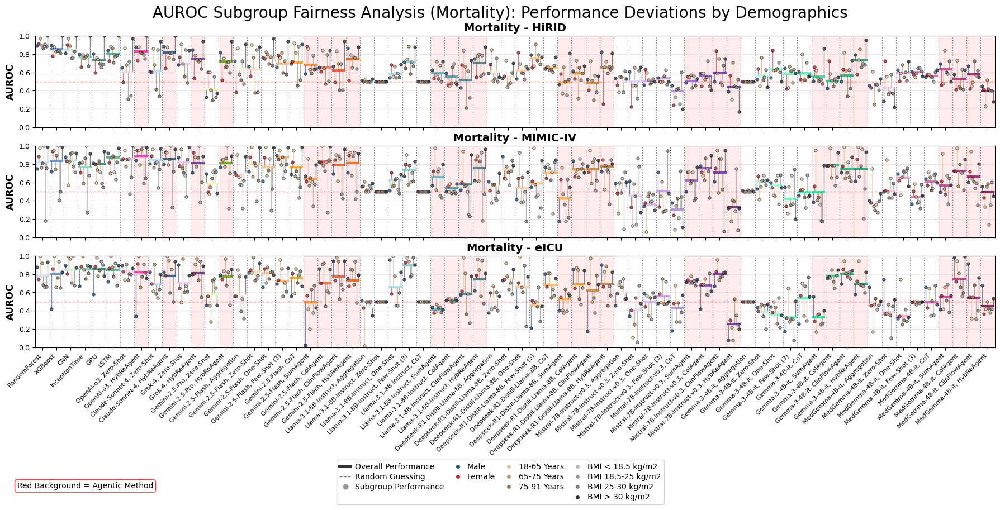

AUROC fairness column chart saved to: ./notebook_output/pulse_agents_overall/subgroup_fairness/subgroup_fairness_auroc_column_AKI.png


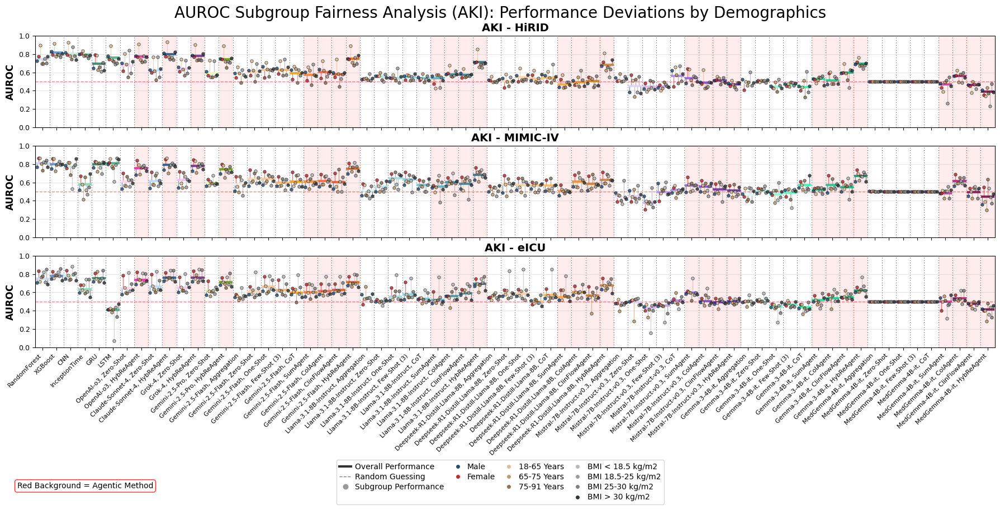

AUROC fairness column chart saved to: ./notebook_output/pulse_agents_overall/subgroup_fairness/subgroup_fairness_auroc_column_Sepsis.png


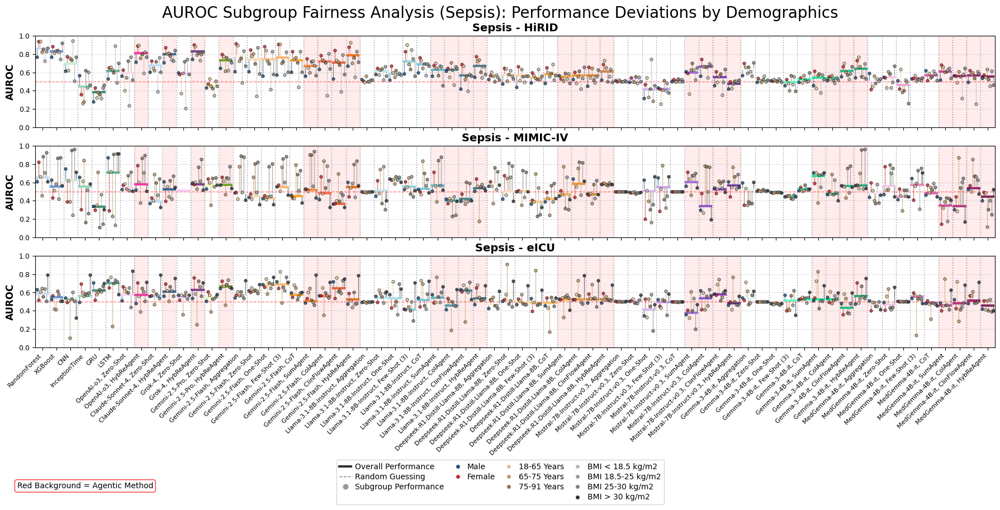

AUPRC fairness column chart saved to: ./notebook_output/pulse_agents_overall/subgroup_fairness/subgroup_fairness_AUPRC_column_Mortality.png


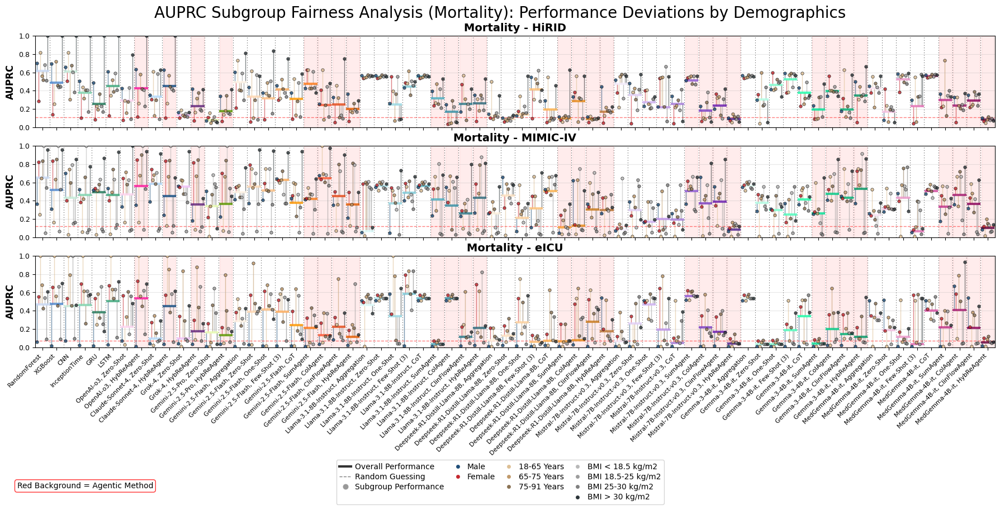

AUPRC fairness column chart saved to: ./notebook_output/pulse_agents_overall/subgroup_fairness/subgroup_fairness_AUPRC_column_AKI.png


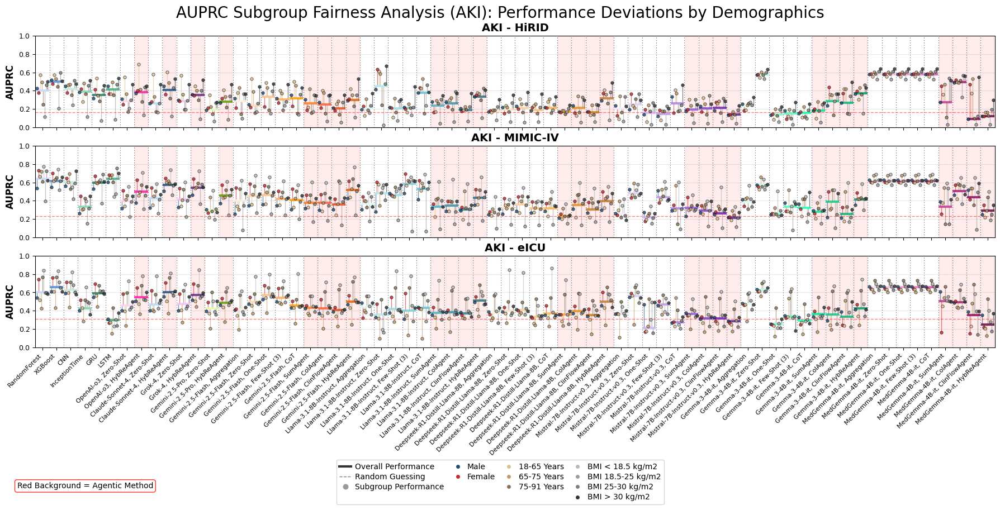

AUPRC fairness column chart saved to: ./notebook_output/pulse_agents_overall/subgroup_fairness/subgroup_fairness_AUPRC_column_Sepsis.png


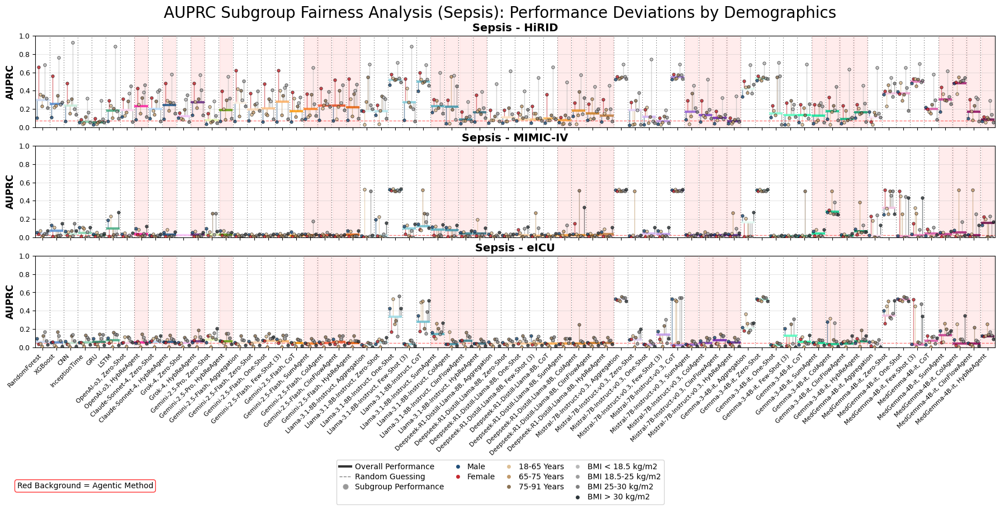

In [11]:
for task in ["Mortality", "AKI", "Sepsis"]:
    output_path = os.path.join(
        fairness_output_dir, f"subgroup_fairness_auroc_column_{task}.png"
    )
    create_subgroup_fairness_column(
        df_metrics_subgroup,
        task=task,
        metric="AUROC",
        ylim=(0, 1.0),
        random_guessing_value=None,
        save_path=output_path,
        models=None,
        xticklabel_fontsize=8,
        label_rotation=45,
        s=15,
        highlight_agents=True,
    )

for task in ["Mortality", "AKI", "Sepsis"]:
    output_path = os.path.join(
        fairness_output_dir, f"subgroup_fairness_AUPRC_column_{task}.png"
    )
    create_subgroup_fairness_column(
        df_metrics_subgroup,
        task=task,
        metric="AUPRC",
        ylim=(0, 1.0),
        random_guessing_value=None,
        save_path=output_path,
        models=None,
        xticklabel_fontsize=8,
        label_rotation=45,
        s=15,
        highlight_agents=True,
    )

In [15]:
def compute_subgroup_deviation(df_metrics_subgroup, metric, absolute=True):
    """
    Computes the deviation of each subgroup's metric value from the overall value for the same model, task, and dataset.
    Adds a new column 'subgroup_deviation' to the returned dataframe.

    Args:
        df_metrics_subgroup (DataFrame): DataFrame containing subgroup metrics.
        metric (str): The metric column to use (e.g., 'AUROC', 'AUPRC').
        absolute (bool): If True, returns absolute deviation; if False, returns signed deviation.

    Returns:
        DataFrame: Copy of input with 'subgroup_deviation' column.
    """
    df = df_metrics_subgroup.copy()
    # Only compute for rows where subgroup_type != 'Overall'
    # For each row, find the matching overall value for the same model_prompting_id, Task, Dataset
    overall_mask = df["subgroup_type"] == "Overall"
    # Build a lookup for overall metric values
    overall_lookup = df[overall_mask].set_index(
        ["model_prompting_id", "Task", "Dataset"]
    )[metric].to_dict()

    deviations = []
    for idx, row in df.iterrows():
        key = (row["model_prompting_id"], row["Task"], row["Dataset"])
        overall_value = overall_lookup.get(key, np.nan)
        subgroup_value = row[metric]
        if row["subgroup_type"] == "Overall":
            deviation = 0.0  # By definition, deviation for overall is zero
        else:
            deviation = subgroup_value - overall_value
            if absolute:
                deviation = abs(deviation)
        deviations.append(deviation)
    df["subgroup_deviation"] = deviations
    return df

/var/folders/r1/8n2p36gx2ydfw7wf826zxyh00000gn/T/ipykernel_1750/2923778061.py:44: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(


Violin plot saved to: ./notebook_output/pulse_agents_overall/subgroup_fairness/subgroup_fairness_violin_Mortality.png


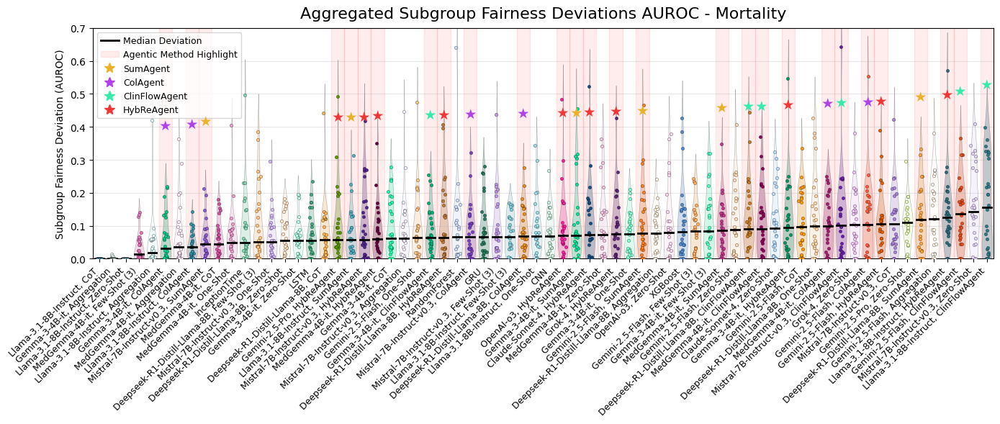

/var/folders/r1/8n2p36gx2ydfw7wf826zxyh00000gn/T/ipykernel_1750/2923778061.py:44: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(


Violin plot saved to: ./notebook_output/pulse_agents_overall/subgroup_fairness/subgroup_fairness_violin_AKI.png


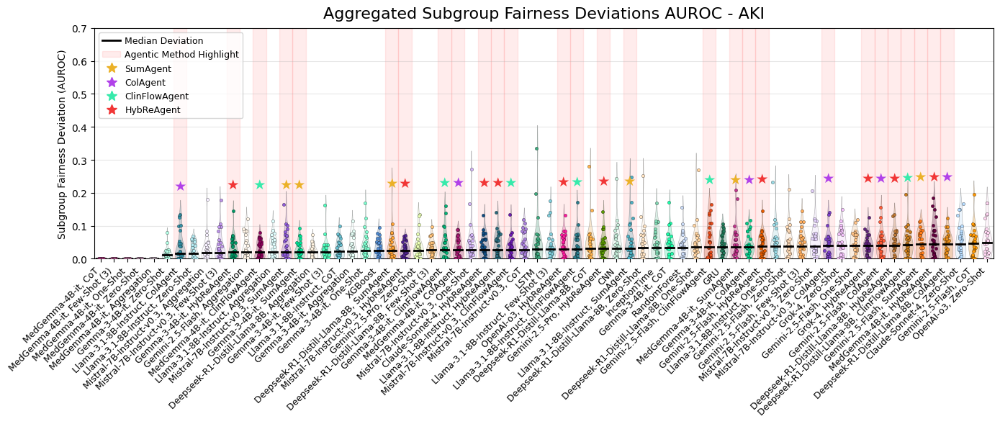

/var/folders/r1/8n2p36gx2ydfw7wf826zxyh00000gn/T/ipykernel_1750/2923778061.py:44: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(


Violin plot saved to: ./notebook_output/pulse_agents_overall/subgroup_fairness/subgroup_fairness_violin_Sepsis.png


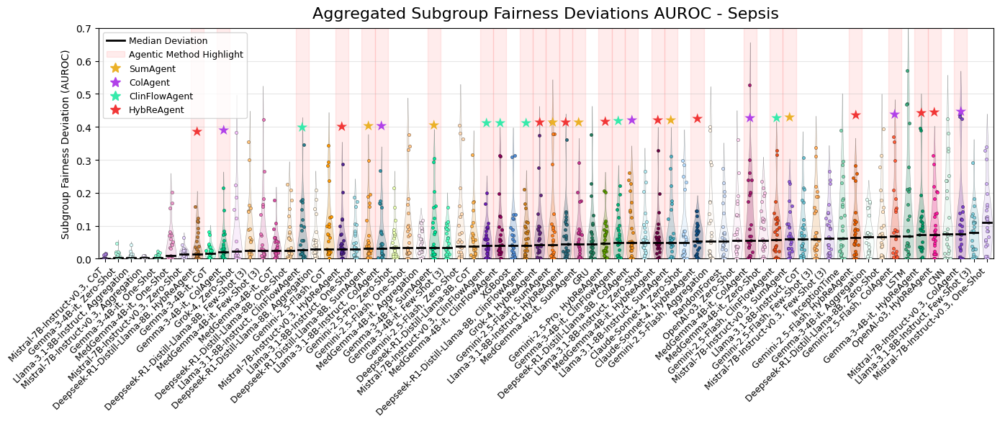

/var/folders/r1/8n2p36gx2ydfw7wf826zxyh00000gn/T/ipykernel_1750/2923778061.py:44: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(


Violin plot saved to: ./notebook_output/pulse_agents_overall/subgroup_fairness/subgroup_fairness_violin_Mortality.png


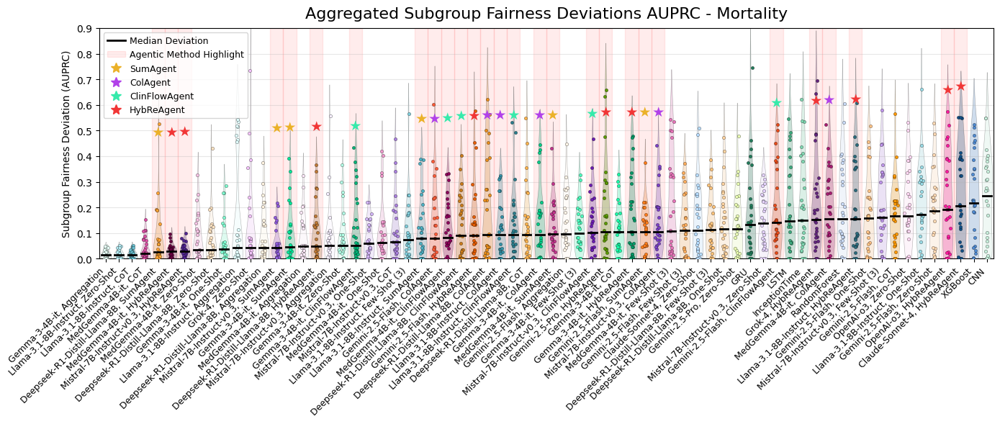

/var/folders/r1/8n2p36gx2ydfw7wf826zxyh00000gn/T/ipykernel_1750/2923778061.py:44: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(


Violin plot saved to: ./notebook_output/pulse_agents_overall/subgroup_fairness/subgroup_fairness_violin_AKI.png


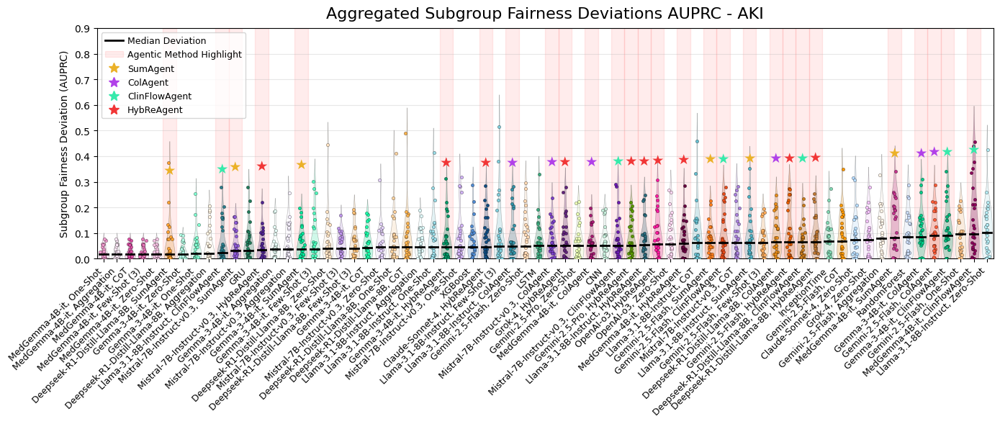

/var/folders/r1/8n2p36gx2ydfw7wf826zxyh00000gn/T/ipykernel_1750/2923778061.py:44: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(


Violin plot saved to: ./notebook_output/pulse_agents_overall/subgroup_fairness/subgroup_fairness_violin_Sepsis.png


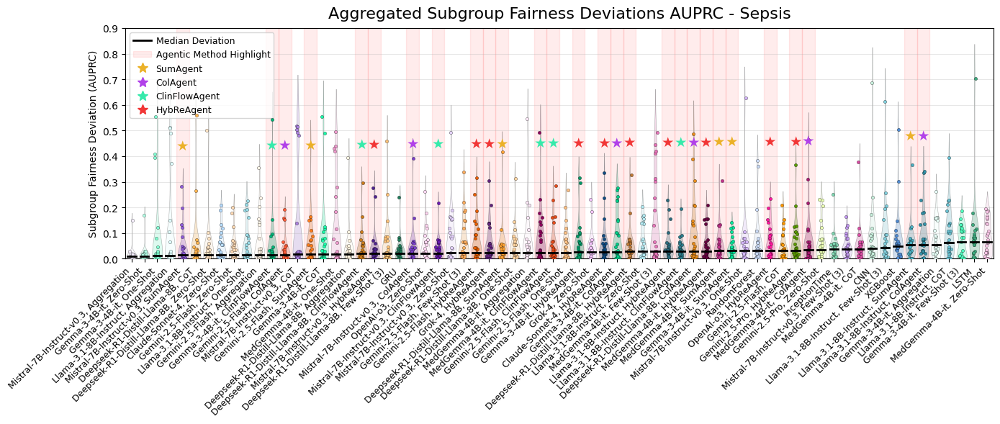

In [16]:
def plot_subgroup_fairness_violin(
    df_metrics_subgroup,
    metric="AUROC",
    task=None,
    dataset=None,
    save_path=None,
    ylim=None,
):
    """
    Creates a violin plot of subgroup fairness deviations for each model_prompting_id.
    - Title includes metric and aggregation level
    - Y-axis starts at 0 (unless ylim is specified)
    - Median highlighted as thick black line
    - Agent methods highlighted with light red background and star above median (star color = prompting_id color)
    - Individual data points plotted instead of boxplot
    - X axis label removed
    - X axis limits trimmed (no empty space at edges)
    - model_prompting_ids ordered by best (lowest median deviation) first
    - Agent legend added to upper left (star color, red background, median line)
    - ylim: tuple (ymin, ymax) for y-axis limits (optional)
    """

    df = compute_subgroup_deviation(df_metrics_subgroup, metric)
    if task:
        df = df[df["Task"] == task]
    if dataset:
        df = df[df["Dataset"] == dataset]

    # Order model_prompting_ids by lowest median subgroup deviation (best first)
    medians = df.groupby("model_prompting_id")["subgroup_deviation"].median()
    models = medians.sort_values().index.tolist()
    colors = [get_model_prompting_id_color(m) for m in models]

    plt.figure(figsize=(14, 6))
    ax = plt.gca()

    # Agent highlighting (light red background)
    for i, model in enumerate(models):
        is_agent = any(agent_id in model for agent_id in AGENTIC_PROMPTING_IDS)
        if is_agent:
            ax.axvspan(i - 0.5, i + 0.5, color="red", alpha=0.075, zorder=0)

    # Violin plot
    sns.violinplot(
        x="model_prompting_id",
        y="subgroup_deviation",
        data=df,
        order=models,
        # hue="model_prompting_id",
        legend=False,
        inner=None,  # We'll add median and points manually
        density_norm="width",
        palette=colors,
        ax=ax,
        linewidth=0.4,
        edgecolor="black",
        alpha=0.3,
    )

    # Median highlight and agent star
    for i, model in enumerate(models):
        median = medians[model]
        ax.plot(
            [i - 0.32, i + 0.32],
            [median, median],
            color="black",
            linewidth=2,
            zorder=12,
        )
        # Add star above median for agent methods (star color = prompting_id color)
        for agent_id in AGENTIC_PROMPTING_IDS:
            if agent_id in model:
                star_color = PROMPTING_ID_MAPPING.get(agent_id, "red")
                ax.text(
                    i,
                    median + 0.35 * (ax.get_ylim()[1] - ax.get_ylim()[0]),
                    "★",
                    ha="center",
                    va="bottom",
                    fontsize=14,
                    color=star_color,
                    fontweight="bold",
                    zorder=20,
                )

    # Plot individual data points (jittered)
    for i, model in enumerate(models):
        yvals = df[df["model_prompting_id"] == model]["subgroup_deviation"].values
        ax.scatter(
            np.random.normal(i, 0.08, size=len(yvals)),  # jitter x
            yvals,
            color=get_model_prompting_id_color(model),
            alpha=1.0,
            s=10,
            zorder=10,
            edgecolors="black",
            linewidth=0.2,
        )

    # Set y-axis limits
    if ylim is not None:
        ax.set_ylim(ylim)
    else:
        ax.set_ylim(bottom=0)
    ax.set_xlim(-0.5, len(models) - 0.5)  # Remove empty space at edges
    ax.set_ylabel(f"Subgroup Fairness Deviation ({metric})")
    ax.set_xlabel("")  # Remove x axis label

    # Custom title
    title_task = f"{task}" if task else ""
    ax.set_title(
        f"Aggregated Subgroup Fairness Deviations {metric} - {title_task}",
        fontsize=16,
        pad=10,
    )
    ax.grid(axis="y", alpha=0.3)
    plt.xticks(rotation=45, ha="right", fontsize=9)
    plt.tight_layout()

    # Agent legend (upper left) - exactly as in create_performance_bar_chart()
    agent_star_handles = [
        mlines.Line2D(
            [],
            [],
            marker="*",
            color=PROMPTING_ID_MAPPING[agent_id],
            linestyle="None",
            markersize=10,
            label=agent_id,
        )
        for agent_id in AGENTIC_PROMPTING_IDS
    ]
    # Red background legend
    agent_bg_handle = mpatches.Patch(
        color="red", alpha=0.075, label="Agentic Method Highlight"
    )
    # Median line legend
    median_handle = mlines.Line2D(
        [], [], color="black", linewidth=2, label="Median Deviation"
    )

    # Combine legend handles
    legend_handles = [median_handle, agent_bg_handle] + agent_star_handles

    ax.legend(
        handles=legend_handles,
        loc="upper left",
        fontsize=9,
        frameon=True,
        handletextpad=0.5,
    )

    plt.tight_layout()

    if save_path:
        plt.savefig(save_path, dpi=400, bbox_inches="tight")
        print(f"Violin plot saved to: {save_path}")
    plt.show()


for task in ["Mortality", "AKI", "Sepsis"]:
    plot_subgroup_fairness_violin(
        df_metrics_subgroup,
        metric="AUROC",
        task=task,
        save_path=os.path.join(
            fairness_output_dir, f"subgroup_fairness_violin_{task}.png"
        ),
        ylim=(0, 0.7),
    )

for task in ["Mortality", "AKI", "Sepsis"]:
    plot_subgroup_fairness_violin(
        df_metrics_subgroup,
        metric="AUPRC",
        task=task,
        save_path=os.path.join(
            fairness_output_dir, f"subgroup_fairness_violin_{task}.png"
        ),
        ylim=(0, 0.9), 
    )

/var/folders/r1/8n2p36gx2ydfw7wf826zxyh00000gn/T/ipykernel_1750/2152025269.py:48: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/var/folders/r1/8n2p36gx2ydfw7wf826zxyh00000gn/T/ipykernel_1750/2152025269.py:48: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  sns.violinplot(


Prompting ID fairness violin plot saved to: ./notebook_output/pulse_agents_overall/subgroup_fairness/subgroup_fairness_violin_prompting_id_Mortality.png


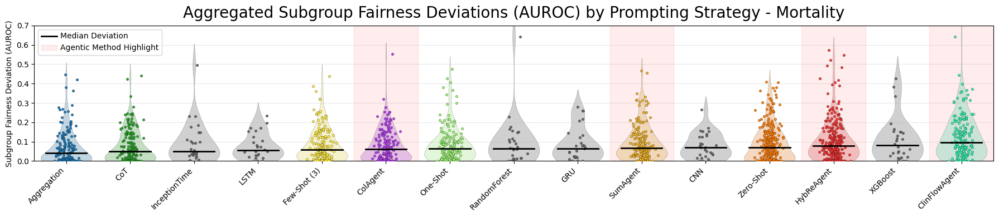

/var/folders/r1/8n2p36gx2ydfw7wf826zxyh00000gn/T/ipykernel_1750/2152025269.py:48: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/var/folders/r1/8n2p36gx2ydfw7wf826zxyh00000gn/T/ipykernel_1750/2152025269.py:48: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  sns.violinplot(


Prompting ID fairness violin plot saved to: ./notebook_output/pulse_agents_overall/subgroup_fairness/subgroup_fairness_violin_prompting_id_AKI.png


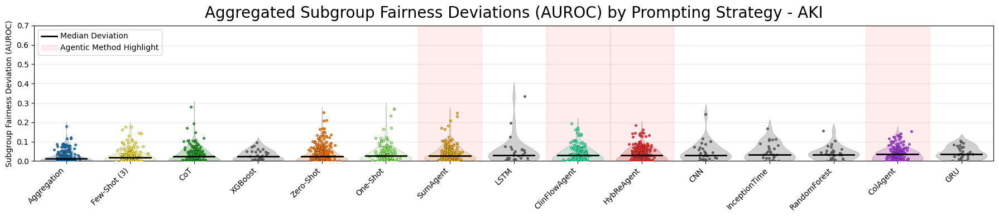

/var/folders/r1/8n2p36gx2ydfw7wf826zxyh00000gn/T/ipykernel_1750/2152025269.py:48: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/var/folders/r1/8n2p36gx2ydfw7wf826zxyh00000gn/T/ipykernel_1750/2152025269.py:48: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  sns.violinplot(


Prompting ID fairness violin plot saved to: ./notebook_output/pulse_agents_overall/subgroup_fairness/subgroup_fairness_violin_prompting_id_Sepsis.png


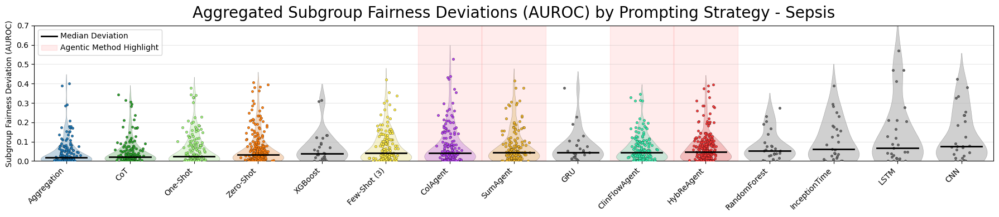

/var/folders/r1/8n2p36gx2ydfw7wf826zxyh00000gn/T/ipykernel_1750/2152025269.py:48: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/var/folders/r1/8n2p36gx2ydfw7wf826zxyh00000gn/T/ipykernel_1750/2152025269.py:48: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  sns.violinplot(


Prompting ID fairness violin plot saved to: ./notebook_output/pulse_agents_overall/subgroup_fairness/subgroup_fairness_violin_prompting_id_Mortality.png


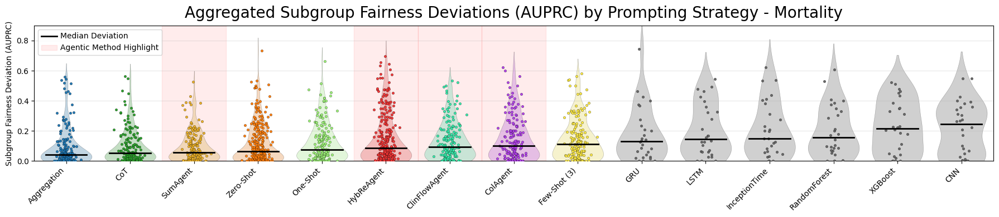

/var/folders/r1/8n2p36gx2ydfw7wf826zxyh00000gn/T/ipykernel_1750/2152025269.py:48: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/var/folders/r1/8n2p36gx2ydfw7wf826zxyh00000gn/T/ipykernel_1750/2152025269.py:48: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  sns.violinplot(


Prompting ID fairness violin plot saved to: ./notebook_output/pulse_agents_overall/subgroup_fairness/subgroup_fairness_violin_prompting_id_AKI.png


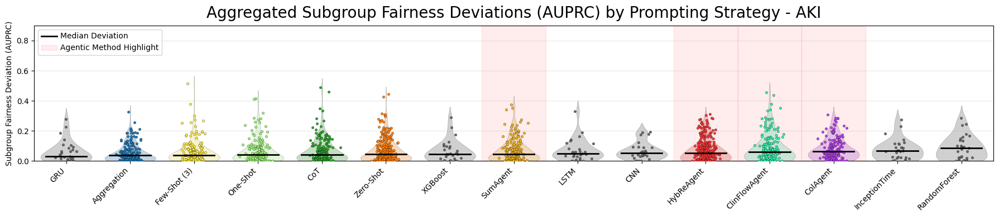

/var/folders/r1/8n2p36gx2ydfw7wf826zxyh00000gn/T/ipykernel_1750/2152025269.py:48: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/var/folders/r1/8n2p36gx2ydfw7wf826zxyh00000gn/T/ipykernel_1750/2152025269.py:48: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  sns.violinplot(


Prompting ID fairness violin plot saved to: ./notebook_output/pulse_agents_overall/subgroup_fairness/subgroup_fairness_violin_prompting_id_Sepsis.png


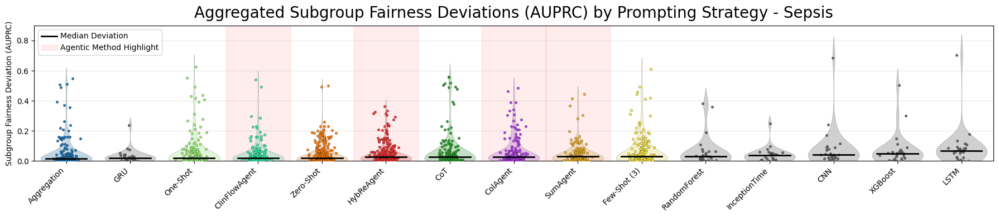

In [17]:
def plot_prompting_id_fairness_violin(
    df_metrics_subgroup,
    metric="AUROC",
    task=None,
    dataset=None,
    save_path=None,
    ylim=None,
):
    """
    Creates a violin plot of subgroup fairness deviations for each prompting_id (aggregated across all models).
    - Title includes metric and aggregation level
    - Y-axis starts at 0 (unless ylim is specified)
    - Median highlighted as thick black line
    - Agent methods highlighted with light red background and star above median (star color = prompting_id color)
    - Individual data points plotted instead of boxplot
    - X axis label removed
    - X axis limits trimmed (no empty space at edges)
    - Prompting_ids ordered by best (lowest median deviation) first
    - Agent legend added to upper left (star color, red background, median line)
    - ylim: tuple (ymin, ymax) for y-axis limits (optional)
    """

    # Compute deviation and add prompting_id column
    df = compute_subgroup_deviation(df_metrics_subgroup, metric).copy()
    df["prompting_id"] = df["model_prompting_id"].apply(
        lambda x: x.split(",")[-1].strip() if "," in x else x
    )
    if task:
        df = df[df["Task"] == task]
    if dataset:
        df = df[df["Dataset"] == dataset]

    # Order prompting_ids by lowest median subgroup deviation (best first)
    medians = df.groupby("prompting_id")["subgroup_deviation"].median()
    prompting_ids = medians.sort_values().index.tolist()
    colors = [PROMPTING_ID_MAPPING.get(pid, "#666666") for pid in prompting_ids]

    plt.figure(figsize=(18, 4))
    ax = plt.gca()

    # Agent highlighting (light red background)
    for i, pid in enumerate(prompting_ids):
        is_agent = pid in AGENTIC_PROMPTING_IDS
        if is_agent:
            ax.axvspan(i - 0.5, i + 0.5, color="red", alpha=0.075, zorder=0)

    # Violin plot
    sns.violinplot(
        x="prompting_id",
        y="subgroup_deviation",
        data=df,
        order=prompting_ids,
        inner=None,  # We'll add median and points manually
        scale="width",
        palette=colors,
        ax=ax,
        linewidth=0.4,
        edgecolor="black",
        alpha=0.3,
    )

    # Median highlight and agent star
    for i, pid in enumerate(prompting_ids):
        median = medians[pid]
        ax.plot(
            [i - 0.32, i + 0.32],
            [median, median],
            color="black",
            linewidth=2,
            zorder=12,
        )

    # Plot individual data points (jittered)
    for i, pid in enumerate(prompting_ids):
        yvals = df[df["prompting_id"] == pid]["subgroup_deviation"].values
        ax.scatter(
            np.random.normal(i, 0.08, size=len(yvals)),  # jitter x
            yvals,
            color=PROMPTING_ID_MAPPING.get(pid, "#666666"),
            alpha=1.0,
            s=10,
            zorder=10,
            edgecolors="black",
            linewidth=0.2,
        )

    # Set y-axis limits
    if ylim is not None:
        ax.set_ylim(ylim)
    else:
        ax.set_ylim(bottom=0)
    ax.set_xlim(-0.5, len(prompting_ids) - 0.5)  # Remove empty space at edges
    ax.set_ylabel(f"Subgroup Fairness Deviation ({metric})", fontsize=10)
    ax.set_xlabel("")  # Remove x axis label

    # Custom title
    title_task = f"{task}" if task else ""
    ax.set_title(
        f"Aggregated Subgroup Fairness Deviations ({metric}) by Prompting Strategy - {title_task}",
        fontsize=20,
        pad=10,
    )
    ax.grid(axis="y", alpha=0.3)
    plt.xticks(rotation=45, ha="right", fontsize=10)
    plt.tight_layout()

    # Red background legend
    agent_bg_handle = mpatches.Patch(
        color="red", alpha=0.075, label="Agentic Method Highlight"
    )
    # Median line legend
    median_handle = mlines.Line2D(
        [], [], color="black", linewidth=2, label="Median Deviation"
    )

    # Combine legend handles
    legend_handles = [median_handle, agent_bg_handle]

    ax.legend(
        handles=legend_handles,
        loc="upper left",
        fontsize=10,
        frameon=True,
        handletextpad=0.5,
    )

    plt.tight_layout()

    if save_path:
        plt.savefig(save_path, dpi=400, bbox_inches="tight")
        print(f"Prompting ID fairness violin plot saved to: {save_path}")
    plt.show()


# Example usage for all tasks:
for task in ["Mortality", "AKI", "Sepsis"]:
    plot_prompting_id_fairness_violin(
        df_metrics_subgroup,
        metric="AUROC",
        task=task,
        save_path=os.path.join(
            fairness_output_dir, f"subgroup_fairness_violin_prompting_id_{task}.png"
        ),
        ylim=(0, 0.7), 
    )

for task in ["Mortality", "AKI", "Sepsis"]:
    plot_prompting_id_fairness_violin(
        df_metrics_subgroup,
        metric="AUPRC",
        task=task,
        save_path=os.path.join(
            fairness_output_dir, f"subgroup_fairness_violin_prompting_id_{task}.png"
        ),
        ylim=(0, 0.9),
    )

In [58]:
def summarize_subgroup_fairness(
    df_metrics_subgroup, metric="AUROC", compare_agents=True, print_tables=True
):
    """
    Enhanced: Summarizes subgroup fairness deviations for each prompting strategy and model_prompting_id.
    Also compares AGENTS (overall and per agent) to baselines and standard prompting, with aggregated values.
    Always includes AUROC and AUPRC values where applicable.
    Generates actionable statements for reporting in results.

    Args:
        df_metrics_subgroup (DataFrame): Metrics DataFrame with subgroup data.
        metric (str): Metric to use for deviation (default: "AUROC").
        compare_agents (bool): If True, adds agent vs baseline/standard comparison.
        print_tables (bool): If True, prints summary tables.

    Returns:
        List[str]: Actionable summary statements.
    """
    # Compute deviations
    df_dev = compute_subgroup_deviation(df_metrics_subgroup, metric)
    # Add prompting_id and base_model columns
    df_dev["prompting_id"] = df_dev["model_prompting_id"].apply(
        lambda x: x.split(",")[-1].strip() if "," in x else x
    )
    df_dev["base_model"] = df_dev["model_prompting_id"].apply(
        lambda x: x.split(",")[0].strip()
    )

    # Aggregation by prompting_id and model_prompting_id
    summary = (
        df_dev.groupby("prompting_id")["subgroup_deviation"]
        .agg(["median", "mean", "std", "min", "max", "count"])
        .sort_values("median")
        .reset_index()
    )
    summary_model = (
        df_dev.groupby("model_prompting_id")["subgroup_deviation"]
        .agg(["median", "mean", "std", "min", "max", "count"])
        .sort_values("median")
        .reset_index()
    )

    # Also prepare AUPRC deviation summaries if available
    has_auprc = "AUPRC" in df_metrics_subgroup.columns
    if has_auprc:
        df_dev_auprc = compute_subgroup_deviation(df_metrics_subgroup, "AUPRC")
        df_dev_auprc["prompting_id"] = df_dev_auprc["model_prompting_id"].apply(
            lambda x: x.split(",")[-1].strip() if "," in x else x
        )
        df_dev_auprc["base_model"] = df_dev_auprc["model_prompting_id"].apply(
            lambda x: x.split(",")[0].strip()
        )
        summary_auprc = (
            df_dev_auprc.groupby("prompting_id")["subgroup_deviation"]
            .agg(["median", "mean", "std", "min", "max", "count"])
            .sort_values("median")
            .reset_index()
        )
        summary_model_auprc = (
            df_dev_auprc.groupby("model_prompting_id")["subgroup_deviation"]
            .agg(["median", "mean", "std", "min", "max", "count"])
            .sort_values("median")
            .reset_index()
        )

    statements = []
    best = summary.iloc[0]
    worst = summary.iloc[-1]

    # Overall best and worst (prompting_id)
    statements.append(
        f"Across all models and datasets, the '{best['prompting_id']}' strategy achieved the lowest median subgroup fairness deviation ({metric} median={best['median']:.3f}), indicating the most consistent fairness across demographic subgroups."
    )
    statements.append(
        f"The '{worst['prompting_id']}' strategy showed the highest median deviation ({metric} median={worst['median']:.3f}), suggesting greater variability in subgroup performance."
    )
    if has_auprc:
        best_auprc = summary_auprc.iloc[0]
        worst_auprc = summary_auprc.iloc[-1]
        statements.append(
            f"(AUPRC) The '{best_auprc['prompting_id']}' strategy achieved the lowest median subgroup fairness deviation (AUPRC median={best_auprc['median']:.3f}), while '{worst_auprc['prompting_id']}' had the highest (AUPRC median={worst_auprc['median']:.3f})."
        )

    # Agentic methods summary (prompting_id)
    agentic_summary = summary[summary["prompting_id"].isin(AGENTIC_PROMPTING_IDS)]
    if not agentic_summary.empty:
        agentic_best = agentic_summary.iloc[0]
        agentic_worst = agentic_summary.iloc[-1]
        statements.append(
            f"Among agentic prompting methods, '{agentic_best['prompting_id']}' had the lowest median deviation ({agentic_best['median']:.3f}), while '{agentic_worst['prompting_id']}' had the highest ({agentic_worst['median']:.3f})."
        )
        if has_auprc:
            agentic_summary_auprc = summary_auprc[
                summary_auprc["prompting_id"].isin(AGENTIC_PROMPTING_IDS)
            ]
            if not agentic_summary_auprc.empty:
                agentic_best_auprc = agentic_summary_auprc.iloc[0]
                agentic_worst_auprc = agentic_summary_auprc.iloc[-1]
                statements.append(
                    f"(AUPRC) Among agentic methods, '{agentic_best_auprc['prompting_id']}' had the lowest median deviation (AUPRC median={agentic_best_auprc['median']:.3f}), while '{agentic_worst_auprc['prompting_id']}' had the highest ({agentic_worst_auprc['median']:.3f})."
                )

    # Standard methods summary (prompting_id)
    standard_summary = summary[summary["prompting_id"].isin(STANDARD_PROMPTING_IDS)]
    if not standard_summary.empty:
        standard_best = standard_summary.iloc[0]
        standard_worst = standard_summary.iloc[-1]
        statements.append(
            f"For standard prompting, '{standard_best['prompting_id']}' was most fair (median={standard_best['median']:.3f}), and '{standard_worst['prompting_id']}' was least fair (median={standard_worst['median']:.3f})."
        )
        if has_auprc:
            standard_summary_auprc = summary_auprc[
                summary_auprc["prompting_id"].isin(STANDARD_PROMPTING_IDS)
            ]
            if not standard_summary_auprc.empty:
                standard_best_auprc = standard_summary_auprc.iloc[0]
                standard_worst_auprc = standard_summary_auprc.iloc[-1]
                statements.append(
                    f"(AUPRC) For standard prompting, '{standard_best_auprc['prompting_id']}' was most fair (AUPRC median={standard_best_auprc['median']:.3f}), and '{standard_worst_auprc['prompting_id']}' was least fair (AUPRC median={standard_worst_auprc['median']:.3f})."
                )

    # Range statement (prompting_id)
    statements.append(
        f"Subgroup fairness deviations ranged from {summary['min'].min():.3f} to {summary['max'].max():.3f} ({metric}) across all strategies."
    )
    if has_auprc:
        statements.append(
            f"(AUPRC) Subgroup fairness deviations ranged from {summary_auprc['min'].min():.3f} to {summary_auprc['max'].max():.3f} (AUPRC) across all strategies."
        )

    # Findings at model_prompting_id level (agentic methods with specific models)
    agentic_models = summary_model[
        summary_model["model_prompting_id"].apply(
            lambda x: any(a in x for a in AGENTIC_PROMPTING_IDS)
        )
    ]
    if not agentic_models.empty:
        top_agentic = agentic_models.nsmallest(3, "median")
        for _, row in top_agentic.iterrows():
            statements.append(
                f"Notably, the agentic method '{row['model_prompting_id']}' achieved a median subgroup fairness deviation of {row['median']:.3f}, demonstrating strong fairness for this model-strategy combination."
            )
    if has_auprc:
        agentic_models_auprc = summary_model_auprc[
            summary_model_auprc["model_prompting_id"].apply(
                lambda x: any(a in x for a in AGENTIC_PROMPTING_IDS)
            )
        ]
        if not agentic_models_auprc.empty:
            top_agentic_auprc = agentic_models_auprc.nsmallest(3, "median")
            for _, row in top_agentic_auprc.iterrows():
                statements.append(
                    f"(AUPRC) Notably, the agentic method '{row['model_prompting_id']}' achieved a median subgroup fairness deviation of {row['median']:.3f} (AUPRC), demonstrating strong fairness for this model-strategy combination."
                )

    # --- Individual subgroup insights ---
    subgroup_types = ["Sex", "Age", "BMI"]
    for subgroup in subgroup_types:
        # Calculate mean metric for each subgroup value across all models/tasks/datasets
        subgroup_perf = (
            df_metrics_subgroup[df_metrics_subgroup["subgroup_type"] == subgroup]
            .groupby("subgroup_value")[metric]
            .agg(["mean", "std", "count"])
            .sort_values("mean", ascending=False)
        )
        best_sub = subgroup_perf.iloc[0]
        worst_sub = subgroup_perf.iloc[-1]
        statements.append(
            f"For {subgroup}, '{best_sub.name}' subgroup had the highest average {metric} ({best_sub['mean']:.3f}), while '{worst_sub.name}' had the lowest ({worst_sub['mean']:.3f})."
        )
        if has_auprc:
            subgroup_perf_auprc = (
                df_metrics_subgroup[df_metrics_subgroup["subgroup_type"] == subgroup]
                .groupby("subgroup_value")["AUPRC"]
                .agg(["mean", "std", "count"])
                .sort_values("mean", ascending=False)
            )
            best_sub_auprc = subgroup_perf_auprc.iloc[0]
            worst_sub_auprc = subgroup_perf_auprc.iloc[-1]
            statements.append(
                f"(AUPRC) For {subgroup}, '{best_sub_auprc.name}' subgroup had the highest average AUPRC ({best_sub_auprc['mean']:.3f}), while '{worst_sub_auprc.name}' had the lowest ({worst_sub_auprc['mean']:.3f})."
            )

    # --- Agent vs Baseline/Standard Comparison ---
    if compare_agents:
        # Define masks
        is_agent = df_dev["prompting_id"].isin(AGENTIC_PROMPTING_IDS)
        is_standard = df_dev["prompting_id"].isin(STANDARD_PROMPTING_IDS)
        is_baseline = df_dev["base_model"].isin(CONVML_MODELS + CONVDL_MODELS)

        # Aggregated values
        agent_median = df_dev[is_agent]["subgroup_deviation"].median()
        agent_mean = df_dev[is_agent]["subgroup_deviation"].mean()
        standard_median = df_dev[is_standard]["subgroup_deviation"].median()
        standard_mean = df_dev[is_standard]["subgroup_deviation"].mean()
        baseline_median = df_dev[is_baseline]["subgroup_deviation"].median()
        baseline_mean = df_dev[is_baseline]["subgroup_deviation"].mean()

        statements.append(
            f"Aggregated across all tasks and datasets, agentic methods achieved a median subgroup fairness deviation of {agent_median:.3f} (mean={agent_mean:.3f}), compared to {standard_median:.3f} (mean={standard_mean:.3f}) for standard prompting and {baseline_median:.3f} (mean={baseline_mean:.3f}) for baseline models."
        )
        if has_auprc:
            is_agent_auprc = df_dev_auprc["prompting_id"].isin(AGENTIC_PROMPTING_IDS)
            is_standard_auprc = df_dev_auprc["prompting_id"].isin(
                STANDARD_PROMPTING_IDS
            )
            is_baseline_auprc = df_dev_auprc["base_model"].isin(
                CONVML_MODELS + CONVDL_MODELS
            )
            agent_median_auprc = df_dev_auprc[is_agent_auprc][
                "subgroup_deviation"
            ].median()
            agent_mean_auprc = df_dev_auprc[is_agent_auprc]["subgroup_deviation"].mean()
            standard_median_auprc = df_dev_auprc[is_standard_auprc][
                "subgroup_deviation"
            ].median()
            standard_mean_auprc = df_dev_auprc[is_standard_auprc][
                "subgroup_deviation"
            ].mean()
            baseline_median_auprc = df_dev_auprc[is_baseline_auprc][
                "subgroup_deviation"
            ].median()
            baseline_mean_auprc = df_dev_auprc[is_baseline_auprc][
                "subgroup_deviation"
            ].mean()
            statements.append(
                f"(AUPRC) Aggregated across all tasks and datasets, agentic methods achieved a median subgroup fairness deviation of {agent_median_auprc:.3f} (mean={agent_mean_auprc:.3f}), compared to {standard_median_auprc:.3f} (mean={standard_mean_auprc:.3f}) for standard prompting and {baseline_median_auprc:.3f} (mean={baseline_mean_auprc:.3f}) for baseline models."
            )

        if agent_median < standard_median and agent_median < baseline_median:
            statements.append(
                f"Agentic methods overall improved subgroup fairness compared to both standard prompting and baseline models."
            )
        elif agent_median < standard_median:
            statements.append(
                f"Agentic methods overall improved subgroup fairness compared to standard prompting."
            )
        elif agent_median < baseline_median:
            statements.append(
                f"Agentic methods overall improved subgroup fairness compared to baseline models."
            )
        else:
            statements.append(
                f"Agentic methods did not improve subgroup fairness compared to standard or baseline approaches in this analysis."
            )

        # Per-agent comparison
        for agent_id in AGENTIC_PROMPTING_IDS:
            agent_mask = df_dev["prompting_id"] == agent_id
            if agent_mask.sum() == 0:
                continue
            agent_med = df_dev[agent_mask]["subgroup_deviation"].median()
            agent_mean = df_dev[agent_mask]["subgroup_deviation"].mean()
            comparison = []
            if agent_med < standard_median:
                comparison.append("standard prompting")
            if agent_med < baseline_median:
                comparison.append("baseline models")
            if comparison:
                statements.append(
                    f"The agent '{agent_id}' achieved a median subgroup fairness deviation of {agent_med:.3f} (mean={agent_mean:.3f}), outperforming {' and '.join(comparison)}."
                )
            else:
                statements.append(
                    f"The agent '{agent_id}' had a median subgroup fairness deviation of {agent_med:.3f} (mean={agent_mean:.3f}), not surpassing standard or baseline approaches."
                )
            if has_auprc:
                agent_mask_auprc = df_dev_auprc["prompting_id"] == agent_id
                if agent_mask_auprc.sum() > 0:
                    agent_med_auprc = df_dev_auprc[agent_mask_auprc][
                        "subgroup_deviation"
                    ].median()
                    agent_mean_auprc = df_dev_auprc[agent_mask_auprc][
                        "subgroup_deviation"
                    ].mean()
                    comparison_auprc = []
                    if agent_med_auprc < standard_median_auprc:
                        comparison_auprc.append("standard prompting")
                    if agent_med_auprc < baseline_median_auprc:
                        comparison_auprc.append("baseline models")
                    if comparison_auprc:
                        statements.append(
                            f"(AUPRC) The agent '{agent_id}' achieved a median subgroup fairness deviation of {agent_med_auprc:.3f} (mean={agent_mean_auprc:.3f}), outperforming {' and '.join(comparison_auprc)}."
                        )
                    else:
                        statements.append(
                            f"(AUPRC) The agent '{agent_id}' had a median subgroup fairness deviation of {agent_med_auprc:.3f} (mean={agent_mean_auprc:.3f}), not surpassing standard or baseline approaches."
                        )

    # 1. Fairest and unfairest LLM for all agentic prompting ids
    agentic_llm_summary = (
        df_dev[df_dev["prompting_id"].isin(AGENTIC_PROMPTING_IDS)]
        .groupby("base_model")["subgroup_deviation"]
        .mean()
        .sort_values()
    )
    if not agentic_llm_summary.empty:
        fairest_agentic_llm = agentic_llm_summary.idxmin()
        fairest_agentic_llm_val = agentic_llm_summary.min()
        unfairest_agentic_llm = agentic_llm_summary.idxmax()
        unfairest_agentic_llm_val = agentic_llm_summary.max()
        statements.append(
            f"Among all agentic prompting strategies, the fairest LLM was '{fairest_agentic_llm}' (mean subgroup fairness deviation = {fairest_agentic_llm_val:.3f}), while the unfairest was '{unfairest_agentic_llm}' (mean = {unfairest_agentic_llm_val:.3f})."
        )

    # 2. Fairest and unfairest LLM for all standard prompting ids
    standard_llm_summary = (
        df_dev[df_dev["prompting_id"].isin(STANDARD_PROMPTING_IDS)]
        .groupby("base_model")["subgroup_deviation"]
        .mean()
        .sort_values()
    )
    if not standard_llm_summary.empty:
        fairest_standard_llm = standard_llm_summary.idxmin()
        fairest_standard_llm_val = standard_llm_summary.min()
        unfairest_standard_llm = standard_llm_summary.idxmax()
        unfairest_standard_llm_val = standard_llm_summary.max()
        statements.append(
            f"Among all standard prompting strategies, the fairest LLM was '{fairest_standard_llm}' (mean subgroup fairness deviation = {fairest_standard_llm_val:.3f}), while the unfairest was '{unfairest_standard_llm}' (mean = {unfairest_standard_llm_val:.3f})."
        )

    # Print summary tables and statements
    if print_tables:
        print("Subgroup Fairness Summary Table (by prompting_id):")
        display(summary)
        if has_auprc:
            print("\nSubgroup Fairness Summary Table (by prompting_id, AUPRC):")
            display(summary_auprc)
        print("\nSubgroup Fairness Summary Table (by model_prompting_id):")
        display(summary_model)
        if has_auprc:
            print("\nSubgroup Fairness Summary Table (by model_prompting_id, AUPRC):")
            display(summary_model_auprc)
        print("\nActionable Summary Statements for Results Section:")
        for s in statements:
            print(f"- {s}")

    return statements


# Run summary for AUROC with improved agent comparison and AUPRC reporting
summarize_subgroup_fairness(df_metrics_subgroup, metric="AUROC")

Subgroup Fairness Summary Table (by prompting_id):


,prompting_id,median,mean,std,min,max,count
0,Aggregation,0.0190,0.046542,0.068761,0.0,0.447,504
1,CoT,0.0280,0.052998,0.068923,0.0,0.442,504
2,Few-Shot (3),0.0330,0.061621,0.074673,0.0,0.438,504
3,One-Shot,0.0345,0.060583,0.076958,0.0,0.475,504
4,Zero-Shot,0.0360,0.064644,0.080176,0.0,0.410,832
5,ColAgent,0.0405,0.066506,0.079210,0.0,0.553,504
6,XGBoost,0.0425,0.069036,0.086834,0.0,0.426,84
7,SumAgent,0.0435,0.069335,0.080034,0.0,0.466,504
8,InceptionTime,0.0440,0.081179,0.092774,0.0,0.497,84
9,RandomForest,0.0445,0.070452,0.088097,0.0,0.641,84



Subgroup Fairness Summary Table (by prompting_id, AUPRC):


,prompting_id,median,mean,std,min,max,count
0,Aggregation,0.0310,0.070002,0.101481,0.0,0.558,504
1,GRU,0.0365,0.090905,0.129290,0.0,0.745,84
2,CoT,0.0390,0.079075,0.106742,0.0,0.565,504
3,Zero-Shot,0.0405,0.080251,0.100817,0.0,0.735,832
4,One-Shot,0.0425,0.085915,0.111981,0.0,0.662,504
5,SumAgent,0.0430,0.072232,0.085991,0.0,0.526,504
6,HybReAgent,0.0470,0.093276,0.118275,0.0,0.696,840
7,Few-Shot (3),0.0500,0.093339,0.114539,0.0,0.613,504
8,ClinFlowAgent,0.0505,0.091474,0.107950,0.0,0.543,504
9,XGBoost,0.0535,0.121440,0.145452,0.0,0.523,84



Subgroup Fairness Summary Table (by model_prompting_id):


,model_prompting_id,median,mean,std,min,max,count
0,"MedGemma-4B-it, One-Shot",0.0020,0.035179,0.062176,0.0,0.406,84
1,"MedGemma-4B-it, Few-Shot (3)",0.0050,0.032655,0.066121,0.0,0.422,84
2,"Llama-3.1-8B-Instruct, Zero-Shot",0.0080,0.030702,0.050027,0.0,0.265,84
3,"Llama-3.1-8B-Instruct, Aggregation",0.0085,0.027548,0.051292,0.0,0.421,84
4,"Llama-3.1-8B-Instruct, CoT",0.0105,0.035274,0.056047,0.0,0.306,84
...,...,...,...,...,...,...,...
63,"OpenAI-o3, HybReAgent",0.0580,0.076250,0.084826,0.0,0.483,84
64,"Deepseek-R1-Distill-Llama-8B, ClinFlowAgent",0.0595,0.075607,0.080172,0.0,0.444,84
65,"Gemini-2.5-Flash, HybReAgent",0.0600,0.078286,0.078685,0.0,0.390,84
66,"Llama-3.1-8B-Instruct, HybReAgent",0.0605,0.080798,0.090314,0.0,0.572,84



Subgroup Fairness Summary Table (by model_prompting_id, AUPRC):


,model_prompting_id,median,mean,std,min,max,count
0,"Gemma-3-4B-it, Zero-Shot",0.0180,0.042405,0.067766,0.0,0.365,84
1,"Mistral-7B-Instruct-v0.3, Aggregation",0.0195,0.055060,0.084290,0.0,0.558,84
2,"Gemma-3-4B-it, One-Shot",0.0200,0.058631,0.099334,0.0,0.553,84
3,"Deepseek-R1-Distill-Llama-8B, Aggregation",0.0225,0.061345,0.084223,0.0,0.393,84
4,"Deepseek-R1-Distill-Llama-8B, SumAgent",0.0235,0.056560,0.092302,0.0,0.526,84
...,...,...,...,...,...,...,...
63,"MedGemma-4B-it, ClinFlowAgent",0.0715,0.114048,0.119076,0.0,0.493,84
64,"Gemini-2.5-Flash, Aggregation",0.0720,0.099286,0.099188,0.0,0.449,84
65,"Llama-3.1-8B-Instruct, One-Shot",0.0730,0.112333,0.128731,0.0,0.662,84
66,"OpenAI-o3, HybReAgent",0.0755,0.123190,0.138635,0.0,0.574,84



Actionable Summary Statements for Results Section:
- Across all models and datasets, the 'Aggregation' strategy achieved the lowest median subgroup fairness deviation (AUROC median=0.019), indicating the most consistent fairness across demographic subgroups.
- The 'CNN' strategy showed the highest median deviation (AUROC median=0.055), suggesting greater variability in subgroup performance.
- (AUPRC) The 'Aggregation' strategy achieved the lowest median subgroup fairness deviation (AUPRC median=0.031), while 'RandomForest' had the highest (AUPRC median=0.070).
- Among agentic prompting methods, 'ColAgent' had the lowest median deviation (0.040), while 'HybReAgent' had the highest (0.048).
- (AUPRC) Among agentic methods, 'SumAgent' had the lowest median deviation (AUPRC median=0.043), while 'ColAgent' had the highest (0.054).
- For standard prompting, 'Aggregation' was most fair (median=0.019), and 'Zero-Shot' was least fair (median=0.036).
- (AUPRC) For standard prompting, 'Aggregati

["Across all models and datasets, the 'Aggregation' strategy achieved the lowest median subgroup fairness deviation (AUROC median=0.019), indicating the most consistent fairness across demographic subgroups.",
 "The 'CNN' strategy showed the highest median deviation (AUROC median=0.055), suggesting greater variability in subgroup performance.",
 "(AUPRC) The 'Aggregation' strategy achieved the lowest median subgroup fairness deviation (AUPRC median=0.031), while 'RandomForest' had the highest (AUPRC median=0.070).",
 "Among agentic prompting methods, 'ColAgent' had the lowest median deviation (0.040), while 'HybReAgent' had the highest (0.048).",
 "(AUPRC) Among agentic methods, 'SumAgent' had the lowest median deviation (AUPRC median=0.043), while 'ColAgent' had the highest (0.054).",
 "For standard prompting, 'Aggregation' was most fair (median=0.019), and 'Zero-Shot' was least fair (median=0.036).",
 "(AUPRC) For standard prompting, 'Aggregation' was most fair (AUPRC median=0.031), 

In [19]:
def summarize_subgroup_fairness_by_task_and_prompting(df_metrics_subgroup, metric="AUROC"):
    """
    Summarizes subgroup fairness deviations for each subgroup (Sex, Age, BMI) split by task and prompting type.
    Baseline = convML/convDL, Standard Prompting = STANDARD_PROMPTING_IDS, Agentic Prompting = AGENTIC_PROMPTING_IDS.
    Prints summary tables and actionable insights for each split.

    Args:
        df_metrics_subgroup (DataFrame): Metrics DataFrame with subgroup data.
        metric (str): Metric to use for deviation (default: "AUROC").
    """
    # Compute deviations
    df_dev = compute_subgroup_deviation(df_metrics_subgroup, metric)
    df_dev["prompting_id"] = df_dev["model_prompting_id"].apply(
        lambda x: x.split(",")[-1].strip() if "," in x else x
    )
    df_dev["base_model"] = df_dev["model_prompting_id"].apply(
        lambda x: x.split(",")[0].strip()
    )

    subgroup_types = ["Sex", "Age", "BMI"]
    tasks = sorted(df_dev["Task"].unique())
    prompting_types = {
        "Baseline": lambda row: row["base_model"] in CONVML_MODELS + CONVDL_MODELS,
        "Standard Prompting": lambda row: row["prompting_id"] in STANDARD_PROMPTING_IDS,
        "Agentic Prompting": lambda row: row["prompting_id"] in AGENTIC_PROMPTING_IDS,
    }

    for subgroup in subgroup_types:
        print(f"\n=== {subgroup} Subgroup Fairness by Task and Prompting Type ({metric}) ===")
        for task in tasks:
            print(f"\nTask: {task}")
            for pt_name, pt_func in prompting_types.items():
                # Filter for this subgroup, task, and prompting type
                mask = (
                    (df_dev["subgroup_type"] == subgroup)
                    & (df_dev["Task"] == task)
                    & df_dev.apply(pt_func, axis=1)
                )
                df_sub = df_dev[mask]
                if df_sub.empty:
                    print(f"  {pt_name}: No data")
                    continue
                # Aggregate by subgroup_value
                agg = (
                    df_sub.groupby("subgroup_value")[metric]
                    .agg(["mean", "std", "count"])
                    .sort_values("mean", ascending=False)
                )
                print(f"  {pt_name}:")
                display(agg)
                best = agg.iloc[0]
                worst = agg.iloc[-1]
                print(
                    f"    - '{best.name}' subgroup had highest average {metric} ({best['mean']:.3f}), "
                    f"'{worst.name}' lowest ({worst['mean']:.3f})"
                )

# Example usage:
summarize_subgroup_fairness_by_task_and_prompting(df_metrics_subgroup, metric="AUROC")
#


=== Sex Subgroup Fairness by Task and Prompting Type (AUROC) ===

Task: AKI
  Baseline:


,mean,std,count
subgroup_value,,,
Female,0.773278,0.104428,18
Male,0.716889,0.108929,18


    - 'Female' subgroup had highest average AUROC (0.773), 'Male' lowest (0.717)
  Standard Prompting:


,mean,std,count
subgroup_value,,,
Female,0.556392,0.102367,102
Male,0.528725,0.056600,102


    - 'Female' subgroup had highest average AUROC (0.556), 'Male' lowest (0.529)
  Agentic Prompting:


,mean,std,count
subgroup_value,,,
Female,0.628417,0.117273,84
Male,0.568179,0.097170,84


    - 'Female' subgroup had highest average AUROC (0.628), 'Male' lowest (0.568)

Task: Mortality
  Baseline:


,mean,std,count
subgroup_value,,,
Female,0.810944,0.094128,18
Male,0.782500,0.127039,18


    - 'Female' subgroup had highest average AUROC (0.811), 'Male' lowest (0.783)
  Standard Prompting:


,mean,std,count
subgroup_value,,,
Female,0.582,0.161118,102
Male,0.580,0.162686,102


    - 'Female' subgroup had highest average AUROC (0.582), 'Male' lowest (0.580)
  Agentic Prompting:


,mean,std,count
subgroup_value,,,
Female,0.645286,0.163523,84
Male,0.626750,0.194071,84


    - 'Female' subgroup had highest average AUROC (0.645), 'Male' lowest (0.627)

Task: Sepsis
  Baseline:


,mean,std,count
subgroup_value,,,
Male,0.612056,0.149075,18
Female,0.556444,0.204208,18


    - 'Male' subgroup had highest average AUROC (0.612), 'Female' lowest (0.556)
  Standard Prompting:


,mean,std,count
subgroup_value,,,
Female,0.548644,0.122925,101
Male,0.517079,0.070943,101


    - 'Female' subgroup had highest average AUROC (0.549), 'Male' lowest (0.517)
  Agentic Prompting:


,mean,std,count
subgroup_value,,,
Female,0.590607,0.137391,84
Male,0.527786,0.089517,84


    - 'Female' subgroup had highest average AUROC (0.591), 'Male' lowest (0.528)

=== Age Subgroup Fairness by Task and Prompting Type (AUROC) ===

Task: AKI
  Baseline:


,mean,std,count
subgroup_value,,,
18-65 Years,0.784222,0.129087,18
75-91 Years,0.713944,0.094746,18
65-75 Years,0.712778,0.125475,18


    - '18-65 Years' subgroup had highest average AUROC (0.784), '65-75 Years' lowest (0.713)
  Standard Prompting:


,mean,std,count
subgroup_value,,,
18-65 Years,0.553157,0.079674,102
75-91 Years,0.530382,0.075586,102
65-75 Years,0.523922,0.076904,102


    - '18-65 Years' subgroup had highest average AUROC (0.553), '65-75 Years' lowest (0.524)
  Agentic Prompting:


,mean,std,count
subgroup_value,,,
18-65 Years,0.610298,0.135136,84
75-91 Years,0.591643,0.099071,84
65-75 Years,0.564048,0.106200,84


    - '18-65 Years' subgroup had highest average AUROC (0.610), '65-75 Years' lowest (0.564)

Task: Mortality
  Baseline:


,mean,std,count
subgroup_value,,,
18-65 Years,0.880944,0.141670,18
65-75 Years,0.808111,0.095006,18
75-91 Years,0.796556,0.073576,18


    - '18-65 Years' subgroup had highest average AUROC (0.881), '75-91 Years' lowest (0.797)
  Standard Prompting:


,mean,std,count
subgroup_value,,,
18-65 Years,0.627588,0.233089,102
65-75 Years,0.595804,0.176157,102
75-91 Years,0.545284,0.134402,102


    - '18-65 Years' subgroup had highest average AUROC (0.628), '75-91 Years' lowest (0.545)
  Agentic Prompting:


,mean,std,count
subgroup_value,,,
18-65 Years,0.736905,0.231852,84
65-75 Years,0.649083,0.170397,84
75-91 Years,0.614405,0.161780,84


    - '18-65 Years' subgroup had highest average AUROC (0.737), '75-91 Years' lowest (0.614)

Task: Sepsis
  Baseline:


,mean,std,count
subgroup_value,,,
75-91 Years,0.639667,0.240765,18
18-65 Years,0.588833,0.172499,18
65-75 Years,0.526444,0.226441,18


    - '75-91 Years' subgroup had highest average AUROC (0.640), '65-75 Years' lowest (0.526)
  Standard Prompting:


,mean,std,count
subgroup_value,,,
75-91 Years,0.561980,0.121226,101
18-65 Years,0.548535,0.118698,101
65-75 Years,0.542406,0.139916,101


    - '75-91 Years' subgroup had highest average AUROC (0.562), '65-75 Years' lowest (0.542)
  Agentic Prompting:


,mean,std,count
subgroup_value,,,
75-91 Years,0.598393,0.136126,84
65-75 Years,0.575881,0.170560,84
18-65 Years,0.575143,0.131262,84


    - '75-91 Years' subgroup had highest average AUROC (0.598), '18-65 Years' lowest (0.575)

=== BMI Subgroup Fairness by Task and Prompting Type (AUROC) ===

Task: AKI
  Baseline:


,mean,std,count
subgroup_value,,,
BMI 25-30 kg/m2,0.751500,0.130116,18
BMI > 30 kg/m2,0.730222,0.100256,18
BMI 18.5-25 kg/m2,0.719556,0.119339,18
BMI < 18.5 kg/m2,0.676833,0.223600,12


    - 'BMI 25-30 kg/m2' subgroup had highest average AUROC (0.751), 'BMI < 18.5 kg/m2' lowest (0.677)
  Standard Prompting:


,mean,std,count
subgroup_value,,,
BMI < 18.5 kg/m2,0.570824,0.150722,68
BMI 18.5-25 kg/m2,0.543343,0.076708,102
BMI > 30 kg/m2,0.542000,0.068200,102
BMI 25-30 kg/m2,0.540882,0.080630,102


    - 'BMI < 18.5 kg/m2' subgroup had highest average AUROC (0.571), 'BMI 25-30 kg/m2' lowest (0.541)
  Agentic Prompting:


,mean,std,count
subgroup_value,,,
BMI < 18.5 kg/m2,0.647607,0.124498,56
BMI 25-30 kg/m2,0.609810,0.110823,84
BMI > 30 kg/m2,0.580024,0.096960,84
BMI 18.5-25 kg/m2,0.561583,0.119052,84


    - 'BMI < 18.5 kg/m2' subgroup had highest average AUROC (0.648), 'BMI 18.5-25 kg/m2' lowest (0.562)

Task: Mortality
  Baseline:


,mean,std,count
subgroup_value,,,
BMI > 30 kg/m2,0.939667,0.067777,18
BMI < 18.5 kg/m2,0.892833,0.141227,6
BMI 25-30 kg/m2,0.725778,0.108635,18
BMI 18.5-25 kg/m2,0.719500,0.233181,18


    - 'BMI > 30 kg/m2' subgroup had highest average AUROC (0.940), 'BMI 18.5-25 kg/m2' lowest (0.720)
  Standard Prompting:


,mean,std,count
subgroup_value,,,
BMI > 30 kg/m2,0.632588,0.209533,102
BMI < 18.5 kg/m2,0.560941,0.178572,34
BMI 25-30 kg/m2,0.558735,0.165543,102
BMI 18.5-25 kg/m2,0.548814,0.187324,102


    - 'BMI > 30 kg/m2' subgroup had highest average AUROC (0.633), 'BMI 18.5-25 kg/m2' lowest (0.549)
  Agentic Prompting:


,mean,std,count
subgroup_value,,,
BMI > 30 kg/m2,0.743214,0.198451,84
BMI < 18.5 kg/m2,0.718107,0.247430,28
BMI 18.5-25 kg/m2,0.569476,0.189154,84
BMI 25-30 kg/m2,0.539202,0.170104,84


    - 'BMI > 30 kg/m2' subgroup had highest average AUROC (0.743), 'BMI 25-30 kg/m2' lowest (0.539)

Task: Sepsis
  Baseline:


,mean,std,count
subgroup_value,,,
BMI < 18.5 kg/m2,0.689833,0.257082,6
BMI 25-30 kg/m2,0.653111,0.239585,18
BMI > 30 kg/m2,0.615250,0.182532,12
BMI 18.5-25 kg/m2,0.545722,0.171668,18


    - 'BMI < 18.5 kg/m2' subgroup had highest average AUROC (0.690), 'BMI 18.5-25 kg/m2' lowest (0.546)
  Standard Prompting:


,mean,std,count
subgroup_value,,,
BMI 25-30 kg/m2,0.544901,0.128350,101
BMI > 30 kg/m2,0.542493,0.118359,67
BMI 18.5-25 kg/m2,0.541921,0.118702,101
BMI < 18.5 kg/m2,0.510706,0.128264,34


    - 'BMI 25-30 kg/m2' subgroup had highest average AUROC (0.545), 'BMI < 18.5 kg/m2' lowest (0.511)
  Agentic Prompting:


,mean,std,count
subgroup_value,,,
BMI 25-30 kg/m2,0.593560,0.149124,84
BMI 18.5-25 kg/m2,0.572595,0.112854,84
BMI > 30 kg/m2,0.561839,0.142762,56
BMI < 18.5 kg/m2,0.513036,0.127560,28


    - 'BMI 25-30 kg/m2' subgroup had highest average AUROC (0.594), 'BMI < 18.5 kg/m2' lowest (0.513)


Saved: ./notebook_output/pulse_agents_overall/subgroup_fairness/subgroup_fairness_panel_by_task_and_prompting_auroc_deviation.png


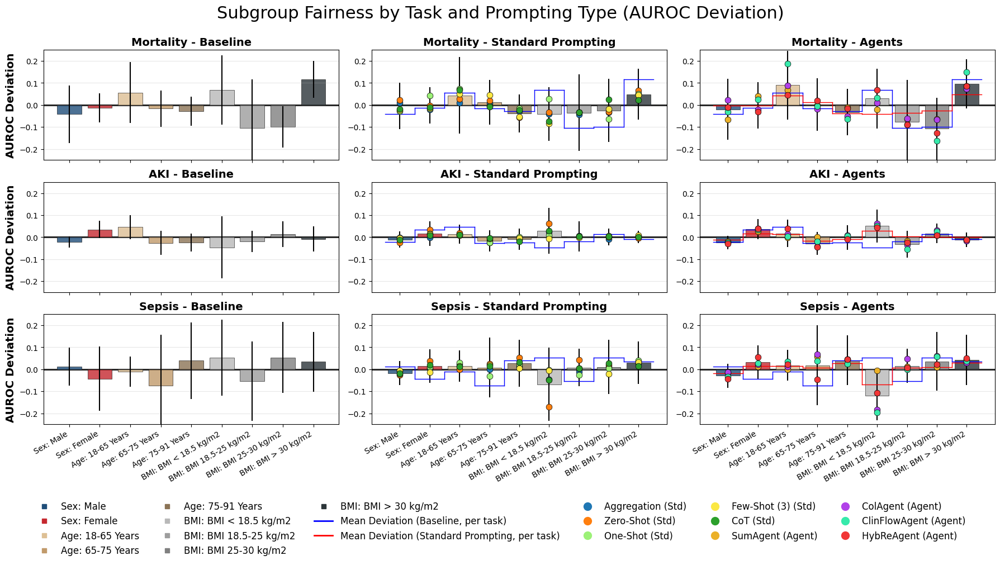

Saved: ./notebook_output/pulse_agents_overall/subgroup_fairness/subgroup_fairness_panel_by_task_and_prompting_auroc_deviation_models.png


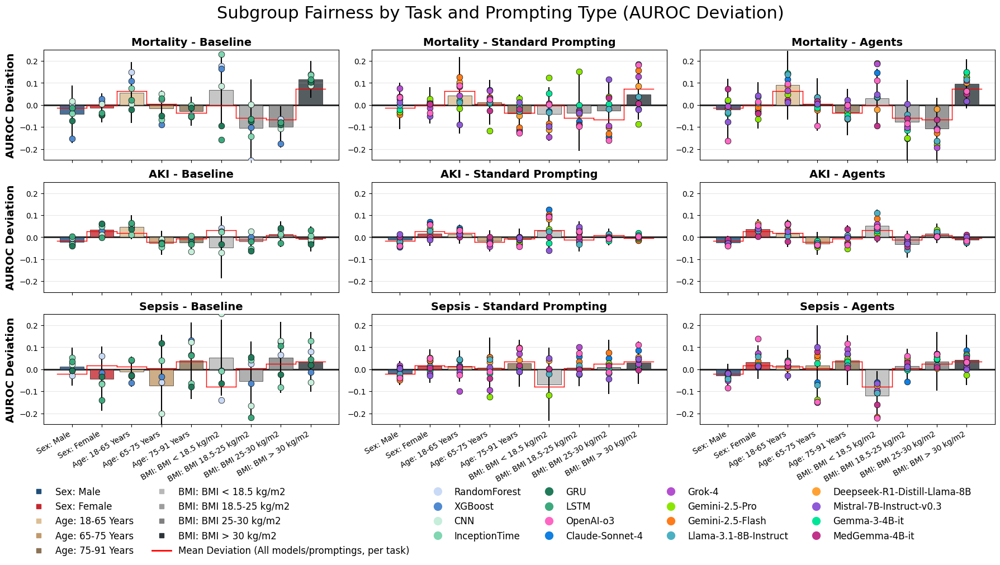

Saved: ./notebook_output/pulse_agents_overall/subgroup_fairness/subgroup_fairness_panel_by_task_and_prompting_auroc_deviation.png


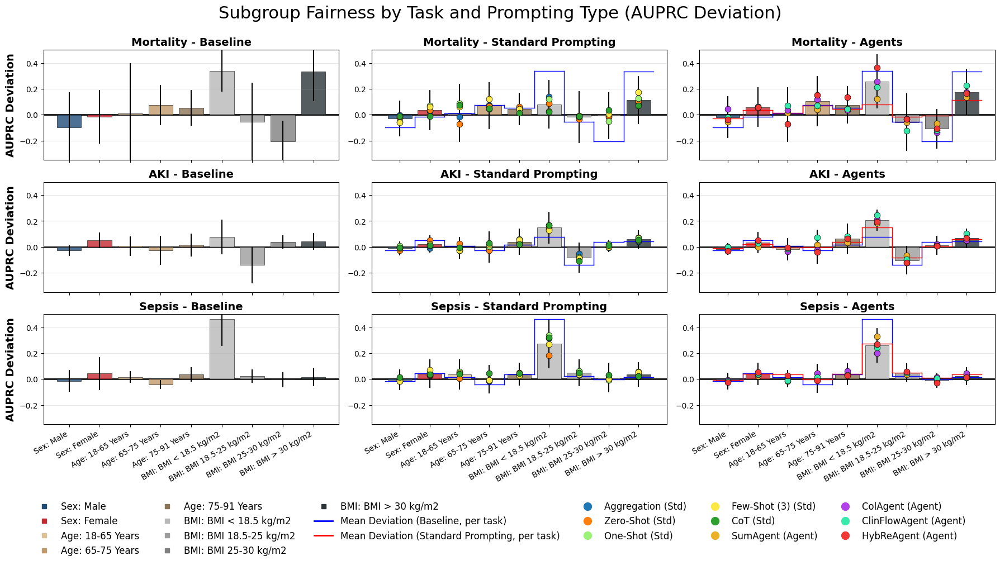

Saved: ./notebook_output/pulse_agents_overall/subgroup_fairness/subgroup_fairness_panel_by_task_and_prompting_auroc_deviation_models.png


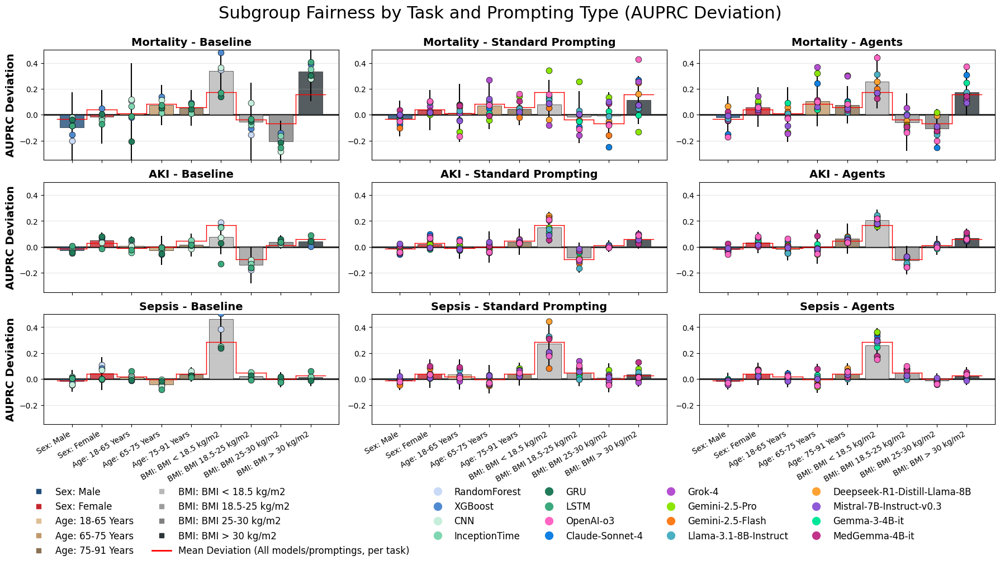

In [20]:
def plot_subgroup_fairness_panel_by_task_and_prompting(
    df_metrics_subgroup,
    metric="AUROC",
    save_path=None,
    figsize=(18, 12),
    marker_type="prompting_id",
):
    """
    Improved visualization:
    - Mean deviation per subgroup is shown as a step line (horizontal and vertical segments).
    - For marker_type="prompting_id":
        - No line in Baseline subplot.
        - Blue line in Standard Prompting subplot: outline of Baseline (mean deviation for Baseline, per task).
        - Agents subplot: blue line (Baseline) + red line (Standard Prompting) for the same task.
    - For marker_type="models":
        - Each row (task) gets its own mean deviation line (aggregated across all datasets, models, and prompting ids for that task).
        - This line is shown in all three subplots of the row.
    - Markers show either aggregated deviation per prompting_id (default) or per model (if marker_type="models") for each subgroup.
      Colors for these markers are taken from PROMPTING_ID_MAPPING or MODEL_MAPPING.
    - Legend includes subgroup colors, mean deviation line, and marker legend, with aggregation level indicated.
    - Subplot titles: fontsize 14, bold.
    - Adds horizontal black line at y=0.

    Args:
        df_metrics_subgroup (DataFrame): Metrics DataFrame with subgroup data.
        metric (str): Metric to plot (default: "AUROC").
        save_path (str): Path to save plot (optional).
        figsize (tuple): Figure size.
        marker_type (str): "prompting_id" (default) or "models" for marker legend.
    """

    # Prepare deviation dataframe (signed deviation for this visualization)
    df_dev = compute_subgroup_deviation(df_metrics_subgroup, metric, absolute=False)
    df_dev["prompting_id"] = df_dev["model_prompting_id"].apply(
        lambda x: x.split(",")[-1].strip() if "," in x else x
    )
    df_dev["base_model"] = df_dev["model_prompting_id"].apply(
        lambda x: x.split(",")[0].strip()
    )

    tasks = ["Mortality", "AKI", "Sepsis"]
    prompting_types = [
        ("Baseline", lambda row: row["base_model"] in CONVML_MODELS + CONVDL_MODELS),
        (
            "Standard Prompting",
            lambda row: row["prompting_id"] in STANDARD_PROMPTING_IDS,
        ),
        ("Agents", lambda row: row["prompting_id"] in AGENTIC_PROMPTING_IDS),
    ]
    subgroup_types = ["Sex", "Age", "BMI"]

    # Build list of all subgroup values and their colors
    all_subgroup_values = []
    all_subgroup_colors = []
    for subgroup in subgroup_types:
        for value in SUBGROUP_MAPPING[subgroup]:
            all_subgroup_values.append(f"{subgroup}: {value}")
            all_subgroup_colors.append(SUBGROUP_MAPPING[subgroup][value])

    # --- Precompute mean deviation lines for each task and prompting type ---
    # For marker_type="prompting_id":
    #   - Baseline: mean deviation for Baseline, per task (blue)
    #   - Standard Prompting: mean deviation for Baseline (blue)
    #   - Agents: mean deviation for Baseline (blue) + mean deviation for Standard Prompting (red)
    # For marker_type="models":
    #   - For each task, mean deviation line (aggregated across all datasets, models, and prompting ids for that task)
    #   - This line is shown in all three subplots of the row

    # Compute mean deviation lines per task and prompting type
    mean_deviation_lines = {}  # (task, prompting_type) -> list of y values

    for task in tasks:
        for pt_name, pt_func in prompting_types:
            mask = (df_dev["Task"] == task) & df_dev.apply(pt_func, axis=1)
            df_sub = df_dev[mask]
            agg = (
                df_sub[df_sub["subgroup_type"] != "Overall"]
                .groupby(["subgroup_type", "subgroup_value"])["subgroup_deviation"]
                .mean()
                .reset_index()
            )
            yvals = []
            for subgroup in subgroup_types:
                for value in SUBGROUP_MAPPING[subgroup]:
                    row = agg[
                        (agg["subgroup_type"] == subgroup)
                        & (agg["subgroup_value"] == value)
                    ]
                    yvals.append(
                        row["subgroup_deviation"].values[0] if not row.empty else 0
                    )
            mean_deviation_lines[(task, pt_name)] = yvals

    # For marker_type="models", precompute mean deviation line per task (across all datasets, models, and prompting ids for that task)
    mean_deviation_lines_task = {}
    for task in tasks:
        mask = df_dev["Task"] == task
        df_sub = df_dev[mask]
        agg = (
            df_sub[df_sub["subgroup_type"] != "Overall"]
            .groupby(["subgroup_type", "subgroup_value"])["subgroup_deviation"]
            .mean()
            .reset_index()
        )
        yvals = []
        for subgroup in subgroup_types:
            for value in SUBGROUP_MAPPING[subgroup]:
                row = agg[
                    (agg["subgroup_type"] == subgroup)
                    & (agg["subgroup_value"] == value)
                ]
                yvals.append(
                    row["subgroup_deviation"].values[0] if not row.empty else 0
                )
        mean_deviation_lines_task[task] = yvals

    fig, axes = plt.subplots(
        len(tasks), len(prompting_types), figsize=figsize,
    )
    fig.suptitle(
        f"Subgroup Fairness by Task and Prompting Type ({metric} Deviation)",
        fontsize=22,
        y=0.98,
    )

    for i, task in enumerate(tasks):
        for j, (pt_name, pt_func) in enumerate(prompting_types):
            ax = axes[i, j]
            # Filter for all subgroups for this task and prompting type
            mask = (df_dev["Task"] == task) & df_dev.apply(pt_func, axis=1)
            df_sub = df_dev[mask]
            if df_sub.empty:
                ax.text(
                    0.5,
                    0.5,
                    "No data",
                    ha="center",
                    va="center",
                    transform=ax.transAxes,
                    fontsize=12,
                )
                ax.set_xticks([])
                ax.set_yticks([])
                continue

            # Aggregate by subgroup_type and subgroup_value
            agg = (
                df_sub[df_sub["subgroup_type"] != "Overall"]
                .groupby(["subgroup_type", "subgroup_value"])["subgroup_deviation"]
                .agg(["mean", "std", "count"])
                .reset_index()
            )
            # Build x labels and colors
            x_labels = []
            bar_colors = []
            means = []
            stds = []
            for subgroup in subgroup_types:
                for value in SUBGROUP_MAPPING[subgroup]:
                    label = f"{subgroup}: {value}"
                    row = agg[
                        (agg["subgroup_type"] == subgroup)
                        & (agg["subgroup_value"] == value)
                    ]
                    if not row.empty:
                        means.append(row["mean"].values[0])
                        stds.append(row["std"].values[0])
                    else:
                        means.append(0)
                        stds.append(0)
                    x_labels.append(label)
                    bar_colors.append(SUBGROUP_MAPPING[subgroup][value])

            # Bar chart: deviation (can be negative or positive)
            ax.bar(
                x_labels,
                means,
                yerr=stds,
                color=bar_colors,
                alpha=0.8,
                edgecolor="black",
                linewidth=0.5,
            )

            # --- Draw mean deviation lines according to marker_type and subplot ---
            x_pos = np.arange(len(x_labels))
            # For marker_type="prompting_id"
            if marker_type == "prompting_id":
                if pt_name == "Baseline":
                    # No line
                    pass
                elif pt_name == "Standard Prompting":
                    # Blue line: Baseline outline for this task
                    yvals = mean_deviation_lines[(task, "Baseline")]
                    for k in range(len(yvals)):
                        ax.plot(
                            [k - 0.5, k + 0.5],
                            [yvals[k], yvals[k]],
                            color="blue",
                            linestyle="-",
                            linewidth=1,
                            zorder=12,
                        )
                    for k in range(1, len(yvals)):
                        ax.plot(
                            [k - 0.5, k - 0.5],
                            [yvals[k - 1], yvals[k]],
                            color="blue",
                            linestyle="-",
                            linewidth=1,
                            zorder=12,
                        )
                elif pt_name == "Agents":
                    # Blue line: Baseline outline for this task
                    yvals_baseline = mean_deviation_lines[(task, "Baseline")]
                    for k in range(len(yvals_baseline)):
                        ax.plot(
                            [k - 0.5, k + 0.5],
                            [yvals_baseline[k], yvals_baseline[k]],
                            color="blue",
                            linestyle="-",
                            linewidth=1,
                            zorder=12,
                        )
                    for k in range(1, len(yvals_baseline)):
                        ax.plot(
                            [k - 0.5, k - 0.5],
                            [yvals_baseline[k - 1], yvals_baseline[k]],
                            color="blue",
                            linestyle="-",
                            linewidth=1,
                            zorder=12,
                        )
                    # Red line: Standard Prompting outline for this task
                    yvals_std = mean_deviation_lines[(task, "Standard Prompting")]
                    for k in range(len(yvals_std)):
                        ax.plot(
                            [k - 0.5, k + 0.5],
                            [yvals_std[k], yvals_std[k]],
                            color="red",
                            linestyle="-",
                            linewidth=1,
                            zorder=13,
                        )
                    for k in range(1, len(yvals_std)):
                        ax.plot(
                            [k - 0.5, k - 0.5],
                            [yvals_std[k - 1], yvals_std[k]],
                            color="red",
                            linestyle="-",
                            linewidth=1,
                            zorder=13,
                        )
            elif marker_type == "models":
                # Show mean deviation line for this task (across all datasets, models, and prompting ids for this task)
                yvals = mean_deviation_lines_task[task]
                for k in range(len(yvals)):
                    ax.plot(
                        [k - 0.5, k + 0.5],
                        [yvals[k], yvals[k]],
                        color="red",
                        linestyle="-",
                        linewidth=1,
                        zorder=12,
                    )
                for k in range(1, len(yvals)):
                    ax.plot(
                        [k - 0.5, k - 0.5],
                        [yvals[k - 1], yvals[k]],
                        color="red",
                        linestyle="-",
                        linewidth=1,
                        zorder=12,
                    )

            # Overlay colored markers for aggregated deviation per prompting_id or per model
            if marker_type == "models":
                # Show markers for each model used in this subplot (including baseline)
                model_list = sorted(df_sub["base_model"].unique())
                # For baseline, always include CONVML_MODELS + CONVDL_MODELS
                if pt_name == "Baseline":
                    baseline_models = [
                        m for m in CONVML_MODELS + CONVDL_MODELS if m in model_list
                    ]
                    model_list = baseline_models
                for model in model_list:
                    model_df = df_sub[df_sub["base_model"] == model]
                    if model_df.empty:
                        continue
                    # Aggregate deviation for each subgroup value
                    agg_model = (
                        model_df.groupby(["subgroup_type", "subgroup_value"])[
                            "subgroup_deviation"
                        ]
                        .mean()
                        .reset_index()
                    )
                    # Plot marker for each subgroup value
                    for idx, (subgroup, value) in enumerate(
                        [(sg, v) for sg in subgroup_types for v in SUBGROUP_MAPPING[sg]]
                    ):
                        row = agg_model[
                            (agg_model["subgroup_type"] == subgroup)
                            & (agg_model["subgroup_value"] == value)
                        ]
                        if not row.empty:
                            y = row["subgroup_deviation"].values[0]
                            ax.scatter(
                                idx,
                                y,
                                marker="o",
                                color=MODEL_MAPPING.get(model, "#666666"),
                                s=60,
                                edgecolor="black",
                                linewidth=0.5,
                                label=(
                                    f"{model}"
                                    if i == 0
                                    and (
                                        (pt_name == "Baseline" and j == 0)
                                        or (pt_name == "Standard Prompting" and j == 1)
                                        or (pt_name == "Agents" and j == 2)
                                    )
                                    else None
                                ),
                                zorder=15,
                            )
            elif (
                pt_name in ["Standard Prompting", "Agents"]
                and marker_type == "prompting_id"
            ):
                pid_list = (
                    STANDARD_PROMPTING_IDS
                    if pt_name == "Standard Prompting"
                    else AGENTIC_PROMPTING_IDS
                )
                for pid in pid_list:
                    pid_df = df_sub[df_sub["prompting_id"] == pid]
                    if pid_df.empty:
                        continue
                    # Aggregate deviation for each subgroup value
                    agg_pid = (
                        pid_df.groupby(["subgroup_type", "subgroup_value"])[
                            "subgroup_deviation"
                        ]
                        .mean()
                        .reset_index()
                    )
                    # Plot marker for each subgroup value
                    for idx, (subgroup, value) in enumerate(
                        [(sg, v) for sg in subgroup_types for v in SUBGROUP_MAPPING[sg]]
                    ):
                        row = agg_pid[
                            (agg_pid["subgroup_type"] == subgroup)
                            & (agg_pid["subgroup_value"] == value)
                        ]
                        if not row.empty:
                            y = row["subgroup_deviation"].values[0]
                            ax.scatter(
                                idx,
                                y,
                                marker="o",
                                color=PROMPTING_ID_MAPPING.get(pid, "#666666"),
                                s=60,
                                edgecolor="black",
                                linewidth=0.5,
                                label=(
                                    f"{pid}"
                                    if i == 0
                                    and (
                                        (pt_name == "Standard Prompting" and j == 1)
                                        or (pt_name == "Agents" and j == 2)
                                    )
                                    else None
                                ),
                                zorder=15,
                            )

            # Add horizontal black line at y=0
            ax.axhline(
                y=0, color="black", linestyle="-", linewidth=2, alpha=1.0, zorder=0
            )

            # Subplot title: fontsize 14, bold
            ax.set_title(f"{task} - {pt_name}", fontsize=14, fontweight="bold")
            ax.set_xlabel("")
            if j == 0:
                ax.set_ylabel(f"{metric} Deviation", fontsize=14, fontweight="bold")
            ax.set_xticks(range(len(x_labels)))
            if i == len(tasks) - 1:
                ax.set_xticklabels(x_labels, rotation=30, ha="right", fontsize=10)
            else:
                ax.set_xticklabels([])
            ax.grid(axis="y", alpha=0.3)
            if metric == "AUROC":
                ax.set_ylim(-0.25, 0.25)
            elif metric == "AUPRC":
                ax.set_ylim(-0.35, 0.5)
            else:
                ax.set_ylim(-0.5, 0.5)

    # --- Legend ---
    legend_handles = []
    # Subgroup colors
    for subgroup in SUBGROUP_MAPPING:
        for value, color in SUBGROUP_MAPPING[subgroup].items():
            legend_handles.append(
                plt.Line2D(
                    [0],
                    [0],
                    color=color,
                    marker="s",
                    linestyle="",
                    label=f"{subgroup}: {value}",
                )
            )
    # Mean deviation lines
    if marker_type == "prompting_id":
        legend_handles.append(
            plt.Line2D(
                [0],
                [0],
                color="blue",
                linestyle="-",
                linewidth=2,
                label="Mean Deviation (Baseline, per task)",
            )
        )
        legend_handles.append(
            plt.Line2D(
                [0],
                [0],
                color="red",
                linestyle="-",
                linewidth=2,
                label="Mean Deviation (Standard Prompting, per task)",
            )
        )
    elif marker_type == "models":
        legend_handles.append(
            plt.Line2D(
                [0],
                [0],
                color="red",
                linestyle="-",
                linewidth=2,
                label="Mean Deviation (All models/promptings, per task)",
            )
        )
    # Marker legend
    if marker_type == "prompting_id":
        for pid in STANDARD_PROMPTING_IDS:
            legend_handles.append(
                plt.Line2D(
                    [0],
                    [0],
                    color=PROMPTING_ID_MAPPING.get(pid, "#666666"),
                    marker="o",
                    linestyle="",
                    markersize=10,
                    label=f"{pid} (Std)",
                )
            )
        for pid in AGENTIC_PROMPTING_IDS:
            legend_handles.append(
                plt.Line2D(
                    [0],
                    [0],
                    color=PROMPTING_ID_MAPPING.get(pid, "#666666"),
                    marker="o",
                    linestyle="",
                    markersize=10,
                    label=f"{pid} (Agent)",
                )
            )
    elif marker_type == "models":
        for model in CONVML_MODELS + CONVDL_MODELS + LLM_MODELS:
            if model in MODEL_MAPPING:
                legend_handles.append(
                    plt.Line2D(
                        [0],
                        [0],
                        color=MODEL_MAPPING[model],
                        marker="o",
                        linestyle="",
                        markersize=10,
                        label=f"{model}",
                    )
                )

    fig.legend(
        handles=legend_handles,
        loc="lower center",
        bbox_to_anchor=(0.5, -0.02),
        ncol=6,
        fontsize=12,
        frameon=False,
    )

    plt.tight_layout()
    plt.subplots_adjust(bottom=0.23, top=0.9, hspace=0.2)
    if save_path:
        plt.savefig(save_path, dpi=400, bbox_inches="tight")
        print(f"Saved: {save_path}")
    plt.show()


# --- AUROC ---
# Default: markers show prompting_id
plot_subgroup_fairness_panel_by_task_and_prompting(
    df_metrics_subgroup,
    metric="AUROC",
    save_path=os.path.join(
        fairness_output_dir,
        "subgroup_fairness_panel_by_task_and_prompting_auroc_deviation.png",
    ),
    figsize=(18, 10),
    marker_type="prompting_id",
)

# Alternative: markers show models used in each subplot (including baseline models)
plot_subgroup_fairness_panel_by_task_and_prompting(
    df_metrics_subgroup,
    metric="AUROC",
    save_path=os.path.join(
        fairness_output_dir,
        "subgroup_fairness_panel_by_task_and_prompting_auroc_deviation_models.png",
    ),
    figsize=(18, 10),
    marker_type="models",
)

# --- AUPRC ---
# Default: markers show prompting_id
plot_subgroup_fairness_panel_by_task_and_prompting(
    df_metrics_subgroup,
    metric="AUPRC",
    save_path=os.path.join(
        fairness_output_dir,
        "subgroup_fairness_panel_by_task_and_prompting_auroc_deviation.png",
    ),
    figsize=(18, 10),
    marker_type="prompting_id",
)

# Alternative: markers show models used in each subplot (including baseline models)
plot_subgroup_fairness_panel_by_task_and_prompting(
    df_metrics_subgroup,
    metric="AUPRC",
    save_path=os.path.join(
        fairness_output_dir,
        "subgroup_fairness_panel_by_task_and_prompting_auroc_deviation_models.png",
    ),
    figsize=(18, 10),
    marker_type="models",
)

In [21]:
# --- Subgroup Fairness Panel Summary ---

def summarize_subgroup_fairness_panel(df_metrics_subgroup, metric="AUROC"):
    """
    Summarizes key findings from the subgroup fairness panel visualizations:
    - Compares fairness (deviation from overall) for Baseline, Standard Prompting, and Agentic methods.
    - Identifies the fairest and least fair prompting strategies and models.
    - Prints actionable statements for reporting.

    Args:
        df_metrics_subgroup (DataFrame): Metrics DataFrame with subgroup data.
        metric (str): Metric to use for deviation (default: "AUROC").
    """
    # Compute signed subgroup deviation
    df_dev = compute_subgroup_deviation(df_metrics_subgroup, metric, absolute=False)
    df_dev["prompting_id"] = df_dev["model_prompting_id"].apply(
        lambda x: x.split(",")[-1].strip() if "," in x else x
    )
    df_dev["base_model"] = df_dev["model_prompting_id"].apply(
        lambda x: x.split(",")[0].strip()
    )

    # Aggregate mean absolute deviation by prompting type
    def get_prompting_type(row):
        if row["base_model"] in CONVML_MODELS + CONVDL_MODELS:
            return "Baseline"
        elif row["prompting_id"] in STANDARD_PROMPTING_IDS:
            return "Standard Prompting"
        elif row["prompting_id"] in AGENTIC_PROMPTING_IDS:
            return "Agentic Prompting"
        else:
            return "Other"

    df_dev["prompting_type"] = df_dev.apply(get_prompting_type, axis=1)
    agg_type = (
        df_dev.groupby("prompting_type")["subgroup_deviation"]
        .apply(lambda x: np.mean(np.abs(x)))
        .sort_values()
    )

    # Aggregate by prompting_id
    agg_pid = (
        df_dev.groupby("prompting_id")["subgroup_deviation"]
        .apply(lambda x: np.mean(np.abs(x)))
        .sort_values()
    )

    # Aggregate by model
    agg_model = (
        df_dev.groupby("base_model")["subgroup_deviation"]
        .apply(lambda x: np.mean(np.abs(x)))
        .sort_values()
    )

    print("=== Subgroup Fairness Panel Summary ===")
    print(f"\nMean absolute subgroup deviation ({metric}):")
    for pt, val in agg_type.items():
        print(f"- {pt}: {val:.4f}")

    fairest_type = agg_type.idxmin()
    least_fair_type = agg_type.idxmax()
    print(f"\n➡️  '{fairest_type}' methods are the fairest overall (lowest deviation).")
    print(f"➡️  '{least_fair_type}' methods are the least fair overall (highest deviation).")

    print("\nPrompting strategies ranked by fairness (mean absolute deviation):")
    print(agg_pid)

    print("\nModels ranked by fairness (mean absolute deviation):")
    print(agg_model)

    print(f"\nFairest prompting strategy: '{agg_pid.index[0]}' ({agg_pid.iloc[0]:.4f})")
    print(f"Least fair prompting strategy: '{agg_pid.index[-1]}' ({agg_pid.iloc[-1]:.4f})")
    print(f"Fairest model: '{agg_model.index[0]}' ({agg_model.iloc[0]:.4f})")
    print(f"Least fair model: '{agg_model.index[-1]}' ({agg_model.iloc[-1]:.4f})")

    print("\nSummary:")
    print(f"- Standard prompting and agentic methods can be more fair than baselines, depending on the strategy.")
    print(f"- The fairest prompting_id is '{agg_pid.index[0]}', while '{agg_pid.index[-1]}' is the least fair.")
    print(f"- The fairest model is '{agg_model.index[0]}', and the least fair is '{agg_model.index[-1]}'.")

# Example usage:
summarize_subgroup_fairness_panel(df_metrics_subgroup, metric="AUROC")
summarize_subgroup_fairness_panel(df_metrics_subgroup, metric="AUPRC")

=== Subgroup Fairness Panel Summary ===

Mean absolute subgroup deviation (AUROC):
- Standard Prompting: 0.0581
- Agentic Prompting: 0.0704
- Baseline: 0.0759

➡️  'Standard Prompting' methods are the fairest overall (lowest deviation).
➡️  'Baseline' methods are the least fair overall (highest deviation).

Prompting strategies ranked by fairness (mean absolute deviation):
prompting_id
Aggregation      0.046542
CoT              0.052998
One-Shot         0.060583
Few-Shot (3)     0.061621
Zero-Shot        0.064644
GRU              0.065571
ColAgent         0.066506
XGBoost          0.069036
SumAgent         0.069335
HybReAgent       0.070215
RandomForest     0.070452
ClinFlowAgent    0.075895
InceptionTime    0.081179
CNN              0.082702
LSTM             0.086726
Name: subgroup_deviation, dtype: float64

Models ranked by fairness (mean absolute deviation):
base_model
Gemma-3-4B-it                   0.052643
MedGemma-4B-it                  0.053808
Llama-3.1-8B-Instruct           0

#### Radar Charts

In [22]:
def get_best_prompting_strategy_per_model(data, metric='AUROC'):
    """
    For each base model, find the prompting strategy that performs best on average.
    
    Args:
        data (DataFrame): Metrics DataFrame
        metric (str): Metric to use for selecting best strategy
        
    Returns:
        dict: Dictionary mapping base model to best strategy info
    """
    best_strategies = {}
    
    for model_id in data['model_prompting_id'].unique():
        if model_id not in CONVML_MODELS + CONVDL_MODELS:
            # Extract base model name (everything before first comma)
            base_model = model_id.split(',')[0].strip()
            if base_model not in best_strategies:
                best_strategies[base_model] = {'strategy': model_id, 'score': -1}
            
            # Calculate average performance for this strategy
            avg_score = data[data['model_prompting_id'] == model_id][metric].mean()
            if not pd.isna(avg_score) and avg_score > best_strategies[base_model]['score']:
                best_strategies[base_model] = {'strategy': model_id, 'score': avg_score}
    
    return best_strategies


def create_combined_metrics_radar_grid(
    df_metrics, 
    save_path=None, 
    show_plots=True, 
    figsize_per_chart=(7, 7), 
    suptitle="Model Performance Comparison Across All Metrics",
    llm_display_mode='best_strategy'
):
    """
    Create a combined grid of radar charts, one for each metric.
    
    Args:
        df_metrics (DataFrame): Metrics DataFrame
        save_path (str, optional): Path to save the combined figure
        show_plots (bool): Whether to display the plots
        figsize_per_chart (tuple): Size of each individual chart
        suptitle (str): Main title for the combined figure
        llm_display_mode (str): How to display LLMs - 'all_combinations' or 'best_strategy'
    
    Returns:
        matplotlib.figure.Figure: The combined figure
    """
    tasks_radar = df_metrics["Task"].unique()
    datasets_radar = df_metrics["Dataset"].unique()
    
    # Get models based on display mode
    if llm_display_mode == 'all_combinations':
        models_radar = df_metrics["model_prompting_id"].unique()
    else:  # best_strategy
        # Get base models (convML/convDL use model_prompting_id, LLMs use base model names)
        base_models = set()
        for model_id in df_metrics["model_prompting_id"].unique():
            if model_id in CONVML_MODELS + CONVDL_MODELS:
                base_models.add(model_id)
            else:
                base_model = model_id.split(',')[0].strip()
                base_models.add(base_model)
        models_radar = sorted(base_models)
    
    # Determine which metrics are available
    available_metrics = [m for m in METRICS_LIST if m in df_metrics.columns]
    num_metrics = len(available_metrics)
    
    if num_metrics == 0:
        print("No metrics available in the data")
        return None
    
    # Calculate grid dimensions
    cols = 3
    rows = int(np.ceil(num_metrics / cols))
    
    # Create figure
    fig_width = figsize_per_chart[0] * cols
    fig_height = figsize_per_chart[1] * rows
    fig, axes = plt.subplots(rows, cols, figsize=(fig_width, fig_height), subplot_kw=dict(polar=True))
    fig.suptitle(suptitle, fontsize=24)


    # Flatten axes array for easier iteration
    axes_flat = axes.flatten() if hasattr(axes, 'flatten') else [axes]

    # Plot each metric
    for i, metric in enumerate(available_metrics):
        if i < len(axes_flat):
            # Create the radar chart on the current subplot
            create_radar_chart_for_metric(
                metric=metric,
                data=df_metrics,
                models=models_radar,
                ax=axes_flat[i],
                llm_display_mode=llm_display_mode
            )
        
    # Handle case where we have fewer metrics than subplot positions
    for i in range(num_metrics, len(axes_flat)):
        axes_flat[i].axis('off')

    plt.tight_layout()
    fig.subplots_adjust(hspace=0.4, wspace=0.6, top=0.92)
    
    # Save if requested
    if save_path:
        os.makedirs(os.path.dirname(save_path), exist_ok=True)
        plt.savefig(save_path, dpi=400, bbox_inches='tight')
        print(f"   Saved combined metrics chart to: {save_path}")
    
    # Show if requested
    if show_plots:
        plt.show()
    else:
        plt.close(fig)
    
    return fig


def create_combined_task_dataset_radar_grid(
    df_metrics, 
    save_path=None, 
    show_plots=True, 
    figsize_per_chart=(7, 7), 
    suptitle="Model Performance Comparison Across Tasks and Datasets",
    llm_display_mode='best_strategy'
):
    """
    Create a combined grid of radar charts, one for each task-dataset combination.
    
    Args:
        df_metrics (DataFrame): Metrics DataFrame
        save_path (str, optional): Path to save the combined figure
        show_plots (bool): Whether to display the plots
        figsize_per_chart (tuple): Size of each individual chart
        suptitle (str): Main title for the combined figure
        llm_display_mode (str): How to display LLMs - 'all_combinations' or 'best_strategy'
    
    Returns:
        matplotlib.figure.Figure: The combined figure
    """
    tasks_radar = df_metrics["Task"].unique()
    datasets_radar = df_metrics["Dataset"].unique()
    
    num_tasks = len(tasks_radar)
    num_datasets = len(datasets_radar)
    
    # Create figure
    fig_width = figsize_per_chart[0] * num_datasets
    fig_height = figsize_per_chart[1] * num_tasks
    fig, axes = plt.subplots(num_tasks, num_datasets, figsize=(fig_width, fig_height), subplot_kw=dict(polar=True))
    fig.suptitle(suptitle, fontsize=24)
    fig.subplots_adjust(hspace=0.4, wspace=0.4, top=0.95)

    # Handle different axis array shapes
    if num_tasks == 1 and num_datasets == 1:
        axes = np.array([[axes]])
    elif num_tasks == 1:
        axes = axes.reshape(1, -1)
    elif num_datasets == 1:
        axes = axes.reshape(-1, 1)

    # Loop over tasks (rows) and datasets (columns)
    for i, task in enumerate(tasks_radar):
        for j, dataset in enumerate(datasets_radar):
            ax = axes[i, j] if num_tasks > 1 or num_datasets > 1 else axes[0, 0]
            
            # Check if this combination exists in the data
            task_dataset_data = df_metrics[(df_metrics['Task'] == task) & (df_metrics['Dataset'] == dataset)]
            if len(task_dataset_data) > 0:
                radar_chart_by_task_dataset(
                    task=task,
                    dataset=dataset,
                    data=df_metrics,
                    ax=ax,
                    llm_display_mode=llm_display_mode
                )
            else:
                ax.text(0.5, 0.5, f'No data for\n{task}-{dataset}', 
                        ha='center', va='center', transform=ax.transAxes, fontsize=12)
                ax.set_xticks([])
                ax.set_yticks([])

    plt.tight_layout(rect=[0, 0, 1, 0.98])
    
    # Save if requested
    if save_path:
        os.makedirs(os.path.dirname(save_path), exist_ok=True)
        plt.savefig(save_path, dpi=400, bbox_inches='tight')
        print(f"   Saved combined task-dataset chart to: {save_path}")
    
    # Show if requested
    if show_plots:
        plt.show()
    else:
        plt.close(fig)
    
    return fig


def generate_individual_radar_charts(df_metrics, output_dirs, llm_display_mode='best_strategy'):
    """
    Generate all individual radar charts and save them to specified directories.
    
    Args:
        df_metrics (DataFrame): Metrics DataFrame
        output_dirs (dict): Dictionary with 'metrics' and 'tasks' keys pointing to output directories
        llm_display_mode (str): How to display LLMs - 'all_combinations' or 'best_strategy'
    """
    tasks_radar = df_metrics["Task"].unique()
    datasets_radar = df_metrics["Dataset"].unique()
    
    # Get models based on display mode
    if llm_display_mode == 'all_combinations':
        models_radar = df_metrics["model_prompting_id"].unique()
    else:  # best_strategy
        base_models = set()
        for model_id in df_metrics["model_prompting_id"].unique():
            if model_id in CONVML_MODELS + CONVDL_MODELS:
                base_models.add(model_id)
            else:
                base_model = model_id.split(',')[0].strip()
                base_models.add(base_model)
        models_radar = sorted(base_models)
    
    # Generate individual radar charts by metrics
    print(f"\n🎯 Generating individual radar charts by metrics...")
    for metric in METRICS_LIST:
        if metric in df_metrics.columns:
            save_path = os.path.join(
                output_dirs['metrics'], 
                f"{metric.replace('/', '_').replace(' ', '_')}_radar_chart.png"
            )
            fig, ax = create_radar_chart_for_metric(
                metric=metric,
                data=df_metrics,
                models=models_radar,
                save_path=save_path,
                llm_display_mode=llm_display_mode
            )
            plt.close(fig)  # Close to save memory
        else:
            print(f"   ⚠️  Metric {metric} not found in data")

    # Generate individual radar charts by task-dataset
    print(f"\n🎯 Generating individual radar charts by task-dataset...")
    for task in tasks_radar:
        for dataset in datasets_radar:
            # Check if this combination exists in the data
            task_dataset_data = df_metrics[(df_metrics['Task'] == task) & (df_metrics['Dataset'] == dataset)]
            if len(task_dataset_data) > 0:
                save_path = os.path.join(output_dirs['tasks'], f"{task}_{dataset}_radar_chart.png")
                fig, ax = radar_chart_by_task_dataset(
                    task=task,
                    dataset=dataset,
                    data=df_metrics,
                    save_path=save_path,
                    llm_display_mode=llm_display_mode
                )
                plt.close(fig)  # Close to save memory
            else:
                print(f"   ⚠️  No data found for {task}-{dataset}")


def create_radar_chart_for_metric(metric, data, models=None, save_path=None, ax=None, llm_display_mode='best_strategy'):
    """
    Create a radar chart for a specific metric comparing all models across task-dataset combinations.
    
    Args:
        metric (str): Metric to plot
        data (DataFrame): Metrics DataFrame
        models (list): List of models to include
        save_path (str): Optional path to save
        ax: Matplotlib axis
        llm_display_mode (str): 'all_combinations' or 'best_strategy'
    """
    # If no models specified, determine based on display mode
    if models is None:
        if llm_display_mode == 'all_combinations':
            models = data["model_prompting_id"].unique()
        else:  # best_strategy
            base_models = set()
            for model_id in data["model_prompting_id"].unique():
                if model_id in CONVML_MODELS + CONVDL_MODELS:
                    base_models.add(model_id)
                else:
                    base_model = model_id.split(',')[0].strip()
                    base_models.add(base_model)
            models = sorted(base_models)
    
    # Use unique values from the data for tasks and datasets
    task_order = list(data['Task'].unique())
    dataset_order = list(data['Dataset'].unique())
    
    # Use the specified order for tasks and datasets
    task_dataset_combinations = []
    for task in task_order:
        for dataset in dataset_order:
            filtered_data = data[(data['Task'] == task) & (data['Dataset'] == dataset)]
            if not filtered_data.empty:
                task_dataset_combinations.append(f"{task}-{dataset}")
    
    # Number of task-dataset combinations (axes)
    N = len(task_dataset_combinations)
    
    # Angle of each axis
    angles = [n / float(N) * 2 * np.pi for n in range(N)]
    angles += angles[:1]  # Close the polygon
    
    # Initialize the plot if no ax provided
    if ax is None:
        fig, ax = plt.subplots(figsize=(10, 10), subplot_kw=dict(polar=True))
    else:
        fig = plt.gcf()
    
    # Set the angle for each axis
    ax.set_theta_offset(np.pi / 2)  # Start from the top
    ax.set_theta_direction(-1)  # Go clockwise
    
    # Define class prevalence for baseline calculations
    class_prevalence = {
        "Mortality": {"HiRID": 0.110, "MIMIC-IV": 0.120, "eICU": 0.070},
        "AKI": {"HiRID": 0.162, "MIMIC-IV": 0.233, "eICU": 0.310},
        "Sepsis": {"HiRID": 0.075, "MIMIC-IV": 0.025, "eICU": 0.048},
    }
    
    # Calculate baseline values for this metric
    baseline_values = []
    for combination in task_dataset_combinations:
        task, dataset = combination.split('-', 1)
        prevalence = class_prevalence.get(task, {}).get(dataset, 0)
        baseline = {
            "AUROC": 0.5,
            "AUPRC": prevalence,
            "Normalized AUPRC": 1,
            "Min(+P, Se)": prevalence,
            "Sensitivity (Recall)": prevalence,
            "Specificity": 1 - prevalence,
            "Precision": prevalence,
            "F1 Score": prevalence,
            "Accuracy": max(prevalence, 1 - prevalence),
            "Balanced Accuracy": 0.5,
            "MCC": 0,
            "Cohen's Kappa": 0
        }.get(metric, 0)
        baseline_values.append(baseline)
    
    baseline_values += baseline_values[:1]  # Close the polygon
    
    # Plot baseline
    ax.plot(
        angles,
        baseline_values,
        linewidth=1,
        linestyle="dashed",
        color="red",
        label="Random Guessing",
        zorder=5,
    )
    
    # Get best strategies if using best_strategy mode
    if llm_display_mode == 'best_strategy':
        best_strategies = get_best_prompting_strategy_per_model(data, metric)
    
    # Plot each model
    for model in models:
        model_values = []
        for combination in task_dataset_combinations:
            task, dataset = combination.split('-', 1)
            
            if llm_display_mode == 'all_combinations':
                # Use model_prompting_id directly
                model_data = data[(data['Task'] == task) & (data['Dataset'] == dataset) & (data['model_prompting_id'] == model)]
            else:  # best_strategy
                if model in CONVML_MODELS + CONVDL_MODELS:
                    # For traditional ML models, use model_prompting_id directly
                    model_data = data[(data['Task'] == task) & (data['Dataset'] == dataset) & (data['model_prompting_id'] == model)]
                else:
                    # For LLMs, use best strategy
                    if model in best_strategies:
                        best_strategy_id = best_strategies[model]['strategy']
                        model_data = data[(data['Task'] == task) & (data['Dataset'] == dataset) & (data['model_prompting_id'] == best_strategy_id)]
                    else:
                        model_data = pd.DataFrame()  # Empty if no strategy found
            
            if not model_data.empty and metric in model_data.columns:
                value = model_data[metric].values[0]
                if not pd.isna(value):
                    model_values.append(value)
                else:
                    model_values.append(0)
            else:
                model_values.append(0)
        
        # Close the polygon
        model_values += model_values[:1]
        
        # Get the color for the current model
        if llm_display_mode == 'all_combinations':
            color = get_model_prompting_id_color(model)
        else:
            color = MODEL_MAPPING.get(model, "#000000")  # Use base model colors for best_strategy mode
        
        # Plot with negative z-order to ensure it's behind grid
        ax.plot(
            angles,
            model_values,
            linewidth=1.5,
            linestyle="solid",
            color=color,
            label=model,
            zorder=-10
        )
        ax.fill(angles, model_values, color=color, alpha=0.03, zorder=-20)
    
    # Set up the axes, grid, and labels
    ax.grid(True, zorder=0)
    
    # Set up y-ticks based on metric type
    if metric in ["MCC", "Cohen's Kappa"]:
        ax.set_ylim(-1, 1)
        yticks = [-0.8, -0.4, 0, 0.4, 0.8]
        ax.set_yticks(yticks)
        ax.set_yticklabels(["-0.8", "-0.4", "0.0", "0.4", "0.8"], fontsize=10, color="grey", alpha=0.8, zorder=50)
    elif metric == "Normalized AUPRC":
        max_val = data[metric].max() if metric in data.columns else 2
        max_val_rounded = math.ceil(max_val)
        ax.set_ylim(0, max_val_rounded)
        yticks = [i * max_val_rounded / 5 for i in range(1, 6)]
        ax.set_yticks(yticks)
        ax.set_yticklabels([f"{tick:.1f}" for tick in yticks], fontsize=10, color="grey", alpha=0.8, zorder=50)
    else:
        ax.set_ylim(0, 1)
        yticks = [0.2, 0.4, 0.6, 0.8, 1.0]
        ax.set_yticks(yticks)
        ax.set_yticklabels(["0.2", "0.4", "0.6", "0.8", "1.0"], fontsize=10, color="grey", alpha=0.8, zorder=50)
    
    ax.set_rlabel_position(0)
    
    # Add labels for task-dataset combinations
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels([])  # Clear labels first
    
    # Add labels with white background
    for label, angle in zip(task_dataset_combinations, angles[:-1]):
        text = ax.text(
            angle, 
            ax.get_ylim()[1] * 1.1, 
            label, 
            horizontalalignment='center',
            verticalalignment='center',
            fontsize=10,
            zorder=100
        )
        text.set_bbox(dict(facecolor='white', alpha=0.6, edgecolor='none', boxstyle='round,pad=0.2'))
    
    # Add legend
    legend = ax.legend(loc="upper right", bbox_to_anchor=(0.1, 0.1), fontsize=8)
    legend.set_zorder(100)
    for text in legend.get_texts():
        text.set_zorder(100)
    
    # Set legend handle z-order
    try:
        legend_handles = legend.legendHandles
        for handle in legend_handles:
            handle.set_zorder(90)
    except AttributeError:
        for handle in legend.get_lines():
            handle.set_zorder(90)
        try:
            for handle in legend.get_patches():
                handle.set_zorder(90)
        except (AttributeError, TypeError):
            pass
    
    # Make sure spines are behind everything
    for spine in ax.spines.values():
        spine.set_zorder(-50)
    
    # Add title
    ax.set_title(f"{metric}", size=16, color="black", weight="bold", y=1.1)
    
    # Save if path provided
    if save_path:
        os.makedirs(os.path.dirname(save_path), exist_ok=True)
        plt.savefig(save_path, bbox_inches="tight", dpi=400)
        print(f"Saved {metric} radar chart to: {save_path}")
    
    return fig, ax


def radar_chart_by_task_dataset(task, dataset, data, models=None, save_path=None, ax=None, metric_ranges=None, llm_display_mode='best_strategy'):
    """
    Create a radar chart comparing model performances for a specific task-dataset combination.
    
    Args:
        task (str): Task name
        dataset (str): Dataset name
        data (DataFrame): Metrics DataFrame
        models (list): List of models to include
        save_path (str): Optional path to save
        ax: Matplotlib axis
        metric_ranges (dict): Dictionary of metric ranges
        llm_display_mode (str): 'all_combinations' or 'best_strategy'
    """
    # Filter data for the specific task and dataset
    filtered_data = data[(data["Task"] == task) & (data["Dataset"] == dataset)]

    # Determine models to display based on mode
    if models is None:
        if llm_display_mode == 'all_combinations':
            models = filtered_data["model_prompting_id"].unique()
        else:  # best_strategy
            base_models = set()
            for model_id in filtered_data["model_prompting_id"].unique():
                if model_id in CONVML_MODELS + CONVDL_MODELS:
                    base_models.add(model_id)
                else:
                    base_model = model_id.split(',')[0].strip()
                    base_models.add(base_model)
            models = sorted(base_models)

    # Select metrics for the radar chart
    metrics = [
        "AUROC",
        "AUPRC",
        "Normalized AUPRC",
        "Min(+P, Se)", 
        "Sensitivity (Recall)",
        "Specificity",
        "Precision",
        "F1 Score",
        "Accuracy",
        "Balanced Accuracy",
        "MCC",
        "Cohen's Kappa",
    ]

    # Define custom ranges for each metric
    max_normalized_auprc = (
        data["Normalized AUPRC"].max() if "Normalized AUPRC" in data.columns else 1.5
    )
    max_normalized_auprc_rounded = math.ceil(max_normalized_auprc)

    if metric_ranges is None:
        metric_ranges = {
            "AUROC": (0, 1),
            "AUPRC": (0, 1),
            "Normalized AUPRC": (0, max_normalized_auprc_rounded),
            "Min(+P, Se)": (0, 1),
            "Sensitivity (Recall)": (0, 1),
            "Specificity": (0, 1),
            "Precision": (0, 1),
            "F1 Score": (0, 1),
            "Accuracy": (0, 1),
            "Balanced Accuracy": (0, 1),
            "MCC": (-1, 1),
            "Cohen's Kappa": (-1, 1),
        }

    # Define class prevalence for baseline calculations
    class_prevalence_task_dataset = {
        "Mortality": {"HiRID": 0.110, "MIMIC-IV": 0.120, "eICU": 0.070},
        "AKI": {"HiRID": 0.088, "MIMIC-IV": 0.128, "eICU": 0.146},
        "Sepsis": {"HiRID": 0.040, "MIMIC-IV": 0.011, "eICU": 0.017},
    }

    # Dynamically calculate baseline values based on class prevalence
    prevalence = class_prevalence_task_dataset.get(task, {}).get(dataset, 0)
    baseline_values = {
        "AUROC": 0.5,
        "AUPRC": prevalence,
        "Normalized AUPRC": 1,
        "Min(+P, Se)": prevalence,
        "Sensitivity (Recall)": prevalence,
        "Specificity": 1 - prevalence,
        "Precision": prevalence,
        "F1 Score": prevalence,
        "Accuracy": max(prevalence, 1 - prevalence),
        "Balanced Accuracy": 0.5,
        "MCC": 0,
        "Cohen's Kappa": 0,
    }

    # Number of metrics (variables)
    N = len(metrics)

    # Angle of each axis (divide the plot into N equal parts)
    angles = [n / float(N) * 2 * np.pi for n in range(N)]
    angles += angles[:1]  # Close the polygon by repeating the first point

    # Initialize the plot if no ax provided
    if ax is None:
        fig, ax = plt.subplots(figsize=(10, 10), subplot_kw=dict(polar=True))
    else:
        fig = plt.gcf()

    # Set the angle for each metric
    ax.set_theta_offset(np.pi / 2)  # Start from the top
    ax.set_theta_direction(-1)  # Go clockwise

    # Plot baseline values
    baseline_normalized = []
    for metric in metrics:
        min_val, max_val = metric_ranges.get(metric, (0, 1))
        baseline = baseline_values.get(metric, 0)
        normalized_baseline = (
            (baseline - min_val) / (max_val - min_val) if max_val > min_val else 0
        )
        baseline_normalized.append(min(normalized_baseline, 1.0))
    baseline_normalized += baseline_normalized[:1]  # Close the polygon

    # Plot the baseline line
    ax.plot(
        angles,
        baseline_normalized,
        linewidth=1,
        linestyle="dashed",
        color="red",
        label="Random Guessing",
        zorder=5,
    )

    # Clear existing labels and grid first
    ax.set_xticklabels([])
    ax.grid(False)

    # Get best strategies if using best_strategy mode
    if llm_display_mode == 'best_strategy':
        best_strategies = get_best_prompting_strategy_per_model(filtered_data, 'AUROC')

    # Plot each model 
    for i, model in enumerate(models):
        if llm_display_mode == 'all_combinations':
            # Use model_prompting_id directly
            model_data = filtered_data[filtered_data["model_prompting_id"] == model]
        else:  # best_strategy
            if model in CONVML_MODELS + CONVDL_MODELS:
                # For traditional ML models, use model_prompting_id directly
                model_data = filtered_data[filtered_data["model_prompting_id"] == model]
            else:
                # For LLMs, use best strategy
                if model in best_strategies:
                    best_strategy_id = best_strategies[model]['strategy']
                    model_data = filtered_data[filtered_data["model_prompting_id"] == best_strategy_id]
                else:
                    model_data = pd.DataFrame()  # Empty if no strategy found

        if not model_data.empty:
            # Extract and normalize values for each metric
            values = []
            for m, metric in enumerate(metrics):
                if metric in model_data.columns and not pd.isna(model_data[metric].values[0]):
                    val = model_data[metric].values[0]

                    # Get the range for this metric
                    min_val, max_val = metric_ranges.get(metric, (0, 1))

                    # Normalize the value to 0-1 scale
                    normalized_val = (val - min_val) / (max_val - min_val) if max_val > min_val else 0
                    values.append(min(normalized_val, 1.0))
                else:
                    values.append(0)

            # Close the polygon by repeating the first value
            values += values[:1]

            # Get the color for the current model
            if llm_display_mode == 'all_combinations':
                color = get_model_prompting_id_color(model)
            else:
                color = MODEL_MAPPING.get(model, "#000000")

            # Plot with NEGATIVE z-order to ensure it's behind everything
            ax.plot(
                angles,
                values,
                linewidth=1.5,
                linestyle="solid",
                color=color,
                label=model,
                zorder=-10
            )
            ax.fill(angles, values, color=color, alpha=0.03, zorder=-20)

    # Set up the axes, grid, and labels 
    # Draw grid
    ax.grid(True, zorder=0)

    # Set up standard y-ticks
    ax.set_rlabel_position(0)
    yticks = [0.2, 0.4, 0.6, 0.8, 1.0]
    ax.set_yticks(yticks)
    ax.set_yticklabels(["0.2", "0.4", "0.6", "0.8", "1.0"], fontsize=10, color="grey", alpha=0.8, zorder=50)
    ax.set_ylim(0, 1)

    # Create labels with metric name and range
    labels = []
    for m, metric in enumerate(metrics):
        min_val, max_val = metric_ranges.get(metric, (0, 1))
        labels.append(f"{metric}\n[{min_val} - {max_val}]")

    # Draw axis lines for each angle and label
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels([])  # Clear labels first

    # Add labels
    for label, angle in zip(labels, angles[:-1]):
        text = ax.text(
            angle, 
            1.1, 
            label, 
            horizontalalignment='center',
            verticalalignment='center',
            zorder=100
        )
        text.set_bbox(dict(facecolor='white', alpha=0.6, edgecolor='none', boxstyle='round,pad=0.2'))

    # Make sure spines are behind everything
    for spine in ax.spines.values():
        spine.set_zorder(-50)

    # Add legend 
    legend = ax.legend(loc="upper right", bbox_to_anchor=(0.1, 0.1), fontsize=8)
    legend.set_zorder(100)
    for text in legend.get_texts():
        text.set_zorder(100)

    try:
        legend_handles = legend.legendHandles
        for handle in legend_handles:
            handle.set_zorder(90)
    except AttributeError:
        for handle in legend.get_lines():
            handle.set_zorder(90)
        try:
            for handle in legend.get_patches():
                handle.set_zorder(90)
        except (AttributeError, TypeError):
            pass

    # Add title
    ax.set_title(f"{task} - {dataset}", size=16, color="black", weight="bold", y=1.1)

    # Save if path provided
    if save_path:
        os.makedirs(os.path.dirname(save_path), exist_ok=True)
        plt.savefig(save_path, bbox_inches="tight", dpi=400)
        print(f"Saved {task} - {dataset} radar chart to: {save_path}")
    
    return fig, ax

   Saved combined metrics chart to: ./notebook_output/pulse_agents_overall/radar_charts/combined_metrics_radar_charts_hybreagent_xgb.png


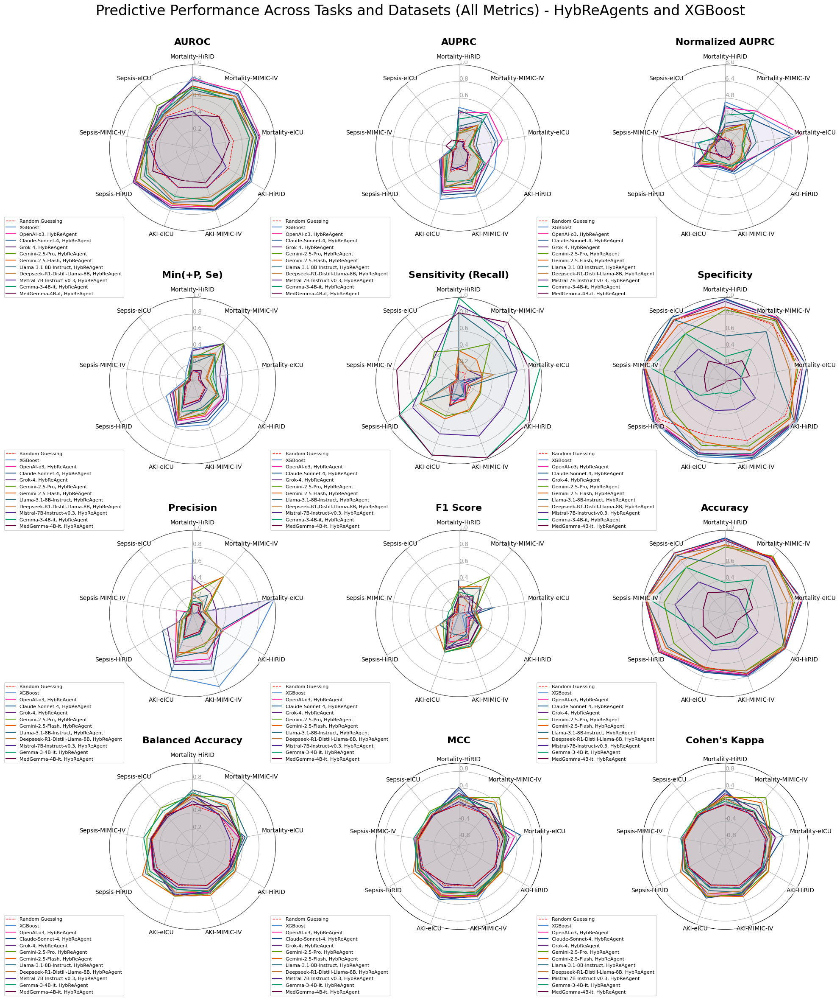

   Saved combined task-dataset chart to: ./notebook_output/pulse_agents_overall/radar_charts/combined_tasks_radar_charts_hybreagent_xgb.png


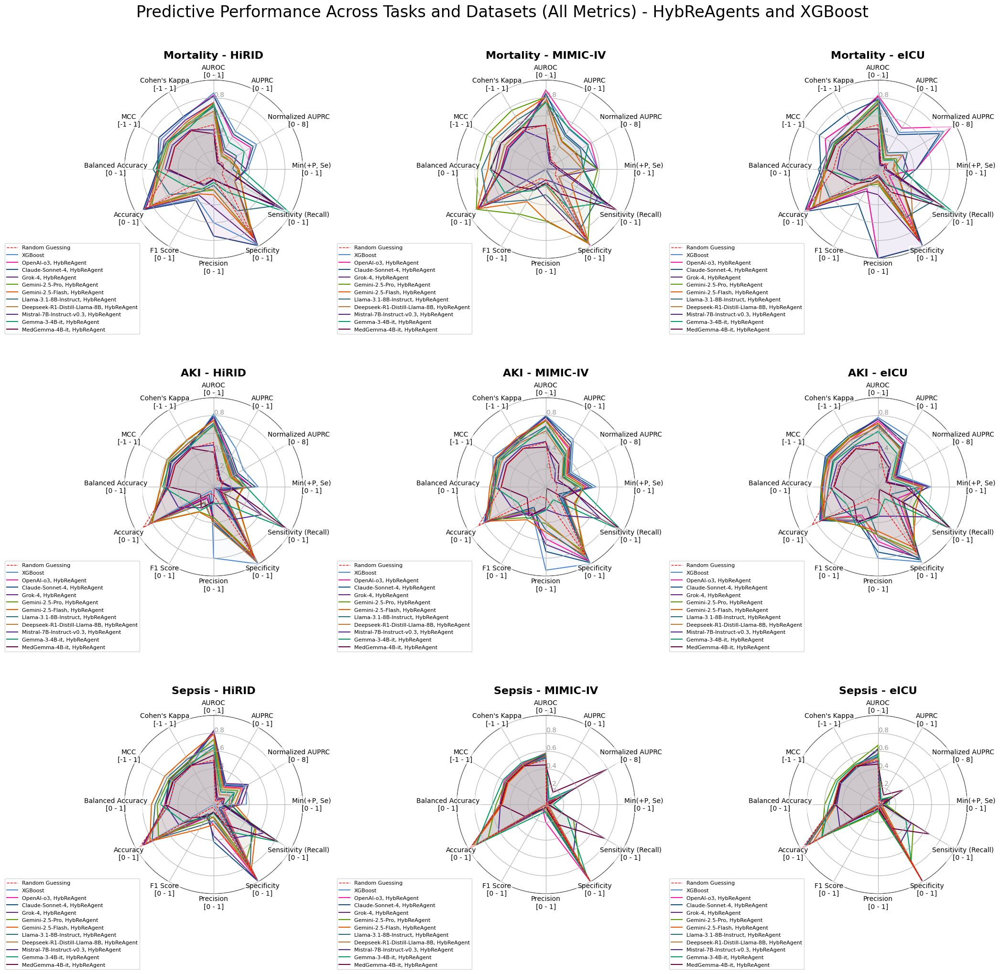


✅ Radar chart generation complete for HybReAgents and XGBoost!
   Charts saved to: ./notebook_output/pulse_agents_overall/radar_charts


In [40]:
# Create output directory
radar_charts_dir = os.path.join(OUTPUT_BASE_DIR, "radar_charts")
os.makedirs(radar_charts_dir, exist_ok=True)

# Filter for XGBoost and HybReAgent models only
hybreagent_models = [
    m
    for m in df_metrics_agents["model_prompting_id"].unique()
    if "HybReAgent" in m or m == "XGBoost"
]
df_metrics_hybreagent_xgb = df_metrics_agents[
    df_metrics_agents["model_prompting_id"].isin(hybreagent_models)
].copy()

# Generate combined radar charts for metrics
fig_combined_metrics_hybreagent = create_combined_metrics_radar_grid(
    df_metrics=df_metrics_hybreagent_xgb,
    save_path=os.path.join(radar_charts_dir, "combined_metrics_radar_charts_hybreagent_xgb.png"),
    show_plots=True,
    figsize_per_chart=(6.5, 6),
    suptitle="Predictive Performance Across Tasks and Datasets (All Metrics) - HybReAgents and XGBoost",
    llm_display_mode="all_combinations",
)

# Generate combined radar charts for task-dataset combinations
fig_combined_tasks_hybreagent = create_combined_task_dataset_radar_grid(
    df_metrics=df_metrics_hybreagent_xgb,
    save_path=os.path.join(radar_charts_dir, "combined_tasks_radar_charts_hybreagent_xgb.png"),
    show_plots=True,
    figsize_per_chart=(7, 7),
    suptitle="Predictive Performance Across Tasks and Datasets (All Metrics) - HybReAgents and XGBoost",
    llm_display_mode="all_combinations",
)

print(f"\n✅ Radar chart generation complete for HybReAgents and XGBoost!")
print(
    f"   Charts saved to: {radar_charts_dir}"
)

#### ROC and PRC Curves

In [28]:
def prepare_roc_prc_data(df_metadata):
    """
    Prepare data for ROC and PRC curves from df_metadata.
    
    Args:
        df_metadata (DataFrame): Metadata DataFrame with predictions and labels
        
    Returns:
        dict: Dictionary organized by (task, dataset) containing model data
    """
    print("📊 Preparing ROC/PRC curve data from metadata...")
    
    combinations = {}
    
    # Group by task, dataset, and model to collect predictions and labels
    for (task, dataset, model), group in df_metadata.groupby(['task', 'dataset', 'model_prompting_id']):
        key = (task, dataset)
        if key not in combinations:
            combinations[key] = []
        
        # Extract predictions and labels for this model
        predictions = group['probabilities'].values  # Use probabilities column
        labels = group['label'].values
        
        # Store model data
        combinations[key].append({
            'model_prompting_id': model,
            'predictions': predictions,
            'labels': labels
        })
    
    print(f"   Found {len(combinations)} task-dataset combinations")
    for key, models in combinations.items():
        task, dataset = key
        model_names = [m['model_prompting_id'] for m in models]
    
    return combinations


def create_roc_prc_plot(ax, task, dataset, model_data_list, curve_type, task_name_mapping, dataset_name_mapping):
    """
    Create ROC or PRC plot for a specific task-dataset combination.
    
    Args:
        ax: Matplotlib axis
        task (str): Task name
        dataset (str): Dataset name  
        model_data_list (list): List of model data dictionaries
        curve_type (str): 'roc' or 'prc'
        task_name_mapping (dict): Task name mapping
        dataset_name_mapping (dict): Dataset name mapping
    """
    # Class prevalence for random guessing baselines
    class_prevalence = {
        "Mortality": {"HiRID": 0.110, "MIMIC-IV": 0.120, "eICU": 0.070},
        "AKI": {"HiRID": 0.162, "MIMIC-IV": 0.233, "eICU": 0.310},
        "Sepsis": {"HiRID": 0.075, "MIMIC-IV": 0.025, "eICU": 0.048},
    }

    for model_data in model_data_list:
        model = model_data['model_prompting_id']
        predictions = model_data['predictions']
        labels = model_data['labels']

        # Handle NaN values by filtering out samples with NaN predictions
        valid_mask = ~np.isnan(predictions) & ~np.isnan(labels)
        if not np.any(valid_mask):
            print(f"   ⚠️  Warning: All predictions are NaN for {model} on {task}-{dataset}")
            continue

        valid_predictions = predictions[valid_mask]
        valid_labels = labels[valid_mask]

        # Skip if no valid data remaining
        if len(valid_predictions) == 0:
            print(f"   ⚠️  Warning: No valid predictions for {model} on {task}-{dataset}")
            continue

        try:
            if curve_type == 'roc':
                fpr, tpr, _ = roc_curve(valid_labels, valid_predictions)
                auc_value = auc(fpr, tpr)
                x, y = fpr, tpr
                xlabel, ylabel = 'False Positive Rate', 'True Positive Rate'
            elif curve_type == 'prc':
                precision, recall, _ = precision_recall_curve(valid_labels, valid_predictions)
                auc_value = auc(recall, precision)
                x, y = recall, precision
                xlabel, ylabel = 'Recall', 'Precision'

            # Get model color
            color = get_model_prompting_id_color(model)

            # Plot curve
            ax.plot(x, y, label=f'{model} (AUC = {auc_value:.2f})', color=color, linewidth=1)

        except Exception as e:
            print(f"   ⚠️  Error computing {curve_type.upper()} for {model} on {task}-{dataset}: {e}")
            continue

    # Add random guessing line
    if curve_type == 'roc':
        ax.plot([0, 1], [0, 1], 'r--', label='Random Guessing', alpha=0.7)
    elif curve_type == 'prc':
        # Use class prevalence for this task-dataset combination
        prevalence = class_prevalence.get(task, {}).get(dataset, 0.5)
        ax.axhline(y=prevalence, color='red', linestyle='--', label='Random Guessing', alpha=0.7)

    # Formatting
    ax.set_xlabel(xlabel, fontsize=10)
    ax.set_ylabel(ylabel, fontsize=10)
    ax.set_title(f'{task_name_mapping.get(task, task)} - {dataset_name_mapping.get(dataset, dataset)}', 
                fontsize=14, fontweight='bold', pad=10)
    ax.grid(True, alpha=0.3)
    ax.set_xlim(0, 1)
    ax.set_ylim(0, 1)


def create_roc_prc_grid(df_metadata, curve_type, save_path=None):
    """
    Create a 3x3 grid showing ROC or PRC curves for all task-dataset combinations.
    
    Args:
        df_metadata (DataFrame): Metadata DataFrame with predictions and labels
        curve_type (str): 'roc' or 'prc'
        save_path (str): Optional path to save the figure
    """
    # Prepare data for ROC and PRC curves from the provided dataframe
    combinations = prepare_roc_prc_data(df_metadata)
    
    # Define mappings and orders
    task_name_mapping = {
        "Mortality": "Mortality",
        "AKI": "AKI", 
        "Sepsis": "Sepsis"
    }
    dataset_name_mapping = {
        "HiRID": "HiRID", 
        "MIMIC-IV": "MIMIC-IV", 
        "eICU": "eICU"
    }

    tasks = ["Mortality", "AKI", "Sepsis"]
    datasets = ["HiRID", "MIMIC-IV", "eICU"]

    # Create combined figure with 3x3 grid
    fig, axes = plt.subplots(3, 3, figsize=(18, 12))
    fig.suptitle(f'{curve_type.upper()} Curves: Model Performance Across Tasks and Datasets', 
                fontsize=20, y=0.98)

    # Plot each task-dataset combination
    for i, task in enumerate(tasks):
        for j, dataset in enumerate(datasets):
            ax = axes[i, j]
            key = (task, dataset)

            if key in combinations:
                model_data_list = combinations[key]
                create_roc_prc_plot(ax, task, dataset, model_data_list, curve_type,
                                  task_name_mapping, dataset_name_mapping)
            else:
                ax.text(0.5, 0.5, f'No data for\n{task}-{dataset}', 
                       ha='center', va='center', transform=ax.transAxes, fontsize=12)
                ax.set_xlim(0, 1)
                ax.set_ylim(0, 1)
                ax.set_title(f'{task} - {dataset}', fontsize=14, fontweight='bold')

    # Add a single legend centered below the grid
    # Collect all unique models from combinations
    all_models = set()
    for model_data_list in combinations.values():
        for model_data in model_data_list:
            all_models.add(model_data["model_prompting_id"])

    # Sort models by standard order
    ordered_models = CONVML_MODELS + CONVDL_MODELS
    ordered_models += [m for m in all_models if m not in ordered_models]
    models_in_data = [m for m in ordered_models if m in all_models]

    # Create legend handles
    handles = [
        plt.Line2D(
            [0], [0], color=get_model_prompting_id_color(model), lw=3, label=model
        )
        for model in models_in_data
    ]
    # Add random guessing line
    handles.append(
        plt.Line2D(
            [0],
            [0],
            color="red",
            linestyle="--",
            alpha=0.7,
            linewidth=2,
            label="Random Guessing",
        )
    )

    fig.legend(
        handles=handles,
        loc="lower center",
        bbox_to_anchor=(0.5, -0.05),
        ncol=min(5, len(handles)),
        fontsize=9,
        frameon=False,
    )

    # Adjust layout
    plt.tight_layout()
    plt.subplots_adjust(top=0.92, hspace=0.35, wspace=0.15, bottom=0.16)

    # Save if path provided
    if save_path:
        os.makedirs(os.path.dirname(save_path), exist_ok=True)
        plt.savefig(save_path, dpi=400, bbox_inches='tight', format='png')
        print(f"{curve_type.upper()} curves grid saved to: {save_path}")

    plt.show()
    return fig

📊 Creating ROC and PRC curves...
   Output directory: ./notebook_output/pulse_agents_overall/roc_prc_curves

🎯 Generating ROC curves grid for benchmark data...
📊 Preparing ROC/PRC curve data from metadata...
   Found 9 task-dataset combinations
ROC curves grid saved to: ./notebook_output/pulse_agents_overall/roc_prc_curves/roc_curves_grid_benchmark.png


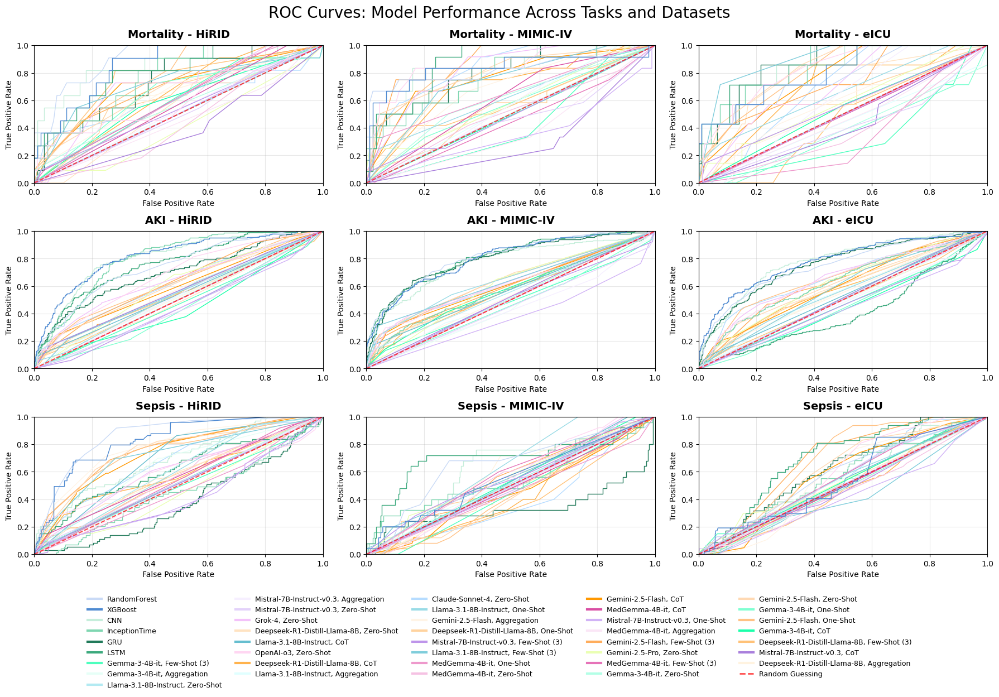


🎯 Generating PRC curves grid for benchmark data...
📊 Preparing ROC/PRC curve data from metadata...
   Found 9 task-dataset combinations
PRC curves grid saved to: ./notebook_output/pulse_agents_overall/roc_prc_curves/prc_curves_grid_benchmark.png


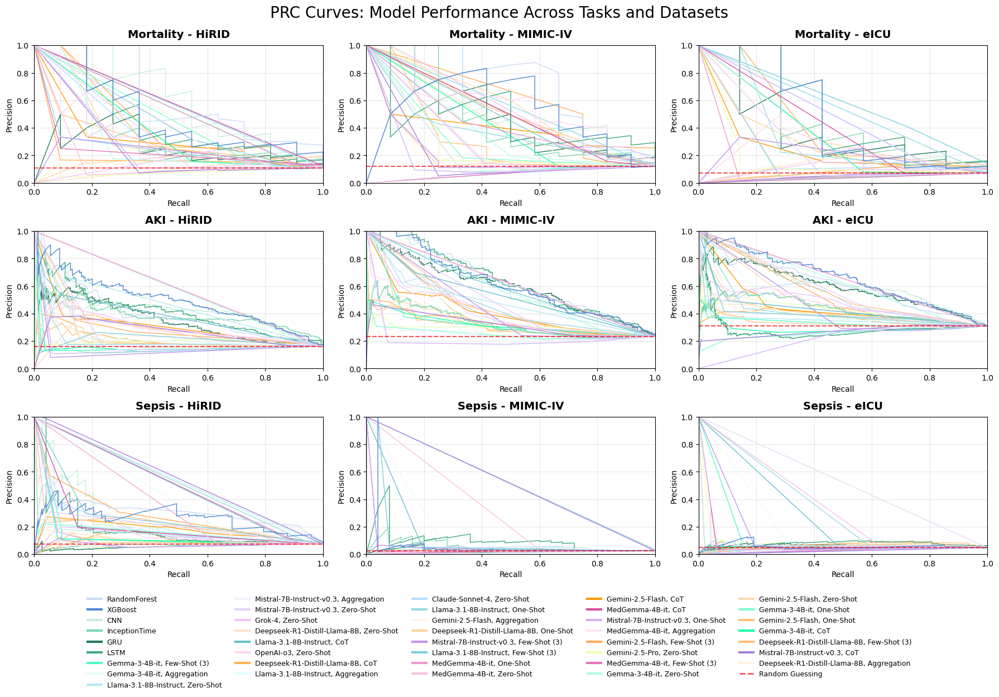


🎯 Generating ROC curves grid for agents data...
📊 Preparing ROC/PRC curve data from metadata...
   Found 9 task-dataset combinations
ROC curves grid saved to: ./notebook_output/pulse_agents_overall/roc_prc_curves/roc_curves_grid_agents.png


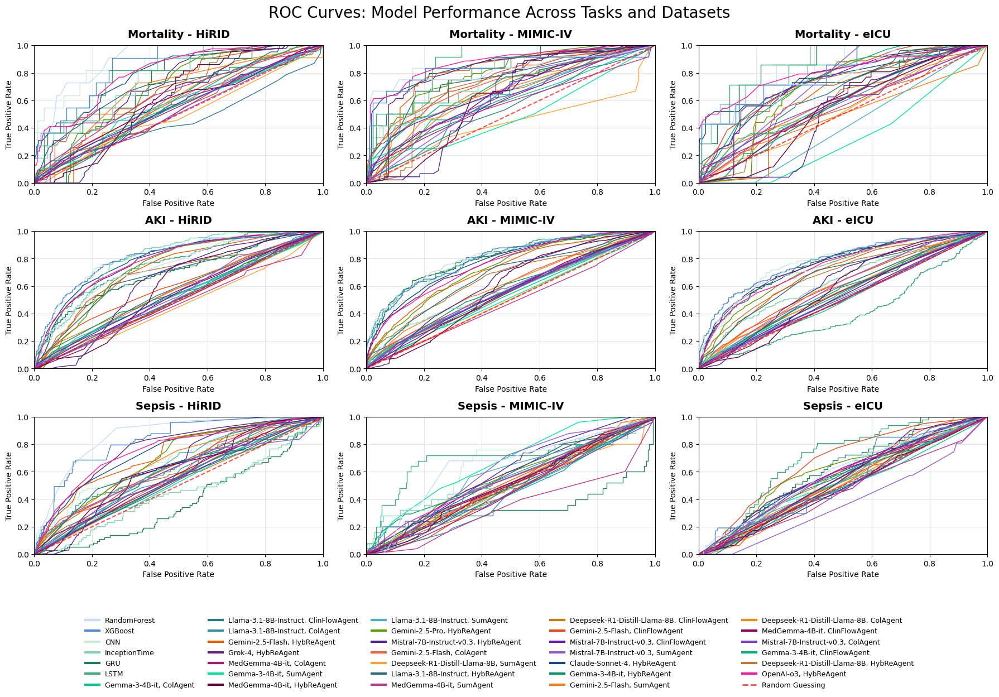


🎯 Generating PRC curves grid for agents data...
📊 Preparing ROC/PRC curve data from metadata...
   Found 9 task-dataset combinations
PRC curves grid saved to: ./notebook_output/pulse_agents_overall/roc_prc_curves/prc_curves_grid_agents.png


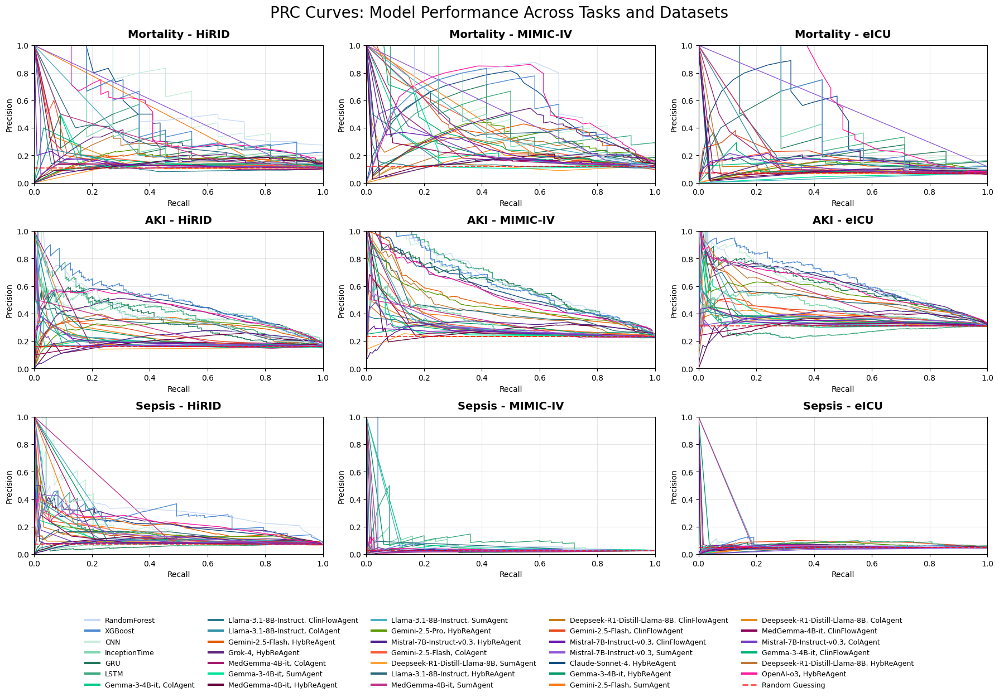

In [29]:
# Create ROC and PRC curves for benchmark and agents data separately

# Create output directory for ROC/PRC curves
roc_prc_output_dir = os.path.join(OUTPUT_BASE_DIR, "roc_prc_curves")
os.makedirs(roc_prc_output_dir, exist_ok=True)

print(f"📊 Creating ROC and PRC curves...")
print(f"   Output directory: {roc_prc_output_dir}")

# Generate ROC curves grid for benchmark data
print(f"\n🎯 Generating ROC curves grid for benchmark data...")
fig_roc_benchmark = create_roc_prc_grid(
    df_metadata=df_metadata_benchmark,
    curve_type='roc',
    save_path=os.path.join(roc_prc_output_dir, 'roc_curves_grid_benchmark.png')
)

# Generate PRC curves grid for benchmark data
print(f"\n🎯 Generating PRC curves grid for benchmark data...")
fig_prc_benchmark = create_roc_prc_grid(
    df_metadata=df_metadata_benchmark,
    curve_type='prc',
    save_path=os.path.join(roc_prc_output_dir, 'prc_curves_grid_benchmark.png')
)

# Generate ROC curves grid for agents data
print(f"\n🎯 Generating ROC curves grid for agents data...")
fig_roc_agents = create_roc_prc_grid(
    df_metadata=df_metadata_agents,
    curve_type='roc',
    save_path=os.path.join(roc_prc_output_dir, 'roc_curves_grid_agents.png')
)

# Generate PRC curves grid for agents data
print(f"\n🎯 Generating PRC curves grid for agents data...")
fig_prc_agents = create_roc_prc_grid(
    df_metadata=df_metadata_agents,
    curve_type='prc',
    save_path=os.path.join(roc_prc_output_dir, 'prc_curves_grid_agents.png')
)

#### Best Agent Performance Metrics

In [30]:
# --- HybReAgent vs XGBoost Performance Summary (Best Scores) ---

def hybreagent_vs_xgboost_best_scores_table(df_metrics, metrics=METRICS_LIST):
    """
    Prints a table comparing HybReAgent(s) vs XGBoost for each metric and each task-dataset combination (best scores only).
    For each task-dataset combination, the best HybReAgent model is selected based on AUROC, and then its scores for all metrics are used for that combination.
    This ensures that the same HybReAgent model is used across all metrics for a given task-dataset.
    Adds a row beneath the column header specifying which HybReAgent model was used as the best model for each column.
    Adds summary statistics for each row (metric) and each column (task-dataset).
    """
    print("\n=== HybReAgent vs XGBoost Best Scores Table ===")
    print(
        "Logic: For each task-dataset combination, the best HybReAgent model is selected based on AUROC. This model's scores are then used for all metrics in that combination. XGBoost scores are always from the same model. This avoids cherry-picking different HybReAgent models for different metrics within the same task-dataset."
    )

    hybreagent_models = [
        m for m in df_metrics["model_prompting_id"].unique() if "HybReAgent" in m
    ]
    xgboost_models = [
        m for m in df_metrics["model_prompting_id"].unique() if m == "XGBoost"
    ]

    tasks = sorted(df_metrics["Task"].unique())
    datasets = sorted(df_metrics["Dataset"].unique())
    combinations = [(task, dataset) for task in tasks for dataset in datasets]

    # For each task-dataset, select the best HybReAgent model by AUROC
    best_hybreagent_per_combo = {}
    for task, dataset in combinations:
        hyb_subset = df_metrics[
            (df_metrics["model_prompting_id"].isin(hybreagent_models))
            & (df_metrics["Task"] == task)
            & (df_metrics["Dataset"] == dataset)
        ]
        if not hyb_subset.empty and "AUROC" in hyb_subset.columns:
            # Pick the HybReAgent model with the highest AUROC
            best_model_row = hyb_subset.loc[hyb_subset["AUROC"].idxmax()]
            best_hybreagent_per_combo[(task, dataset)] = best_model_row[
                "model_prompting_id"
            ]
        else:
            best_hybreagent_per_combo[(task, dataset)] = None

    # Build table: rows=metrics, columns=task-dataset, values=best score (HybReAgent vs XGBoost)
    table = []
    metric_names = []
    for metric in metrics:
        if metric not in df_metrics.columns:
            continue
        row = []
        for task, dataset in combinations:
            # HybReAgent: use the best model for this task-dataset (same for all metrics)
            best_hyb_model = best_hybreagent_per_combo[(task, dataset)]
            if best_hyb_model is not None:
                hyb_score = df_metrics[
                    (df_metrics["model_prompting_id"] == best_hyb_model)
                    & (df_metrics["Task"] == task)
                    & (df_metrics["Dataset"] == dataset)
                ][metric]
                hyb_best = hyb_score.max() if not hyb_score.empty else float("-inf")
            else:
                hyb_best = float("-inf")

            # XGBoost: always use the same model
            xgb_score = df_metrics[
                (df_metrics["model_prompting_id"].isin(xgboost_models))
                & (df_metrics["Task"] == task)
                & (df_metrics["Dataset"] == dataset)
            ][metric]
            xgb_best = xgb_score.max() if not xgb_score.empty else float("-inf")

            if hyb_best > xgb_best:
                cell = f"HybReAgent ({hyb_best:.3f})"
            elif xgb_best > hyb_best:
                cell = f"XGBoost ({xgb_best:.3f})"
            elif hyb_best == xgb_best and hyb_best != float("-inf"):
                cell = f"Both ({hyb_best:.3f})"
            else:
                cell = "-"
            row.append(cell)
        table.append(row)
        metric_names.append(metric)

    # Create DataFrame
    col_labels = [f"{task}-{dataset}" for task, dataset in combinations]
    df_table = pd.DataFrame(table, index=metric_names, columns=col_labels)

    # Add row beneath column header specifying which HybReAgent model was used
    hyb_model_row = [
        best_hybreagent_per_combo[(task, dataset)] or "-"
        for task, dataset in combinations
    ]
    # Insert the row at the top (row 0)
    df_table = pd.concat(
        [
            pd.DataFrame(
                [hyb_model_row], columns=col_labels, index=["Best HybReAgent Model"]
            ),
            df_table,
        ]
    )

    # Add summary statistics for each row (metric): count HybReAgent wins, XGBoost wins
    hyb_counts = df_table.map(
        lambda x: isinstance(x, str) and x.startswith("HybReAgent")
    ).sum(axis=1)
    xgb_counts = df_table.map(
        lambda x: isinstance(x, str) and x.startswith("XGBoost")
    ).sum(axis=1)
    df_table["HybReAgent Wins"] = hyb_counts
    df_table["XGBoost Wins"] = xgb_counts

    # Add summary statistics for each column (task-dataset): count HybReAgent wins, XGBoost wins
    def count_hyb(col):
        return sum(isinstance(x, str) and x.startswith("HybReAgent") for x in col)

    def count_xgb(col):
        return sum(isinstance(x, str) and x.startswith("XGBoost") for x in col)

    hyb_col_counts = df_table.apply(count_hyb, axis=0)
    xgb_col_counts = df_table.apply(count_xgb, axis=0)
    # Only add summary rows for columns, not for the extra summary columns
    summary_hyb_row = [hyb_col_counts[c] for c in col_labels] + ["-", "-"]
    summary_xgb_row = [xgb_col_counts[c] for c in col_labels] + ["-", "-"]
    # Insert summary rows at the bottom
    df_table.loc["HybReAgent Wins (per column)"] = summary_hyb_row
    df_table.loc["XGBoost Wins (per column)"] = summary_xgb_row

    print(df_table.to_markdown())


# Run summary for HybReAgent vs XGBoost (use filtered df_metrics_hybreagent_xgb)
if 'df_metrics_hybreagent_xgb' not in globals() or df_metrics_hybreagent_xgb.empty:
    hybreagent_models = [
        m
        for m in df_metrics_op_agents["model_prompting_id"].unique()
        if "HybReAgent" in m or m == "XGBoost"
    ]
    df_metrics_hybreagent_xgb = df_metrics_op_agents[
        df_metrics_op_agents["model_prompting_id"].isin(hybreagent_models)
    ].copy()

# Generate and print the summary table
hybreagent_vs_xgboost_best_scores_table(df_metrics_hybreagent_xgb)


=== HybReAgent vs XGBoost Best Scores Table ===
Logic: For each task-dataset combination, the best HybReAgent model is selected based on AUROC. This model's scores are then used for all metrics in that combination. XGBoost scores are always from the same model. This avoids cherry-picking different HybReAgent models for different metrics within the same task-dataset.
|                              | AKI-HiRID                   | AKI-MIMIC-IV                | AKI-eICU                    | Mortality-HiRID       | Mortality-MIMIC-IV    | Mortality-eICU        | Sepsis-HiRID       | Sepsis-MIMIC-IV       | Sepsis-eICU                | HybReAgent Wins   | XGBoost Wins   |
|:-----------------------------|:----------------------------|:----------------------------|:----------------------------|:----------------------|:----------------------|:----------------------|:-------------------|:----------------------|:---------------------------|:------------------|:---------------|
| Best HybReAgent 

In [34]:
def agent_vs_standard_best_scores_table(df_metrics, agent_name, metrics=METRICS_LIST):
    print(f"\n=== {agent_name} vs Best Standard Prompting Best Scores Table ===")
    print(
        f"Logic: For each task-dataset combination, the best {agent_name} model is selected based on AUROC. "
        "This model's scores are then used for all metrics in that combination. "
        "The best standard prompting model is selected similarly (highest AUROC among STANDARD_PROMPTING_IDS)."
    )

    if agent_name == "HybReAgent":
        agent_models = [
            m for m in df_metrics["model_prompting_id"].unique() if agent_name in m
        ]
    else:
        agent_models = [
            m
            for m in df_metrics["model_prompting_id"].unique()
            if agent_name in m and (any(nm in m for nm in NON_COSTLY_MODELS))
        ]
    if agent_name == "HybReAgent":
        standard_models = [
            m
            for m in df_metrics["model_prompting_id"].unique()
            if any(pid in m for pid in STANDARD_PROMPTING_IDS)
        ]
    else:
        print(
            "Note: Proprietary models (OpenAI-o3, Claude-Sonnet-4, Grok-4, Gemini-2.5-Pro) are excluded from these comparisons except for Gemini-2.5-Flash, because ClinFlowAgent and ColAgent were not run for the other proprietary models. This ensures a fair comparison."
        )
        standard_models = [
            m
            for m in df_metrics["model_prompting_id"].unique()
            if any(pid in m for pid in STANDARD_PROMPTING_IDS)
            and (
                any(nm in m for nm in NON_COSTLY_MODELS)
            )
        ]

    tasks = sorted(df_metrics["Task"].unique())
    datasets = sorted(df_metrics["Dataset"].unique())
    combinations = [(task, dataset) for task in tasks for dataset in datasets]

    best_agent_per_combo = {}
    best_standard_per_combo = {}
    for task, dataset in combinations:
        agent_subset = df_metrics[
            (df_metrics["model_prompting_id"].isin(agent_models))
            & (df_metrics["Task"] == task)
            & (df_metrics["Dataset"] == dataset)
        ]
        if not agent_subset.empty and "AUROC" in agent_subset.columns:
            best_agent_row = agent_subset.loc[agent_subset["AUROC"].idxmax()]
            best_agent_per_combo[(task, dataset)] = best_agent_row["model_prompting_id"]
        else:
            best_agent_per_combo[(task, dataset)] = None

        standard_subset = df_metrics[
            (df_metrics["model_prompting_id"].isin(standard_models))
            & (df_metrics["Task"] == task)
            & (df_metrics["Dataset"] == dataset)
        ]
        if not standard_subset.empty and "AUROC" in standard_subset.columns:
            best_standard_row = standard_subset.loc[standard_subset["AUROC"].idxmax()]
            best_standard_per_combo[(task, dataset)] = best_standard_row[
                "model_prompting_id"
            ]
        else:
            best_standard_per_combo[(task, dataset)] = None

    table = []
    metric_names = []
    for metric in metrics:
        if metric not in df_metrics.columns:
            continue
        row = []
        for task, dataset in combinations:
            best_agent_model = best_agent_per_combo[(task, dataset)]
            if best_agent_model is not None:
                agent_score = df_metrics[
                    (df_metrics["model_prompting_id"] == best_agent_model)
                    & (df_metrics["Task"] == task)
                    & (df_metrics["Dataset"] == dataset)
                ][metric]
                agent_best = (
                    agent_score.max() if not agent_score.empty else float("-inf")
                )
            else:
                agent_best = float("-inf")

            best_standard_model = best_standard_per_combo[(task, dataset)]
            if best_standard_model is not None:
                standard_score = df_metrics[
                    (df_metrics["model_prompting_id"] == best_standard_model)
                    & (df_metrics["Task"] == task)
                    & (df_metrics["Dataset"] == dataset)
                ][metric]
                standard_best = (
                    standard_score.max() if not standard_score.empty else float("-inf")
                )
            else:
                standard_best = float("-inf")

            if agent_best > standard_best:
                cell = f"{agent_name} ({agent_best:.3f})"
            elif standard_best > agent_best:
                cell = f"Standard ({standard_best:.3f})"
            elif agent_best == standard_best and agent_best != float("-inf"):
                cell = f"Both ({agent_best:.3f})"
            else:
                cell = "-"
            row.append(cell)
        table.append(row)
        metric_names.append(metric)

    col_labels = [f"{task}-{dataset}" for task, dataset in combinations]
    df_table = pd.DataFrame(table, index=metric_names, columns=col_labels)

    agent_model_row = [
        best_agent_per_combo[(task, dataset)] or "-" for task, dataset in combinations
    ]
    standard_model_row = [
        best_standard_per_combo[(task, dataset)] or "-"
        for task, dataset in combinations
    ]
    df_table = pd.concat(
        [
            pd.DataFrame(
                [agent_model_row],
                columns=col_labels,
                index=[f"Best {agent_name} Model"],
            ),
            pd.DataFrame(
                [standard_model_row],
                columns=col_labels,
                index=["Best Standard Prompting Model"],
            ),
            df_table,
        ]
    )

    agent_counts = df_table.map(
        lambda x: isinstance(x, str) and x.startswith(agent_name)
    ).sum(axis=1)
    standard_counts = df_table.map(
        lambda x: isinstance(x, str) and x.startswith("Standard")
    ).sum(axis=1)
    df_table[f"{agent_name} Wins"] = agent_counts
    df_table["Standard Wins"] = standard_counts

    def count_agent(col):
        return sum(isinstance(x, str) and x.startswith(agent_name) for x in col)

    def count_standard(col):
        return sum(isinstance(x, str) and x.startswith("Standard") for x in col)

    agent_col_counts = df_table.apply(count_agent, axis=0)
    standard_col_counts = df_table.apply(count_standard, axis=0)
    summary_agent_row = [agent_col_counts[c] for c in col_labels] + ["-", "-"]
    summary_standard_row = [standard_col_counts[c] for c in col_labels] + ["-", "-"]
    df_table.loc[f"{agent_name} Wins (per column)"] = summary_agent_row
    df_table.loc["Standard Wins (per column)"] = summary_standard_row

    print(df_table.to_markdown())


# --- HybReAgent vs Standard Prompting ---
agent_vs_standard_best_scores_table(df_metrics, agent_name="HybReAgent")

# --- ClinFlowAgent vs Standard Prompting ---
agent_vs_standard_best_scores_table(df_metrics, agent_name="ClinFlowAgent")

# --- ColAgent vs Standard Prompting ---
agent_vs_standard_best_scores_table(df_metrics, agent_name="ColAgent")

# --- SumAgent vs Standard Prompting ---
agent_vs_standard_best_scores_table(df_metrics, agent_name="SumAgent")


=== HybReAgent vs Best Standard Prompting Best Scores Table ===
Logic: For each task-dataset combination, the best HybReAgent model is selected based on AUROC. This model's scores are then used for all metrics in that combination. The best standard prompting model is selected similarly (highest AUROC among STANDARD_PROMPTING_IDS).
|                               | AKI-HiRID                   | AKI-MIMIC-IV                    | AKI-eICU                    | Mortality-HiRID            | Mortality-MIMIC-IV             | Mortality-eICU                      | Sepsis-HiRID                  | Sepsis-MIMIC-IV                 | Sepsis-eICU                    | HybReAgent Wins   | Standard Wins   |
|:------------------------------|:----------------------------|:--------------------------------|:----------------------------|:---------------------------|:-------------------------------|:------------------------------------|:------------------------------|:--------------------------------|:-------

### Pred. Distribution & Calibration Analysis

In [35]:
def analyze_calibration_by_group(
    df_metadata,
    group_cols=[
        "model_type",
        "model_name",
        "is_agent",
        "prompting_id",
        "task",
        "dataset",
    ],
    agentic_ids=None,
    standard_ids=None,
    baseline_types=None,
    step_name_col="Step Name",
    final_step_value="final_prediction",
    prob_col="probabilities",
    label_col="label",
    min_samples=10,
    print_tables=True,
):
    """
    Analyze calibration error (|mean predicted probability - actual positive rate|) for
    baselines, standard prompting, and agents, overall and per task.
    Returns concise, curated actionable insight statements for reporting.
    """
    if agentic_ids is None:
        agentic_ids = AGENTIC_PROMPTING_IDS
    if standard_ids is None:
        standard_ids = STANDARD_PROMPTING_IDS
    if baseline_types is None:
        baseline_types = CONVML_MODELS + CONVDL_MODELS

    # Only use final prediction rows for agentic methods, but keep all for others
    df = df_metadata.copy()
    is_agentic = df[step_name_col].notna() & df["prompting_id"].isin(agentic_ids)
    df = pd.concat(
        [df[is_agentic & (df[step_name_col] == final_step_value)], df[~is_agentic]]
    )

    # Ensure baseline models have a prompting_id equal to their model_name
    baseline_mask = df["model_name"].isin(CONVML_MODELS + CONVDL_MODELS)
    df.loc[baseline_mask, "prompting_id"] = df.loc[baseline_mask, "model_name"]

    # Compute calibration error for each group
    group = df.groupby(group_cols)
    summary = group.agg(
        n_samples=(prob_col, "count"),
        mean_pred=(prob_col, "mean"),
        pos_rate=(label_col, "mean"),
    ).reset_index()
    summary["calibration_error"] = (summary["mean_pred"] - summary["pos_rate"]).abs()

    # Add group type
    def get_group_type(row):
        if row["model_name"] in baseline_types:
            return "Baseline"
        elif row["prompting_id"] in agentic_ids:
            return "Agent"
        elif row["prompting_id"] in standard_ids:
            return "Standard"
        else:
            return "Other"

    summary["group_type"] = summary.apply(get_group_type, axis=1)

    # Filter out groups with too few samples
    summary = summary[summary["n_samples"] >= min_samples]

    # Aggregate calibration error by group_type and task
    agg = (
        summary.groupby(["group_type", "task"])
        .agg(
            mean_cal_error=("calibration_error", "mean"),
            std_cal_error=("calibration_error", "std"),
            n=("calibration_error", "count"),
        )
        .reset_index()
    )

    # --- Add HybReAgent and XGBoost as its own row in the table ---
    hybreagent_rows = summary[(summary["prompting_id"] == "HybReAgent")]
    if not hybreagent_rows.empty:
        hyb_agg = (
            hybreagent_rows.groupby("task")
            .agg(
                mean_cal_error=("calibration_error", "mean"),
                std_cal_error=("calibration_error", "std"),
                n=("calibration_error", "count"),
            )
            .reset_index()
        )
        hyb_agg["group_type"] = "HybReAgent"
        # Insert HybReAgent rows into agg
        agg = pd.concat(
            [
                agg,
                hyb_agg[["group_type", "task", "mean_cal_error", "std_cal_error", "n"]],
            ],
            ignore_index=True,
        )
        
    xgboost_rows = summary[(summary["prompting_id"] == "XGBoost")]
    if not xgboost_rows.empty:
        xgb_agg = (
            xgboost_rows.groupby("task")
            .agg(
                mean_cal_error=("calibration_error", "mean"),
                std_cal_error=("calibration_error", "std"),
                n=("calibration_error", "count"),
            )
            .reset_index()
        )
        xgb_agg["group_type"] = "XGBoost"
        # Insert XGBoost rows into agg
        agg = pd.concat(
            [
                agg,
                xgb_agg[["group_type", "task", "mean_cal_error", "std_cal_error", "n"]],
            ],
            ignore_index=True,
        )

    # Overall aggregation
    agg_overall = (
        summary.groupby("group_type")
        .agg(
            mean_cal_error=("calibration_error", "mean"),
            std_cal_error=("calibration_error", "std"),
            n=("calibration_error", "count"),
        )
        .reset_index()
    )

    # Per-agent aggregation
    agent_agg_overall = (
        summary[summary["group_type"] == "Agent"]
        .groupby("prompting_id")
        .agg(
            mean_cal_error=("calibration_error", "mean"),
            std_cal_error=("calibration_error", "std"),
            n=("calibration_error", "count"),
        )
        .reset_index()
    )

    # Per-standard aggregation
    standard_agg_overall = (
        summary[summary["group_type"] == "Standard"]
        .groupby("prompting_id")
        .agg(
            mean_cal_error=("calibration_error", "mean"),
            std_cal_error=("calibration_error", "std"),
            n=("calibration_error", "count"),
        )
        .reset_index()
    )

    # Per-baseline aggregation
    baseline_agg_overall = (
        summary[summary["group_type"] == "Baseline"]
        .groupby("model_name")
        .agg(
            mean_cal_error=("calibration_error", "mean"),
            std_cal_error=("calibration_error", "std"),
            n=("calibration_error", "count"),
        )
        .reset_index()
    )

    # Curated actionable insights (now with std and agent details)
    statements = []

    # Overall best/worst group type (with std)
    if not agg_overall.empty:
        best = agg_overall.loc[agg_overall["mean_cal_error"].idxmin()]
        worst = agg_overall.loc[agg_overall["mean_cal_error"].idxmax()]
        statements.append(
            f"Overall, '{best['group_type']}' models were best calibrated (mean error={best['mean_cal_error']:.3f} ± {best['std_cal_error']:.3f}), while '{worst['group_type']}' were least calibrated (mean error={worst['mean_cal_error']:.3f} ± {worst['std_cal_error']:.3f})."
        )

    # Per task: best/worst group type (with std)
    for task in agg["task"].unique():
        task_agg = agg[agg["task"] == task]
        if not task_agg.empty:
            best_t = task_agg.loc[task_agg["mean_cal_error"].idxmin()]
            worst_t = task_agg.loc[task_agg["mean_cal_error"].idxmax()]
            statements.append(
                f"For {task}, '{best_t['group_type']}' models were best calibrated (mean error={best_t['mean_cal_error']:.3f} ± {best_t['std_cal_error']:.3f}), '{worst_t['group_type']}' were least calibrated (mean error={worst_t['mean_cal_error']:.3f} ± {worst_t['std_cal_error']:.3f})."
            )

    # Best/worst agent (with std)
    if not agent_agg_overall.empty:
        best_agent = agent_agg_overall.loc[agent_agg_overall["mean_cal_error"].idxmin()]
        worst_agent = agent_agg_overall.loc[
            agent_agg_overall["mean_cal_error"].idxmax()
        ]
        statements.append(
            f"Among agents, '{best_agent['prompting_id']}' had the lowest mean calibration error ({best_agent['mean_cal_error']:.3f} ± {best_agent['std_cal_error']:.3f}), while '{worst_agent['prompting_id']}' had the highest ({worst_agent['mean_cal_error']:.3f} ± {worst_agent['std_cal_error']:.3f})."
        )
        # Add all agent values
        agent_lines = [
            f"    - {row['prompting_id']}: mean={row['mean_cal_error']:.3f} ± {row['std_cal_error']:.3f} (n={row['n']})"
            for _, row in agent_agg_overall.iterrows()
        ]
        statements.append(
            "Agent calibration errors (mean ± std):\n" + "\n".join(agent_lines)
        )

    # Best/worst standard prompting (with std)
    if not standard_agg_overall.empty:
        best_std = standard_agg_overall.loc[
            standard_agg_overall["mean_cal_error"].idxmin()
        ]
        worst_std = standard_agg_overall.loc[
            standard_agg_overall["mean_cal_error"].idxmax()
        ]
        statements.append(
            f"Among standard prompting, '{best_std['prompting_id']}' was best calibrated (mean error={best_std['mean_cal_error']:.3f} ± {best_std['std_cal_error']:.3f}), '{worst_std['prompting_id']}' was least calibrated (mean error={worst_std['mean_cal_error']:.3f} ± {worst_std['std_cal_error']:.3f})."
        )

    # Best/worst baseline model (with std)
    if not baseline_agg_overall.empty:
        best_base = baseline_agg_overall.loc[
            baseline_agg_overall["mean_cal_error"].idxmin()
        ]
        worst_base = baseline_agg_overall.loc[
            baseline_agg_overall["mean_cal_error"].idxmax()
        ]
        statements.append(
            f"Among baselines, '{best_base['model_name']}' had the lowest mean calibration error ({best_base['mean_cal_error']:.3f} ± {best_base['std_cal_error']:.3f}), while '{worst_base['model_name']}' had the highest ({worst_base['mean_cal_error']:.3f} ± {worst_base['std_cal_error']:.3f})."
        )

    if print_tables:
        print("=== Calibration Error Summary by Group Type and Task ===")
        display(agg)
        print("\n=== Overall Calibration Error by Group Type ===")
        display(agg_overall)
        print("\n=== Per-Agent Calibration Error (Overall) ===")
        display(agent_agg_overall)
        print("\n=== Per-Standard Prompting Calibration Error (Overall) ===")
        display(standard_agg_overall)
        print("\n=== Per-Baseline Calibration Error (Overall) ===")
        display(baseline_agg_overall)
        print("\n=== Curated Actionable Insights ===")
        for s in statements:
            print(f"- {s}")

    return statements


# --- Run the analysis and print actionable insights ---
calibration_insights = analyze_calibration_by_group(df_metadata)

=== Calibration Error Summary by Group Type and Task ===


,group_type,task,mean_cal_error,std_cal_error,n
0,Agent,AKI,0.306173,0.241776,84
1,Agent,Mortality,0.516693,0.271884,84
2,Agent,Sepsis,0.516769,0.282603,84
3,Baseline,AKI,0.153724,0.165789,18
4,Baseline,Mortality,0.116154,0.117554,18
5,Baseline,Sepsis,0.191607,0.231841,18
6,Standard,AKI,0.327252,0.300807,102
7,Standard,Mortality,0.581493,0.212247,102
8,Standard,Sepsis,0.524592,0.263816,102
9,HybReAgent,AKI,0.172080,0.214406,30



=== Overall Calibration Error by Group Type ===


,group_type,mean_cal_error,std_cal_error,n
0,Agent,0.446545,0.282975,252
1,Baseline,0.153829,0.177359,54
2,Standard,0.477779,0.282554,306



=== Per-Agent Calibration Error (Overall) ===


,prompting_id,mean_cal_error,std_cal_error,n
0,ClinFlowAgent,0.570462,0.231639,54
1,ColAgent,0.639801,0.180329,54
2,HybReAgent,0.201728,0.216830,90
3,SumAgent,0.537399,0.224078,54



=== Per-Standard Prompting Calibration Error (Overall) ===


,prompting_id,mean_cal_error,std_cal_error,n
0,Aggregation,0.521497,0.297801,54
1,CoT,0.476873,0.269764,54
2,Few-Shot (3),0.437567,0.280531,54
3,One-Shot,0.506410,0.270552,54
4,Zero-Shot,0.459040,0.289828,90



=== Per-Baseline Calibration Error (Overall) ===


,model_name,mean_cal_error,std_cal_error,n
0,CNN,0.049197,0.036576,9
1,GRU,0.238523,0.133516,9
2,InceptionTime,0.215969,0.080205,9
3,LSTM,0.338394,0.298988,9
4,RandomForest,0.037830,0.023846,9
5,XGBoost,0.043059,0.029052,9



=== Curated Actionable Insights ===
- Overall, 'Baseline' models were best calibrated (mean error=0.154 ± 0.177), while 'Standard' were least calibrated (mean error=0.478 ± 0.283).
- For AKI, 'XGBoost' models were best calibrated (mean error=0.075 ± 0.026), 'Standard' were least calibrated (mean error=0.327 ± 0.301).
- For Mortality, 'XGBoost' models were best calibrated (mean error=0.033 ± 0.017), 'Standard' were least calibrated (mean error=0.581 ± 0.212).
- For Sepsis, 'XGBoost' models were best calibrated (mean error=0.022 ± 0.006), 'Standard' were least calibrated (mean error=0.525 ± 0.264).
- Among agents, 'HybReAgent' had the lowest mean calibration error (0.202 ± 0.217), while 'ColAgent' had the highest (0.640 ± 0.180).
- Agent calibration errors (mean ± std):
    - ClinFlowAgent: mean=0.570 ± 0.232 (n=54)
    - ColAgent: mean=0.640 ± 0.180 (n=54)
    - HybReAgent: mean=0.202 ± 0.217 (n=90)
    - SumAgent: mean=0.537 ± 0.224 (n=54)
- Among standard prompting, 'Few-Shot (3)' wa

Prediction distribution grid saved to: ./notebook_output/pulse_agents_overall/prediction_distribution/prediction_distribution_grid_all_models_benchmark.png


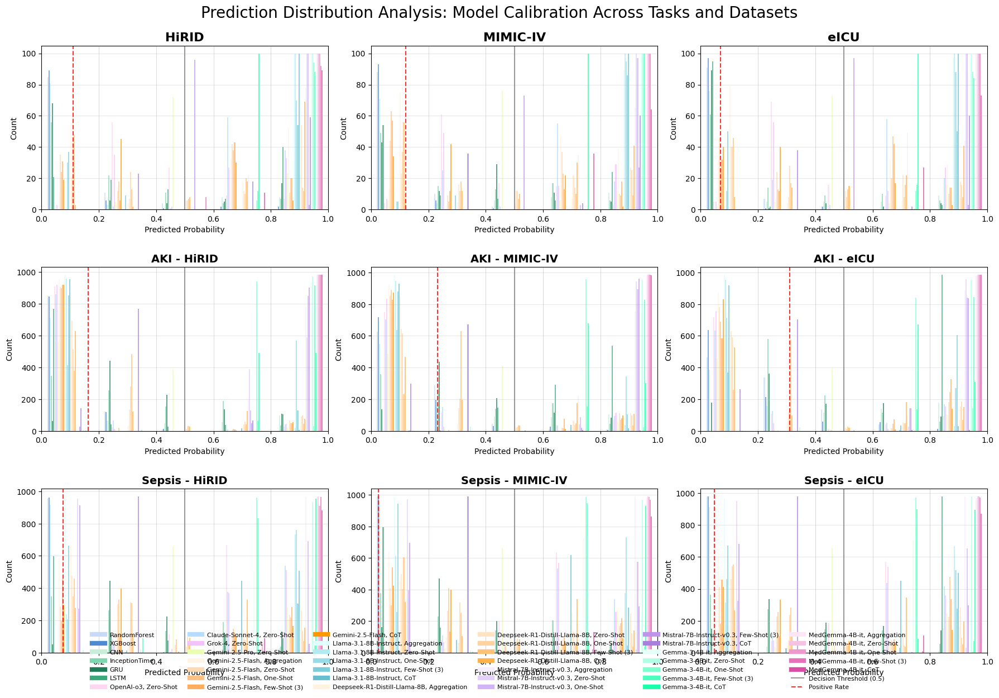

Prediction distribution grid saved to: ./notebook_output/pulse_agents_overall/prediction_distribution/prediction_distribution_grid_all_models_agents.png


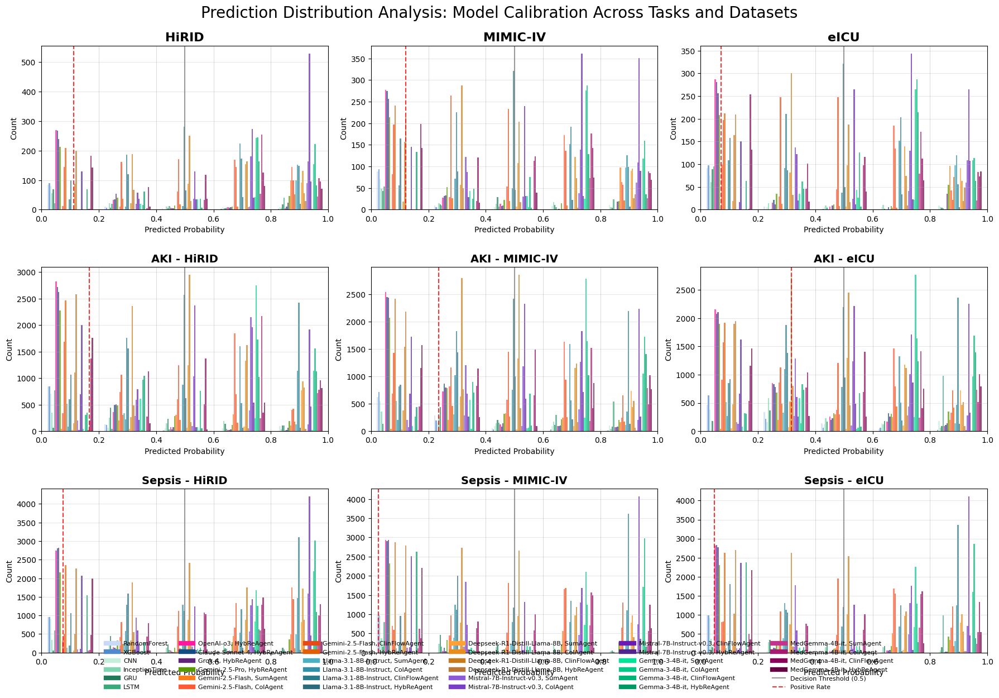

In [41]:
def create_prediction_distribution_plot(
    ax, task, dataset, df_metadata, models=None, with_legend=True, prediction_mean_lines=False, bins=20
):
    """
    Create prediction distribution plot for a specific task-dataset combination.
    Shows histograms of predicted probabilities for each model with actual labels overlaid.

    Args:
        ax: Matplotlib axis
        task (str): Task name
        dataset (str): Dataset name
        df_metadata (DataFrame): Metadata DataFrame with predictions and labels
        models (list): List of models to include (if None, uses all available)
        bins (int or sequence): Number of bins or bin edges for histogram (default: 20)
    """
    # Filter data for this task-dataset combination
    task_dataset_data = df_metadata[
        (df_metadata["task"] == task) & (df_metadata["dataset"] == dataset)
    ]

    if task_dataset_data.empty:
        ax.text(
            0.5,
            0.5,
            f"No data for\n{task}-{dataset}",
            ha="center",
            va="center",
            transform=ax.transAxes,
            fontsize=12,
        )
        ax.set_title(f"{task} - {dataset}", fontsize=14, fontweight="bold")
        return

    # Get unique models if not specified
    if models is None:
        models = sorted(task_dataset_data["model_prompting_id"].unique())
    else:
        # Filter to only models that exist in the data
        available_models = task_dataset_data["model_prompting_id"].unique()
        models = [m for m in models if m in available_models]

    if not models:
        ax.text(
            0.5,
            0.5,
            f"No models available\nfor {task}-{dataset}",
            ha="center",
            va="center",
            transform=ax.transAxes,
            fontsize=12,
        )
        ax.set_title(f"{task} - {dataset}", fontsize=14, fontweight="bold")
        return

    # Define bins for histogram
    if isinstance(bins, int):
        bins = np.linspace(0, 1, bins + 1)

    # Calculate positive rate for this task-dataset combination
    overall_pos_rate = task_dataset_data["label"].mean()

    # Create stacked histogram showing all models
    model_data_list = []
    model_colors = []
    model_labels = []

    for model in models:
        model_data = task_dataset_data[task_dataset_data["model_prompting_id"] == model]
        if len(model_data) > 0:
            model_data_list.append(
                model_data["probabilities"].values
            )  # Use probabilities column
            model_colors.append(get_model_prompting_id_color(model))
            model_labels.append(f"{model}")

    if model_data_list:
        # Create histogram for all models
        ax.hist(
            model_data_list,
            bins=bins,
            alpha=0.7,
            label=model_labels,
            color=model_colors,
            edgecolor=None,
            linewidth=0.5,
        )

        # Add vertical lines for reference
        ax.axvline(
            x=0.5,
            color="gray",
            linestyle="-",
            alpha=0.8,
            linewidth=1.5,
            label="Decision Threshold (0.5)",
        )
        ax.axvline(
            x=overall_pos_rate,
            color="red",
            linestyle="--",
            alpha=0.8,
            linewidth=1.5,
            label=f"n={len(model_data)}\nPositive Rate ({overall_pos_rate:.3f})",
        )

        # Calculate and add mean prediction line for each model
        if prediction_mean_lines:
            for i, (model, data) in enumerate(zip(models, model_data_list)):
                if len(data) > 0:
                    pred_mean = np.mean(data)
                    color = get_model_prompting_id_color(model)
                    ax.axvline(x=pred_mean, color=color, linestyle=':', alpha=0.6, linewidth=2)

        # Formatting
        ax.set_xlabel("Predicted Probability", fontsize=10)
        ax.set_ylabel("Count", fontsize=10, fontweight="normal")
        ax.set_title(f"{task} - {dataset}", fontsize=14, fontweight="bold")
        # Set vertical grid lines at every bin edge (except first and last)
        if bins is not None and len(bins) > 1:
            bin_edges = np.asarray(bins)
            # Draw vertical lines at all bin edges except the first and last
            for edge in bin_edges[1:-1]:
                ax.axvline(x=edge, color='gray', linestyle='-', linewidth=0.7, alpha=0.3, zorder=0)
        ax.grid(axis='y', alpha=0.3)
        ax.set_xlim(0, 1)
        ax.set_xticks(np.arange(0, 1.1, 0.2))

        # Add legend with smaller font
        if with_legend:
            ax.legend(fontsize=8, loc="upper right", ncol=1)


def create_prediction_distribution_grid(
    df_metadata, save_path=None, models=None, with_legend=False, prediction_mean_lines=False, bins=20
):
    """
    Create a 3x3 grid showing prediction distributions for all task-dataset combinations.
    Tasks on y-axis, datasets on x-axis, each subplot shows distributions for all models.

    Args:
        df_metadata (DataFrame): Metadata DataFrame with predictions and labels
        save_path (str): Optional path to save the figure
    """
    # Define order for consistent plotting
    tasks = ["Mortality", "AKI", "Sepsis"]
    datasets = ["HiRID", "MIMIC-IV", "eICU"]
    models = models or df_metadata["model_prompting_id"].unique()

    # Create figure with 3x3 grid
    fig, axes = plt.subplots(3, 3, figsize=(18, 12))
    fig.suptitle(
        "Prediction Distribution Analysis: Model Calibration Across Tasks and Datasets",
        fontsize=20,
        y=0.98,
    )

    # Plot each task-dataset combination
    for i, task in enumerate(tasks):
        for j, dataset in enumerate(datasets):
            ax = axes[i, j]
            create_prediction_distribution_plot(
                ax, task, dataset, df_metadata, models, with_legend, prediction_mean_lines=prediction_mean_lines, bins=bins
            )

    # Add row and column labels
    for i, task in enumerate(tasks):
        axes[i, 0].set_ylabel("Count", fontsize=10, fontweight="normal")

    for j, dataset in enumerate(datasets):
        axes[0, j].set_title(f"{dataset}", fontsize=16, fontweight="bold")

    # Add a single legend centered below the grid
    # Collect model handles and labels as in the individual plot
    model_labels = []
    model_colors = []
    for model in models:
        model_labels.append(f"{model}")
        model_colors.append(get_model_prompting_id_color(model))
    handles = [
        plt.Line2D([0], [0], color=color, lw=6, label=label)
        for color, label in zip(model_colors, model_labels)
    ]
    # Add reference lines as in the individual plot
    handles.append(
        plt.Line2D(
            [0],
            [0],
            color="gray",
            linestyle="-",
            alpha=0.8,
            linewidth=1.5,
            label="Decision Threshold (0.5)",
        )
    )
    handles.append(
        plt.Line2D(
            [0],
            [0],
            color="red",
            linestyle="--",
            alpha=0.8,
            linewidth=1.5,
            label="Positive Rate",
        )
    )

    fig.legend(
        handles=handles,
        loc="lower center",
        bbox_to_anchor=(0.5, -0.05),
        ncol=min(6, len(handles)),
        fontsize=8,
        frameon=False,
    )

    # Adjust layout
    plt.tight_layout()
    plt.subplots_adjust(top=0.92, hspace=0.35, wspace=0.15, bottom=0.014)

    # Save if path provided
    if save_path:
        os.makedirs(os.path.dirname(save_path), exist_ok=True)
        plt.savefig(save_path, dpi=400, bbox_inches="tight", format="png")
        print(f"Prediction distribution grid saved to: {save_path}")

    plt.show()
    return fig


def create_individual_distribution_plots(
    df_metadata, output_dir, models=None, with_legend=True
):
    """
    Create individual prediction distribution plots for each task-dataset combination.

    Args:
        df_metadata (DataFrame): Metadata DataFrame with predictions and labels
        output_dir (str): Output directory for saving plots
    """
    tasks = ["Mortality", "AKI", "Sepsis"]
    datasets = ["HiRID", "MIMIC-IV", "eICU"]
    models = models or df_metadata["model_prompting_id"].unique()

    print(f"\n🎯 Generating individual prediction distribution plots...")

    for task in tasks:
        for dataset in datasets:
            # Check if this combination exists in the data
            task_dataset_data = df_metadata[
                (df_metadata["task"] == task) & (df_metadata["dataset"] == dataset)
            ]

            if not task_dataset_data.empty:
                fig, ax = plt.subplots(figsize=(12, 8))
                create_prediction_distribution_plot(
                    ax, task, dataset, df_metadata, models
                )

                # Enhanced title and formatting for individual plots
                ax.set_title(
                    f"Prediction Distribution Analysis: {task} - {dataset}",
                    fontsize=16,
                    fontweight="bold",
                    pad=20,
                )

                # Save individual plot
                save_path = os.path.join(
                    output_dir, f"{task}_{dataset}_prediction_distribution.png"
                )
                plt.savefig(save_path, dpi=400, bbox_inches="tight")
                print(f"   Saved {task}-{dataset} distribution plot to: {save_path}")
                plt.close(fig)
            else:
                print(f"   ⚠️  No data found for {task}-{dataset}")


# Define output directory for prediction distribution plots
prediction_dist_output_dir = os.path.join (OUTPUT_BASE_DIR, "prediction_distribution")

# # Create prediction distribution grid of all task-dataset combinations - BASELINES
# print(f"\n🎯 Generating 3x3 prediction distribution grids...")
# fig_dist_baselines = create_prediction_distribution_grid(
#     df_metadata,
#     save_path=os.path.join(prediction_dist_output_dir, "prediction_distribution_grid_baselines.png"),
#     models=CONVML_MODELS+CONVDL_MODELS,
#     prediction_mean_lines=True,
#     bins=10,
# )

# # Create prediction distribution grid of all task-dataset combinations - LLMs
# fig_dist_llms = create_prediction_distribution_grid(
#     df_metadata,
#     save_path=os.path.join(prediction_dist_output_dir, "prediction_distribution_grid_llms.png"),
#     models=LLM_ALL_PROMPTING_IDS,
#     bins=10,
# )

# Create prediction distribution grid of all task-dataset combinations - ALL MODELS
fig_dist_all = create_prediction_distribution_grid(
    df_metadata_benchmark,
    save_path=os.path.join(prediction_dist_output_dir, "prediction_distribution_grid_all_models_benchmark.png"),
    models=None,
    bins=5,
)

# Create prediction distribution grid of all task-dataset combinations - ALL MODELS
fig_dist_all = create_prediction_distribution_grid(
    df_metadata_agents,
    save_path=os.path.join(
        prediction_dist_output_dir, "prediction_distribution_grid_all_models_agents.png"
    ),
    models=None,
    bins=5,
)

# # Generate individual distribution plots for each task-dataset combination
# create_individual_distribution_plots(df_metadata, prediction_dist_output_dir)

Saved to: ./notebook_output/pulse_agents_overall/prediction_distribution/prediction_density_by_prompting_id_llms.png


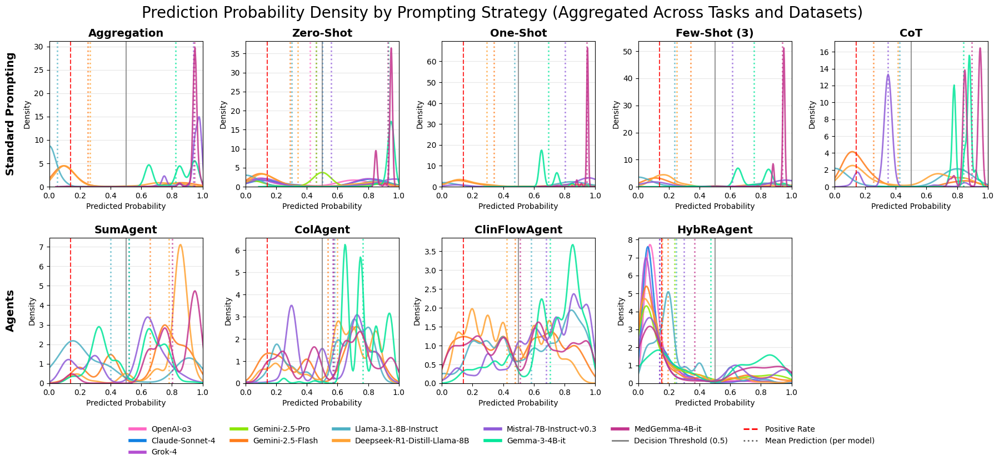

Saved to: ./notebook_output/pulse_agents_overall/prediction_distribution/prediction_density_by_model_llms.png


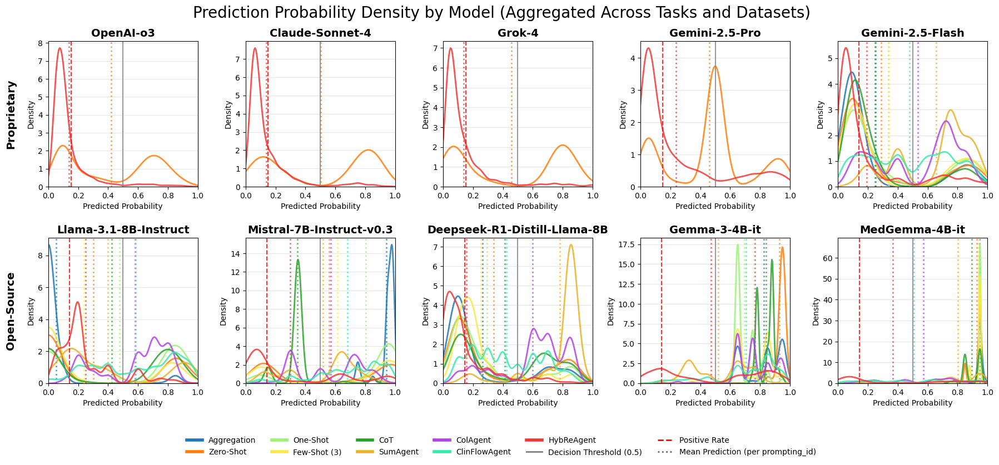

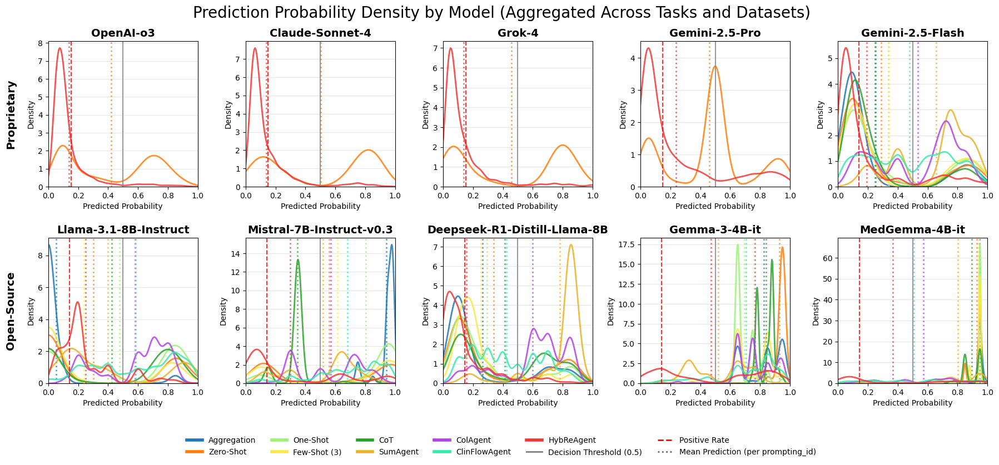

In [42]:
def plot_prediction_density_by_prompting_id(
    df_metadata,
    save_path=None,
    bins=100,
    figsize=(18, 8),
    legend_fontsize=10,
):
    """
    2x5 grid: one subplot per prompting_id (5 standard, 4 agentic, plus one empty).
    Each subplot: density curves for all LLM models (aggregated over all 9 task-dataset combinations).
    Colors: MODEL_MAPPING.
    Also shows mean prediction value for each model as a vertical dotted line.
    Adds row labels: "Standard Prompting" (top row), "Agents" (bottom row), rotated 90°.
    """
    prompting_ids = STANDARD_PROMPTING_IDS + AGENTIC_PROMPTING_IDS
    models = LLM_MODELS
    n_rows, n_cols = 2, 5

    fig, axes = plt.subplots(n_rows, n_cols, figsize=figsize)
    fig.suptitle(
        "Prediction Probability Density by Prompting Strategy (Aggregated Across Tasks and Datasets)",
        fontsize=20,
        y=0.98,
    )

    for idx, prompting_id in enumerate(prompting_ids):
        i, j = divmod(idx, n_cols)
        ax = axes[i, j]
        # Filter for this prompting_id
        df_pid = df_metadata[df_metadata["model_prompting_id"].str.endswith(prompting_id)]
        # For each model, plot density and mean prediction
        for model in models:
            mask = df_pid["model_prompting_id"].str.startswith(model)
            data = df_pid[mask]["probabilities"]
            if not data.empty:
                color = MODEL_MAPPING.get(model, "#666666")
                sns.kdeplot(data, ax=ax, label=model, color=color, fill=False, linewidth=2, alpha=0.85, bw_adjust=1.2)
                # Plot mean prediction value as a vertical dotted line
                mean_pred = data.mean()
                ax.axvline(mean_pred, color=color, linestyle=":", linewidth=2, alpha=0.7, label=f"{model} Mean ({mean_pred:.2f})")
        # Decision threshold and positive rate
        all_probs = df_pid["probabilities"].dropna()
        all_labels = df_pid["label"].dropna()
        pos_rate = all_labels.mean() if not all_labels.empty else 0
        ax.axvline(0.5, color="gray", linestyle="-", linewidth=1.5, alpha=0.8, label="Decision Threshold (0.5)")
        ax.axvline(pos_rate, color="red", linestyle="--", linewidth=1.5, alpha=0.8, label=f"Positive Rate ({pos_rate:.3f})")
        ax.set_xlim(0, 1)
        ax.set_title(prompting_id, fontsize=14, fontweight="bold")
        ax.set_xlabel("Predicted Probability", fontsize=10)
        ax.set_ylabel("Density", fontsize=10)
        ax.grid(axis="y", alpha=0.3)
    # Hide empty subplots (if any)
    for idx in range(len(prompting_ids), n_rows * n_cols):
        i, j = divmod(idx, n_cols)
        axes[i, j].axis("off")
    # Add row labels (rotated)
    for row, label in zip([0, 1], ["Standard Prompting", "Agents"]):
        axes[row, 0].annotate(
            label,
            xy=(-0.25, 0.5),
            xycoords="axes fraction",
            fontsize=14,
            fontweight="bold",
            rotation=90,
            va="center",
            ha="center",
            annotation_clip=False,
        )
    # Legend below grid
    handles = [
        plt.Line2D([0], [0], color=MODEL_MAPPING.get(model, "#666666"), lw=4, label=model)
        for model in models
    ]
    handles += [
        plt.Line2D([0], [0], color="gray", lw=2, linestyle="-", label="Decision Threshold (0.5)"),
        plt.Line2D([0], [0], color="red", lw=2, linestyle="--", label="Positive Rate"),
        plt.Line2D([0], [0], color="#666666", lw=2, linestyle=":", label="Mean Prediction (per model)"),
    ]
    fig.legend(handles=handles, loc="lower center", bbox_to_anchor=(0.5, -0.05), ncol=min(6, len(handles)), fontsize=legend_fontsize, frameon=False)
    plt.tight_layout()
    plt.subplots_adjust(top=0.9, bottom=0.13, hspace=0.35)
    if save_path:
        os.makedirs(os.path.dirname(save_path), exist_ok=True)
        plt.savefig(save_path, dpi=400, bbox_inches="tight")
        print(f"Saved to: {save_path}")
    plt.show()
    return fig

def plot_prediction_density_by_model(
    df_metadata,
    save_path=None,
    bins=100,
    figsize=(18, 8),
    legend_fontsize=10,
):
    """
    2x5 grid: one subplot per LLM model (10 total).
    Each subplot: density curves for all prompting_ids (aggregated over all 9 task-dataset combinations).
    Colors: PROMPTING_ID_MAPPING.
    Also shows mean prediction value for each prompting_id as a vertical dotted line.
    Adds row labels: "Proprietary" (top row), "Open-Source" (bottom row), rotated 90°.
    """
    models = LLM_MODELS
    prompting_ids = STANDARD_PROMPTING_IDS + AGENTIC_PROMPTING_IDS
    n_rows, n_cols = 2, 5

    # Define which models are proprietary (top row) and open-source (bottom row)
    proprietary_models = [
        "OpenAI-o3", "Claude-Sonnet-4", "Grok-4", "Gemini-2.5-Pro", "Gemini-2.5-Flash"
    ]
    open_source_models = [
        "Llama-3.1-8B-Instruct", "Mistral-7B-Instruct-v0.3", "Deepseek-R1-Distill-Llama-8B", "Gemma-3-4B-it", "MedGemma-4B-it"
    ]
    model_grid = proprietary_models + open_source_models

    fig, axes = plt.subplots(n_rows, n_cols, figsize=figsize)
    fig.suptitle("Prediction Probability Density by Model (Aggregated Across Tasks and Datasets)", fontsize=20, y=0.98)

    for idx, model in enumerate(model_grid):
        i, j = divmod(idx, n_cols)
        ax = axes[i, j]
        # Filter for this model
        df_model = df_metadata[df_metadata["model_prompting_id"].str.startswith(model)]
        # For each prompting_id, plot density and mean prediction
        for prompting_id in prompting_ids:
            mask = df_model["model_prompting_id"].str.endswith(prompting_id)
            data = df_model[mask]["probabilities"]
            if not data.empty:
                color = PROMPTING_ID_MAPPING.get(prompting_id, "#666666")
                sns.kdeplot(data, ax=ax, label=prompting_id, color=color, fill=False, linewidth=2, alpha=0.85, bw_adjust=1.2)
                # Plot mean prediction value as a vertical dotted line
                mean_pred = data.mean()
                ax.axvline(mean_pred, color=color, linestyle=":", linewidth=2, alpha=0.7, label=f"{prompting_id} Mean ({mean_pred:.2f})")
        # Decision threshold and positive rate
        all_probs = df_model["probabilities"].dropna()
        all_labels = df_model["label"].dropna()
        pos_rate = all_labels.mean() if not all_labels.empty else 0
        ax.axvline(0.5, color="gray", linestyle="-", linewidth=1.5, alpha=0.8, label="Decision Threshold (0.5)")
        ax.axvline(pos_rate, color="red", linestyle="--", linewidth=1.5, alpha=0.8, label=f"Positive Rate ({pos_rate:.3f})")
        ax.set_xlim(0, 1)
        ax.set_title(model, fontsize=14, fontweight="bold")
        ax.set_xlabel("Predicted Probability", fontsize=10)
        ax.set_ylabel("Density", fontsize=10)
        ax.grid(axis="y", alpha=0.3)
    # Hide empty subplots (if any)
    for idx in range(len(model_grid), n_rows * n_cols):
        i, j = divmod(idx, n_cols)
        axes[i, j].axis("off")
    # Add row labels (rotated)
    for row, label in zip([0, 1], ["Proprietary", "Open-Source"]):
        axes[row, 0].annotate(
            label,
            xy=(-0.25, 0.5),
            xycoords="axes fraction",
            fontsize=14,
            fontweight="bold",
            rotation=90,
            va="center",
            ha="center",
            annotation_clip=False,
        )
    # Legend below grid
    handles = [
        plt.Line2D([0], [0], color=PROMPTING_ID_MAPPING.get(pid, "#666666"), lw=4, label=pid)
        for pid in prompting_ids
    ]
    handles += [
        plt.Line2D([0], [0], color="gray", lw=2, linestyle="-", label="Decision Threshold (0.5)"),
        plt.Line2D([0], [0], color="red", lw=2, linestyle="--", label="Positive Rate"),
        plt.Line2D([0], [0], color="#666666", lw=2, linestyle=":", label="Mean Prediction (per prompting_id)"),
    ]
    fig.legend(handles=handles, loc="lower center", bbox_to_anchor=(0.5, -0.05), ncol=min(6, len(handles)), fontsize=legend_fontsize, frameon=False)
    plt.tight_layout()
    plt.subplots_adjust(top=0.9, bottom=0.13, hspace=0.35)
    if save_path:
        os.makedirs(os.path.dirname(save_path), exist_ok=True)
        plt.savefig(save_path, dpi=400, bbox_inches="tight")
        print(f"Saved to: {save_path}")
    plt.show()
    return fig

# Example calls:
plot_prediction_density_by_prompting_id(
    df_metadata,
    save_path=os.path.join(prediction_dist_output_dir, "prediction_density_by_prompting_id_llms.png"),
    bins=100,
)

plot_prediction_density_by_model(
    df_metadata,
    save_path=os.path.join(prediction_dist_output_dir, "prediction_density_by_model_llms.png"),
    bins=100,
)

#### Calibration Analysis

Interpretation:
- Points on diagonal: well-calibrated
- Points above diagonal: under-confident (actual rate > predicted rate)
- Points below diagonal: over-confident (actual rate < predicted rate)
Calibration analysis grid saved to: ./notebook_output/pulse_agents_overall/prediction_distribution/calibration_analysis_grid_xgboost_hra.png


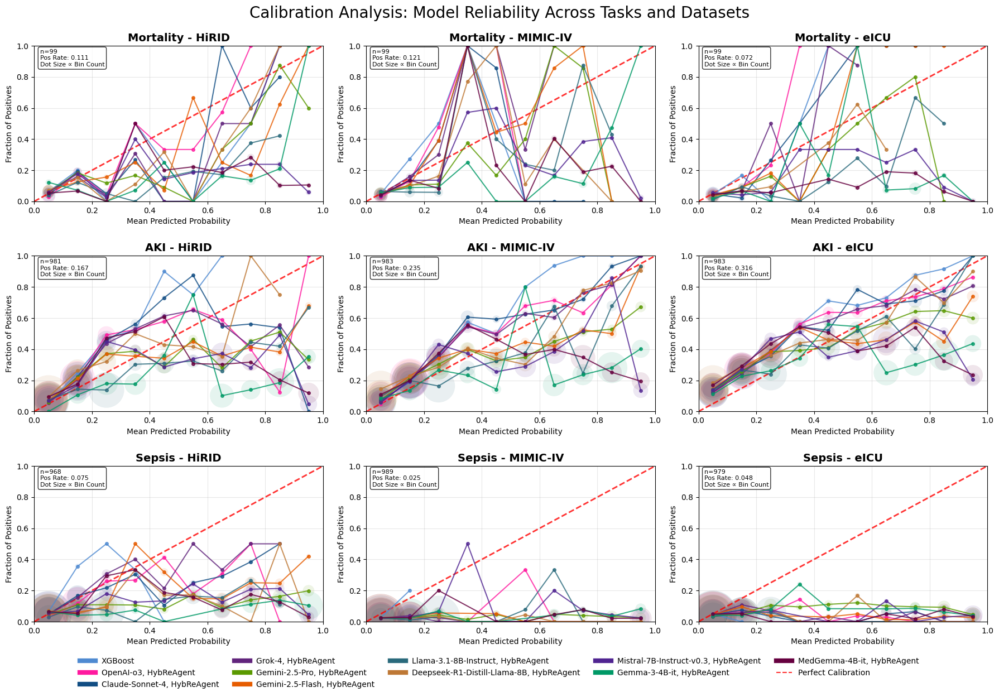

Calibration analysis grid saved to: ./notebook_output/pulse_agents_overall/prediction_distribution/calibration_analysis_grid_xgboost_hra.png


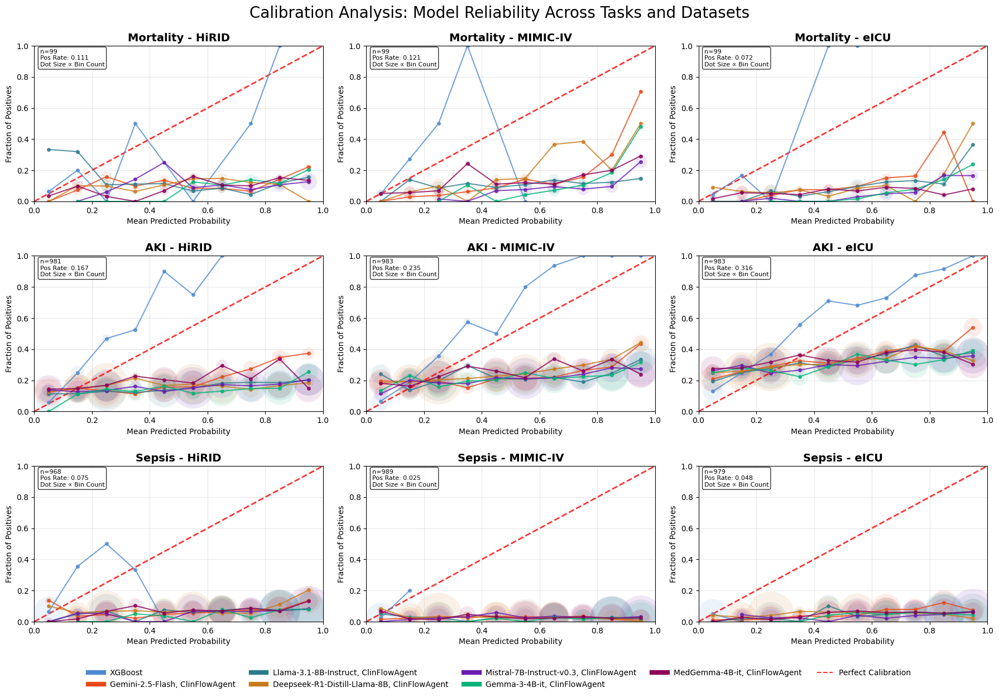

In [43]:
def create_calibration_analysis_plot(
    ax,
    task,
    dataset,
    df_metadata,
    models=None,
    with_legend=True,
    bins=20,
):
    """
    Create calibration analysis plot for a specific task-dataset combination.
    Shows calibration curves for each model with perfect calibration reference.
    
    Args:
        ax: Matplotlib axis
        task (str): Task name
        dataset (str): Dataset name
        df_metadata (DataFrame): Metadata DataFrame with predictions and labels
        models (list): List of models to include (if None, uses all available)
    """
    # Filter data for this task-dataset combination
    task_dataset_data = df_metadata[
        (df_metadata['task'] == task) & 
        (df_metadata['dataset'] == dataset)
    ]

    if task_dataset_data.empty:
        ax.text(0.5, 0.5, f'No data for\n{task}-{dataset}', 
               ha='center', va='center', transform=ax.transAxes, fontsize=12)
        ax.set_title(f'{task} - {dataset}', fontsize=14, fontweight='bold')
        return

    # Get unique models if not specified
    if models is None:
        models = sorted(task_dataset_data['model_prompting_id'].unique())
    else:
        # Filter to only models that exist in the data
        available_models = task_dataset_data['model_prompting_id'].unique()
        models = [m for m in models if m in available_models]

    if not models:
        ax.text(0.5, 0.5, f'No models available\nfor {task}-{dataset}', 
               ha='center', va='center', transform=ax.transAxes, fontsize=12)
        ax.set_title(f'{task} - {dataset}', fontsize=14, fontweight='bold')
        return

    # Plot perfect calibration line first
    ax.plot([0, 1], [0, 1], 'r--', alpha=0.8, linewidth=2, label='Perfect Calibration')

    # Create calibration plots for each model
    for model in models:
        model_data = task_dataset_data[task_dataset_data['model_prompting_id'] == model]

        if len(model_data) == 0:
            continue

        predictions = model_data['probabilities'].values
        labels = model_data['label'].values

        # Create probability bins for calibration analysis
        # Dynamically create probability bins based on the bins argument
        prob_bins = np.linspace(0, 1, bins + 1)
        bin_centers = []
        bin_accuracies = []
        bin_counts = []

        for i in range(len(prob_bins) - 1):
            bin_mask = (predictions >= prob_bins[i]) & (predictions < prob_bins[i + 1])
            bin_data = labels[bin_mask]

            if len(bin_data) > 0:
                bin_centers.append((prob_bins[i] + prob_bins[i + 1]) / 2)
                bin_accuracies.append(bin_data.mean())
                bin_counts.append(len(bin_data))
            else:
                bin_centers.append((prob_bins[i] + prob_bins[i + 1]) / 2)
                bin_accuracies.append(np.nan)
                bin_counts.append(0)

        # Plot calibration curve
        valid_indices = ~np.isnan(bin_accuracies)
        if np.any(valid_indices):
            valid_centers = np.array(bin_centers)[valid_indices]
            valid_accuracies = np.array(bin_accuracies)[valid_indices]
            valid_counts = np.array(bin_counts)[valid_indices]

            # Get model color and plot
            color = get_model_prompting_id_color(model)

            # Plot line connecting the points
            ax.plot(valid_centers, valid_accuracies, 'o-', color=color, 
                   linewidth=1.5, markersize=4, alpha=0.8, label=f'{model}')

            # Add scatter points sized by count
            ax.scatter(valid_centers, valid_accuracies, 
                      s=valid_counts * 1.5,  # Size based on count
                      alpha=0.1, color=color, edgecolor=color, linewidth=0.2)

    # Formatting
    ax.set_xlabel('Mean Predicted Probability', fontsize=10)
    ax.set_ylabel('Fraction of Positives', fontsize=10)
    ax.set_title(f'{task} - {dataset}', fontsize=14, fontweight='bold')
    ax.grid(alpha=0.3)
    ax.set_xlim(0, 1)
    ax.set_ylim(0, 1)
    ax.set_xticks(np.arange(0, 1.1, 0.2))
    ax.set_yticks(np.arange(0, 1.1, 0.2))

    # Add legend with smaller font
    if with_legend:
        ax.legend(fontsize=10, loc='lower right')

    # Add text box with general calibration info and dot size explanation
    total_samples = len(task_dataset_data)
    n_per_model = task_dataset_data["sample_index"].max()
    positive_samples = int(task_dataset_data['label'].sum())
    pos_rate = positive_samples / total_samples
    stats_text = f'n={n_per_model}\nPos Rate: {pos_rate:.3f}\nDot Size ∝ Bin Count'
    ax.text(0.02, 0.98, stats_text, transform=ax.transAxes, fontsize=8,
           verticalalignment='top', bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))


def create_calibration_analysis_grid(df_metadata, save_path=None, models=None, with_legend=False, bins=10):
    """
    Create a 3x3 grid showing calibration analysis for all task-dataset combinations.
    Tasks on y-axis, datasets on x-axis, each subplot shows calibration curves for all models.
    
    Args:
        df_metadata (DataFrame): Metadata DataFrame with predictions and labels
        save_path (str): Optional path to save the figure
    """
    # Define order for consistent plotting
    tasks = ['Mortality', 'AKI', 'Sepsis']
    datasets = ['HiRID', 'MIMIC-IV', 'eICU']
    models = models or df_metadata['model_prompting_id'].unique()

    # Create figure with 3x3 grid
    fig, axes = plt.subplots(3, 3, figsize=(18, 12))
    fig.suptitle('Calibration Analysis: Model Reliability Across Tasks and Datasets', 
                fontsize=20, y=0.98)

    # Plot each task-dataset combination
    for i, task in enumerate(tasks):
        for j, dataset in enumerate(datasets):
            ax = axes[i, j]
            create_calibration_analysis_plot(ax, task, dataset, df_metadata, models=models, with_legend=with_legend, bins=bins)
    # Add column titles and y-labels
    for i, task in enumerate(tasks):
        axes[i, 0].set_ylabel('Fraction of Positives', fontsize=10, fontweight='normal')


    # Add a single legend centered below the grid
    # Collect model handles and labels as in the individual plot
    model_labels = []
    model_colors = []
    for model in models:
        model_labels.append(f"{model}")
        model_colors.append(get_model_prompting_id_color(model))
    handles = [
        plt.Line2D([0], [0], color=color, lw=6, label=label)
        for color, label in zip(model_colors, model_labels)
    ]
    # Add reference lines as in the individual plot
    handles.append(
        plt.Line2D(
            [0],
            [0],
            color="red",
            linestyle="--",
            alpha=0.8,
            linewidth=1.5,
            label="Perfect Calibration",
        )
    )

    fig.legend(
        handles=handles,
        loc="lower center",
        bbox_to_anchor=(0.5, -0.05),
        ncol=min(5, len(handles)),
        fontsize=10,
        frameon=False,
    )

    # Adjust layout
    plt.tight_layout()
    plt.subplots_adjust(top=0.92, hspace=0.35, wspace=0.15, bottom=0.06)

    # Save if path provided
    if save_path:
        os.makedirs(os.path.dirname(save_path), exist_ok=True)
        plt.savefig(save_path, dpi=400, bbox_inches='tight', format='png')
        print(f"Calibration analysis grid saved to: {save_path}")

    plt.show()
    return fig

def create_individual_calibration_plots(df_metadata, output_dir, with_legend=True, bins=10):
    """
    Create individual calibration analysis plots for each task-dataset combination.
    
    Args:
        df_metadata (DataFrame): Metadata DataFrame with predictions and labels
        output_dir (str): Output directory for saving plots
    """
    tasks = ['Mortality', 'AKI', 'Sepsis']
    datasets = ['HiRID', 'MIMIC-IV', 'eICU']
    models = ['RandomForest', 'LightGBM', 'XGBoost', 'CNN', 'InceptionTime', 'LSTM', 'GRU']
    
    print(f"\n🎯 Generating individual calibration analysis plots...")
    
    for task in tasks:
        for dataset in datasets:
            # Check if this combination exists in the data
            task_dataset_data = df_metadata[
                (df_metadata['task'] == task) & 
                (df_metadata['dataset'] == dataset)
            ]
            
            if not task_dataset_data.empty:
                fig, ax = plt.subplots(figsize=(10, 8))
                create_calibration_analysis_plot(ax, task, dataset, df_metadata, models, with_legend=with_legend, bins=bins)
                
                # Enhanced title and formatting for individual plots
                ax.set_title(f'Calibration Analysis: {task} - {dataset}', 
                           fontsize=16, fontweight='bold', pad=20)
                
                # Save individual plot
                save_path = os.path.join(output_dir, f'{task}_{dataset}_calibration_analysis.png')
                plt.savefig(save_path, dpi=400, bbox_inches='tight')
                print(f"   Saved {task}-{dataset} calibration plot to: {save_path}")
                plt.close(fig)
            else:
                print(f"   ⚠️  No data found for {task}-{dataset}")


print(
    "Interpretation:\n"
    "- Points on diagonal: well-calibrated\n"
    "- Points above diagonal: under-confident (actual rate > predicted rate)\n"
    "- Points below diagonal: over-confident (actual rate < predicted rate)"
)

# # Create calibration analysis grid of all task-dataset combinations - BASELINES
# print(f"\n🎯 Generating 3x3 calibration analysis grids...")
# fig_cal_baselines = create_calibration_analysis_grid(
#     df_metadata,
#     save_path=os.path.join(
#         prediction_dist_output_dir, "calibration_analysis_grid_baselines.png"
#     ),
#     models=CONVML_MODELS + CONVDL_MODELS,
#     bins=10,
# )

# # Create calibration analysis grid of all task-dataset combinations - LLMs
# fig_cal_llms = create_calibration_analysis_grid(
#     df_metadata,
#     save_path=os.path.join(
#         prediction_dist_output_dir, "calibration_analysis_grid_llms.png"
#     ),
#     models=LLM_ALL_PROMPTING_IDS,
#     bins=10,
# )

# # Create calibration analysis grid of all task-dataset combinations - ALL MODELS
# fig_cal_all = create_calibration_analysis_grid(
#     df_metadata_benchmark,
#     save_path=os.path.join(
#         prediction_dist_output_dir, "calibration_analysis_grid_all_models_benchmark.png"
#     ),
#     models=None,
#     bins=10,
# )

# # Create calibration analysis grid of all task-dataset combinations - ALL MODELS
# fig_cal_all = create_calibration_analysis_grid(
#     df_metadata_agents,
#     save_path=os.path.join(
#         prediction_dist_output_dir, "calibration_analysis_grid_all_models_agents.png"
#     ),
#     models=None,
#     bins=10,
# )


# Create calibration analysis grid of all task-dataset combinations - XGBOOST, HYBRID REASONING AGENT
hybrid_reasoning_agents = [
    model for model in df_metadata_agents['model_prompting_id'].unique() 
    if "HybReAgent" in model
]
fig_cal_xgboost_hra = create_calibration_analysis_grid(
    df_metadata_agents,
    save_path=os.path.join(
        prediction_dist_output_dir, "calibration_analysis_grid_xgboost_hra.png"
    ),
    models=["XGBoost"] + hybrid_reasoning_agents,
    bins=10,
)

# Create calibration analysis grid of all task-dataset combinations - CLINFLOW AGENT
clinflow_agents = [
    model
    for model in df_metadata_agents["model_prompting_id"].unique()
    if "ClinFlowAgent" in model
]
fig_cal_xgboost_hra = create_calibration_analysis_grid(
    df_metadata_agents,
    save_path=os.path.join(
        prediction_dist_output_dir, "calibration_analysis_grid_xgboost_hra.png"
    ),
    models=["XGBoost"] + clinflow_agents,
    bins=10,
)

# # Generate individual calibration plots for each task-dataset combination
# create_individual_calibration_plots(
#     df_metadata,
#     prediction_dist_output_dir)

Calibration error grid saved to: ./notebook_output/pulse_agents_overall/prediction_distribution/calibration_error_grid_xgboost_hybreagent_zeroshot.png


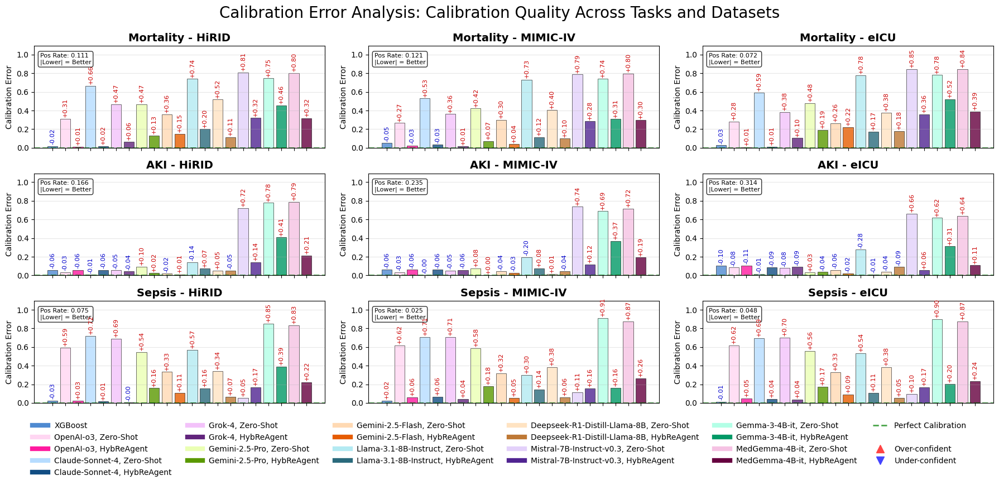

Calibration error grid saved to: ./notebook_output/pulse_agents_overall/prediction_distribution/calibration_error_grid_xgboost_hra.png


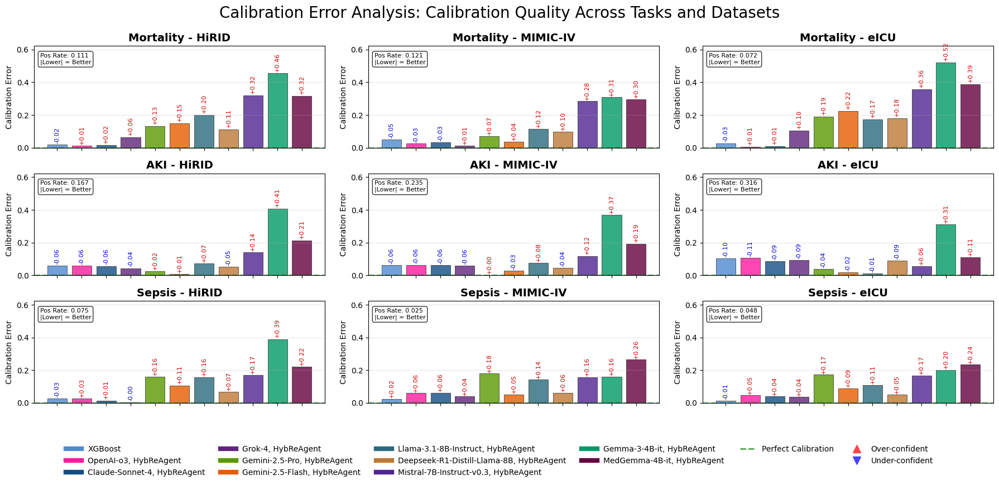

In [44]:
def create_calibration_error_plot(
    ax,
    task,
    dataset,
    df_metadata,
    models=None,
    with_legend=True,
    show_xticklabels=True,
    show_bias_direction=True,
):
    """
    Create calibration error plot for a specific task-dataset combination.
    Shows calibration error (|mean_prediction - actual_positive_rate|) for each model.

    Args:
        ax: Matplotlib axis
        task (str): Task name
        dataset (str): Dataset name
        df_metadata (DataFrame): Metadata DataFrame with predictions and labels
        models (list): List of models to include (if None, uses all available)
        with_legend (bool): Whether to include legend
        show_xticklabels (bool): Whether to show x-tick labels (if True, only on last row)
        show_bias_direction (bool): Whether to show bias direction indicators and values
    """
    # Filter data for this task-dataset combination
    task_dataset_data = df_metadata[
        (df_metadata['task'] == task) & 
        (df_metadata['dataset'] == dataset)
    ]

    if task_dataset_data.empty:
        ax.text(0.5, 0.5, f'No data for\n{task}-{dataset}', 
               ha='center', va='center', transform=ax.transAxes, fontsize=12)
        ax.set_title(f'{task} - {dataset}', fontsize=14, fontweight='bold')
        return

    # Get unique models if not specified
    if models is None:
        models = sorted(task_dataset_data['model_prompting_id'].unique())
    else:
        # Filter to only models that exist in the data
        available_models = task_dataset_data['model_prompting_id'].unique()
        models = [m for m in models if m in available_models]

    if not models:
        ax.text(0.5, 0.5, f'No models available\nfor {task}-{dataset}', 
               ha='center', va='center', transform=ax.transAxes, fontsize=12)
        ax.set_title(f'{task} - {dataset}', fontsize=14, fontweight='bold')
        return

    # Calculate calibration error AND bias direction for each model
    model_errors = []
    model_colors = []
    model_labels = []
    model_biases = []

    for model in models:
        model_data = task_dataset_data[task_dataset_data["model_prompting_id"] == model]

        if len(model_data) == 0:
            continue

        predictions = model_data["probabilities"].values
        labels = model_data["label"].values

        # Remove NaN values
        valid_mask = ~np.isnan(predictions) & ~np.isnan(labels)
        if not np.any(valid_mask):
            continue

        valid_predictions = predictions[valid_mask]
        valid_labels = labels[valid_mask]

        # Calculate calibration error and bias
        pred_mean = np.mean(valid_predictions)
        pos_rate = np.mean(valid_labels)
        calibration_error = abs(pred_mean - pos_rate)
        calibration_bias = (
            pred_mean - pos_rate
        )  # Positive = over-confident, Negative = under-confident

        model_errors.append(calibration_error)
        model_biases.append(calibration_bias)
        model_colors.append(get_model_prompting_id_color(model))
        model_labels.append(model)

    if not model_errors:
        ax.text(
            0.5,
            0.5,
            f"No valid data\nfor {task}-{dataset}",
            ha="center",
            va="center",
            transform=ax.transAxes,
            fontsize=12,
        )
        ax.set_title(f"{task} - {dataset}", fontsize=14, fontweight="bold")
        return

    # Create bar chart with original colors
    x_positions = np.arange(len(model_labels))
    bars = ax.bar(
        x_positions,
        model_errors,
        color=model_colors,
        alpha=0.8,
        edgecolor="black",
        linewidth=0.5,
    )

    # Add bias direction indicators and values if enabled
    if show_bias_direction:
        max_error = max(model_errors)
        for i, (bar, bias, error) in enumerate(zip(bars, model_biases, model_errors)):
            bar_height = bar.get_height()
            bar_center_x = bar.get_x() + bar.get_width() / 2

            # # Add directional symbol above the bar
            # if abs(bias) > 0.01:  # Only show if bias is meaningful
            #     symbol = "↑" if bias > 0 else "↓"
            #     symbol_color = (
            #         "#FF4444" if bias > 0 else "#4444FF"
            #     )  # Red for over-confident, Blue for under-confident

            #     ax.text(
            #         bar_center_x,
            #         bar_height + max_error * 0.12,
            #         symbol,
            #         ha="center",
            #         va="bottom",
            #         fontsize=12,
            #         color=symbol_color,
            #         fontweight="bold",
            #         zorder=10,
            #     )

            # Add value labels with bias information
            bias_text = f"+{bias:.2f}" if bias > 0 else f"{bias:.2f}"
            text_color = "#CC0000" if bias > 0 else "#0000CC"

            ax.text(
                bar_center_x,
                bar_height + max_error * 0.02,
                bias_text,
                ha="center",
                va="bottom",
                fontsize=8,
                color=text_color,
                rotation=90,
                zorder=10,
            )

    # Formatting
    ax.set_ylabel('Calibration Error', fontsize=10)
    ax.set_title(f'{task} - {dataset}', fontsize=14, fontweight='bold')
    ax.grid(axis='y', alpha=0.3)
    ax.set_xticks(x_positions)

    # Show xticklabels based on argument and position
    if show_xticklabels and hasattr(ax, 'get_subplotspec') and ax.get_subplotspec().is_last_row():
        ax.set_xticklabels(model_labels, rotation=45, ha='right', fontsize=8)
    else:
        ax.set_xticklabels([])

    # Set y-axis limits with padding when showing bias direction and values
    if show_bias_direction and model_errors:
        max_error = max(model_errors)
        # Add extra padding (30% of max value) to accommodate arrows and text
        y_max = max_error * 1.3
        ax.set_ylim(0, y_max)
    else:
        ax.set_ylim(bottom=0)

    # Add perfect calibration reference line at y=0
    ax.axhline(y=0, color='green', linestyle='--', alpha=0.7, linewidth=2, 
               label='Perfect Calibration')

    # Add text box with general info
    total_samples = len(task_dataset_data)
    n_per_model = task_dataset_data["sample_index"].max()
    positive_samples = int(task_dataset_data['label'].sum())
    pos_rate = positive_samples / total_samples
    stats_text = f'Pos Rate: {pos_rate:.3f}\n|Lower| = Better'
    ax.text(0.02, 0.93, stats_text, transform=ax.transAxes, fontsize=8,
           verticalalignment='top', bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))

    # Add legend with smaller font
    if with_legend:
        ax.legend(fontsize=8, loc='upper right')


def create_calibration_error_grid(
    df_metadata,
    save_path=None,
    models=None,
    with_legend=False,
    show_xticklabels=True,
    with_grid_legend=True,
    show_bias_direction=True,
):
    """
    Create a 3x3 grid showing calibration error for all task-dataset combinations.
    Tasks on y-axis, datasets on x-axis, each subplot shows calibration error for all models.

    Args:
        df_metadata (DataFrame): Metadata DataFrame with predictions and labels
        save_path (str): Optional path to save the figure
        models (list): List of models to include (if None, uses all available)
        with_legend (bool): Whether to include legend on individual subplots
        show_xticklabels (bool): Whether to show x-tick labels (if True, only on last row)
        with_grid_legend (bool): Whether to show the grid legend at the bottom
        show_bias_direction (bool): Whether to show bias direction indicators and values
    """
    # Define order for consistent plotting
    tasks = ['Mortality', 'AKI', 'Sepsis']
    datasets = ['HiRID', 'MIMIC-IV', 'eICU']
    models = models or df_metadata['model_prompting_id'].unique()

    # Calculate global y-axis limits by finding max calibration error across all combinations
    global_max_error = 0
    all_errors = []

    for task in tasks:
        for dataset in datasets:
            task_dataset_data = df_metadata[
                (df_metadata["task"] == task) & (df_metadata["dataset"] == dataset)
            ]

            if not task_dataset_data.empty:
                for model in models:
                    model_data = task_dataset_data[
                        task_dataset_data["model_prompting_id"] == model
                    ]
                    if len(model_data) > 0:
                        predictions = model_data["probabilities"].values
                        labels = model_data["label"].values

                        valid_mask = ~np.isnan(predictions) & ~np.isnan(labels)
                        if np.any(valid_mask):
                            valid_predictions = predictions[valid_mask]
                            valid_labels = labels[valid_mask]

                            pred_mean = np.mean(valid_predictions)
                            pos_rate = np.mean(valid_labels)
                            calibration_error = abs(pred_mean - pos_rate)
                            all_errors.append(calibration_error)

    if all_errors:
        global_max_error = max(all_errors)
        # Add padding for bias direction indicators and text if enabled
        if show_bias_direction:
            y_max = global_max_error * 1.2  # 40% padding for arrows and text
        else:
            y_max = global_max_error * 1.05  # 10% padding
    else:
        y_max = 1.0  # Default fallback

    global_ylim = (0, y_max)

    # Create figure with 3x3 grid
    fig, axes = plt.subplots(3, 3, figsize=(18, 8))
    fig.suptitle('Calibration Error Analysis: Calibration Quality Across Tasks and Datasets', 
                fontsize=20, y=0.99)

    # Plot each task-dataset combination
    for i, task in enumerate(tasks):
        for j, dataset in enumerate(datasets):
            ax = axes[i, j]
            create_calibration_error_plot(ax, task, dataset, df_metadata, 
                                        models=models, with_legend=with_legend, 
                                        show_xticklabels=show_xticklabels,
                                        show_bias_direction=show_bias_direction)

            # Apply consistent y-axis limits to all subplots
            ax.set_ylim(global_ylim)

    # # Add column titles and y-labels
    # for i, task in enumerate(tasks):
    #     axes[i, 0].set_ylabel('Calibration Error', fontsize=14, fontweight='bold')

    # Add a single legend centered below the grid only if with_grid_legend is True
    if with_grid_legend:
        # Collect model handles and labels as in the individual plot
        model_labels = []
        model_colors = []
        for model in models:
            model_labels.append(f"{model}")
            model_colors.append(get_model_prompting_id_color(model))

        handles = [
            plt.Line2D([0], [0], color=color, lw=6, label=label)
            for color, label in zip(model_colors, model_labels)
        ]
        # Add perfect calibration reference line
        handles.append(
            plt.Line2D(
                [0],
                [0],
                color="green",
                linestyle="--",
                alpha=0.7,
                linewidth=2,
                label="Perfect Calibration",
            )
        )

        # Add bias direction indicators to legend if enabled
        if show_bias_direction:
            handles.extend(
                [
                    plt.Line2D([0], [0], marker="", linestyle="", label=""),  # Spacer
                    plt.Line2D(
                        [0],
                        [0],
                        color="#FF4444",
                        marker="^",  # Triangle up
                        linestyle="",
                        markersize=10,
                        label="Over-confident",
                    ),
                    plt.Line2D(
                        [0],
                        [0],
                        color="#4444FF",
                        marker="v",  # Triangle down
                        linestyle="",
                        markersize=10,
                        label="Under-confident",
                    ),
                ]
            )

        fig.legend(
            handles=handles,
            loc="lower center",
            bbox_to_anchor=(0.5, -0.08),
            ncol=min(6, len(handles)),
            fontsize=10,
            frameon=False,
        )

    # Adjust layout
    plt.tight_layout()
    # Adjust bottom margin based on whether grid legend is shown
    bottom_margin = 0.10 if with_grid_legend else 0.02
    plt.subplots_adjust(top=0.9, hspace=0.25, wspace=0.15, bottom=bottom_margin)

    # Save if path provided
    if save_path:
        os.makedirs(os.path.dirname(save_path), exist_ok=True)
        plt.savefig(save_path, dpi=400, bbox_inches='tight', format='png')
        print(f"Calibration error grid saved to: {save_path}")

    plt.show()
    return fig


# # Create calibration error grid for benchmark data
# fig_cal_error_benchmark = create_calibration_error_grid(
#     df_metadata_benchmark,
#     save_path=os.path.join(
#         prediction_dist_output_dir, "calibration_error_grid_all_models_benchmark.png"
#     ),
#     models=None,
#     show_xticklabels=False,  # Show x-tick labels only on last row
#     with_grid_legend=True,  # Show grid legend
#     show_bias_direction=False,
# )

# # Create calibration error grid for agents data
# fig_cal_error_agents = create_calibration_error_grid(
#     df_metadata_agents,
#     save_path=os.path.join(
#         prediction_dist_output_dir, "calibration_error_grid_all_models_agents.png"
#     ),
#     models=None,
#     show_xticklabels=False,  # Show x-tick labels only on last row
#     with_grid_legend=True,  # Show grid legend
#     show_bias_direction=False,
# )



# Create calibration error grid for XGBoost vs HybReAgent and Zero-Shot models
xgb_hybreagent_zeroshot_models = [
    model for model in df_metadata['model_prompting_id'].unique()
    if "HybReAgent" in model or "Zero-Shot" in model
]
fig_cal_error_xgb_hra_zeroshot = create_calibration_error_grid(
    df_metadata,
    save_path=os.path.join(
        prediction_dist_output_dir, "calibration_error_grid_xgboost_hybreagent_zeroshot.png"
    ),
    models=["XGBoost"] + xgb_hybreagent_zeroshot_models,
    show_xticklabels=False,
    with_grid_legend=True,
    show_bias_direction=True,
)


# Create calibration error grid for XGBoost vs Hybrid Reasoning Agents comparison
hybreagents = [
    model for model in df_metadata_agents['model_prompting_id'].unique() 
    if "HybReAgent" in model
]
fig_cal_error_xgboost_hra = create_calibration_error_grid(
    df_metadata_agents,
    save_path=os.path.join(
        prediction_dist_output_dir, "calibration_error_grid_xgboost_hra.png"
    ),
    models=["XGBoost"] + hybrid_reasoning_agents,
    show_xticklabels=False,  
    with_grid_legend=True, 
    show_bias_direction=True,  
)

# # Create calibration error grid for proprietary models comparison
# proprietary_models = [
#     model
#     for model in df_metadata["model_prompting_id"].unique()
#     if any(
#         proprietary in model
#         for proprietary in [
#             "OpenAI-o3",
#             "Claude-Sonnet-4",
#             "Grok-4",
#             "Gemini-2.5-Pro",
#             "Gemini-2.5-Flash",
#         ]
#     )
# ]
# fig_cal_error_xgboost_hra = create_calibration_error_grid(
#     df_metadata,
#     save_path=os.path.join(
#         prediction_dist_output_dir, "calibration_error_grid_proprietary_llms.png"
#     ),
#     models=proprietary_models,
#     show_xticklabels=False,
#     with_grid_legend=True,
#     show_bias_direction=True,
# )

### Operational Performance Analysis

This section analyzes the operational metrics for LLMs, including tokenization time, inference time, and token usage patterns. We create comprehensive visualizations that compare different operational aspects across models, tasks, and datasets.

Note: proprietary models do not provide tokenization times, they are set to 0.0
Operational performance summary saved to: ./notebook_output/pulse_agents_overall/operational_performance/operational_performance_summary_split_by_task.png


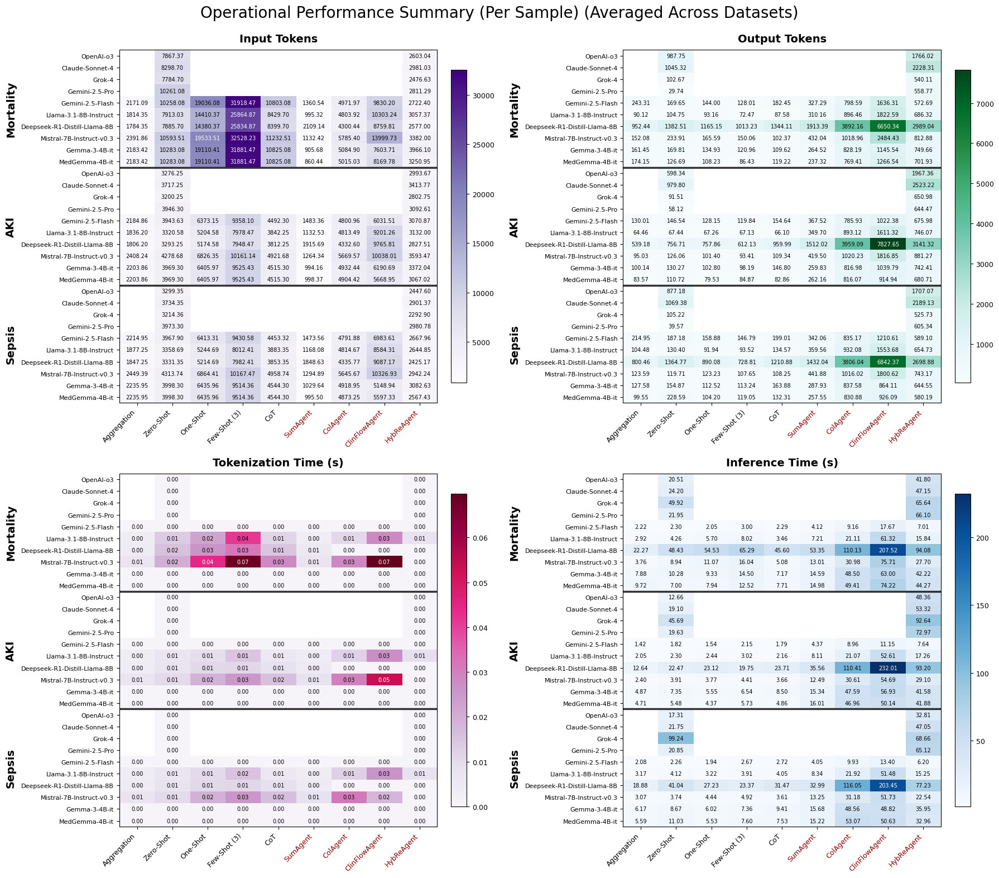

In [45]:
def create_operational_performance_summary_split_by_task(
    df_metrics_op,
    output_path=None,
    title_suffix="",
    figsize=(18, 20),
    aggregation_level="model_type+model_name+is_agent+prompting_id+task+dataset",
):
    """
    Create a 2x2 grid of operational metrics, each subplot split into 3 rows (Mortality, AKI, Sepsis).
    - Each subplot: 3-row heatmap (one per task), common x-ticklabels (prompting_id), common colorbar.
    - Y-axis: models per task.
    - Row label: task name (rotated 90° on the left).
    - Black horizontal lines between tasks.
    - Model order: LLM_MODELS, then any others in df_metrics_op (preserving order).
    - Prompting_id order: PROMPTING_ID_MAPPING keys (in order), then any others in df_metrics_op (preserving order).
    """
    df_filtered = df_metrics_op[
        df_metrics_op["aggregation_level"] == aggregation_level
    ].copy()
    if df_filtered.empty:
        print(f"No data found for aggregation level: {aggregation_level}")
        return None

    metrics = [
        ("avg_sample_input_tokens", "Input Tokens", "Purples"),
        ("avg_sample_output_tokens", "Output Tokens", "BuGn"),
        ("avg_sample_tokenization_time", "Tokenization Time (s)", "PuRd"),
        ("avg_sample_inference_time", "Inference Time (s)", "Blues"),
    ]
    tasks = ["Mortality", "AKI", "Sepsis"]

    # Model order: LLM_MODELS first (in order), then any others in df_metrics_op (preserving their order of appearance)
    all_models_in_data = df_filtered["model_name"].tolist()
    seen = set()
    models = [m for m in LLM_MODELS if m in all_models_in_data]
    for m in all_models_in_data:
        if m not in models and m not in seen:
            models.append(m)
            seen.add(m)

    # Prompting_id order: PROMPTING_ID_MAPPING keys (in order), then any others in df_metrics_op (preserving their order of appearance)
    all_prompting_ids_in_data = df_filtered["prompting_id"].tolist()
    seen_pid = set()
    prompting_ids = [
        pid for pid in PROMPTING_ID_MAPPING.keys() if pid in all_prompting_ids_in_data
    ]
    for pid in all_prompting_ids_in_data:
        if pid not in prompting_ids and pid not in seen_pid:
            prompting_ids.append(pid)
            seen_pid.add(pid)

    # Prepare summary: average across datasets for each (task, model, prompting_id)
    summary = (
        df_filtered.groupby(["task", "model_name", "prompting_id"])[
            [m[0] for m in metrics]
        ]
        .mean()
        .reset_index()
    )

    # Create figure with 2x2 grid
    fig, axes = plt.subplots(2, 2, figsize=figsize)
    fig.suptitle(
        f"Operational Performance Summary (Per Sample){title_suffix}",
        fontsize=20,
        y=0.98,
    )

    axes = axes.flatten()
    for idx, (metric_col, metric_title, colormap) in enumerate(metrics):
        ax = axes[idx]

        # Find global vmin/vmax for colorbar scaling
        global_min, global_max = None, None
        for task in tasks:
            task_data = summary[summary["task"] == task]
            vals = task_data[metric_col].values
            if len(vals) > 0:
                tmin, tmax = np.nanmin(vals), np.nanmax(vals)
                global_min = tmin if global_min is None else min(global_min, tmin)
                global_max = tmax if global_max is None else max(global_max, tmax)
        if global_min is None or global_max is None:
            global_min, global_max = 0, 1

        # Build a big matrix: rows = sum of models per task, columns = prompting_ids
        all_rows = []
        row_labels = []
        for task in tasks:
            task_data = summary[summary["task"] == task]
            # Use all models, fill missing with np.nan
            task_matrix = np.full((len(models), len(prompting_ids)), np.nan)
            for i, model in enumerate(models):
                for j, pid in enumerate(prompting_ids):
                    value = task_data[
                        (task_data["model_name"] == model)
                        & (task_data["prompting_id"] == pid)
                    ][metric_col]
                    if not value.empty:
                        task_matrix[i, j] = value.values[0]
            all_rows.append(task_matrix)
            row_labels.extend([f"{model}" for model in models])
        big_matrix = np.vstack(all_rows)

        # Plot heatmap
        im = ax.imshow(
            big_matrix,
            cmap=colormap,
            aspect="auto",
            interpolation="nearest",
            vmin=global_min,
            vmax=global_max,
        )

        # Set x-ticks
        ax.set_xticks(range(len(prompting_ids)))
        ax.set_xticklabels(prompting_ids, rotation=45, ha="right", fontsize=9)

        # Change font color for agent prompting IDs to red
        for ticklabel, pid in zip(ax.get_xticklabels(), prompting_ids):
            if pid in AGENTIC_PROMPTING_IDS:
                ticklabel.set_color("darkred")

        # Set y-ticks and labels
        ax.set_yticks(range(len(row_labels)))
        ax.set_yticklabels(row_labels, fontsize=8)

        # Add value annotations
        for i in range(big_matrix.shape[0]):
            for j in range(big_matrix.shape[1]):
                value = big_matrix[i, j]
                if not np.isnan(value):
                    text_color = "white" if value > global_max * 0.6 else "black"
                    ax.text(
                        j,
                        i,
                        f"{value:.2f}",
                        ha="center",
                        va="center",
                        color=text_color,
                        fontsize=7,
                    )

        # Add metric title
        ax.set_title(metric_title, fontsize=14, fontweight="bold", pad=10)

        # Add colorbar (one per subplot)
        cbar = fig.colorbar(im, ax=ax, fraction=0.045, pad=0.04)
        cbar.ax.tick_params(labelsize=9)

        # Add rotated task labels on left side
        for t_idx, task in enumerate(tasks):
            ypos = t_idx * len(models) + len(models) / 2 - 0.5
            ax.annotate(
                task,
                xy=(-0.5, ypos),
                xycoords="data",
                xytext=(-140, 0),
                textcoords="offset points",
                fontsize=14,
                fontweight="bold",
                rotation=90,
                va="center",
                ha="center",
                annotation_clip=False,
            )

        # Add black horizontal lines between tasks
        for t_idx in range(1, len(tasks)):
            y_pos = t_idx * len(models) - 0.5
            ax.axhline(y=y_pos, color="black", linewidth=2.5, alpha=0.8)

    # Adjust layout
    plt.tight_layout()
    plt.subplots_adjust(top=0.93, hspace=0.20, wspace=0.45)

    if output_path:
        os.makedirs(os.path.dirname(output_path), exist_ok=True)
        plt.savefig(output_path, dpi=400, bbox_inches="tight", format="png")
        print(f"Operational performance summary saved to: {output_path}")

    plt.show()
    return fig


# Example usage:
print("Note: proprietary models do not provide tokenization times, they are set to 0.0")
operational_output_dir = os.path.join(OUTPUT_BASE_DIR, "operational_performance")
os.makedirs(operational_output_dir, exist_ok=True)
summary_path = os.path.join(
    operational_output_dir, "operational_performance_summary_split_by_task.png"
)
fig_summary_split_by_task = create_operational_performance_summary_split_by_task(
    df_metrics_op,
    output_path=summary_path,
    title_suffix=" (Averaged Across Datasets)",
    figsize=(18, 16),
    aggregation_level="model_type+model_name+is_agent+prompting_id+task+dataset",
)

In [46]:
def compute_efficiency_metrics_per_sample(
    df, aggregation_level="model_type+model_name+is_agent+prompting_id+task+dataset"
):
    """
    Computes per-sample efficiency metrics for each model × prompting strategy:
    - processing_time_per_sample = mean(tokenization_time + inference_time) across all tasks/datasets
    - total_tokens_per_sample = mean(input_tokens + output_tokens) across all tasks/datasets
    - processing_throughput_per_sample = total_tokens_per_sample / processing_time_per_sample
    - avg_sample_inference_time = mean inference time (for marker size)
    Returns a DataFrame with one row per (model_name, prompting_id).
    """
    df_filtered = df[df["aggregation_level"] == aggregation_level].copy()
    if df_filtered.empty:
        print(f"No data found for aggregation level: {aggregation_level}")
        return pd.DataFrame()

    # Group by model_name, prompting_id, task, then average across datasets
    grouped = (
        df_filtered.groupby(["model_name", "prompting_id", "task"])
        .agg(
            {
                "avg_sample_tokenization_time": "mean",
                "avg_sample_inference_time": "mean",
                "avg_sample_input_tokens": "mean",
                "avg_sample_output_tokens": "mean",
            }
        )
        .reset_index()
    )

    # Now average across tasks for each (model_name, prompting_id)
    final = (
        grouped.groupby(["model_name", "prompting_id"])
        .agg(
            {
                "avg_sample_tokenization_time": "mean",
                "avg_sample_inference_time": "mean",  # <-- keep this for marker size
                "avg_sample_input_tokens": "mean",
                "avg_sample_output_tokens": "mean",
            }
        )
        .reset_index()
    )

    # Compute per-sample metrics
    final["processing_time_per_sample"] = (
        final["avg_sample_tokenization_time"] + final["avg_sample_inference_time"]
    )
    final["total_tokens_per_sample"] = (
        final["avg_sample_input_tokens"] + final["avg_sample_output_tokens"]
    )
    final["processing_throughput_per_sample"] = (
        final["total_tokens_per_sample"] / final["processing_time_per_sample"]
    )

    # Ensure avg_sample_inference_time is present for marker size
    # (already present from aggregation above)

    return final

Note: proprietary models do not provide tokenization times, they are set to 0.0
Note: averaged across tasks and datasets
Efficiency scatter plot saved to: ./notebook_output/pulse_agents_overall/operational_performance/efficiency_scatter_improved.png


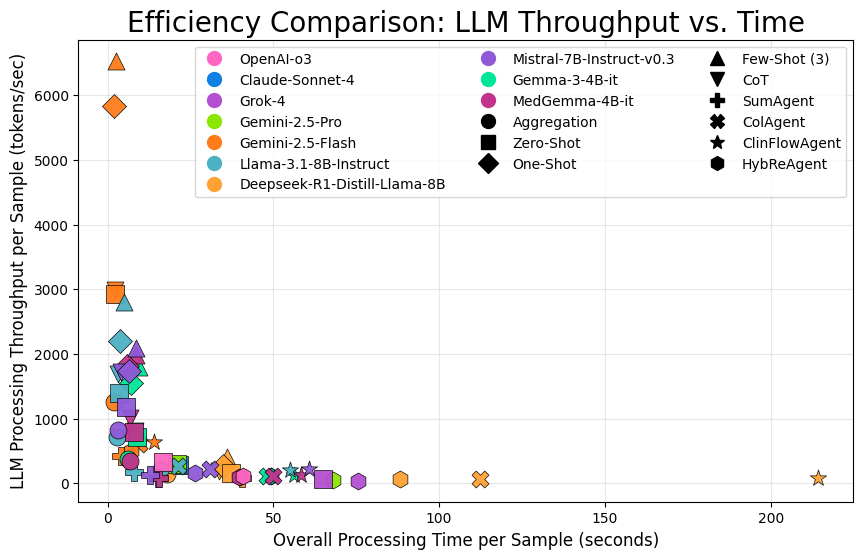

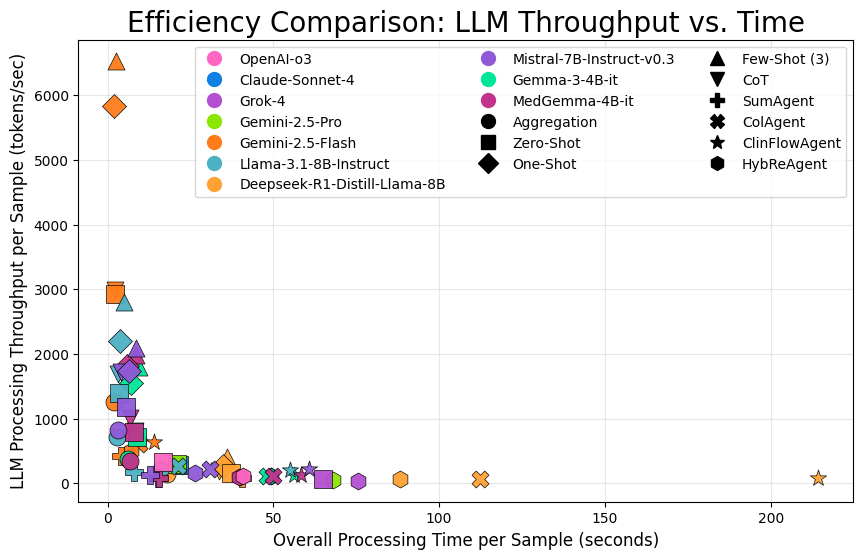

In [47]:
def plot_efficiency_scatter(
    df_metrics_op,
    cost_df=None,
    df_metrics=None,
    x_metric="processing_time_per_sample",
    y_metric="processing_throughput_per_sample",
    inference_time_column="avg_sample_inference_time",
    aggregation_level="model_type+model_name+is_agent+prompting_id",
    figsize=(12, 8),
    save_path=None,
):
    """
    Improved efficiency scatter plot:
    - X-axis: Processing Time per Sample (seconds)
    - Y-axis: Processing Throughput per Sample (tokens/sec)
    - Marker size: Inference time (avg_sample_inference_time)
    - Marker shape: Each prompting_id gets a unique shape
    - Color: Model
    - Legend: Color=Model, Shape=Prompting, Size=Inference Time, Pareto Frontier
    - Annotation: prompting_id
    - Pareto frontier: Red dashed line
    """
    # Compute per-sample metrics
    df_eff = compute_efficiency_metrics_per_sample(df_metrics_op)

    # # Add inference time for marker size
    # op_df = df_metrics_op[
    #     df_metrics_op["aggregation_level"] == aggregation_level
    # ].copy()
    # op_df = (
    #     op_df.groupby(["model_name", "prompting_id"])[inference_time_column]
    #     .mean()
    #     .reset_index()
    # )
    # df_eff = df_eff.merge(op_df, on=["model_name", "prompting_id"], how="left")

    # Prepare plot data
    x = df_eff[x_metric].values
    y = df_eff[y_metric].values
    # sizes = df_eff[inference_time_column].values
    # min_size, max_size = 200, 1600
    # if len(sizes) > 0 and np.nanmax(sizes) > 0:
    #     sizes_norm = min_size + (max_size - min_size) * (sizes - np.nanmin(sizes)) / (
    #         np.nanmax(sizes) - np.nanmin(sizes) + 1e-8
    #     )
    # else:
    #     sizes_norm = [min_size] * len(sizes)

    # Marker shapes for each prompting_id
    prompting_ids = df_eff["prompting_id"].unique()
    prompting_id_to_marker = get_prompting_id_to_marker(prompting_ids)
    markers = [prompting_id_to_marker[row["prompting_id"]] for _, row in df_eff.iterrows()]

    # Colors: use get_model_prompting_id_color for each point
    colors = [
        get_first_agent_color(row['model_name'])
        for _, row in df_eff.iterrows()
    ]

    # --- Create plot ---
    fig, ax = plt.subplots(figsize=figsize)
    for i, row in df_eff.iterrows():
        ax.scatter(
            row[x_metric],
            row[y_metric],
            s=150, # s=sizes_norm[i],
            c=colors[i],
            alpha=0.95,
            edgecolors="black",
            linewidths=0.5,
            marker=markers[i],
            label=None,
            zorder=2,
        )
        # ax.annotate(
        #     row["prompting_id"],
        #     (row[x_metric], row[y_metric]),
        #     textcoords="offset points",
        #     xytext=(5, 0),
        #     ha="left",
        #     fontsize=8,
        #     color="black",
        #     alpha=0.8,
        #     bbox=dict(
        #         boxstyle="round,pad=0.1", facecolor="white", edgecolor="none", alpha=0.7
        #     ),
        # )

    ax.set_xlabel("Overall Processing Time per Sample (seconds)", fontsize=12)
    ax.set_ylabel("LLM Processing Throughput per Sample (tokens/sec)", fontsize=12)
    ax.set_title("Efficiency Comparison: LLM Throughput vs. Time", fontsize=20)
    ax.grid(alpha=0.3)

    # --- Legend elements ---
    # Only include models present in df_eff, in LLM_MODELS order first, then others
    present_models = [m for m in LLM_MODELS if m in df_eff["model_name"].unique()]
    present_models += [
        m for m in df_eff["model_name"].unique() if m not in present_models
    ]
    color_handles = [
        mlines.Line2D(
            [],
            [],
            color=get_first_agent_color(model),
            marker="o",
            linestyle="None",
            markersize=10,
            label=model,
        )
        for model in present_models
    ]

    # Only include prompting_ids present in df_eff, in PROMPTING_ID_MAPPING order first, then others
    present_prompting_ids = [
        pid
        for pid in PROMPTING_ID_MAPPING.keys()
        if pid in df_eff["prompting_id"].unique()
    ]
    present_prompting_ids += [
        pid
        for pid in df_eff["prompting_id"].unique()
        if pid not in present_prompting_ids
    ]
    marker_handles = [
        mlines.Line2D(
            [],
            [],
            color="black",
            marker=prompting_id_to_marker[pid],
            linestyle="None",
            markersize=10,
            label=pid,
        )
        for pid in present_prompting_ids
        if pid in prompting_id_to_marker
    ]

    # # Marker size legend for inference time
    # if len(sizes) > 0 and np.nanmax(sizes) > 0:
    #     legend_sizes = np.linspace(np.nanmin(sizes), np.nanmax(sizes), 3)
    #     size_handles = [
    #         mlines.Line2D(
    #             [],
    #             [],
    #             color="gray",
    #             marker="o",
    #             linestyle="None",
    #             markersize=np.sqrt(
    #                 min_size
    #                 + (max_size - min_size)
    #                 * (s - np.nanmin(sizes))
    #                 / (np.nanmax(sizes) - np.nanmin(sizes) + 1e-8)
    #             )
    #             / 2,
    #             label=f"Inference Time: {s:.2f}s",
    #         )
    #         for s in legend_sizes
    #     ]
    # else:
    #     size_handles = []

    legend_handles = color_handles + marker_handles #+ size_handles
    ax.legend(
        handles=legend_handles, loc="upper right", fontsize=10, frameon=True, ncol=3
    )

    if save_path:
        plt.savefig(save_path, dpi=400, bbox_inches="tight")
        print(f"Efficiency scatter plot saved to: {save_path}")

    return fig


# Example usage:
print("Note: proprietary models do not provide tokenization times, they are set to 0.0")
print("Note: averaged across tasks and datasets")
efficiency_output_dir = os.path.join(OUTPUT_BASE_DIR, "operational_performance")
os.makedirs(efficiency_output_dir, exist_ok=True)
efficiency_scatter_path = os.path.join(
    efficiency_output_dir, "efficiency_scatter_improved.png"
)
plot_efficiency_scatter(
    df_metrics_op=df_metrics_op,
    inference_time_column="avg_sample_inference_time",
    aggregation_level="model_type+model_name+is_agent+prompting_id",
    figsize=(10, 6),
    save_path=efficiency_scatter_path,
)

Efficiency Scatter Plot: Explanation & Interpretation Help

**What does this plot show?**
- Each point represents a model × prompting strategy combination, aggregated per sample.
- **X-axis:** Average processing time per sample (seconds) — lower is better.
- **Y-axis:** Processing throughput per sample (tokens/sec) — higher is better.
- **Color:** Indicates the model.
- **Marker shape:** Indicates the prompting strategy.

**How to interpret:**
- **Top-left corner:** Most efficient (fast and high throughput).
- **Bottom-right corner:** Least efficient (slow and low throughput).
- Points closer to the top-left are preferable for operational efficiency.
- Use this plot to compare models and prompting strategies for the best trade-off between speed and throughput.

**Why do agents (especially HybReAgent) have low processing throughput?**
- Agentic methods like HybReAgent often require multi-step reasoning, iterative calls, or orchestration between sub-agents. This increases total processing time and reduces throughput, as each sample may involve several model invocations and more complex logic.
- HybReAgent is designed for advanced reasoning and decision-making, prioritizing accuracy and robustness over speed. Its lower throughput reflects the extra computational steps and coordination required.

**Why is low throughput not necessarily bad?**
- Agentic methods may deliver higher accuracy, reliability, or better decision support, which can justify longer processing times in clinical or high-stakes settings.
- In many real-world applications, especially in healthcare, throughput is less critical than correctness, interpretability, or safety. If the agent provides superior results, the extra time may be acceptable.
- Agents sometimes require **shorter prompts** compared to one-shot or few-shot strategies, which can reduce input token usage and cost, partially offsetting the lower throughput.

**Summary:**  
Agentic methods like HybReAgent are slower and less throughput-efficient because they perform more complex reasoning, but this can be a worthwhile trade-off for improved decision quality and sometimes lower

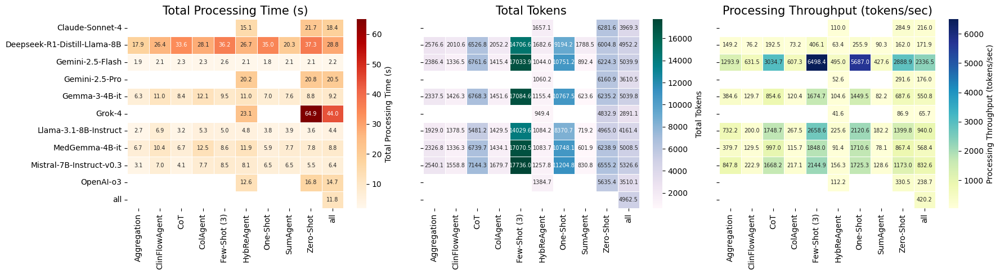

In [48]:
def compute_efficiency_metrics_aggregated(df, groupby_cols=["model_name", "prompting_id", "task", "dataset"]):
    """
    Computes aggregate efficiency metrics:
    - Total Processing Time = mean(tokenization_time) + mean(inference_time)
    - Total Tokens = mean(input_tokens) + mean(output_tokens)
    - Processing Throughput = Total Tokens / Total Processing Time
    Returns a DataFrame with these metrics for each group.
    """
    # Use available columns (handle missing tokenization_time for proprietary models)
    cols = {
        "tokenization_time": [c for c in df.columns if "tokenization" in c][0] if any("tokenization" in c for c in df.columns) else None,
        "inference_time": [c for c in df.columns if "inference" in c][0],
        "input_tokens": [c for c in df.columns if "input_token" in c][0],
        "output_tokens": [c for c in df.columns if "output_token" in c][0],
    }
    agg_dict = {}
    if cols["tokenization_time"]:
        agg_dict[cols["tokenization_time"]] = "mean"
    agg_dict[cols["inference_time"]] = "mean"
    agg_dict[cols["input_tokens"]] = "mean"
    agg_dict[cols["output_tokens"]] = "mean"

    grouped = df.groupby(groupby_cols).agg(agg_dict).reset_index()
    # Compute aggregate metrics
    grouped["total_processing_time"] = (
        (grouped[cols["tokenization_time"]] if cols["tokenization_time"] else 0)
        + grouped[cols["inference_time"]]
    )
    grouped["total_tokens"] = grouped[cols["input_tokens"]] + grouped[cols["output_tokens"]]
    grouped["processing_throughput"] = grouped["total_tokens"] / grouped["total_processing_time"]
    return grouped


def plot_efficiency_metrics_grid(df_eff, figsize=(28, 7), save_path=None):
    """
    Plots heatmaps for Total Processing Time, Total Tokens, and Processing Throughput side-by-side.
    """
    metrics = [
        ("total_processing_time", "Total Processing Time (s)", "OrRd"),
        ("total_tokens", "Total Tokens", "PuBuGn"),
        ("processing_throughput", "Processing Throughput (tokens/sec)", "YlGnBu"),
    ]
    fig, axes = plt.subplots(1, 3, figsize=figsize)
    for idx, (ax, (col, title, cmap)) in enumerate(zip(axes, metrics)):
        df_plot = (
            df_eff.groupby(["model_name", "prompting_id"])[col]
            .mean()
            .unstack("prompting_id")
        )
        sns.heatmap(
            df_plot,
            annot=True,
            fmt=".1f",
            cmap=cmap,
            linewidths=0.5,
            ax=ax,
            cbar_kws={"label": title},
            annot_kws={"fontsize": 7},
        )
        ax.set_title(title, fontsize=15)
        ax.set_xlabel("")
        # Only show yticklabels for the first subplot
        if idx == 0:
            ax.set_ylabel("")
        else:
            ax.set_yticklabels([])
            ax.set_ylabel("")
    plt.tight_layout()
    if save_path:
        plt.savefig(save_path, dpi=400, bbox_inches="tight")
        print(f"Efficiency metrics grid saved to: {save_path}")
    plt.show()


# --- Run the analysis ---
df_efficiency = compute_efficiency_metrics_aggregated(df_metrics_op)
plot_efficiency_metrics_grid(df_efficiency, figsize=(18, 5))

In [49]:
def summarize_operational_efficiency(
    df_metrics_op,
    aggregation_levels=None,
    agentic_ids=None,
    standard_ids=None,
    focus_agent="HybReAgent",
):
    """
    Summarizes operational efficiency metrics for agents vs standard prompting, with focus on hybrid reasoning agent.
    Prints actionable statements for reporting.

    Args:
        df_metrics_op (DataFrame): Operational metrics dataframe.
        aggregation_levels (list): List of aggregation levels to analyze.
        agentic_ids (list): List of agentic prompting IDs.
        standard_ids (list): List of standard prompting IDs.
        focus_agent (str or list): Name(s) of agent(s) to focus on (e.g., "HybReAgent" or ["HybReAgent", "ClinFlowAgent"]).
    """
    if aggregation_levels is None:
        aggregation_levels = [
            "model_type+model_name+is_agent+prompting_id",
            "model_type+model_name+is_agent+prompting_id+task+dataset"
        ]
    if agentic_ids is None:
        agentic_ids = AGENTIC_PROMPTING_IDS
    if standard_ids is None:
        standard_ids = STANDARD_PROMPTING_IDS

    # Accept both str and list for focus_agent
    if isinstance(focus_agent, str):
        focus_agents = [focus_agent]
    elif isinstance(focus_agent, list):
        focus_agents = focus_agent
    else:
        focus_agents = [str(focus_agent)]

    statements = []

    for agg_level in aggregation_levels:
        df = df_metrics_op[df_metrics_op["aggregation_level"] == agg_level].copy()
        if df.empty:
            continue

        # Compute mean processing time and throughput per group
        df["processing_time"] = df["avg_sample_tokenization_time"] + df["avg_sample_inference_time"]
        df["total_tokens"] = df["avg_sample_input_tokens"] + df["avg_sample_output_tokens"]
        df["throughput"] = df["total_tokens"] / df["processing_time"]

        # Agentic vs Standard
        agent_df = df[df["prompting_id"].isin(agentic_ids)]
        std_df = df[df["prompting_id"].isin(standard_ids)]

        # Mean values
        agent_time = agent_df["processing_time"].mean()
        agent_throughput = agent_df["throughput"].mean()
        std_time = std_df["processing_time"].mean()
        std_throughput = std_df["throughput"].mean()

        statements.append(
            f"At aggregation level '{agg_level}', agentic prompting methods required on average {agent_time:.2f}s per sample (vs {std_time:.2f}s for standard prompting) and achieved a mean throughput of {agent_throughput:.1f} tokens/sec (vs {std_throughput:.1f} for standard)."
        )

        # Focus on each agent in focus_agents
        for agent in focus_agents:
            agent_df = df[df["prompting_id"] == agent]
            if not agent_df.empty:
                agent_time = agent_df["processing_time"].mean()
                agent_throughput = agent_df["throughput"].mean()
                agent_input = agent_df["avg_sample_input_tokens"].mean()
                agent_output = agent_df["avg_sample_output_tokens"].mean()
                statements.append(
                    f"The agent '{agent}' had an average processing time of {agent_time:.2f}s per sample and throughput of {agent_throughput:.1f} tokens/sec. It typically used {agent_input:.1f} input tokens and {agent_output:.1f} output tokens per sample."
                )

    # Print all statements
    print("=== Operational Efficiency Summary ===")
    for s in statements:
        print(f"- {s}")

    return statements


# Example usage:
summarize_operational_efficiency(
    df_metrics_op,
    aggregation_levels=[
        "model_type+model_name+is_agent+prompting_id",
        "model_type+model_name+is_agent+prompting_id+task+dataset"
    ],
    agentic_ids=AGENTIC_PROMPTING_IDS,
    standard_ids=STANDARD_PROMPTING_IDS,
    focus_agent=["HybReAgent", "ClinFlowAgent"]
)

=== Operational Efficiency Summary ===
- At aggregation level 'model_type+model_name+is_agent+prompting_id', agentic prompting methods required on average 45.65s per sample (vs 12.26s for standard prompting) and achieved a mean throughput of 186.5 tokens/sec (vs 1448.1 for standard).
- The agent 'HybReAgent' had an average processing time of 45.12s per sample and throughput of 144.7 tokens/sec. It typically used 2938.2 input tokens and 1173.2 output tokens per sample.
- The agent 'ClinFlowAgent' had an average processing time of 76.48s per sample and throughput of 231.7 tokens/sec. It typically used 8405.1 input tokens and 2357.6 output tokens per sample.
- At aggregation level 'model_type+model_name+is_agent+prompting_id+task+dataset', agentic prompting methods required on average 45.65s per sample (vs 12.26s for standard prompting) and achieved a mean throughput of 187.0 tokens/sec (vs 1432.3 for standard).
- The agent 'HybReAgent' had an average processing time of 45.12s per sample 

["At aggregation level 'model_type+model_name+is_agent+prompting_id', agentic prompting methods required on average 45.65s per sample (vs 12.26s for standard prompting) and achieved a mean throughput of 186.5 tokens/sec (vs 1448.1 for standard).",
 "The agent 'HybReAgent' had an average processing time of 45.12s per sample and throughput of 144.7 tokens/sec. It typically used 2938.2 input tokens and 1173.2 output tokens per sample.",
 "The agent 'ClinFlowAgent' had an average processing time of 76.48s per sample and throughput of 231.7 tokens/sec. It typically used 8405.1 input tokens and 2357.6 output tokens per sample.",
 "At aggregation level 'model_type+model_name+is_agent+prompting_id+task+dataset', agentic prompting methods required on average 45.65s per sample (vs 12.26s for standard prompting) and achieved a mean throughput of 187.0 tokens/sec (vs 1432.3 for standard).",
 "The agent 'HybReAgent' had an average processing time of 45.12s per sample and throughput of 145.4 tokens/

### Cost Analysis

In [57]:
def create_token_cost_analysis(df_metrics_op):
    """
    Create a dataframe showing token usage and costs per model_prompting_id.
    Uses aggregation across all 9 task-dataset combinations (3 tasks × 3 datasets).

    Cost Logic:
    1. Uses 'model_type+model_name+is_agent+prompting_id' aggregation level for totals
    2. Gets avg_num_steps from the most granular level and averages across task-dataset combinations
    3. This gives us totals across all 9 task-dataset combinations per model/prompting strategy
    4. Sample-level costs: cost per individual sample (avg_sample_* metrics)
    5. Total costs: cost for processing all samples across all 9 combinations (total_* metrics)
    6. All costs calculated using API pricing per million tokens
    7. For agent prompting methods: sample_count is adjusted by dividing by avg_num_steps
    """

    print("=== TOKEN COST ANALYSIS LOGIC ===")
    print("1. Using aggregation level: 'model_type+model_name+is_agent+prompting_id'")
    print("2. Getting avg_num_steps from most granular level")
    print(
        "3. This captures usage across all 9 task-dataset combinations (3 tasks × 3 datasets)"
    )
    print("4. Sample-level metrics: average tokens per individual sample")
    print(
        "5. Total metrics: sum of all tokens across all samples in all 9 combinations"
    )
    print("6. Costs calculated using API pricing per million tokens")
    print("7. For agent prompting methods: sample_count adjusted by dividing by avg_num_steps")
    print()

    # Define cost per million tokens for each model
    cost_mapping = {
        # "GPT-4.1": {"input_cost": 2.0, "output_cost": 8.0},
        "OpenAI-o3": {"input_cost": 2.0, "output_cost": 8.0},
        # "GPT-4o": {"input_cost": 2.5, "output_cost": 10.0},
        "Gemini-2.5-Flash": {"input_cost": 0.3, "output_cost": 2.5},
        "Gemini-2.5-Pro": {"input_cost": 1.25, "output_cost": 10.0},
        "Claude-Sonnet-4": {"input_cost": 3.0, "output_cost": 15.0},
        "Grok-4": {"input_cost": 3.0, "output_cost": 15.0},
    }

    # Get the aggregated totals at the model+prompting level
    df_totals = df_metrics_op[
        (
            df_metrics_op["aggregation_level"]
            == "model_type+model_name+is_agent+prompting_id"
        )
        & (df_metrics_op["model_name"].isin(cost_mapping.keys()))
    ].copy()

    # Get avg_num_steps from the most granular level
    df_granular = df_metrics_op[
        (
            df_metrics_op["aggregation_level"]
            == "model_type+model_name+is_agent+prompting_id+task+dataset"
        )
        & (df_metrics_op["model_name"].isin(cost_mapping.keys()))
    ].copy()

    if df_totals.empty:
        print("No matching models found in operational metrics.")
        return pd.DataFrame()

    print(f"Found {len(df_totals)} model/prompting combinations with cost data")

    # Calculate average avg_num_steps across task-dataset combinations for each model+prompting combo
    if not df_granular.empty:
        avg_steps_per_combo = df_granular.groupby(
            ['model_name', 'prompting_id', 'is_agent'], observed=True
        )['avg_num_steps'].mean().reset_index()
        avg_steps_per_combo = avg_steps_per_combo.rename(columns={'avg_num_steps': 'avg_num_steps_calculated'})

        # Merge back to totals
        df_totals = df_totals.merge(
            avg_steps_per_combo, 
            on=['model_name', 'prompting_id', 'is_agent'], 
            how='left'
        )
        # Replace the NaN avg_num_steps with calculated values
        df_totals['avg_num_steps'] = df_totals['avg_num_steps_calculated'].fillna(df_totals['avg_num_steps'])
        df_totals = df_totals.drop(columns=['avg_num_steps_calculated'])
    else:
        print("Warning: No granular level data found for calculating avg_num_steps")

    # Use the aggregated data directly (no additional grouping needed)
    token_metrics = df_totals[
        [
            "model_prompting_id",
            "model_name",
            "prompting_id",
            "is_agent",
            "avg_num_steps",
            "total_input_tokens",
            "total_output_tokens",
            "sample_count",
        ]
    ].copy()

    # Adjust sample_count for agent prompting methods
    def adjust_sample_count(row):
        if row['is_agent'] and not pd.isna(row['avg_num_steps']) and row['avg_num_steps'] > 0:
            adjusted_count = row['sample_count'] / row['avg_num_steps']
            if not np.isclose(adjusted_count, round(adjusted_count)):
                print(f"Warning: Adjusted sample_count is not integer for {row['model_prompting_id']}: {adjusted_count}")
            return int(round(adjusted_count))
        else:
            return row['sample_count']

    token_metrics['adjusted_sample_count'] = token_metrics.apply(adjust_sample_count, axis=1)

    print(f"CALCULATION EXPLANATION:")
    print(f"- Total costs: based on total token usage across all 9 task-dataset combinations")
    print(f"- Per-sample costs: can be calculated as total_cost_usd / adjusted_sample_count")
    print(f"- Sample count: adjusted for agent methods by dividing by avg_num_steps")
    print()

    # Show adjustment details for agent methods
    agent_rows = token_metrics[token_metrics['is_agent'] == True]
    if not agent_rows.empty:
        print("AGENT SAMPLE COUNT ADJUSTMENTS:")
        for _, row in agent_rows.iterrows():
            original = row['sample_count']
            adjusted = row['adjusted_sample_count']
            steps = row['avg_num_steps']
            print(f"  {row['model_prompting_id']}: {original} → {adjusted} (÷{steps:.1f} steps)")
        print()

    # Add cost calculations
    def calculate_costs(row):
        model_name = row["model_name"]
        if model_name in cost_mapping:
            costs = cost_mapping[model_name]

            # Calculate total costs across all 9 combinations (per million tokens)
            total_input_cost = (row["total_input_tokens"] / 1_000_000) * costs[
                "input_cost"
            ]
            total_output_cost = (row["total_output_tokens"] / 1_000_000) * costs[
                "output_cost"
            ]
            total_cost = total_input_cost + total_output_cost

            return pd.Series(
                {
                    "total_input_cost_usd": total_input_cost,
                    "total_output_cost_usd": total_output_cost,
                    "total_cost_usd": total_cost,
                    "input_cost_per_million": costs["input_cost"],
                    "output_cost_per_million": costs["output_cost"],
                }
            )
        else:
            return pd.Series(
                {
                    "total_input_cost_usd": np.nan,
                    "total_output_cost_usd": np.nan,
                    "total_cost_usd": np.nan,
                    "input_cost_per_million": np.nan,
                    "output_cost_per_million": np.nan,
                }
            )

    # Apply cost calculations
    cost_columns = token_metrics.apply(calculate_costs, axis=1)
    token_cost_df = pd.concat([token_metrics, cost_columns], axis=1)

    # Use adjusted_sample_count instead of original sample_count
    token_cost_df['sample_count'] = token_cost_df['adjusted_sample_count']
    token_cost_df = token_cost_df.drop(columns=['adjusted_sample_count'])

    # Round numerical columns for better readability
    numeric_cols = [
        "total_input_tokens",
        "total_output_tokens",
        "sample_count",
        "total_input_cost_usd",
        "total_output_cost_usd",
        "total_cost_usd",
    ]

    for col in numeric_cols:
        if col in token_cost_df.columns:
            if "cost" in col:
                token_cost_df[col] = token_cost_df[col].round(
                    6
                )  # More precision for costs
            else:
                token_cost_df[col] = token_cost_df[col].round(2)

    # Reorder columns for better presentation
    column_order = [
        "model_prompting_id",
        "model_name",
        "prompting_id",
        "is_agent",
        "avg_num_steps",
        "total_input_tokens",
        "total_output_tokens",
        "sample_count",
        "input_cost_per_million",
        "output_cost_per_million",
        "total_input_cost_usd",
        "total_output_cost_usd",
        "total_cost_usd",
    ]

    existing_cols = [col for col in column_order if col in token_cost_df.columns]
    token_cost_df = token_cost_df[existing_cols]

    return token_cost_df

# Load operational metrics if not already loaded
if "df_metrics_op" not in locals():
    df_metrics_op = pd.read_csv(
        "./notebook_output/data/pulse_metrics_operational.csv"
    )
    print(f"Loaded operational metrics: {df_metrics_op.shape}")

# Create the token cost analysis dataframe
df_token_costs = create_token_cost_analysis(df_metrics_op)

print(
    f"Created token cost analysis dataframe with {len(df_token_costs)} model/prompting combinations"
)
print("\nToken Usage and Cost Analysis:")
display(df_token_costs)

# Save the results
os.makedirs(
    "./notebook_output/pulse_agents_overall/cost_analysis",
    exist_ok=True,
)
df_token_costs.to_csv(
    "./notebook_output/pulse_agents_overall/cost_analysis/pulse_token_costs.csv", index=False
)
print(
    f"\nSaved token cost analysis to ./notebook_output/pulse_agents_overall/cost_analysis/pulse_token_costs.csv"
)

=== TOKEN COST ANALYSIS LOGIC ===
1. Using aggregation level: 'model_type+model_name+is_agent+prompting_id'
2. Getting avg_num_steps from most granular level
3. This captures usage across all 9 task-dataset combinations (3 tasks × 3 datasets)
4. Sample-level metrics: average tokens per individual sample
5. Total metrics: sum of all tokens across all samples in all 9 combinations
6. Costs calculated using API pricing per million tokens
7. For agent prompting methods: sample_count adjusted by dividing by avg_num_steps

Found 17 model/prompting combinations with cost data
CALCULATION EXPLANATION:
- Total costs: based on total token usage across all 9 task-dataset combinations
- Per-sample costs: can be calculated as total_cost_usd / adjusted_sample_count
- Sample count: adjusted for agent methods by dividing by avg_num_steps

Created token cost analysis dataframe with 17 model/prompting combinations

Token Usage and Cost Analysis:


,model_prompting_id,model_name,prompting_id,is_agent,avg_num_steps,total_input_tokens,total_output_tokens,sample_count,input_cost_per_million,output_cost_per_million,total_input_cost_usd,total_output_cost_usd,total_cost_usd
0,"Claude-Sonnet-4, Zero-Shot",Claude-Sonnet-4,Zero-Shot,False,1.000000,24430757,6346975,6189,3.00,15.0,73.292271,95.204625,168.496896
1,"Claude-Sonnet-4, HybReAgent",Claude-Sonnet-4,HybReAgent,True,3.262800,19492004,14545528,1897,3.00,15.0,58.476012,218.182920,276.658932
2,"Gemini-2.5-Flash, Aggregation",Gemini-2.5-Flash,Aggregation,False,1.000000,13606360,1088173,6189,0.30,2.5,4.081908,2.720433,6.802341
3,"Gemini-2.5-Flash, CoT",Gemini-2.5-Flash,CoT,False,1.000000,29581035,1095684,6189,0.30,2.5,8.874310,2.739210,11.613520
4,"Gemini-2.5-Flash, Few-Shot (3)",Gemini-2.5-Flash,Few-Shot (3),False,1.000000,64886076,823214,6189,0.30,2.5,19.465823,2.058035,21.523858
5,"Gemini-2.5-Flash, One-Shot",Gemini-2.5-Flash,One-Shot,False,1.000000,43360101,888058,6189,0.30,2.5,13.008030,2.220145,15.228175
6,"Gemini-2.5-Flash, Zero-Shot",Gemini-2.5-Flash,Zero-Shot,False,1.000000,26372683,1033221,6189,0.30,2.5,7.911805,2.583052,10.494857
7,"Gemini-2.5-Flash, ClinFlowAgent",Gemini-2.5-Flash,ClinFlowAgent,True,6.623489,41279869,7067176,934,0.30,2.5,12.383961,17.667940,30.051901
8,"Gemini-2.5-Flash, ColAgent",Gemini-2.5-Flash,ColAgent,True,4.000000,29737152,5012490,1547,0.30,2.5,8.921146,12.531225,21.452371
9,"Gemini-2.5-Flash, HybReAgent",Gemini-2.5-Flash,HybReAgent,True,3.284844,17713090,3896533,1884,0.30,2.5,5.313927,9.741332,15.055259



Saved token cost analysis to ./notebook_output/pulse_agents_overall/cost_analysis/pulse_token_costs.csv


🚀 Creating comprehensive cost visualizations...
📁 Output directory: ./notebook_output/pulse_agents_overall/cost_analysis

📊 Generating comprehensive cost dashboard...
Cost analysis dashboard saved to: ./notebook_output/pulse_agents_overall/cost_analysis/pulse_cost_analysis_dashboard.png


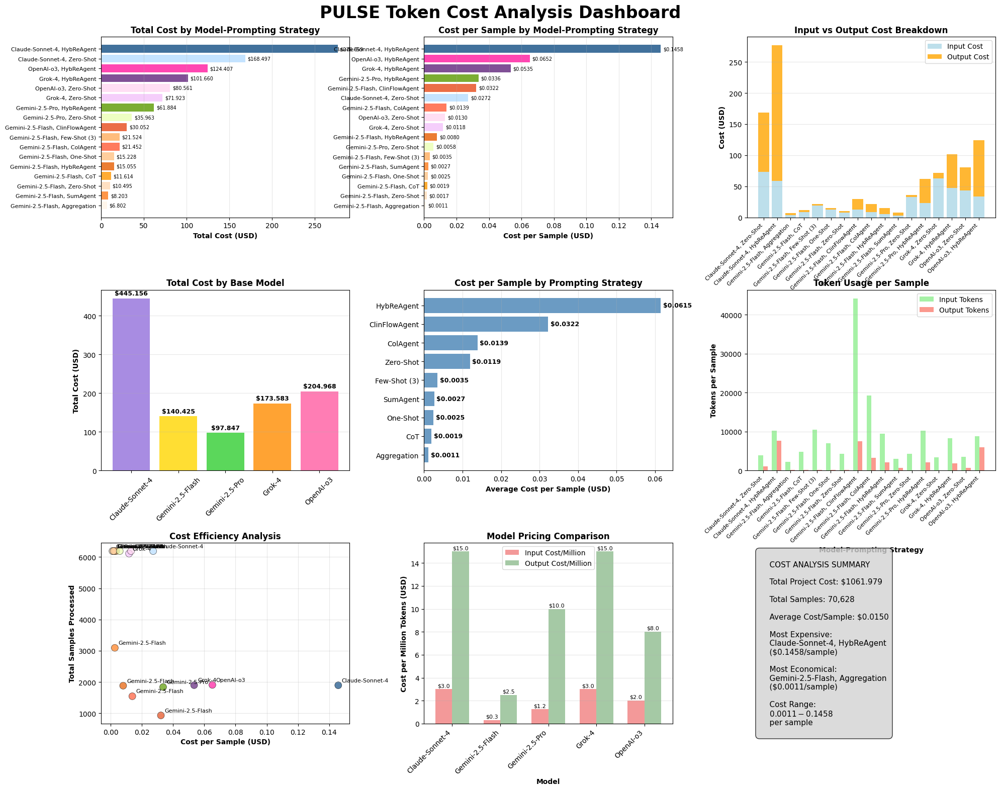


✅ Cost visualization generation complete!
🎯 All visualizations saved to: ./notebook_output/pulse_agents_overall/cost_analysis


In [51]:
def create_cost_visualization_comprehensive(df_token_costs, save_dir=None):
    """
    Create comprehensive cost visualizations for the token cost analysis.
    
    Args:
        df_token_costs (DataFrame): Token cost analysis dataframe
        save_dir (str): Directory to save plots (optional)
    """
    if save_dir:
        os.makedirs(save_dir, exist_ok=True)
    
    # Calculate per-sample costs
    df_costs = df_token_costs.copy()
    df_costs['cost_per_sample'] = df_costs['total_cost_usd'] / df_costs['sample_count']
    df_costs['input_tokens_per_sample'] = df_costs['total_input_tokens'] / df_costs['sample_count']
    df_costs['output_tokens_per_sample'] = df_costs['total_output_tokens'] / df_costs['sample_count']
    
    # Create figure with subplots
    fig = plt.figure(figsize=(20, 16))
    
    # 1. Total Cost by Model-Prompting ID (Top Left)
    ax1 = plt.subplot(3, 3, 1)
    sorted_data = df_costs.sort_values('total_cost_usd', ascending=True)
    colors = [get_model_prompting_id_color(model_id) for model_id in sorted_data['model_prompting_id']]
    bars1 = ax1.barh(range(len(sorted_data)), sorted_data['total_cost_usd'], color=colors, alpha=0.8)
    ax1.set_yticks(range(len(sorted_data)))
    ax1.set_yticklabels(sorted_data['model_prompting_id'], fontsize=8)
    ax1.set_xlabel('Total Cost (USD)', fontweight='bold')
    ax1.set_title('Total Cost by Model-Prompting Strategy', fontweight='bold', fontsize=12)
    ax1.grid(axis='x', alpha=0.3)
    
    # Add value labels
    for i, (bar, value) in enumerate(zip(bars1, sorted_data['total_cost_usd'])):
        ax1.text(value + max(sorted_data['total_cost_usd']) * 0.01, bar.get_y() + bar.get_height()/2, 
                f'${value:.3f}', va='center', fontsize=7)
    
    # 2. Cost per Sample (Top Center)
    ax2 = plt.subplot(3, 3, 2)
    sorted_data_sample = df_costs.sort_values('cost_per_sample', ascending=True)
    colors2 = [get_model_prompting_id_color(model_id) for model_id in sorted_data_sample['model_prompting_id']]
    bars2 = ax2.barh(range(len(sorted_data_sample)), sorted_data_sample['cost_per_sample'], color=colors2, alpha=0.8)
    ax2.set_yticks(range(len(sorted_data_sample)))
    ax2.set_yticklabels(sorted_data_sample['model_prompting_id'], fontsize=8)
    ax2.set_xlabel('Cost per Sample (USD)', fontweight='bold')
    ax2.set_title('Cost per Sample by Model-Prompting Strategy', fontweight='bold', fontsize=12)
    ax2.grid(axis='x', alpha=0.3)
    
    # Add value labels
    for i, (bar, value) in enumerate(zip(bars2, sorted_data_sample['cost_per_sample'])):
        ax2.text(value + max(sorted_data_sample['cost_per_sample']) * 0.01, bar.get_y() + bar.get_height()/2, 
                f'${value:.4f}', va='center', fontsize=7)
    
    # 3. Input vs Output Cost Breakdown (Top Right)
    ax3 = plt.subplot(3, 3, 3)
    x_pos = np.arange(len(df_costs))
    width = 0.8
    
    # Create stacked bars for input and output costs
    bars_input = ax3.bar(x_pos, df_costs['total_input_cost_usd'], width, 
                        label='Input Cost', color='lightblue', alpha=0.8)
    bars_output = ax3.bar(x_pos, df_costs['total_output_cost_usd'], width,
                         bottom=df_costs['total_input_cost_usd'], 
                         label='Output Cost', color='orange', alpha=0.8)
    
    ax3.set_xlabel('Model-Prompting Strategy', fontweight='bold')
    ax3.set_ylabel('Cost (USD)', fontweight='bold')
    ax3.set_title('Input vs Output Cost Breakdown', fontweight='bold', fontsize=12)
    ax3.set_xticks(x_pos)
    ax3.set_xticklabels(df_costs['model_prompting_id'], rotation=45, ha='right', fontsize=8)
    ax3.legend()
    ax3.grid(axis='y', alpha=0.3)
    
    # 4. Cost by Base Model (Middle Left)
    ax4 = plt.subplot(3, 3, 4)
    model_costs = df_costs.groupby('model_name').agg({
        'total_cost_usd': 'sum',
        'sample_count': 'sum'
    }).reset_index()
    model_costs['avg_cost_per_sample'] = model_costs['total_cost_usd'] / model_costs['sample_count']
    
    # Create base model colors
    model_colors = {'OpenAI-o3': '#FF5DA2', 'Gemini-2.5-Flash': '#FFD600', 
                   'Claude-Sonnet-4': '#9370DB', 'Gemini-2.5-Pro': '#32CD32', 'Grok-4': '#FF8C00',}
    colors4 = [model_colors.get(model, '#666666') for model in model_costs['model_name']]
    
    bars4 = ax4.bar(model_costs['model_name'], model_costs['total_cost_usd'], color=colors4, alpha=0.8)
    ax4.set_ylabel('Total Cost (USD)', fontweight='bold')
    ax4.set_title('Total Cost by Base Model', fontweight='bold', fontsize=12)
    ax4.tick_params(axis='x', rotation=45)
    ax4.grid(axis='y', alpha=0.3)
    
    # Add value labels
    for bar, value in zip(bars4, model_costs['total_cost_usd']):
        ax4.text(bar.get_x() + bar.get_width()/2, bar.get_height() + max(model_costs['total_cost_usd']) * 0.01,
                f'${value:.3f}', ha='center', va='bottom', fontsize=9, fontweight='bold')
    
    # 5. Cost per Sample by Prompting Strategy (Middle Center)
    ax5 = plt.subplot(3, 3, 5)
    prompting_costs = df_costs.groupby('prompting_id').agg({
        'total_cost_usd': 'sum',
        'sample_count': 'sum'
    }).reset_index()
    prompting_costs['avg_cost_per_sample'] = prompting_costs['total_cost_usd'] / prompting_costs['sample_count']
    
    # Sort by cost per sample
    prompting_costs = prompting_costs.sort_values('avg_cost_per_sample', ascending=True)
    
    bars5 = ax5.barh(range(len(prompting_costs)), prompting_costs['avg_cost_per_sample'], 
                    color='steelblue', alpha=0.8)
    ax5.set_yticks(range(len(prompting_costs)))
    ax5.set_yticklabels(prompting_costs['prompting_id'], fontsize=10)
    ax5.set_xlabel('Average Cost per Sample (USD)', fontweight='bold')
    ax5.set_title('Cost per Sample by Prompting Strategy', fontweight='bold', fontsize=12)
    ax5.grid(axis='x', alpha=0.3)
    
    # Add value labels
    for i, (bar, value) in enumerate(zip(bars5, prompting_costs['avg_cost_per_sample'])):
        ax5.text(value + max(prompting_costs['avg_cost_per_sample']) * 0.01, bar.get_y() + bar.get_height()/2, 
                f'${value:.4f}', va='center', fontsize=9, fontweight='bold')
    
    # 6. Token Usage per Sample (Middle Right)
    ax6 = plt.subplot(3, 3, 6)
    x_pos = np.arange(len(df_costs))
    width = 0.35
    
    bars_input_tokens = ax6.bar(x_pos - width/2, df_costs['input_tokens_per_sample'], width,
                               label='Input Tokens', color='lightgreen', alpha=0.8)
    bars_output_tokens = ax6.bar(x_pos + width/2, df_costs['output_tokens_per_sample'], width,
                                label='Output Tokens', color='salmon', alpha=0.8)
    
    ax6.set_xlabel('Model-Prompting Strategy', fontweight='bold')
    ax6.set_ylabel('Tokens per Sample', fontweight='bold')
    ax6.set_title('Token Usage per Sample', fontweight='bold', fontsize=12)
    ax6.set_xticks(x_pos)
    ax6.set_xticklabels(df_costs['model_prompting_id'], rotation=45, ha='right', fontsize=8)
    ax6.legend()
    ax6.grid(axis='y', alpha=0.3)
    
    # 7. Cost Efficiency Scatter (Bottom Left)
    ax7 = plt.subplot(3, 3, 7)
    scatter_colors = [get_model_prompting_id_color(model_id) for model_id in df_costs['model_prompting_id']]
    scatter = ax7.scatter(df_costs['cost_per_sample'], df_costs['sample_count'], 
                         c=scatter_colors, alpha=0.7, s=100, edgecolors='black', linewidth=0.5)
    
    ax7.set_xlabel('Cost per Sample (USD)', fontweight='bold')
    ax7.set_ylabel('Total Samples Processed', fontweight='bold')
    ax7.set_title('Cost Efficiency Analysis', fontweight='bold', fontsize=12)
    ax7.grid(alpha=0.3)
    
    # Add annotations for data points
    for i, row in df_costs.iterrows():
        ax7.annotate(row['model_name'], 
                    (row['cost_per_sample'], row['sample_count']),
                    xytext=(5, 5), textcoords='offset points', fontsize=8)
    
    # 8. Model Pricing Comparison (Bottom Center)
    ax8 = plt.subplot(3, 3, 8)
    unique_models = df_costs[['model_name', 'input_cost_per_million', 'output_cost_per_million']].drop_duplicates()
    
    x_pos = np.arange(len(unique_models))
    width = 0.35
    
    bars_input_price = ax8.bar(x_pos - width/2, unique_models['input_cost_per_million'], width,
                              label='Input Cost/Million', color='lightcoral', alpha=0.8)
    bars_output_price = ax8.bar(x_pos + width/2, unique_models['output_cost_per_million'], width,
                               label='Output Cost/Million', color='darkseagreen', alpha=0.8)
    
    ax8.set_xlabel('Model', fontweight='bold')
    ax8.set_ylabel('Cost per Million Tokens (USD)', fontweight='bold')
    ax8.set_title('Model Pricing Comparison', fontweight='bold', fontsize=12)
    ax8.set_xticks(x_pos)
    ax8.set_xticklabels(unique_models['model_name'], rotation=45, ha='right')
    ax8.legend()
    ax8.grid(axis='y', alpha=0.3)
    
    # Add value labels on pricing bars
    for bars, values in [(bars_input_price, unique_models['input_cost_per_million']), 
                         (bars_output_price, unique_models['output_cost_per_million'])]:
        for bar, value in zip(bars, values):
            ax8.text(bar.get_x() + bar.get_width()/2, bar.get_height() + 0.1,
                    f'${value:.1f}', ha='center', va='bottom', fontsize=8)
    
    # 9. Summary Statistics Table (Bottom Right)
    ax9 = plt.subplot(3, 3, 9)
    ax9.axis('off')
    
    # Calculate summary statistics
    total_cost = df_costs['total_cost_usd'].sum()
    total_samples = df_costs['sample_count'].sum()
    avg_cost_per_sample = total_cost / total_samples
    most_expensive = df_costs.loc[df_costs['cost_per_sample'].idxmax(), 'model_prompting_id']
    cheapest = df_costs.loc[df_costs['cost_per_sample'].idxmin(), 'model_prompting_id']
    
    summary_text = f"""
    COST ANALYSIS SUMMARY
    
    Total Project Cost: ${total_cost:.3f}
    
    Total Samples: {total_samples:,}
    
    Average Cost/Sample: ${avg_cost_per_sample:.4f}
    
    Most Expensive:
    {most_expensive}
    (${df_costs.loc[df_costs['cost_per_sample'].idxmax(), 'cost_per_sample']:.4f}/sample)
    
    Most Economical:
    {cheapest}
    (${df_costs.loc[df_costs['cost_per_sample'].idxmin(), 'cost_per_sample']:.4f}/sample)
    
    Cost Range:
    ${df_costs['cost_per_sample'].min():.4f} - ${df_costs['cost_per_sample'].max():.4f}
    per sample
    """
    
    ax9.text(0.05, 0.95, summary_text, transform=ax9.transAxes, fontsize=11,
            verticalalignment='top', bbox=dict(boxstyle='round,pad=0.5', facecolor='lightgray', alpha=0.8))
    
    plt.suptitle('PULSE Token Cost Analysis Dashboard', fontsize=24, fontweight='bold', y=0.98)
    plt.tight_layout()
    plt.subplots_adjust(top=0.94, hspace=0.4, wspace=0.3)
    
    if save_dir:
        save_path = os.path.join(save_dir, 'pulse_cost_analysis_dashboard.png')
        plt.savefig(save_path, dpi=400, bbox_inches='tight', facecolor='white')
        print(f"Cost analysis dashboard saved to: {save_path}")
    
    plt.show()
    return fig

# Create cost analysis output directory
cost_analysis_output_dir = os.path.join(OUTPUT_BASE_DIR, "cost_analysis")
os.makedirs(cost_analysis_output_dir, exist_ok=True)

print("🚀 Creating comprehensive cost visualizations...")
print(f"📁 Output directory: {cost_analysis_output_dir}")

# Generate the visualizations
print("\n📊 Generating comprehensive cost dashboard...")
fig_dashboard = create_cost_visualization_comprehensive(df_token_costs, cost_analysis_output_dir)

print("\n✅ Cost visualization generation complete!")
print(f"🎯 All visualizations saved to: {cost_analysis_output_dir}")

Cost-performance tradeoff plot saved to: ./notebook_output/pulse_agents_overall/cost_analysis/cost_performance_tradeoff.png


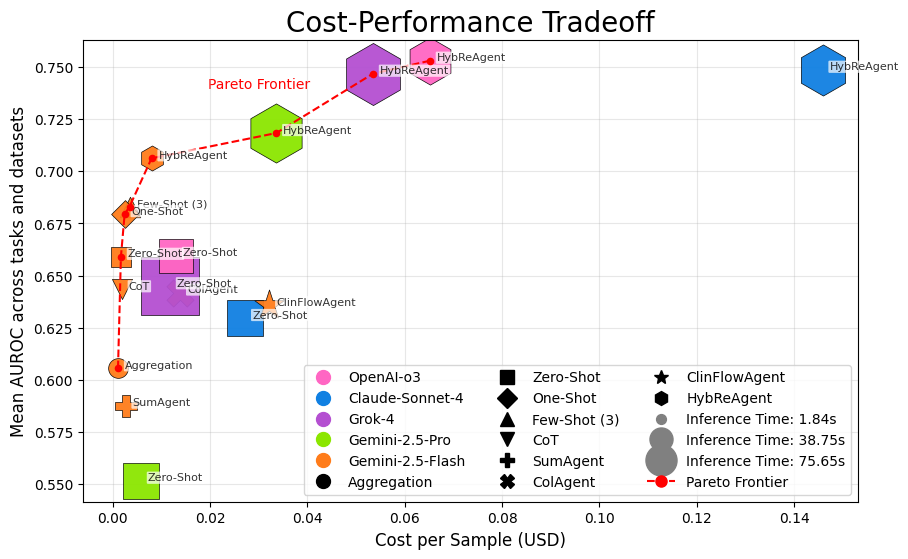

In [52]:
def create_cost_performance_tradeoff_plot(
    df_token_costs,
    df_metrics,
    df_metrics_op,
    cost_column="cost_per_sample",
    auroc_column="AUROC",
    inference_time_column="avg_sample_inference_time",
    aggregation_level="model_type+model_name+is_agent+prompting_id",
    figsize=(9, 8),
    save_path=None,
):
    """
    Create a cost-performance tradeoff plot:
    - X-axis: Cost per Sample (USD)
    - Y-axis: Mean AUROC across tasks and datasets
    - Marker size: Inference time (avg_sample_inference_time)
    - One point per model-prompting strategy (aggregated across all tasks/datasets)
    - Marker shape: Each prompting_id gets a unique shape
    - Legend: 3 columns (Color=Model, Shape=Prompting, Size=Inference Time, Pareto Frontier)
    - Annotation: Only prompting_id (no model name)
    - Pareto frontier: Red dashed line with annotation and legend
    """

    # --- Prepare cost data ---
    cost_df = df_token_costs.copy()
    cost_df = cost_df.rename(columns={"model_prompting_id": "model_prompting_id_cost"})
    if "cost_per_sample" not in cost_df.columns:
        cost_df["cost_per_sample"] = cost_df["total_cost_usd"] / cost_df["sample_count"]

    # --- Prepare AUROC data ---
    auroc_df = (
        df_metrics.groupby("model_prompting_id")[auroc_column]
        .mean()
        .reset_index()
        .rename(
            columns={
                "model_prompting_id": "model_prompting_id_auroc",
                auroc_column: "mean_auroc",
            }
        )
    )

    # --- Prepare inference time data ---
    op_df = df_metrics_op[
        df_metrics_op["aggregation_level"] == aggregation_level
    ].copy()
    op_df = op_df.rename(columns={"model_prompting_id": "model_prompting_id_op"})
    op_df = (
        op_df.groupby("model_prompting_id_op")[inference_time_column]
        .mean()
        .reset_index()
        .rename(columns={inference_time_column: "mean_inference_time"})
    )

    # --- Merge all data ---
    merged = cost_df.merge(
        auroc_df,
        left_on="model_prompting_id_cost",
        right_on="model_prompting_id_auroc",
        how="inner",
    ).merge(
        op_df,
        left_on="model_prompting_id_cost",
        right_on="model_prompting_id_op",
        how="inner",
    )

    # --- Prepare plot data ---
    x = merged[cost_column].values
    y = merged["mean_auroc"].values
    sizes = merged["mean_inference_time"].values
    min_size, max_size = 200, 2000
    if sizes.max() > 0:
        sizes_norm = min_size + (max_size - min_size) * (sizes - sizes.min()) / (
            sizes.max() - sizes.min()
        )
    else:
        sizes_norm = [min_size] * len(sizes)

    # Marker shapes for each prompting_id
    prompting_ids = merged["prompting_id"].unique()
    prompting_id_to_marker = get_prompting_id_to_marker(prompting_ids)
    markers = [prompting_id_to_marker[row["prompting_id"]] for _, row in merged.iterrows()]

    # Colors: use unique model  color for each point
    colors = [
        get_first_agent_color(row["model_name"])
        for _, row in merged.iterrows()
    ]

    # --- Create plot ---
    fig, ax = plt.subplots(figsize=figsize)
    for i, row in merged.iterrows():
        ax.scatter(
            row[cost_column],
            row["mean_auroc"],
            s=sizes_norm[i],
            c=colors[i],
            alpha=0.95,
            edgecolors="black",
            linewidths=0.5,
            marker=markers[i],
            label=None,
            zorder=2,
        )
        ax.annotate(
            row["prompting_id"],  # Only prompting_id in annotation
            (row[cost_column], row["mean_auroc"]),
            textcoords="offset points",
            xytext=(5, 0),
            ha="left",
            fontsize=8,
            color="black",
            alpha=0.8,
            bbox=dict(
                boxstyle="round,pad=0.1", facecolor="white", edgecolor="none", alpha=0.7
            ),
        )

    ax.set_xlabel("Cost per Sample (USD)", fontsize=12)
    ax.set_ylabel("Mean AUROC across tasks and datasets", fontsize=12)
    ax.set_title("Cost-Performance Tradeoff", fontsize=20)
    ax.grid(alpha=0.3)

    # --- Pareto frontier calculation ---
    def pareto_frontier(costs, performances):
        # Sort by cost ascending, then by performance descending
        sorted_idx = np.lexsort((-performances, costs))
        pareto_costs = []
        pareto_perfs = []
        max_perf = -np.inf
        for idx in sorted_idx:
            c, p = costs[idx], performances[idx]
            if p > max_perf:
                pareto_costs.append(c)
                pareto_perfs.append(p)
                max_perf = p
        return np.array(pareto_costs), np.array(pareto_perfs)

    pf_costs, pf_perfs = pareto_frontier(x, y)
    ax.plot(pf_costs, pf_perfs, "r--", linewidth=1.5, label="Pareto Frontier")
    # Annotate the Pareto frontier
    ax.annotate(
        "Pareto Frontier",
        xy=(pf_costs[-1], pf_perfs[-1]),
        xytext=(-160, -20),
        textcoords="offset points",
        color="red",
        fontsize=10,
        zorder=1
    )

    # Add a small dot to each marker included in the Pareto frontier
    for cost, perf in zip(pf_costs, pf_perfs):
        ax.scatter(
            cost,
            perf,
            s=20,  
            c="red",
            marker="o",
            zorder=10,
        )

    # --- Legend elements ---
    # Only include models present in merged, in LLM_MODELS order first, then others
    present_models = [m for m in LLM_MODELS if m in merged["model_name"].unique()]
    present_models += [
        m for m in merged["model_name"].unique() if m not in present_models
    ]
    color_handles = [
        mlines.Line2D(
            [],
            [],
            color=get_first_agent_color(model),
            marker="o",
            linestyle="None",
            markersize=10,
            label=model,
        )
        for model in present_models
    ]
    # Marker legend for prompting_id (PROMPTING_ID_MAPPING order, then extras)
    prompting_ids_order = list(PROMPTING_ID_MAPPING.keys())
    prompting_ids_order += [
        pid for pid in merged["prompting_id"].unique() if pid not in prompting_ids_order
    ]
    marker_handles = [
        mlines.Line2D(
            [],
            [],
            color="black",
            marker=prompting_id_to_marker[pid],
            linestyle="None",
            markersize=10,
            label=pid,
        )
        for pid in prompting_ids_order
        if pid in prompting_id_to_marker
    ]
    # Marker size legend for inference time
    if sizes.max() > 0:
        legend_sizes = np.linspace(sizes.min(), sizes.max(), 3)
        size_handles = [
            mlines.Line2D(
                [],
                [],
                color="gray",
                marker="o",
                linestyle="None",
                markersize=np.sqrt(
                    min_size
                    + (max_size - min_size)
                    * (s - sizes.min())
                    / (sizes.max() - sizes.min())
                )
                / 2,
                label=f"Inference Time: {s:.2f}s",
            )
            for s in legend_sizes
        ]
    else:
        size_handles = []

    # Pareto frontier legend handle
    pareto_handle = mlines.Line2D(
        [],
        [],
        color="red",
        linestyle="--",
        linewidth=1.5,
        marker="o",
        markersize=8,
        markerfacecolor="red",
        label="Pareto Frontier",
    )

    # Show legend with 3 columns: Color (models), Shape (prompting), Size (inference time), Pareto
    legend_handles = color_handles + marker_handles + size_handles + [pareto_handle]
    ax.legend(
        handles=legend_handles,
        loc="lower right",
        fontsize=10,
        frameon=True,
        ncol=3,
    )

    # Optionally save
    if save_path:
        plt.savefig(save_path, dpi=400, bbox_inches="tight")
        print(f"Cost-performance tradeoff plot saved to: {save_path}")

    plt.show()
    return fig


# --- Call the function ---
cost_performance_output_dir = os.path.join(OUTPUT_BASE_DIR, "cost_analysis")
os.makedirs(cost_performance_output_dir, exist_ok=True)
cost_performance_plot_path = os.path.join(
    cost_performance_output_dir, "cost_performance_tradeoff.png"
)

fig_cost_perf = create_cost_performance_tradeoff_plot(
    df_token_costs=df_token_costs,
    df_metrics=df_metrics,
    df_metrics_op=df_metrics_op,
    cost_column="cost_per_sample",
    auroc_column="AUROC",
    inference_time_column="avg_sample_inference_time",
    aggregation_level="model_type+model_name+is_agent+prompting_id",
    figsize=(10, 6),
    save_path=cost_performance_plot_path,
)

In [53]:
# --- Cost Analysis Summary & Actionable Insights ---

def summarize_cost_performance_tradeoff(df_token_costs, df_metrics, df_metrics_op, cost_column="cost_per_sample", auroc_column="AUROC", inference_time_column="avg_sample_inference_time", aggregation_level="model_type+model_name+is_agent+prompting_id"):
    """
    Summarizes cost-performance tradeoff for all model-prompting strategies.
    Provides actionable statements for reporting in results.

    Args:
        df_token_costs (DataFrame): Token cost analysis dataframe
        df_metrics (DataFrame): Metrics dataframe
        df_metrics_op (DataFrame): Operational metrics dataframe
        cost_column (str): Column for cost per sample
        auroc_column (str): Column for AUROC
        inference_time_column (str): Column for inference time
        aggregation_level (str): Aggregation level for operational metrics

    Returns:
        List[str]: Actionable summary statements
    """
    # Prepare cost, performance, and inference time data
    cost_df = df_token_costs.copy()
    if cost_column not in cost_df.columns:
        cost_df[cost_column] = cost_df["total_cost_usd"] / cost_df["sample_count"]

    auroc_df = (
        df_metrics.groupby("model_prompting_id")[auroc_column]
        .mean()
        .reset_index()
        .rename(columns={auroc_column: "mean_auroc"})
    )

    op_df = df_metrics_op[df_metrics_op["aggregation_level"] == aggregation_level].copy()
    op_df = (
        op_df.groupby("model_prompting_id")[inference_time_column]
        .mean()
        .reset_index()
        .rename(columns={inference_time_column: "mean_inference_time"})
    )

    merged = cost_df.merge(
        auroc_df, left_on="model_prompting_id", right_on="model_prompting_id", how="inner"
    ).merge(
        op_df, left_on="model_prompting_id", right_on="model_prompting_id", how="inner"
    )

    # Pareto frontier calculation
    def pareto_frontier(costs, performances):
        sorted_idx = np.lexsort((-performances, costs))
        pareto_costs, pareto_perfs = [], []
        max_perf = -np.inf
        for idx in sorted_idx:
            c, p = costs[idx], performances[idx]
            if p > max_perf:
                pareto_costs.append(c)
                pareto_perfs.append(p)
                max_perf = p
        return np.array(pareto_costs), np.array(pareto_perfs)

    x = merged[cost_column].values
    y = merged["mean_auroc"].values
    pf_costs, pf_perfs = pareto_frontier(x, y)

    # Find best value (lowest cost, highest AUROC)
    best_idx = np.argmax(y / (x + 1e-8))
    best_model = merged.iloc[best_idx]["model_prompting_id"]
    best_cost = merged.iloc[best_idx][cost_column]
    best_auroc = merged.iloc[best_idx]["mean_auroc"]
    best_time = merged.iloc[best_idx]["mean_inference_time"]

    # Most economical and most expensive
    min_cost_idx = np.argmin(x)
    max_cost_idx = np.argmax(x)
    min_cost_model = merged.iloc[min_cost_idx]["model_prompting_id"]
    min_cost_auroc = merged.iloc[min_cost_idx]["mean_auroc"]
    min_cost_time = merged.iloc[min_cost_idx]["mean_inference_time"]
    max_cost_model = merged.iloc[max_cost_idx]["model_prompting_id"]
    max_cost_auroc = merged.iloc[max_cost_idx]["mean_auroc"]
    max_cost_time = merged.iloc[max_cost_idx]["mean_inference_time"]

    # Highest AUROC
    max_auroc_idx = np.argmax(y)
    max_auroc_model = merged.iloc[max_auroc_idx]["model_prompting_id"]
    max_auroc_cost = merged.iloc[max_auroc_idx][cost_column]
    max_auroc_time = merged.iloc[max_auroc_idx]["mean_inference_time"]

    statements = [
        f"Across all model-prompting strategies, the Pareto frontier highlights the optimal tradeoff between cost per sample and mean AUROC.",
        f"The most cost-efficient strategy is '{min_cost_model}' (${min(x):.4f}/sample, AUROC={min_cost_auroc:.3f}, inference time={min_cost_time:.2f}s).",
        f"The highest performing strategy is '{max_auroc_model}' (AUROC={max(y):.3f}, cost=${max_auroc_cost:.4f}/sample, inference time={max_auroc_time:.2f}s).",
        f"The best overall value (highest AUROC per dollar) is '{best_model}' (AUROC={best_auroc:.3f}, cost=${best_cost:.4f}/sample, inference time={best_time:.2f}s).",
        f"The most expensive strategy is '{max_cost_model}' (${max(x):.4f}/sample, AUROC={max_cost_auroc:.3f}, inference time={max_cost_time:.2f}s).",
        f"Cost per sample ranged from ${min(x):.4f} to ${max(x):.4f}, while mean AUROC ranged from {min(y):.3f} to {max(y):.3f} across all strategies.",
        f"Strategies on the Pareto frontier offer the best balance of cost and performance, and should be prioritized for deployment.",
        f"Inference time varied from {merged['mean_inference_time'].min():.2f}s to {merged['mean_inference_time'].max():.2f}s per sample, impacting scalability.",
    ]

    print("=== Cost-Performance Tradeoff Summary ===")
    for s in statements:
        print(f"- {s}")

    return statements

# --- Run summary and print actionable insights ---
cost_performance_statements = summarize_cost_performance_tradeoff(
    df_token_costs, df_metrics, df_metrics_op,
    cost_column="cost_per_sample",
    auroc_column="AUROC",
    inference_time_column="avg_sample_inference_time",
    aggregation_level="model_type+model_name+is_agent+prompting_id"
)

=== Cost-Performance Tradeoff Summary ===
- Across all model-prompting strategies, the Pareto frontier highlights the optimal tradeoff between cost per sample and mean AUROC.
- The most cost-efficient strategy is 'Gemini-2.5-Flash, Aggregation' ($0.0011/sample, AUROC=0.606, inference time=1.91s).
- The highest performing strategy is 'OpenAI-o3, HybReAgent' (AUROC=0.753, cost=$0.0652/sample, inference time=40.99s).
- The best overall value (highest AUROC per dollar) is 'Gemini-2.5-Flash, Aggregation' (AUROC=0.606, cost=$0.0011/sample, inference time=1.91s).
- The most expensive strategy is 'Claude-Sonnet-4, HybReAgent' ($0.1458/sample, AUROC=0.749, inference time=49.17s).
- Cost per sample ranged from $0.0011 to $0.1458, while mean AUROC ranged from 0.552 to 0.753 across all strategies.
- Strategies on the Pareto frontier offer the best balance of cost and performance, and should be prioritized for deployment.
- Inference time varied from 1.84s to 75.65s per sample, impacting scalabilit

## Backup

OLD RADAR CHARTS

📊 Creating radar charts with different datasets and LLM display modes...
   Benchmark metrics: 12
   Benchmark task-dataset combinations: 9
   Agents metrics: 12
   Agents task-dataset combinations: 9

🎯 Generating radar charts for BENCHMARK data with BEST STRATEGY per LLM...
   Saved combined metrics chart to: ./notebook_output/pulse_agents_overall/radar_charts/combined_metrics_radar_chart_benchmark_best_strategy.png


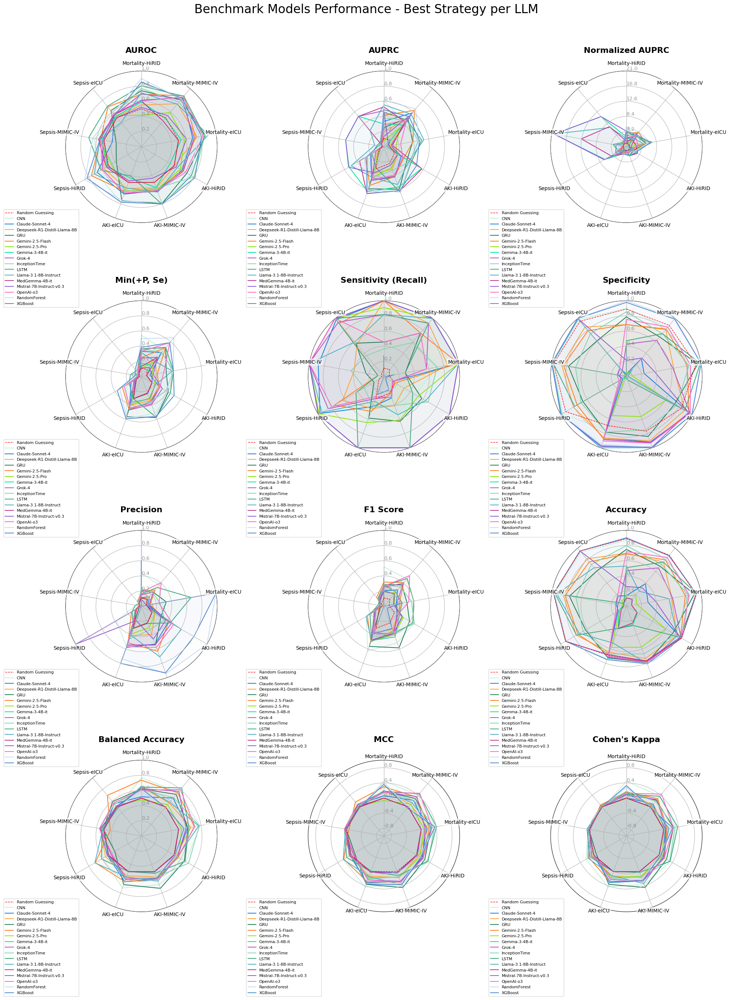

   Saved combined task-dataset chart to: ./notebook_output/pulse_agents_overall/radar_charts/combined_radar_chart_benchmark_best_strategy.png


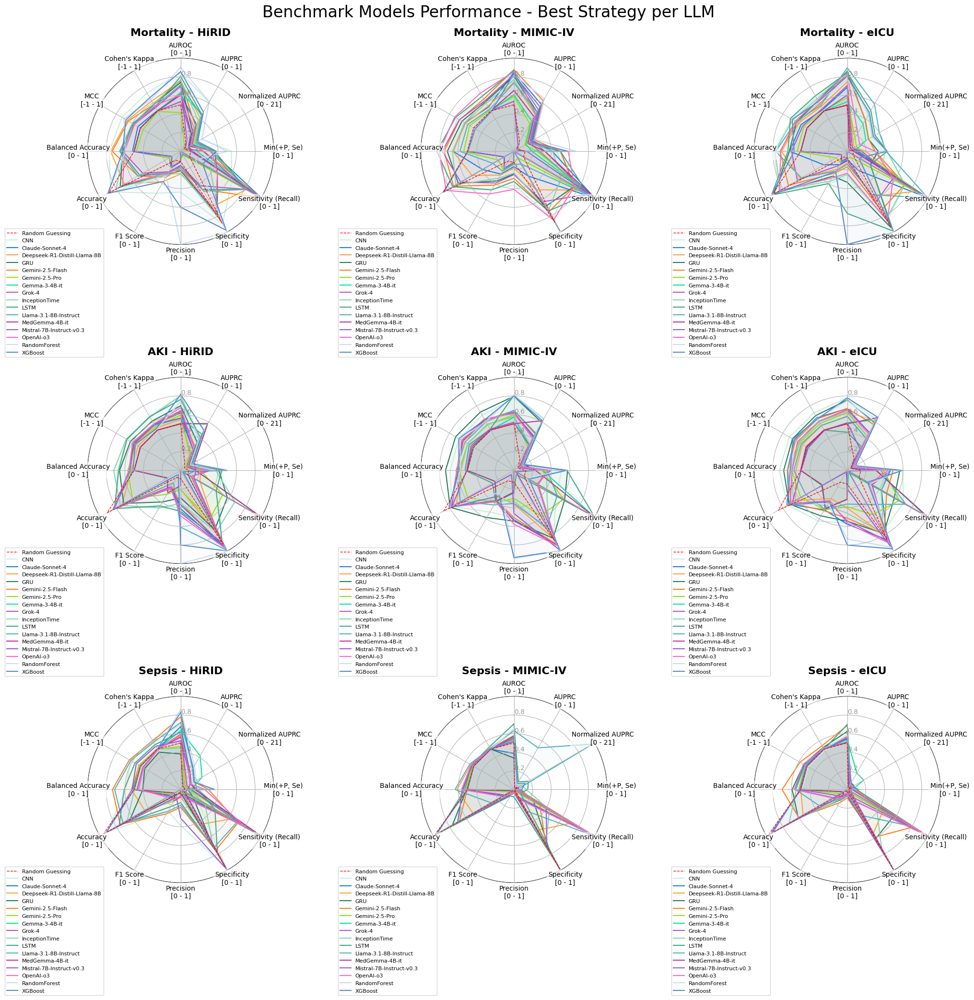


🎯 Generating radar charts for AGENTS data with ALL COMBINATIONS...

✅ Radar chart generation complete for both datasets and display modes!
   Charts saved to: ./notebook_output/pulse_agents_overall/radar_charts
   💡 Benchmark data shows best prompting strategy per base model (cleaner)
   💡 Agents data shows all agent combinations (comprehensive)


In [56]:
# Main execution: Generate radar charts with different display modes
# Define metrics and output directories
tasks_radar_benchmark = df_metrics_benchmark["Task"].unique()
datasets_radar_benchmark = df_metrics_benchmark["Dataset"].unique()
tasks_radar_agents = df_metrics_agents["Task"].unique()
datasets_radar_agents = df_metrics_agents["Dataset"].unique()

radar_charts_dir = os.path.join(OUTPUT_BASE_DIR, "radar_charts")
os.makedirs(radar_charts_dir, exist_ok=True)

print(f"📊 Creating radar charts with different datasets and LLM display modes...")
print(f"   Benchmark metrics: {len([m for m in METRICS_LIST if m in df_metrics_benchmark.columns])}")
print(f"   Benchmark task-dataset combinations: {len(tasks_radar_benchmark) * len(datasets_radar_benchmark)}")
print(f"   Agents metrics: {len([m for m in METRICS_LIST if m in df_metrics_agents.columns])}")
print(f"   Agents task-dataset combinations: {len(tasks_radar_agents) * len(datasets_radar_agents)}")

# Benchmark data with BEST STRATEGY per LLM model (cleaner visualization)
print(f"\n🎯 Generating radar charts for BENCHMARK data with BEST STRATEGY per LLM...")
# generate_individual_radar_charts(
#     df_metrics=df_metrics_benchmark,
#     output_dirs={'metrics': radar_metrics_dir_benchmark, 'tasks': radar_tasks_dir_benchmark},
#     llm_display_mode='best_strategy'
# )

# Create combined figures for benchmark data with best strategy mode
combined_metrics_path_benchmark = os.path.join(radar_charts_dir, "combined_metrics_radar_chart_benchmark_best_strategy.png")
fig_combined_metrics_benchmark = create_combined_metrics_radar_grid(
    df_metrics=df_metrics_benchmark,
    save_path=combined_metrics_path_benchmark,
    show_plots=True,
    figsize_per_chart=(6.7, 7),
    suptitle="Benchmark Models Performance - Best Strategy per LLM",
    llm_display_mode='best_strategy'
)

combined_tasks_path_benchmark = os.path.join(radar_charts_dir, "combined_radar_chart_benchmark_best_strategy.png")
fig_combined_tasks_benchmark = create_combined_task_dataset_radar_grid(
    df_metrics=df_metrics_benchmark,
    save_path=combined_tasks_path_benchmark,
    show_plots=True,
    figsize_per_chart=(7, 7),
    suptitle="Benchmark Models Performance - Best Strategy per LLM",
    llm_display_mode='best_strategy'
)

# Agents data with ALL COMBINATIONS (comprehensive view)
print(f"\n🎯 Generating radar charts for AGENTS data with ALL COMBINATIONS...")
# generate_individual_radar_charts(
#     df_metrics=df_metrics_agents,
#     output_dirs={'metrics': radar_metrics_dir_agents, 'tasks': radar_tasks_dir_agents},
#     llm_display_mode='all_combinations'
# )

# # Create combined figures for agents data with all combinations mode
# combined_metrics_path_agents = os.path.join(radar_metrics_dir_agents, "combined_metrics_radar_chart.png")
# fig_combined_metrics_agents = create_combined_metrics_radar_grid(
#     df_metrics=df_metrics_agents,
#     save_path=combined_metrics_path_agents,
#     show_plots=True,
#     figsize_per_chart=(6.7, 7),
#     suptitle="Agent Models Performance - All Agent Combinations",
#     llm_display_mode='all_combinations'
# )

# combined_tasks_path_agents = os.path.join(radar_tasks_dir_agents, "combined_radar_chart.png")
# fig_combined_tasks_agents = create_combined_task_dataset_radar_grid(
#     df_metrics=df_metrics_agents,
#     save_path=combined_tasks_path_agents,
#     show_plots=True,
#     figsize_per_chart=(7, 7),
#     suptitle="Agent Models Performance - All Agent Combinations",
#     llm_display_mode='all_combinations'
# )

print(f"\n✅ Radar chart generation complete for both datasets and display modes!")
print(f"   Charts saved to: {radar_charts_dir}")
print(f"   💡 Benchmark data shows best prompting strategy per base model (cleaner)")
print(f"   💡 Agents data shows all agent combinations (comprehensive)")